# Wagtail topology weighting framework

To start analysis load packages, styles and initialize (run) functions

To do:  
Limit gene flow  
Think about hybridization model      

## Loading packages

In [2]:
import msprime
import numpy as np
import scipy
from IPython.display import SVG
import tskit
#import allel
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import io
import ternary #
import collections
import random
import demesdraw 

import matplotlib as ml
%matplotlib inline
font = {'family' : 'Sans', 'weight' : 'normal','size': 16}
ml.rc('font', **font)
ml.rcParams['figure.figsize'] = (5.0, 5.0)
ml.rcParams['text.usetex'] =False
ml.rc('font', family='serif',size=16)

In [2]:
def set_demography(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="P1", initial_size=Ne)
    demography.add_population(name="P2", initial_size=Ne)
    demography.add_population(name="P3", initial_size=Ne)
    demography.add_population(name="O", initial_size=Ne)
    demography.add_population(name="P12", initial_size=Ne)
    demography.add_population(name="P123", initial_size=Ne)
    demography.add_population(name="ANC", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["P1", "P2"], ancestral="P12")
    demography.add_population_split(time=t2, derived=["P12", "P3"], ancestral="P123")
    demography.add_population_split(time=t3, derived=["P123", "O"], ancestral="ANC")
    
    #setting up gene flow
    demography.set_migration_rate("P3", "P2", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

def set_demography_s(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="P1", initial_size=Ne)
    demography.add_population(name="P2", initial_size=Ne)
    demography.add_population(name="P3", initial_size=Ne)
    demography.add_population(name="O", initial_size=Ne)
    demography.add_population(name="P12", initial_size=Ne)
    demography.add_population(name="P123", initial_size=Ne)
    demography.add_population(name="ANC", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["P1", "P2"], ancestral="P12")
    demography.add_population_split(time=t2, derived=["P12", "P3"], ancestral="P123")
    demography.add_population_split(time=t3, derived=["P123", "O"], ancestral="ANC")
    
    #setting up gene flow
    demography.set_migration_rate("P3", "P2", mig_rate)

    return demography

'''
def tern_plot(data):
    # Set up the figure.
    fig, tax = ternary.figure(scale=100)
    fig.set_size_inches(10, 9)

    # Plot points.
    tax.scatter(data,color="green",alpha=0.3)

    # Axis labels. (See below for corner labels.)
    fontsize = 14
    offset = 0.08
    tax.left_axis_label("T control %", fontsize=fontsize, offset=offset)
    tax.right_axis_label("T species %", fontsize=fontsize, offset=offset)
    tax.bottom_axis_label("T reproduction %", fontsize=fontsize, offset=-offset)
    tax.set_title("Ternary Framework", fontsize=20)

    # Decoration.
    tax.boundary(linewidth=0.1)
    tax.gridlines(multiple=10, color="grey")
    tax.ticks(axis='lbr', linewidth=0.2, multiple=20)
    tax.get_axes().axis('off')
'''
            
        
def produce_ranks(ts_reps):
    ranks=[]
    for replicate_index, ts in enumerate(ts_reps):
        for t in ts.trees():
            ranks+=[t.rank()]
    return ranks
        
def summarize_ranks(num_replicates,ranks):    
    topo_weight= []
    topS_count = []
    topC_count = []
    topR_count = []

    rank_dict=collections.Counter(ranks)

    for key, value in rank_dict.items():
        if key == (4,0) or key == (3,11) or key == (3,8) or key == (3,0) or key == (3,3):
            topS_count.append(value)
            #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
            # TOPOLOGY C
        elif key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
            # TOPOLOGY R
    count_array=[(sum(topR_count)/num_replicates)*100, sum(topS_count)/num_replicates*100, sum(topC_count)/num_replicates*100]
    return count_array

def make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate):
    topo_sum=[]
    for i in range(num_data_points):
        ranks=produce_ranks(simulate_windows(num_replicates,set_demography_s(t1,t2,t3,mig_rate,Ne)))
        topo_sum.append(summarize_ranks(num_replicates,ranks))
    return topo_sum

def topology_count(num_replicates,demogr_model):
    windows=simulate_windows(num_replicates,demogr_model)
    ranks=produce_ranks(windows)

    top1_count = np.zeros(15)


    rank_dict=collections.Counter(ranks)

    for key, value in rank_dict.items():
        if key == (3,8):
            top1_count[0]+=value
        elif key == (3,11):
            top1_count[1]+=value
        elif key == (4,0):
            top1_count[2]+=value
        elif key == (3,6):
            top1_count[3]+=value
        elif key == (3,1):
            top1_count[4]+=value    
        elif key == (4,1):
            top1_count[5]+=value
        elif key == (3,9):
            top1_count[6]+=value
        elif key == (3,2):
            top1_count[7]+=value
        elif key == (4,2):
            top1_count[8]+=value
        elif key == (3,3):
            top1_count[9]+=value
        elif key == (3,5):
            top1_count[10]+=value
        elif key == (3,4):
            top1_count[11]+=value
        elif key == (3,7):
            top1_count[12]+=value
        elif key == (3,10):
            top1_count[13]+=value
        elif key == (3,0):
            top1_count[14]+=value

    print(top1_count)

    ml.rcParams['figure.figsize'] = (15.0, 5.0)
    top_names=["Top1","Top2","Top3","Top4","Top5","Top6","Top7","Top8","Top9","Top10","Top11","Top12","Top13","Top14","Top15"]
    g=sns.barplot(top_names, top1_count, palette = 'Set3', edgecolor = 'w')
    plt.rcParams['axes.spines.left'] = True
    plt.rcParams['axes.spines.right'] = False
    plt.rcParams['axes.spines.top'] = False
    plt.rcParams['axes.spines.bottom'] = True
    plt.ylabel("Number of topologies")#color="#f5f5f5")
    plt.show()
    

def simulate_windows(num_replicates,demography):
    ancestry_reps = msprime.sim_ancestry(samples={"gra": 12, "alb": 14, "sam": 4, "agu": 12}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/10000))
        yield mutated_ts
        
        
def wag_simulate(path):
    file = open(path, "w")
    
    if model == 'one_way':
        genealogies=tern_simulate_P3P2_s()
        
    if model == 'two_way':
        genealogies=tern_simulate_twoway_s()
        
    for replicate_index, ts in enumerate(genealogies):
        for t in ts.trees():
            newick=t.newick(precision=1)
            replace_strings_tens= ts_newick_rename_dict_tens()            
            replace_strings_hun=ts_newick_rename_dict_hun()
            for word in replace_strings_tens.items():
                newick = newick.replace(str(word[0]), str(word[1]))
                for word in replace_strings_hun.items():
                    newick = newick.replace(str(word[0]), str(word[1]))
            file.write(newick+"\n")
            
    file.close()
    
def ts_newick_rename_dict_hun():
    sample_names = dict()
    
    #Total number of empirical samples
    ntotal=nP1+nP2+nP3+n0

    #Creating list of newick names
    ts_name=list()
    for i in range(1,ntotal+1):
        ts_name.append(","+str(i)+":")

    #Creating list of population samples    
    nP1_names=list()
    for i in range(1,nP1+1):
        nP1_names.append(",P1_"+str(i)+":")

    nP2_names=list()
    for i in range(1,nP2+1):
        nP2_names.append(",P2_"+str(i)+":")

    nP3_names=list()
    for i in range(1,nP3+1):
        nP3_names.append(",P3_"+str(i)+":")

    n0_names=list()
    for i in range(1,n0+1):
        n0_names.append(",O_"+str(i)+":")

    pop_names=nP1_names+nP2_names+nP3_names+n0_names

    #Using dictionary comprehension to convert lists to dictionary
    sample_names = {ts_name[i]: pop_names[i] for i in range(len(ts_name))}
    
    return sample_names

def ts_newick_rename_dict_tens():
    sample_names = dict()
    
    #Total number of empirical samples
    ntotal=nP1+nP2+nP3+n0

    #Creating list of newick names
    ts_name=list()
    for i in range(1,ntotal+1):
        ts_name.append("("+str(i)+":")

    #Creating list of population samples    
    nP1_names=list()
    for i in range(1,nP1+1):
        nP1_names.append("("+"P1_"+str(i)+":")

    nP2_names=list()
    for i in range(1,nP2+1):
        nP2_names.append("("+"P2_"+str(i)+":")

    nP3_names=list()
    for i in range(1,nP3+1):
        nP3_names.append("("+"P3_"+str(i)+":")

    n0_names=list()
    for i in range(1,n0+1):
        n0_names.append("("+"O_"+str(i)+":")

    pop_names=nP1_names+nP2_names+nP3_names+n0_names

    #Using dictionary comprehension to convert lists to dictionary
    sample_names = {ts_name[i]: pop_names[i] for i in range(len(ts_name))}
    
    return sample_names

## Simulation set up

Update November 2022

### Models without gene flow: Model 0.1

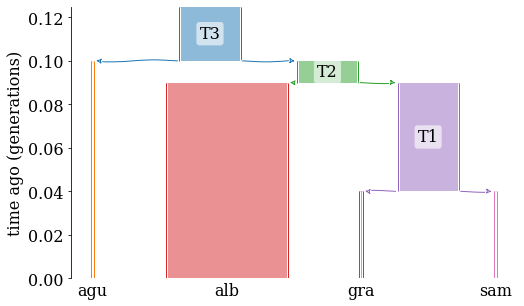

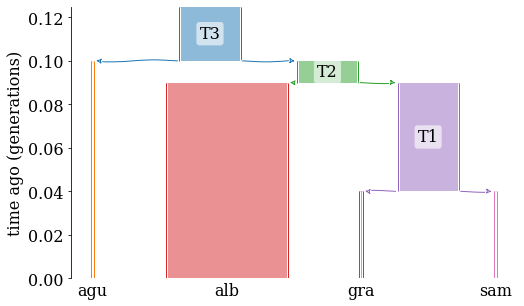

In [6]:
#Model 1

def demogr_model_0_1(t1,t2,t3,NeT1,NeT2,NeT3):
    demography = msprime.Demography()
    
    Ne = 1e4
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne*1.2)
    demography.add_population(name="alb", initial_size=Ne*40)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=NeT1)
    demography.add_population(name="T2", initial_size=NeT2)
    demography.add_population(name="T3", initial_size=NeT3)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    #demography.set_migration_rate("alb", "agu", mig_rate)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    

    return demography

demogr_model_0_1(0.04,0.09,0.1,20e4,20e4,20e4)

def simulate_windows(num_replicates,demography):
    ancestry_reps = msprime.sim_ancestry(samples={"gra": 12, "alb": 14, "sam": 4, "agu": 12}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=0.9e-8)
        yield mutated_ts
        
simulate_windows(19000,demogr_model_0_1(0.04,0.09,0.1,20e4,20e4,20e4))


def ts_newick(path,genealogies):
    #file = open(path, "w")

    #if model == 'one_way':
    #    genealogies=tern_simulate_P3P2_s()

    #if model == 'two_way':
    #    genealogies=tern_simulate_twoway_s()

    for replicate_index, ts in enumerate(genealogies):
        for t in ts.trees():
            newick=t.newick(precision=1)
            replace_strings_tens= ts_newick_rename_dict_tens()
            replace_strings_hun=ts_newick_rename_dict_hun()
            for word in replace_strings_tens.items():
                newick = newick.replace(str(word[0]), str(word[1]))
                for word in replace_strings_hun.items():
                    newick = newick.replace(str(word[0]), str(word[1]))
            print(newick+"\n")
            #file.write(newick+"\n")

    #file.close()
    
def ts_newick_rename_dict_hun():
    sample_names = dict()
    
    #{"gra": 12, "alb": 14, "sam": 4, "agu": 12}
    
    nP1=12
    nP2=14
    nP3=4
    n0=12
    
    #Total number of empirical samples
    ntotal=nP1+nP2+nP3+n0

    #Creating list of newick names
    ts_name=list()
    for i in range(1,ntotal+1):
        ts_name.append(","+str(i)+":")

    #Creating list of population samples    
    nP1_names=list()
    for i in range(1,nP1+1):
        nP1_names.append(",gra_"+str(i)+":")

    nP2_names=list()
    for i in range(1,nP2+1):
        nP2_names.append(",alb_"+str(i)+":")

    nP3_names=list()
    for i in range(1,nP3+1):
        nP3_names.append(",sam_"+str(i)+":")

    n0_names=list()
    for i in range(1,n0+1):
        n0_names.append(",agu_"+str(i)+":")

    pop_names=nP1_names+nP2_names+nP3_names+n0_names

    #Using dictionary comprehension to convert lists to dictionary
    sample_names = {ts_name[i]: pop_names[i] for i in range(len(ts_name))}
    
    return sample_names

def ts_newick_rename_dict_tens():
    sample_names = dict()
    
    nP1=12
    nP2=14
    nP3=4
    n0=12
    
    #Total number of empirical samples
    ntotal=nP1+nP2+nP3+n0

    #Creating list of newick names
    ts_name=list()
    for i in range(1,ntotal+1):
        ts_name.append("("+str(i)+":")

    #Creating list of population samples    
    nP1_names=list()
    for i in range(1,nP1+1):
        nP1_names.append("("+"gra_"+str(i)+":")

    nP2_names=list()
    for i in range(1,nP2+1):
        nP2_names.append("("+"alb_"+str(i)+":")

    nP3_names=list()
    for i in range(1,nP3+1):
        nP3_names.append("("+"sam_"+str(i)+":")

    n0_names=list()
    for i in range(1,n0+1):
        n0_names.append("("+"agu_"+str(i)+":")

    pop_names=nP1_names+nP2_names+nP3_names+n0_names

    #Using dictionary comprehension to convert lists to dictionary
    sample_names = {ts_name[i]: pop_names[i] for i in range(len(ts_name))}
    
    return sample_names

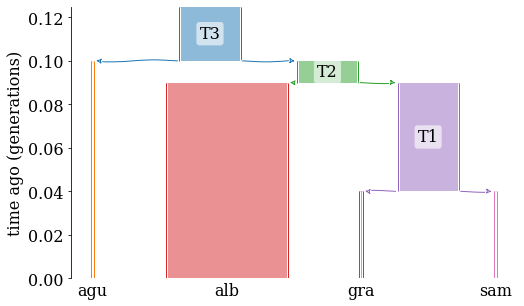

((gra_11:53299.6,((alb_8:5036.6,(alb_3:1979.3,alb_14:1979.3):3057.3):28067.7,((agu_3:14976.3,((alb_6:1732.8,alb_7:1732.8):6556.2,(agu_12:2961.6,(gra_8:2346.1,(alb_5:572.8,agu_6:572.8):1773.3):615.5):5327.5):6687.3):8323.7,(agu_1:23085.2,(gra_6:22759.2,alb_13:22759.2):326.0):214.8):9804.3):20195.3):436521.8,(((agu_2:5633.1,agu_10:5633.1):96394.0,((sam_4:153.2,agu_8:153.2):8832.3,(sam_1:5710.4,(agu_4:213.1,agu_9:213.1):5497.4):3275.1):93041.6):84902.6,((((gra_10:8868.7,agu_5:8868.7):7122.7,(gra_5:10034.8,(sam_2:9985.5,(alb_4:3419.2,alb_9:3419.2):6566.4):49.3):5956.7):9588.9,(alb_12:22733.2,((alb_1:4494.5,sam_3:4494.5):18063.9,(gra_1:12170.3,gra_3:12170.3):10388.1):174.8):2847.2):83185.7,(agu_7:60471.7,((gra_4:9693.4,(gra_9:2315.9,alb_2:2315.9):7377.5):46558.7,(alb_11:30452.2,((gra_7:7222.9,gra_12:7222.9):12942.8,(agu_11:7898.1,(gra_2:5263.4,alb_10:5263.4):2634.6):12267.6):10286.6):25799.9):4219.6):48294.4):78163.6):302891.6);

(((gra_4:8375.7,(sam_3:7266.4,(alb_4:895.7,alb_13:895.7):6370

(((agu_4:23417.5,(alb_2:8700.3,(gra_6:7442.2,(gra_1:1233.0,gra_3:1233.0):6209.3):1258.1):14717.2):66218.0,((agu_7:27405.5,agu_12:27405.5):57727.4,((alb_10:2781.3,agu_5:2781.3):30240.3,((gra_4:1824.2,(alb_4:695.3,agu_10:695.3):1128.8):19439.9,((gra_5:14470.3,(agu_11:12749.2,((gra_2:6479.4,agu_3:6479.4):2781.8,(alb_11:7111.9,alb_13:7111.9):2149.3):3488.1):1721.1):2892.2,((alb_7:5651.5,(alb_1:1158.8,alb_9:1158.8):4492.7):10741.4,(gra_10:8186.4,(gra_12:5516.0,sam_4:5516.0):2670.5):8206.5):969.6):3901.5):11757.6):52111.3):4502.6):348866.8,((sam_2:10401.6,(gra_11:1471.1,alb_14:1471.1):8930.4):219542.4,((gra_7:9434.9,(sam_1:9420.9,agu_8:9420.9):14.0):159461.3,((alb_8:6472.5,(gra_8:2860.2,alb_6:2860.2):3612.3):73923.3,((agu_6:4743.1,(sam_3:3862.6,agu_1:3862.6):880.5):22867.0,(agu_9:20557.4,((gra_9:10283.2,(alb_3:3736.6,agu_2:3736.6):6546.7):6132.3,(alb_5:15324.7,alb_12:15324.7):1090.8):4141.8):7052.7):52785.6):88500.5):61047.7):208558.4);

(((alb_4:16940.3,alb_11:16940.3):235.2,(gra_3:16951.5,

(alb_1:642656.3,((sam_2:77593.9,((gra_11:12526.4,((alb_3:2982.7,(agu_12:782.7,(gra_9:382.2,agu_9:382.2):400.6):2200.0):6845.9,(alb_12:3746.3,(agu_2:1280.8,(gra_10:308.2,gra_12:308.2):972.6):2465.5):6082.3):2697.7):40131.5,(alb_6:50544.8,((gra_3:5792.7,alb_10:5792.7):9659.0,(gra_6:7548.0,agu_7:7548.0):7903.8):35093.0):2113.1):24936.0):121506.0,(((((alb_8:6878.5,(gra_7:4306.4,agu_6:4306.4):2572.1):2680.8,(agu_8:9532.2,(gra_8:8863.7,agu_5:8863.7):668.6):27.0):18633.2,((gra_5:2475.7,agu_3:2475.7):22355.0,(gra_4:8313.3,(alb_13:6381.8,(alb_5:4736.5,agu_1:4736.5):1645.3):1931.4):16517.5):3361.8):35208.7,(alb_11:31692.6,(sam_4:19132.0,(alb_7:16733.8,(alb_14:10475.3,sam_3:10475.3):6258.5):2398.2):12560.6):31708.5):83303.7,(((sam_1:11713.6,agu_4:11713.6):13832.3,((gra_1:3626.3,alb_4:3626.3):9723.0,(gra_2:12790.0,alb_9:12790.0):559.3):12196.6):40430.2,(agu_10:38495.3,(alb_2:6023.2,agu_11:6023.2):32472.0):27480.8):80728.8):52395.1):443556.4);

((agu_3:51219.8,(sam_2:32010.0,(agu_5:9441.2,(alb_11:8

((((agu_9:3626.6,(gra_12:558.3,alb_9:558.3):3068.2):46588.3,(gra_8:11588.6,((gra_4:1634.7,alb_11:1634.7):6039.1,((gra_3:1229.7,agu_10:1229.7):5472.6,(agu_3:2807.1,(alb_10:227.7,alb_13:227.7):2579.4):3895.2):971.5):3914.8):38626.3):108128.0,((agu_2:29392.6,(alb_8:1982.7,(sam_3:849.3,agu_12:849.3):1133.4):27409.9):45406.3,(agu_11:32456.4,((alb_12:602.0,(gra_1:213.1,agu_4:213.1):388.9):19258.6,((gra_9:12490.5,agu_1:12490.5):3182.5,(agu_5:13855.8,(sam_4:6685.9,(alb_3:3243.8,sam_1:3243.8):3442.0):7170.0):1817.2):4187.6):12595.8):42342.6):83543.9):176321.0,((((gra_7:12004.2,alb_5:12004.2):4685.2,((alb_2:2242.9,agu_6:2242.9):14286.4,(gra_11:9662.1,(alb_4:2960.5,alb_14:2960.5):6701.6):6867.3):160.0):21678.6,(gra_2:28207.8,gra_6:28207.8):10160.2):140402.7,((alb_7:20431.1,(sam_2:14036.1,(gra_5:12627.3,(alb_1:8441.7,agu_7:8441.7):4185.6):1408.8):6395.0):136657.3,(alb_6:30659.6,(gra_10:2498.9,agu_8:2498.9):28160.6):126428.8):21682.3):155893.2);

(((sam_1:15453.1,((alb_2:4218.8,(agu_6:2342.0,(sam_3

(((agu_3:3319.8,agu_4:3319.8):79440.0,((alb_2:1053.5,sam_4:1053.5):65023.6,(gra_2:65452.6,(gra_5:49654.2,((gra_6:1902.7,gra_10:1902.7):9179.8,(agu_1:7357.1,(gra_9:848.8,agu_7:848.8):6508.3):3725.5):38571.6):15798.4):624.5):16682.8):651363.5,(((gra_12:872.0,alb_4:872.0):31670.8,(alb_12:3396.5,agu_2:3396.5):29146.4):297203.0,((agu_12:11959.6,(sam_2:7102.0,agu_10:7102.0):4857.7):122376.0,((agu_11:14057.5,(alb_11:11698.0,(sam_1:10766.1,(alb_7:8116.3,(alb_6:99.1,alb_8:99.1):8017.2):2649.8):932.0):2359.4):101662.1,((((gra_7:16343.8,(agu_9:8391.9,(sam_3:2655.3,agu_8:2655.3):5736.6):7952.0):2670.7,(alb_10:18546.9,agu_5:18546.9):467.6):14339.9,(alb_3:20452.6,(gra_8:5662.9,(gra_4:760.7,alb_1:760.7):4902.2):14789.6):12901.9):15910.1,(((alb_5:3137.6,alb_14:3137.6):2653.1,(agu_6:5004.0,(alb_9:3535.3,alb_13:3535.3):1468.7):786.7):37695.8,(gra_1:6694.8,(gra_3:6152.1,gra_11:6152.1):542.7):36791.7):5778.0):66455.1):18616.0):195410.3):404377.5);

(((agu_3:13384.8,(alb_8:1590.9,agu_5:1590.9):11793.9):504

((agu_10:17555.6,(alb_4:14092.7,((sam_3:3684.9,agu_8:3684.9):8056.5,(gra_11:3949.2,alb_5:3949.2):7792.2):2351.3):3462.9):251570.4,((agu_6:98731.9,((alb_1:2615.7,agu_7:2615.7):70686.5,(alb_14:14993.4,(agu_2:435.7,agu_3:435.7):14557.8):58308.7):25429.7):107004.6,(((gra_1:683.4,gra_10:683.4):65587.5,((gra_2:6603.2,alb_12:6603.2):38883.2,((gra_5:8305.4,(alb_2:1595.8,agu_5:1595.8):6709.6):11803.5,(alb_3:9093.7,agu_1:9093.7):11015.3):25377.4):20784.5):39620.4,((agu_11:22023.7,(gra_6:7777.4,sam_1:7777.4):14246.3):63478.4,((alb_9:28633.1,alb_10:28633.1):51435.0,(((alb_11:3579.5,agu_12:3579.5):8567.2,(alb_13:4006.2,(gra_7:259.7,alb_8:259.7):3746.4):8140.6):22404.6,((agu_4:5484.4,(gra_9:550.0,sam_4:550.0):4934.4):10393.7,((agu_9:790.0,(gra_4:434.4,alb_7:434.4):355.6):9690.1,((gra_3:53.1,sam_2:53.1):4419.6,(gra_8:1479.9,(gra_12:1172.5,alb_6:1172.5):307.4):2992.8):6007.4):5397.9):18673.2):45516.8):5434.0):20389.2):99845.2):63389.5);

(((alb_10:16119.2,(gra_5:4833.3,alb_7:4833.3):11285.9):81032.3,(

((sam_3:3469.5,(sam_1:385.2,agu_6:385.2):3084.3):829789.3,(((gra_7:2485.0,(gra_4:1608.0,alb_1:1608.0):877.0):86404.3,(((gra_2:738.7,sam_4:738.7):23900.6,(alb_9:17503.7,(alb_6:8259.4,(gra_5:1074.8,alb_2:1074.8):7184.6):9244.3):7135.6):23665.2,((agu_11:24236.8,(agu_3:10075.0,((gra_8:1364.3,gra_9:1364.3):5523.6,(alb_3:2941.0,agu_10:2941.0):3946.9):3187.1):14161.8):7628.1,((sam_2:8116.2,((gra_12:2417.0,alb_11:2417.0):5318.5,((agu_4:380.1,agu_12:380.1):2850.8,(gra_3:1131.3,alb_13:1131.3):2099.6):4504.5):380.8):16900.7,(gra_11:9827.2,((alb_8:1900.2,alb_14:1900.2):4281.1,(agu_7:6058.9,(gra_10:4443.9,alb_5:4443.9):1615.0):122.4):3645.9):15189.8):6848.0):16439.5):40584.8):74658.4,((alb_7:66143.9,alb_12:66143.9):73571.2,(((alb_4:6516.8,agu_1:6516.8):27264.6,(agu_5:17882.1,agu_9:17882.1):15899.3):41564.5,(gra_1:46701.0,((alb_10:434.2,agu_2:434.2):22272.0,(gra_6:591.8,agu_8:591.8):22114.4):23994.8):28645.0):64369.1):23832.7):669711.0);

(((sam_4:8013.7,((agu_5:295.2,(gra_7:247.1,agu_11:247.1):48.1

(((agu_6:7546.1,(sam_2:5587.1,((agu_8:1392.5,agu_11:1392.5):3058.4,(gra_12:3726.1,agu_7:3726.1):724.9):1136.1):1959.0):18688.0,(gra_3:13881.5,(alb_13:2001.0,(alb_1:522.5,alb_12:522.5):1478.5):11880.5):12352.6):223249.1,(((gra_11:4871.3,(alb_3:2053.5,(alb_5:497.6,alb_7:497.6):1555.9):2817.8):41132.7,(gra_2:30360.3,(alb_4:30210.4,((agu_1:538.1,agu_10:538.1):16351.9,(gra_4:13598.9,gra_10:13598.9):3291.1):13320.4):149.9):15643.6):72797.4,(alb_2:112796.6,(((gra_5:8229.4,sam_3:8229.4):54409.2,((gra_8:22035.2,(alb_6:1675.8,sam_4:1675.8):20359.4):18261.9,((gra_7:2099.5,(agu_2:1966.7,(alb_9:487.8,agu_12:487.8):1478.9):132.8):31442.6,(alb_8:15333.3,((agu_5:1971.3,(gra_1:1251.0,alb_10:1251.0):720.3):12588.7,(gra_9:11105.8,(agu_3:3854.1,(alb_11:875.1,agu_4:875.1):2979.0):7251.7):3454.2):773.2):18208.8):6755.1):22341.4):38030.1,((gra_6:1706.1,alb_14:1706.1):67299.1,(sam_1:2645.0,agu_9:2645.0):66360.3):31663.5):12127.9):6004.8):130681.8);

(((agu_11:15597.2,(((gra_9:941.5,sam_4:941.5):3345.3,(sam_2:

((gra_10:44557.6,((alb_2:2410.0,alb_10:2410.0):16717.0,(sam_2:18932.6,(agu_11:3578.1,(gra_4:313.8,agu_2:313.8):3264.3):15354.4):194.4):25430.7):618648.2,(((agu_3:2566.5,(gra_1:2041.9,alb_4:2041.9):524.6):41172.8,(gra_5:27038.2,(alb_12:925.9,alb_14:925.9):26112.3):16701.1):324854.9,((alb_13:4476.1,agu_5:4476.1):56844.3,((((gra_8:1028.2,agu_10:1028.2):20290.0,(alb_11:5105.1,(alb_9:645.5,agu_4:645.5):4459.5):16213.1):18141.3,(agu_8:23065.8,((agu_7:17173.6,(agu_9:5221.0,(sam_3:5092.3,(sam_4:851.6,agu_6:851.6):4240.7):128.7):11952.6):4585.4,(alb_1:21268.7,((sam_1:6220.9,(gra_3:2630.4,gra_11:2630.4):3590.5):6614.0,(alb_6:10295.2,(alb_8:4686.2,(alb_7:2777.2,agu_12:2777.2):1909.0):5609.0):2539.7):8433.8):490.2):1306.8):16393.7):17928.8,(gra_2:40821.1,((gra_6:4470.4,(gra_9:3727.2,(gra_12:1313.0,agu_1:1313.0):2414.2):743.2):14191.2,(alb_3:14186.7,(gra_7:2982.5,alb_5:2982.5):11204.2):4474.9):22159.4):16567.2):3932.1):307273.9):294611.6);

((((gra_5:10524.7,agu_7:10524.7):36406.4,((alb_7:964.4,(gr

(((((gra_4:324.1,agu_8:324.1):8961.0,(gra_1:5407.8,(gra_5:4595.3,sam_4:4595.3):812.5):3877.3):58561.4,((agu_12:12935.5,(alb_6:748.0,alb_12:748.0):12187.4):15323.9,((gra_6:283.0,agu_1:283.0):23197.6,(gra_9:3786.7,agu_9:3786.7):19693.9):4778.8):39587.1):178667.4,((gra_3:18084.9,alb_7:18084.9):95747.1,((alb_4:1747.6,alb_5:1747.6):22659.2,(sam_3:5240.9,(alb_9:425.3,(gra_8:359.8,alb_13:359.8):65.5):4815.6):19165.9):89425.3):132681.8):249159.8,((agu_3:22240.5,(alb_10:9608.1,(gra_11:6414.7,(gra_12:1499.5,alb_14:1499.5):4915.2):3193.4):12632.5):315477.2,(((agu_11:18175.8,(alb_3:10454.2,(agu_4:5562.4,(agu_2:3183.7,agu_5:3183.7):2378.6):4891.8):7721.7):15065.7,((alb_1:19233.8,alb_8:19233.8):6152.0,(sam_2:20064.5,(agu_6:15605.8,agu_10:15605.8):4458.8):5321.3):7855.7):33250.9,(gra_2:56213.9,((gra_10:12533.0,(gra_7:7740.0,(alb_11:5240.1,agu_7:5240.1):2499.9):4793.0):12330.7,(alb_2:16059.4,sam_1:16059.4):8804.3):31350.3):10278.6):271225.3):157955.9);

((((gra_5:1224.4,alb_4:1224.4):9942.7,(sam_1:555

((gra_6:80137.6,((alb_3:30353.3,(gra_11:3464.8,agu_5:3464.8):26888.5):39505.2,((alb_2:29120.9,(sam_2:21451.2,((gra_10:7318.5,(agu_6:690.6,agu_9:690.6):6627.9):9642.5,((alb_5:2187.3,agu_11:2187.3):9810.6,(gra_3:3999.8,alb_4:3999.8):7998.1):4963.1):4490.2):7669.7):15856.1,(alb_7:40596.7,((alb_10:10506.9,(gra_9:4986.6,alb_12:4986.6):5520.3):6278.1,(gra_4:13506.9,(gra_8:7467.6,agu_12:7467.6):6039.3):3278.2):23811.7):4380.3):24881.5):10279.1):263895.0,(((gra_2:1069.9,sam_3:1069.9):21994.6,(((agu_2:13653.3,agu_7:13653.3):3313.0,((gra_7:4372.5,agu_3:4372.5):9339.9,((alb_9:5771.7,agu_8:5771.7):2187.8,(alb_13:7931.8,(agu_4:554.6,agu_10:554.6):7377.2):27.7):5752.8):3254.0):5468.6,(alb_11:17677.2,alb_14:17677.2):4757.7):629.5):119003.9,((sam_4:7092.7,(alb_8:643.8,sam_1:643.8):6448.9):16026.0,(gra_1:22604.4,(alb_6:10281.3,(gra_5:5364.5,(gra_12:3001.5,(alb_1:794.0,agu_1:794.0):2207.5):2363.0):4916.8):12323.1):514.4):118949.6):201964.3);

(((gra_4:28790.5,(alb_3:1378.2,agu_10:1378.2):27412.2):51041.

((agu_4:153033.7,(agu_11:72678.6,((gra_4:6391.5,(alb_5:2937.6,alb_6:2937.6):3453.9):50106.0,(gra_3:9696.7,gra_5:9696.7):46800.8):16181.1):80355.1):650620.1,(((((agu_3:2617.5,agu_12:2617.5):18494.6,(sam_4:9107.5,(alb_7:2353.8,alb_9:2353.8):6753.8):12004.6):55254.0,((alb_13:14624.4,(gra_6:9772.8,(gra_2:308.7,gra_8:308.7):9464.1):4851.6):11918.5,((gra_1:7608.5,(alb_8:5176.8,alb_14:5176.8):2431.7):17675.5,(sam_3:9130.6,agu_8:9130.6):16153.4):1258.9):49823.2):29648.9,(alb_2:103290.6,((agu_5:8056.0,(alb_10:5199.0,(gra_7:2534.4,alb_1:2534.4):2664.6):2856.9):30301.1,(((sam_2:876.8,agu_9:876.8):11783.2,(gra_12:4794.6,agu_7:4794.6):7865.4):19006.4,((alb_11:1045.7,agu_10:1045.7):25717.7,(gra_10:9146.9,alb_4:9146.9):17616.5):4903.0):6690.7):64933.5):2724.5):304401.5,(gra_9:140603.0,(gra_11:15031.8,(agu_6:7236.7,((alb_12:531.2,(alb_3:367.5,agu_1:367.5):163.7):2636.2,(sam_1:2710.4,agu_2:2710.4):457.0):4069.3):7795.2):125571.2):269813.5):393237.3);

(((alb_11:4115.5,(gra_12:24.8,alb_1:24.8):4090.7):1

(((agu_1:37585.4,((alb_10:4288.7,sam_3:4288.7):31576.4,(agu_8:11744.9,((gra_7:1035.2,agu_6:1035.2):724.6,(alb_4:1239.5,(agu_2:550.5,agu_4:550.5):689.0):520.4):9985.0):24120.3):1720.3):147424.9,(((gra_8:3938.2,alb_14:3938.2):34050.7,((alb_11:82.0,alb_13:82.0):14517.7,(gra_11:11549.5,(gra_4:8570.2,(alb_12:8091.1,(alb_2:1687.3,alb_8:1687.3):6403.8):479.1):2979.3):3050.2):23389.2):73016.6,(gra_5:78973.1,((gra_10:16326.3,(gra_1:5534.3,(alb_6:2059.6,agu_9:2059.6):3474.7):10791.9):20054.2,((agu_12:29928.2,(agu_10:8331.9,(gra_9:6307.0,alb_7:6307.0):2024.9):21596.3):3283.9,((alb_1:2512.1,sam_2:2512.1):29382.6,(agu_11:4786.0,(alb_3:4458.5,agu_7:4458.5):327.6):27108.6):1317.4):3168.4):42592.6):32032.4):74004.8):732380.1,((gra_3:14781.0,(sam_1:11061.6,(gra_12:6053.4,(alb_9:4700.8,agu_5:4700.8):1352.6):5008.1):3719.5):180926.6,((gra_2:12564.7,alb_5:12564.7):170792.1,(sam_4:39962.3,(gra_6:2322.2,agu_3:2322.2):37640.1):143394.5):12350.9):721682.8);

(((alb_9:2453.0,alb_11:2453.0):35836.3,((alb_8:1949

(((alb_14:18114.8,((gra_4:9665.0,(gra_5:8520.8,alb_4:8520.8):1144.2):6072.6,(sam_2:14835.5,(agu_11:2261.6,(alb_12:1485.7,agu_4:1485.7):775.9):12573.8):902.1):2377.3):14272.0,(gra_8:27344.2,(sam_3:24526.1,(alb_11:4896.1,sam_4:4896.1):19630.0):2818.1):5042.6):735867.4,((((alb_5:19371.6,agu_9:19371.6):66250.4,((gra_10:15914.6,((alb_2:219.7,alb_10:219.7):7893.8,(alb_9:2621.3,agu_3:2621.3):5492.2):7801.1):67133.4,((alb_7:4003.3,alb_8:4003.3):59969.9,(sam_1:11866.1,(agu_2:8505.5,agu_6:8505.5):3360.6):52107.1):19074.8):2574.0):10268.6,(gra_2:87633.1,agu_8:87633.1):8257.5):115107.8,(alb_3:188293.6,(((gra_1:1278.4,gra_3:1278.4):18662.7,(gra_9:7249.9,gra_11:7249.9):12691.2):25655.6,((agu_7:4423.0,agu_12:4423.0):23484.4,((gra_12:4392.7,(gra_7:3306.9,(alb_1:2947.9,agu_5:2947.9):359.0):1085.9):5683.2,((gra_6:2675.3,(alb_6:1960.5,agu_10:1960.5):714.8):5990.5,(alb_13:8422.4,agu_1:8422.4):243.3):1410.2):17831.4):17689.3):142696.9):22704.9):557255.8);

((((alb_14:10187.9,((alb_9:2339.8,agu_10:2339.8):6

(((alb_3:11673.5,(agu_11:11392.4,(alb_13:4391.9,(gra_10:2582.4,(gra_8:1739.0,sam_3:1739.0):843.4):1809.5):7000.5):281.1):67618.4,(((gra_12:936.9,(alb_4:444.7,agu_8:444.7):492.2):35301.2,(gra_3:27936.1,(gra_11:4415.2,alb_7:4415.2):23520.9):8302.0):22532.2,((agu_2:30021.0,(agu_4:372.1,agu_5:372.1):29648.8):6487.1,(gra_9:33356.8,(gra_7:29452.8,(agu_1:5751.4,((alb_12:2187.2,sam_2:2187.2):3278.3,((gra_4:1228.6,agu_7:1228.6):3223.8,(alb_8:1338.8,agu_12:1338.8):3113.6):1013.1):285.8):23701.4):3904.1):3151.2):22262.2):20521.7):27580.4,(((alb_10:18679.5,(gra_6:2195.5,agu_9:2195.5):16484.0):29171.2,((alb_1:8715.3,agu_3:8715.3):27504.7,(gra_2:32390.1,(agu_6:19344.1,(gra_1:8826.6,sam_1:8826.6):10517.5):13045.9):3830.0):11630.7):50864.6,((alb_2:683.9,alb_6:683.9):96428.3,((alb_11:2824.0,sam_4:2824.0):35597.1,((agu_10:6460.6,(gra_5:2510.6,alb_14:2510.6):3950.0):684.2,(alb_5:6594.6,alb_9:6594.6):550.2):31276.3):58691.2):1603.1):8157.0);

((gra_9:28688.9,(gra_3:27451.4,(gra_12:21416.6,agu_1:21416.6):6

((((sam_2:2812.1,(alb_11:1862.5,agu_10:1862.5):949.6):4442.2,(gra_3:3044.6,gra_10:3044.6):4209.6):97794.8,((gra_6:5673.3,agu_12:5673.3):86268.9,((alb_14:2474.1,agu_7:2474.1):56785.9,(agu_2:7924.2,(sam_3:2447.7,sam_4:2447.7):5476.5):51335.8):32682.2):13106.8):164882.1,((gra_8:34029.5,(alb_13:23484.3,(gra_7:13591.7,alb_6:13591.7):9892.6):10545.2):209074.9,(((alb_2:25915.9,(agu_3:12468.0,(gra_9:2875.7,alb_3:2875.7):9592.3):13447.8):52473.3,(((gra_11:1462.6,(sam_1:665.1,agu_1:665.1):797.6):18811.2,(alb_7:9791.8,(gra_12:2430.5,(gra_1:2380.4,alb_5:2380.4):50.2):7361.3):10482.1):48654.5,(agu_11:61606.8,(gra_2:29821.3,(alb_4:16199.2,((gra_5:3706.8,(alb_8:3296.4,agu_8:3296.4):410.4):4706.2,(alb_9:4429.6,(gra_4:60.9,agu_5:60.9):4368.7):3983.4):7786.2):13622.1):31785.5):7321.6):9460.7):74628.8,(agu_9:128407.7,(alb_12:39227.9,(agu_6:19843.0,(alb_10:7692.5,(alb_1:1236.0,agu_4:1236.0):6456.5):12150.5):19384.9):89179.8):24610.3):90086.5):26826.7);

((((gra_12:7175.0,(alb_9:184.7,agu_5:184.7):6990.3):

((sam_2:47550.6,((agu_7:13509.1,agu_11:13509.1):18812.8,(((alb_9:5166.0,agu_1:5166.0):3617.6,(gra_6:7934.4,(alb_1:5899.4,(gra_1:2965.0,(alb_14:2241.2,agu_8:2241.2):723.7):2934.4):2035.0):849.2):5120.3,((agu_10:12354.9,(agu_3:3511.8,(alb_2:3001.6,alb_7:3001.6):510.2):8843.0):955.9,(gra_9:12465.5,(agu_2:10519.3,(gra_2:1774.1,sam_1:1774.1):8745.2):1946.2):845.3):593.1):18418.0):15228.7):43999.6,((((alb_3:4730.6,agu_4:4730.6):4175.1,(alb_12:7505.0,(gra_3:1264.7,alb_8:1264.7):6240.3):1400.7):32996.1,((gra_8:20282.1,alb_10:20282.1):21439.1,((gra_5:5211.4,(gra_11:4599.3,agu_6:4599.3):612.0):15664.9,(alb_5:13800.0,agu_9:13800.0):7076.2):20844.9):180.6):35167.1,((gra_4:18803.5,(alb_13:1372.6,(gra_10:35.7,sam_3:35.7):1336.9):17430.8):53387.0,((sam_4:7525.9,(gra_7:6046.8,(alb_6:3718.4,alb_11:3718.4):2328.5):1479.0):25588.1,((agu_5:457.3,agu_12:457.3):26264.7,(gra_12:3413.6,alb_4:3413.6):23308.4):6392.1):39076.4):4878.4):14481.4);

((((gra_9:16786.0,(agu_1:3909.2,(gra_2:1759.5,alb_12:1759.5):2149.

((alb_2:6613.0,(gra_6:833.4,alb_11:833.4):5779.5):288574.3,((((alb_3:6526.5,(sam_3:5920.5,((gra_12:261.1,alb_8:261.1):2984.5,(alb_4:3026.4,(alb_12:2221.6,(alb_10:960.0,alb_13:960.0):1261.6):804.7):219.2):2674.9):606.0):40218.9,(((gra_3:275.4,agu_5:275.4):7060.3,(gra_10:5969.9,(alb_5:5752.9,(agu_2:4909.1,agu_11:4909.1):843.8):217.0):1365.8):26767.2,(gra_2:21995.8,agu_8:21995.8):12107.0):12642.5):39017.7,((agu_6:2480.8,agu_12:2480.8):62643.9,(gra_7:13522.5,(gra_5:12182.5,agu_3:12182.5):1340.0):51602.2):20638.4):52952.4,(((alb_6:4770.9,agu_4:4770.9):20913.0,(gra_1:8579.5,sam_1:8579.5):17104.5):82153.7,((sam_4:48054.8,(gra_11:26015.3,((alb_9:7717.5,(alb_1:322.1,alb_14:322.1):7395.4):9969.3,(agu_1:12103.6,(gra_9:1034.8,sam_2:1034.8):11068.8):5583.2):8328.6):22039.4):10542.1,((gra_4:6715.1,agu_10:6715.1):46198.6,(agu_7:27424.4,(alb_7:11155.5,(gra_8:4514.3,agu_9:4514.3):6641.2):16268.9):25489.2):5683.3):49240.7):30877.8):156471.8);

((alb_14:3813.0,agu_6:3813.0):219307.1,((((alb_13:6597.5,(al

(((gra_10:6166.1,(gra_1:796.6,alb_2:796.6):5369.5):45633.1,(gra_8:37340.5,(agu_7:27627.4,(((gra_7:1522.8,sam_3:1522.8):890.2,(alb_13:2250.9,(alb_10:2212.7,(sam_4:465.6,agu_12:465.6):1747.1):38.2):162.1):22594.8,((alb_3:11093.1,((gra_2:1461.3,(alb_6:576.6,(alb_4:263.4,sam_1:263.4):313.2):884.7):7313.2,(alb_1:3132.7,(gra_11:660.6,sam_2:660.6):2472.1):5641.8):2318.6):7015.3,(agu_1:16060.1,agu_6:16060.1):2048.3):6899.4):2619.6):9713.1):14458.8):345823.1,((alb_14:12749.1,(agu_8:1183.3,(agu_2:464.2,agu_5:464.2):719.1):11565.8):77193.8,((((alb_7:2420.7,(gra_4:1734.9,gra_5:1734.9):685.9):8065.2,(alb_12:2764.3,(gra_12:1749.6,alb_9:1749.6):1014.6):7721.6):37962.9,(alb_8:34994.6,(gra_3:1713.8,alb_5:1713.8):33280.8):13454.2):24979.1,((agu_4:16333.7,(agu_9:3100.0,agu_10:3100.0):13233.7):42187.8,(gra_6:25848.0,(agu_11:15679.4,(alb_11:11546.7,(gra_9:4255.8,agu_3:4255.8):7290.9):4132.7):10168.6):32673.4):14906.4):16515.0):307679.4);

(((alb_5:16816.8,(alb_6:15362.5,(alb_8:12970.7,agu_10:12970.7):2391.

((gra_7:4976.4,(agu_3:1062.3,(gra_10:407.1,agu_6:407.1):655.2):3914.1):564522.0,(alb_3:143570.2,(alb_4:101736.9,(((alb_6:8908.3,(alb_2:728.0,agu_11:728.0):8180.3):33434.7,(alb_14:13845.2,agu_12:13845.2):28497.8):2239.7,(gra_11:43035.0,(sam_4:34661.9,(((sam_3:2957.9,agu_10:2957.9):3040.0,(alb_1:3804.9,agu_9:3804.9):2193.1):24301.7,(((alb_8:740.3,agu_4:740.3):20918.4,((sam_2:9555.8,((gra_9:2280.4,alb_12:2280.4):2947.0,(gra_3:4775.4,((gra_6:1030.4,agu_5:1030.4):3467.3,(gra_8:4096.3,(gra_2:4087.3,gra_12:4087.3):9.0):401.4):277.7):452.0):4328.5):8524.8,((gra_1:139.7,alb_11:139.7):15786.0,(alb_9:2831.0,agu_1:2831.0):13094.7):2154.8):3578.1):2655.1,(gra_5:24286.0,((gra_4:201.0,agu_8:201.0):23466.3,((alb_7:1889.0,alb_13:1889.0):5258.4,((sam_1:2622.6,(alb_10:2065.6,agu_7:2065.6):557.0):4235.2,(alb_5:6089.8,agu_2:6089.8):768.0):289.6):16519.9):618.7):27.8):5985.8):4362.3):8373.2):1547.7):57154.1):41833.4):425928.1);

(((gra_5:289.3,alb_4:289.3):113922.8,(sam_4:50581.7,((alb_12:16014.5,(agu_6:777

(((agu_9:10290.2,(alb_7:6068.0,(alb_6:2046.2,(alb_2:150.9,alb_13:150.9):1895.2):4021.8):4222.2):96097.6,((agu_7:12965.3,((sam_3:2433.4,(alb_3:1077.1,alb_11:1077.1):1356.3):8426.2,((gra_7:3778.5,(gra_5:1009.3,alb_12:1009.3):2769.2):4937.5,(alb_9:4203.9,agu_11:4203.9):4512.1):2143.5):2105.8):24596.0,((alb_1:1442.9,agu_12:1442.9):22708.9,((gra_4:614.8,agu_2:614.8):19871.5,(gra_1:3256.0,gra_12:3256.0):17230.3):3665.5):13409.5):68826.4):205785.0,((agu_6:73486.3,(agu_10:5181.8,(gra_9:3206.1,agu_3:3206.1):1975.6):68304.5):75984.3,((gra_6:46226.6,(sam_2:13470.9,sam_4:13470.9):32755.7):73007.5,((alb_10:11771.9,(alb_5:6681.7,alb_14:6681.7):5090.2):56781.5,(((agu_8:14618.5,((gra_3:1211.9,agu_4:1211.9):7240.3,(gra_10:6398.8,sam_1:6398.8):2053.5):6166.3):9086.6,(agu_1:15517.4,(gra_2:14314.3,(alb_8:8814.5,(gra_8:4641.2,gra_11:4641.2):4173.3):5499.8):1203.1):8187.7):27911.4,(alb_4:47701.8,agu_5:47701.8):3914.7):16936.9):50680.6):30236.6):162702.1);

(((agu_12:2772.9,(agu_8:455.0,agu_9:455.0):2317.9):

((agu_7:131281.1,((alb_2:1577.3,agu_11:1577.3):1879.9,(alb_4:2806.8,agu_5:2806.8):650.4):127823.9):196804.1,((agu_3:57235.7,((agu_1:13066.7,(alb_11:7009.5,(gra_11:1529.1,alb_6:1529.1):5480.3):6057.3):39469.0,(((gra_6:1487.9,alb_1:1487.9):21642.5,((alb_13:2614.2,sam_1:2614.2):7429.9,(agu_8:6508.1,(gra_9:669.1,gra_12:669.1):5839.0):3536.0):13086.3):10129.2,(gra_1:24826.0,((sam_3:6186.2,(gra_2:5493.8,agu_9:5493.8):692.4):1860.1,(sam_2:7666.3,agu_10:7666.3):380.0):16779.7):8433.6):19276.1):4700.0):91212.9,(((alb_7:6117.9,agu_4:6117.9):20065.6,(alb_14:12104.5,(gra_5:7682.7,(alb_3:6524.9,agu_6:6524.9):1157.8):4421.8):14079.0):56217.3,(alb_8:48699.4,((gra_8:13668.7,(alb_10:5012.3,(alb_5:2581.7,sam_4:2581.7):2430.6):8656.4):25185.6,(((gra_3:6330.7,gra_10:6330.7):14966.5,(alb_12:17317.3,(gra_4:16773.2,(alb_9:14157.1,agu_12:14157.1):2616.1):544.2):3979.9):5004.9,(gra_7:24026.8,agu_2:24026.8):2275.3):12552.1):9845.1):33701.4):66047.7):179636.7);

((alb_8:5897.0,agu_4:5897.0):176639.6,((((alb_9:70

((gra_11:17683.0,alb_3:17683.0):282351.4,((((((alb_4:2085.5,agu_12:2085.5):3014.1,(agu_8:4115.9,(agu_9:1212.4,(alb_6:254.1,(alb_2:253.2,alb_13:253.2):0.9):958.3):2903.5):983.7):4003.5,((gra_1:126.5,gra_10:126.5):6967.9,(sam_2:1669.0,agu_10:1669.0):5425.4):2008.7):10720.8,(alb_7:11344.4,agu_6:11344.4):8479.5):45000.9,(((gra_4:113.9,alb_10:113.9):24795.9,((alb_1:1128.1,alb_8:1128.1):18389.1,(sam_1:18015.2,(alb_9:5170.3,agu_2:5170.3):12844.9):1502.1):5392.6):35531.9,((gra_9:4769.3,(gra_5:959.6,agu_3:959.6):3809.7):32304.9,(gra_2:23761.6,((gra_3:3823.4,(agu_4:3096.2,agu_5:3096.2):727.2):15116.8,(gra_6:6620.1,(alb_11:1723.7,sam_4:1723.7):4896.4):12320.1):4821.4):13312.6):23367.5):4383.1):74318.0,((alb_14:15538.6,agu_1:15538.6):65677.3,((gra_12:2240.4,alb_5:2240.4):31746.5,(sam_3:17943.7,(alb_12:11827.0,(agu_11:10440.4,(agu_7:10318.9,(gra_7:5413.5,gra_8:5413.5):4905.4):121.5):1386.6):6116.7):16043.3):47228.9):57926.9):160891.6);

(((agu_11:59763.9,((gra_9:7730.8,(gra_3:2038.3,(gra_5:400.1,sa

(((((agu_5:5878.5,(gra_1:5107.9,(alb_14:1236.9,sam_3:1236.9):3871.0):770.6):22084.8,((agu_6:17068.8,(alb_2:12318.7,(gra_5:7530.4,alb_6:7530.4):4788.3):4750.0):6971.1,(gra_2:22444.7,((gra_8:5639.9,alb_5:5639.9):15453.6,((gra_6:4871.2,alb_7:4871.2):14391.2,(alb_12:11216.0,alb_13:11216.0):8046.4):1831.1):1351.2):1595.2):3923.5):24000.9,(gra_7:28900.6,(agu_3:10898.9,(alb_9:4730.2,(agu_8:2553.9,(gra_10:1144.3,alb_11:1144.3):1409.6):2176.4):6168.7):18001.7):23063.7):10217.3,((agu_4:1885.5,(gra_9:576.5,gra_12:576.5):1308.9):51291.1,(gra_4:42226.0,((alb_3:2832.4,agu_10:2832.4):27964.1,(alb_1:24091.9,(sam_2:16813.9,agu_9:16813.9):7278.0):6704.6):11429.5):10950.6):9005.0):139716.9,((alb_8:12717.6,(alb_10:3770.9,agu_2:3770.9):8946.8):91457.1,(gra_3:17268.4,(sam_1:13650.3,((agu_12:3822.2,(agu_7:3213.4,(alb_4:2214.2,agu_11:2214.2):999.2):608.8):8312.2,(agu_1:5357.9,(gra_11:1274.0,sam_4:1274.0):4083.9):6776.5):1515.9):3618.1):86906.3):97723.7);

(((gra_1:23873.7,sam_2:23873.7):70342.9,(((alb_7:1176.

(((((alb_2:7676.8,(alb_8:2674.9,(gra_2:1429.4,alb_1:1429.4):1245.4):5001.9):2395.1,(agu_3:9178.9,(gra_4:2177.1,alb_11:2177.1):7001.8):893.0):22930.9,((gra_12:8026.6,(alb_10:4789.2,agu_5:4789.2):3237.4):18126.9,(alb_3:14167.7,(sam_4:7460.7,agu_9:7460.7):6707.0):11985.9):6849.2):64136.3,(((alb_14:92.4,sam_2:92.4):17428.0,(gra_9:3672.8,(gra_6:643.3,alb_13:643.3):3029.5):13847.7):28129.6,(gra_10:32258.2,(gra_8:8327.6,(gra_7:1280.7,(gra_5:923.9,alb_6:923.9):356.8):7047.0):23930.6):13391.9):51488.9):452594.6,((agu_8:10458.3,(alb_5:9805.8,agu_7:9805.8):652.5):170344.5,((alb_7:23594.6,((alb_12:264.2,agu_6:264.2):19656.8,(sam_3:8733.0,(agu_4:7292.8,agu_10:7292.8):1440.2):11188.0):3673.6):53820.7,((agu_11:36132.7,((sam_1:4487.9,agu_2:4487.9):2305.1,(agu_1:5050.1,(gra_3:1927.7,alb_4:1927.7):3122.3):1742.9):29339.8):19698.1,((gra_11:6770.4,agu_12:6770.4):46405.7,(gra_1:20379.6,alb_9:20379.6):32796.5):2654.8):21584.5):103387.4):368930.9);

((agu_11:63602.0,(gra_12:25625.9,(gra_9:11927.0,(agu_2:4296

((((gra_10:4133.5,agu_11:4133.5):12115.6,(alb_14:8422.0,(agu_6:6576.7,agu_9:6576.7):1845.3):7827.1):47913.4,((gra_6:8870.3,gra_9:8870.3):14121.2,((alb_2:1143.3,agu_12:1143.3):9914.1,((gra_4:730.6,agu_1:730.6):2840.7,(agu_10:3145.5,(alb_6:1011.8,agu_4:1011.8):2133.7):425.7):7486.2):11934.1):41171.0):413065.6,((((gra_1:20.0,sam_1:20.0):5362.3,(alb_3:1645.4,agu_2:1645.4):3736.9):6339.3,(alb_13:6376.9,(sam_3:1115.2,sam_4:1115.2):5261.6):5344.7):319385.3,((sam_2:27389.2,(alb_5:19495.2,agu_3:19495.2):7894.0):107952.9,(alb_11:134864.1,(((gra_5:2228.0,alb_9:2228.0):10198.9,(gra_2:5929.9,(alb_10:2245.6,(alb_8:1745.9,agu_7:1745.9):499.7):3684.3):6497.0):33186.3,(alb_7:44563.5,((gra_8:3160.7,alb_1:3160.7):34372.2,(agu_5:16555.0,((alb_4:6986.9,(gra_12:2824.3,(gra_3:415.8,agu_8:415.8):2408.6):4162.6):7993.2,(alb_12:13436.9,(gra_7:12169.4,gra_11:12169.4):1267.6):1543.2):1574.8):20977.9):7030.6):1049.7):89250.9):477.9):195764.8):146121.2);

(((((gra_2:3783.5,(gra_11:1502.8,alb_14:1502.8):2280.7):4845

((((agu_7:8011.5,(alb_2:2498.9,alb_9:2498.9):5512.6):17099.2,(gra_3:12064.8,(alb_4:2380.9,agu_2:2380.9):9683.9):13045.8):146998.4,((gra_10:14846.3,(alb_7:1718.6,alb_13:1718.6):13127.8):13781.2,(alb_3:24605.7,(alb_12:16408.4,agu_10:16408.4):8197.3):4021.9):143481.5):282186.8,((((sam_3:6766.4,(gra_11:5311.9,sam_4:5311.9):1454.5):38401.5,((alb_1:628.3,agu_3:628.3):13093.5,(agu_4:5448.9,agu_11:5448.9):8272.8):31446.2):26449.2,(gra_4:67605.0,((gra_9:9459.6,(gra_6:1287.4,agu_8:1287.4):8172.3):13297.6,(alb_14:19546.9,agu_5:19546.9):3210.3):44847.8):4012.1):212869.1,((sam_2:39120.0,(gra_12:31607.7,((gra_2:613.2,agu_12:613.2):10945.7,((gra_7:3271.8,(alb_5:219.9,alb_8:219.9):3051.8):1011.9,(gra_5:3594.0,agu_6:3594.0):689.6):7275.2):20048.8):7512.4):182256.2,(((alb_11:6067.1,sam_1:6067.1):16763.4,(agu_1:18603.5,(gra_8:2180.0,(gra_1:753.5,alb_6:753.5):1426.5):16423.5):4227.0):46202.5,(alb_10:26385.4,agu_9:26385.4):42647.5):152343.3):63110.0):169809.7);

(((alb_8:3747.1,alb_10:3747.1):61727.9,((gra

(((agu_8:1907.5,(gra_2:623.8,sam_1:623.8):1283.8):146333.2,(((gra_9:376.2,alb_3:376.2):1320.4,(gra_6:595.9,agu_3:595.9):1100.7):78203.7,(alb_7:50686.1,(gra_5:25667.6,(gra_4:22320.9,(agu_12:21272.9,((sam_2:589.8,agu_10:589.8):2302.4,(alb_6:2645.9,agu_1:2645.9):246.2):18380.8):1047.9):3346.8):25018.4):29214.2):68340.4):172488.5,((agu_11:8114.8,((alb_8:4808.2,(alb_2:405.9,alb_10:405.9):4402.3):2912.5,(alb_14:7254.2,agu_4:7254.2):466.4):394.2):267272.8,((gra_7:29647.4,(alb_5:10146.3,(alb_13:4070.8,agu_6:4070.8):6075.5):19501.1):53691.8,(gra_10:71186.0,((((alb_4:2827.0,agu_9:2827.0):9742.9,(gra_8:3650.6,sam_3:3650.6):8919.3):16320.1,(alb_9:15017.2,(gra_12:1575.6,(alb_1:1503.2,alb_11:1503.2):72.4):13441.6):13872.8):32722.1,((gra_11:1743.9,(gra_3:610.8,agu_5:610.8):1133.1):39688.6,(sam_4:15795.7,(alb_12:14619.7,(gra_1:14006.4,(agu_2:1562.6,agu_7:1562.6):12443.8):613.3):1176.0):25636.8):20179.6):9573.8):12153.3):192048.3):45341.6);

(((gra_7:36999.4,((agu_11:26040.9,(gra_1:12896.0,((gra_8:3176

((gra_2:14255.3,alb_4:14255.3):139596.3,(((gra_3:12269.5,(alb_11:320.7,alb_13:320.7):11948.7):48885.1,((sam_1:19225.4,sam_3:19225.4):22190.8,(((agu_2:3938.4,((alb_8:797.9,(gra_5:92.8,gra_6:92.8):705.1):1562.7,(agu_9:1622.9,agu_11:1622.9):737.7):1577.8):4216.3,(agu_10:5019.8,(alb_5:3764.1,alb_6:3764.1):1255.7):3134.9):21499.3,((agu_5:9099.7,((agu_3:72.0,agu_4:72.0):7727.5,((gra_10:554.1,alb_14:554.1):6893.2,(agu_6:2861.1,agu_7:2861.1):4586.2):352.2):1300.2):12650.4,((alb_1:2298.1,alb_7:2298.1):9252.7,(alb_9:3844.6,agu_1:3844.6):7706.2):10199.3):7903.9):11762.1):19738.5):74307.1,(((alb_10:7791.0,(gra_7:3145.7,sam_2:3145.7):4645.3):49327.1,((gra_11:689.7,alb_2:689.7):45413.8,((gra_1:2716.4,gra_4:2716.4):29675.2,(agu_8:3282.9,(alb_3:2968.5,agu_12:2968.5):314.4):29108.7):13711.9):11014.6):21177.8,((gra_8:17845.9,(alb_12:4118.2,sam_4:4118.2):13727.7):56242.2,(gra_9:73319.5,gra_12:73319.5):768.5):4207.9):57165.8):18389.9);

(((gra_11:12118.5,(alb_13:3537.7,(agu_2:2551.6,agu_5:2551.6):986.2):8

((sam_1:35620.0,((agu_10:7422.5,(gra_4:6191.2,(gra_11:950.1,agu_8:950.1):5241.1):1231.3):12010.0,((alb_1:14255.4,(gra_5:10098.6,alb_2:10098.6):4156.8):4014.1,((gra_2:1420.5,alb_6:1420.5):15619.2,(sam_3:2182.1,agu_11:2182.1):14857.6):1229.8):1163.0):16187.6):140815.4,((agu_6:21046.8,(agu_2:9913.9,(agu_1:3685.5,agu_12:3685.5):6228.4):11132.9):91562.4,(((agu_3:29675.7,(alb_8:4240.2,agu_7:4240.2):25435.5):28226.4,(alb_14:42586.6,((gra_10:3479.1,(gra_6:1485.8,gra_12:1485.8):1993.3):5961.4,((agu_9:3494.0,(alb_11:560.8,alb_12:560.8):2933.2):5739.3,(alb_13:5085.8,agu_4:5085.8):4147.5):207.1):33146.1):15315.6):43973.9,(((gra_1:17438.9,gra_8:17438.9):31544.6,(alb_5:27935.6,(gra_3:25434.1,agu_5:25434.1):2501.5):21048.0):23626.6,((sam_2:21609.0,(alb_4:6697.3,(gra_7:3419.5,alb_7:3419.5):3277.8):14911.7):32774.9,((gra_9:1484.9,alb_10:1484.9):28892.8,(alb_9:10496.1,(alb_3:2395.3,sam_4:2395.3):8100.8):19881.7):24006.1):18226.3):29265.8):10733.2):63826.3);

(((alb_14:41169.6,(((alb_4:805.0,(gra_5:133.1

((((gra_3:7007.8,(sam_2:5624.4,(gra_5:1365.9,agu_3:1365.9):4258.5):1383.4):52019.3,((gra_8:18013.3,(alb_11:3209.7,agu_11:3209.7):14803.6):12597.4,(agu_2:19936.7,(gra_1:18027.2,(gra_12:10523.2,(gra_11:3613.7,agu_1:3613.7):6909.5):7504.0):1909.5):10674.1):28416.3):58663.5,(agu_10:108642.0,(alb_5:16672.6,(gra_6:681.5,alb_12:681.5):15991.1):91969.5):9048.6):66602.1,((alb_3:3827.0,(gra_10:3732.7,(sam_3:1978.9,(gra_7:67.6,sam_1:67.6):1911.4):1753.8):94.3):178566.4,(((agu_8:2982.9,(sam_4:2397.7,agu_6:2397.7):585.2):21226.5,((alb_9:1206.1,(alb_14:263.2,(alb_1:129.2,alb_4:129.2):134.0):942.9):13354.4,(gra_2:6686.3,(alb_2:5098.6,alb_6:5098.6):1587.7):7874.2):9649.0):45086.5,((alb_10:12706.2,((agu_5:4626.3,(agu_4:2741.0,(alb_7:58.9,agu_12:58.9):2682.1):1885.3):3387.4,(agu_7:7583.5,(gra_4:6868.6,gra_9:6868.6):714.9):430.2):4692.5):37020.1,(alb_13:30192.8,(alb_8:3750.0,agu_9:3750.0):26442.8):19533.5):19569.6):113097.4):1899.3);

(((gra_4:7267.3,(alb_12:1018.2,agu_10:1018.2):6249.2):11911.5,((alb_4:

(((gra_1:10439.3,(gra_3:3259.1,alb_1:3259.1):7180.1):66170.3,((alb_6:12946.6,agu_10:12946.6):21343.7,(alb_5:28535.2,((alb_14:5484.2,(agu_1:3534.4,(gra_12:2058.8,alb_13:2058.8):1475.6):1949.8):11954.7,(alb_3:8329.4,(alb_2:7531.8,(agu_11:7077.1,(sam_4:2719.8,agu_7:2719.8):4357.3):454.7):797.6):9109.5):11096.3):5755.1):42319.2):94142.6,((((sam_1:5791.5,(gra_6:4317.6,sam_3:4317.6):1473.9):17375.5,(gra_9:22145.1,(agu_8:6623.6,(gra_7:1608.2,gra_11:1608.2):5015.4):15521.5):1021.8):23145.1,(alb_12:33747.6,(gra_5:28129.5,((gra_10:3329.3,agu_12:3329.3):16041.0,(agu_6:15526.4,(gra_8:9765.0,(alb_4:969.3,agu_2:969.3):8795.6):5761.4):3843.8):8759.2):5618.1):12564.5):101329.3,((alb_11:16203.8,agu_9:16203.8):36938.4,(((gra_4:1573.2,alb_8:1573.2):11597.6,(sam_2:3436.3,agu_3:3436.3):9734.4):8258.5,(alb_9:21335.8,((agu_4:417.3,agu_5:417.3):13034.1,(gra_2:2052.0,(alb_7:639.0,alb_10:639.0):1413.0):11399.3):7884.4):93.5):31712.9):94499.3):23110.7);

(((alb_14:20470.4,((gra_5:1907.2,(gra_12:1238.0,agu_12:123

(((alb_9:21626.5,(gra_8:10468.1,(alb_11:8182.7,(gra_9:1809.3,(alb_3:428.6,agu_12:428.6):1380.7):6373.4):2285.3):11158.4):11476.4,(sam_4:32843.7,(gra_5:30990.4,gra_7:30990.4):1853.3):259.2):166160.6,(((alb_7:1529.0,agu_5:1529.0):37479.7,(gra_4:22375.3,(gra_6:11761.5,(alb_10:9190.4,(alb_4:3847.8,agu_4:3847.8):5342.6):2571.1):10613.8):16633.4):101197.2,(alb_13:88863.4,((agu_8:30406.4,(sam_1:10431.8,((gra_1:5219.2,(alb_5:3904.6,(alb_12:2208.3,agu_7:2208.3):1696.3):1314.6):3713.8,(alb_1:6953.9,agu_6:6953.9):1979.0):1498.9):19974.7):53723.6,(alb_2:56015.1,(((gra_2:6495.9,(agu_1:4814.9,(gra_10:3014.6,alb_14:3014.6):1800.3):1681.1):8589.7,((gra_11:7565.4,gra_12:7565.4):312.3,(agu_3:7586.3,(alb_8:789.3,(sam_3:7.4,agu_11:7.4):781.9):6797.0):291.4):7207.9):13072.8,((gra_3:816.3,(sam_2:715.4,agu_10:715.4):100.9):24420.5,(agu_2:13493.6,(alb_6:2076.2,agu_9:2076.2):11417.4):11743.2):2921.6):27856.7):28115.0):4733.3):51342.5):59057.6);

((gra_12:118425.9,(((gra_8:9666.1,agu_4:9666.1):18864.4,((sam_2:7

((agu_1:66104.6,(agu_8:33079.9,((gra_5:7093.7,alb_6:7093.7):24177.5,(alb_2:20527.5,(alb_13:13844.3,agu_2:13844.3):6683.2):10743.7):1808.7):33024.7):431115.9,(((agu_10:15875.9,(gra_1:223.1,gra_9:223.1):15652.8):19109.6,((gra_11:12016.6,(alb_9:2690.1,sam_4:2690.1):9326.5):8783.2,(gra_6:16419.2,alb_3:16419.2):4380.6):14185.7):130078.2,((alb_11:60438.4,((gra_4:19881.5,agu_9:19881.5):26482.3,((alb_5:25194.6,(gra_12:20110.7,(((sam_2:598.9,agu_6:598.9):1917.6,(alb_10:2507.7,(agu_7:2321.8,(sam_1:67.2,sam_3:67.2):2254.6):185.9):8.8):16839.8,(gra_7:3768.7,alb_7:3768.7):15587.6):754.4):5084.0):16423.7,((agu_12:5521.5,(gra_10:4418.1,(agu_4:3783.2,(alb_1:1360.5,alb_4:1360.5):2422.7):634.9):1103.3):22732.9,(gra_2:27125.0,gra_3:27125.0):1129.4):13363.9):4745.5):14074.6):35704.9,((alb_12:2689.5,alb_14:2689.5):66548.6,((agu_11:11394.8,(alb_8:8088.0,agu_5:8088.0):3306.8):22393.2,(gra_8:23021.8,agu_3:23021.8):10766.3):35450.0):26905.2):68920.4):332156.7);

(((agu_1:29027.8,(agu_12:18129.3,(gra_3:3697.0,g

((((gra_5:10333.1,(gra_2:253.5,sam_4:253.5):10079.6):6479.8,((gra_10:674.6,alb_7:674.6):16096.8,(sam_2:12724.7,agu_1:12724.7):4046.7):41.5):44728.7,(((alb_10:1752.0,alb_11:1752.0):11691.1,(agu_6:6629.6,(gra_1:1071.1,agu_4:1071.1):5558.6):6813.5):25818.3,((gra_4:5829.8,alb_8:5829.8):18628.8,(alb_5:20225.6,(alb_14:4679.1,(gra_11:2042.6,agu_12:2042.6):2636.5):15546.6):4233.0):14802.8):22280.2):55044.2,(alb_12:91381.3,((((agu_5:155.4,agu_8:155.4):2382.0,(gra_6:1251.9,alb_4:1251.9):1285.4):23891.0,(agu_11:5612.5,(gra_12:2897.8,agu_7:2897.8):2714.7):20815.9):3500.8,(((gra_7:12092.1,(agu_9:4289.0,(gra_9:2034.6,alb_3:2034.6):2254.4):7803.1):13144.4,(agu_10:24714.9,(gra_3:1836.3,alb_2:1836.3):22878.6):521.6):2169.5,((gra_8:1980.8,(alb_13:365.2,agu_2:365.2):1615.7):24519.1,((sam_3:761.2,(alb_6:535.0,agu_3:535.0):226.2):11725.7,(sam_1:12309.8,(alb_1:11316.4,alb_9:11316.4):993.4):177.1):14013.1):906.1):2523.1):61452.1):25204.5);

((((gra_1:5554.2,(alb_13:4766.2,agu_3:4766.2):788.0):7896.6,(alb_2:9

(((gra_11:7673.4,(gra_1:5399.1,(alb_9:1770.2,(alb_4:134.3,agu_9:134.3):1635.9):3628.9):2274.3):95490.2,(gra_2:18397.1,gra_6:18397.1):84766.5):83484.7,((((alb_6:14137.0,(agu_1:6061.5,agu_11:6061.5):8075.5):15000.5,(agu_4:18732.6,(alb_10:5697.6,(gra_7:1476.8,agu_8:1476.8):4220.8):13035.0):10404.9):14450.1,(alb_11:37563.5,(alb_7:29882.9,(gra_4:3463.0,gra_8:3463.0):26419.9):7680.6):6024.1):138309.1,((alb_12:41358.7,((gra_10:4725.7,(agu_7:695.1,agu_12:695.1):4030.6):33042.2,(sam_3:22610.5,(alb_1:3821.8,agu_6:3821.8):18788.7):15157.4):3590.8):59783.8,((alb_13:14978.6,(gra_12:6762.0,alb_3:6762.0):8216.6):81053.4,((alb_5:1848.2,sam_4:1848.2):88208.2,((alb_2:5016.1,alb_14:5016.1):54631.5,(((agu_2:1350.1,agu_10:1350.1):9029.7,(sam_1:7292.7,(gra_9:2497.1,sam_2:2497.1):4795.7):3087.0):34250.1,((gra_3:4536.8,gra_5:4536.8):9136.1,(agu_3:4629.9,(alb_8:2418.6,agu_5:2418.6):2211.3):9043.0):30957.0):15017.7):30408.8):5975.6):5110.5):80754.1):4751.7);

((alb_8:44417.7,((alb_2:3616.4,alb_9:3616.4):18411.2

((((alb_13:7561.7,(sam_3:2631.7,(sam_1:1439.2,agu_9:1439.2):1192.5):4930.0):48629.2,(agu_5:26281.7,(gra_9:6113.2,(alb_14:2569.3,(gra_2:370.6,agu_7:370.6):2198.8):3543.9):20168.4):29909.2):49224.1,((agu_2:11618.9,(gra_11:1392.9,(alb_4:1081.0,agu_12:1081.0):311.9):10226.0):63645.1,((gra_7:25087.6,agu_8:25087.6):16642.9,((gra_4:20942.7,((gra_3:11783.3,alb_2:11783.3):8065.9,(alb_9:17601.6,(alb_1:15673.3,(agu_6:7900.4,(alb_5:553.8,alb_11:553.8):7346.6):7773.0):1928.2):2247.6):1093.5):4638.0,((agu_3:3960.3,(alb_8:1786.0,agu_1:1786.0):2174.3):17788.9,(gra_5:4431.5,agu_11:4431.5):17317.7):3831.6):16149.8):33533.5):30151.0):497747.9,(((gra_10:156.8,gra_12:156.8):92902.7,(gra_6:4999.1,agu_10:4999.1):88060.4):112270.1,(((alb_6:6699.6,alb_10:6699.6):11533.9,((sam_2:344.9,sam_4:344.9):15191.9,(gra_1:10839.7,(gra_8:658.7,agu_4:658.7):10181.0):4697.2):2696.7):75355.3,(alb_3:19997.1,(alb_7:321.3,alb_12:321.3):19675.8):73591.7):111740.8):397833.4);

(((gra_1:667.2,gra_11:667.2):147064.4,(((((gra_8:3912

((((agu_7:7912.9,(agu_1:3827.0,agu_8:3827.0):4085.9):17927.3,((alb_4:582.8,alb_8:582.8):18846.1,((gra_4:402.1,alb_13:402.1):11567.8,(alb_5:4033.5,(agu_6:3735.8,(alb_3:2456.9,(gra_6:2089.3,sam_1:2089.3):367.7):1278.9):297.7):7936.3):7459.0):6411.3):20394.8,((gra_9:5644.1,(agu_4:1565.0,agu_9:1565.0):4079.1):30690.4,(gra_3:12003.4,((agu_2:561.2,(sam_3:67.4,sam_4:67.4):493.8):5831.1,(gra_5:4241.2,gra_12:4241.2):2151.1):5611.1):24331.1):9900.5):295947.1,(gra_1:124731.7,(((alb_2:928.6,alb_6:928.6):41736.9,(agu_10:22278.0,((gra_8:652.2,agu_5:652.2):2542.0,(gra_10:1026.6,(alb_1:75.4,sam_2:75.4):951.2):2167.5):19083.9):20387.5):30065.0,((alb_7:20907.1,((gra_11:5164.2,(alb_14:478.6,agu_12:478.6):4685.6):7671.1,(gra_2:9409.0,(alb_11:5321.7,(gra_7:1153.8,agu_3:1153.8):4167.9):4087.3):3426.3):8071.8):32446.6,((alb_10:2281.3,alb_12:2281.3):37456.9,(alb_9:3205.2,agu_11:3205.2):36533.0):13615.4):19376.8):52001.2):217450.4);

(((alb_3:7539.9,(agu_7:3729.6,(sam_2:1227.2,agu_2:1227.2):2502.4):3810.3):683

((gra_2:735.4,agu_1:735.4):211746.1,((((alb_7:318.4,alb_10:318.4):11073.8,((alb_8:1773.9,agu_10:1773.9):2280.4,(gra_4:2772.2,(gra_6:1672.8,alb_11:1672.8):1099.4):1282.0):7337.9):35765.4,(gra_5:33792.2,(sam_1:14747.3,sam_4:14747.3):19044.9):13365.3):114088.2,((alb_1:23856.9,(agu_6:7530.5,(gra_10:4466.4,alb_9:4466.4):3064.0):16326.4):105167.8,(((gra_1:14821.1,(alb_14:6829.0,(agu_2:5265.6,(alb_6:218.2,sam_2:218.2):5047.4):1563.3):7992.1):38430.7,((((alb_5:915.7,alb_13:915.7):1542.6,(gra_7:1041.4,gra_12:1041.4):1416.8):12631.1,((agu_11:2556.9,agu_12:2556.9):9127.4,(alb_3:5487.6,sam_3:5487.6):6196.7):3405.1):19513.4,((agu_5:8508.7,(gra_11:4033.1,(gra_8:2342.7,agu_8:2342.7):1690.4):4475.6):8094.0,(alb_4:12982.8,(gra_9:11081.1,agu_4:11081.1):1901.7):3619.9):18000.0):18649.1):49682.9,(alb_2:84831.5,((agu_9:20920.6,(agu_3:7076.2,agu_7:7076.2):13844.4):39116.2,(gra_3:27396.1,alb_12:27396.1):32640.7):24794.7):18103.1):26090.1):32221.0):51235.7);

(((alb_7:4722.1,(gra_5:3586.3,agu_2:3586.3):1135.8

(((sam_2:3310.1,agu_7:3310.1):49544.3,(((alb_14:8507.6,agu_11:8507.6):8431.4,(agu_10:13107.4,(((gra_3:502.2,gra_10:502.2):1606.8,(gra_5:1727.2,agu_8:1727.2):381.8):5548.5,(gra_2:3243.3,gra_11:3243.3):4414.2):5449.8):3831.6):12615.5,((alb_8:2456.0,agu_9:2456.0):23689.2,((alb_2:27.0,alb_9:27.0):24713.7,(gra_1:7390.1,(agu_3:3755.2,(alb_3:2975.8,sam_1:2975.8):779.3):3635.0):17350.6):1404.4):3409.4):23299.9):258156.8,(((alb_5:7507.3,agu_5:7507.3):59894.3,(gra_8:26875.8,(sam_4:22069.8,(gra_4:8515.5,agu_12:8515.5):13554.2):4806.0):40525.9):38478.1,(alb_4:96602.6,(alb_12:57347.6,((alb_6:9052.9,agu_2:9052.9):21486.1,((gra_7:2794.7,agu_1:2794.7):16790.2,((alb_10:4224.6,alb_13:4224.6):15042.8,(((alb_7:630.4,sam_3:630.4):5996.3,(alb_11:1338.6,agu_6:1338.6):5288.1):4337.3,((gra_9:359.7,alb_1:359.7):9591.6,(gra_12:1945.5,(gra_6:1643.0,agu_4:1643.0):302.4):8005.9):1012.6):8303.4):317.5):10954.1):26808.6):39255.0):9277.1):205131.5);

(((sam_2:18650.5,((gra_3:615.8,alb_12:615.8):4313.7,(gra_6:2700.6,ag

(((gra_8:12447.2,(alb_8:6648.7,(agu_9:1807.0,(alb_4:344.4,agu_4:344.4):1462.6):4841.7):5798.5):43535.0,((gra_6:14052.8,(gra_11:2887.1,agu_10:2887.1):11165.7):5133.2,(gra_9:18649.1,((gra_4:1298.9,alb_6:1298.9):13171.0,(gra_7:3993.9,(alb_9:1834.4,(alb_11:1719.5,(sam_1:35.9,agu_3:35.9):1683.5):114.9):2159.5):10476.0):4179.2):537.0):36796.2):200422.0,(gra_2:105225.5,(((agu_5:3591.6,(agu_6:620.6,agu_12:620.6):2971.0):20058.8,(sam_3:3857.8,(gra_5:3786.9,alb_5:3786.9):70.9):19792.6):46167.4,((alb_13:35179.1,((alb_10:9178.8,(agu_2:1314.1,agu_7:1314.1):7864.7):12861.4,((sam_2:7295.1,(alb_12:2968.4,alb_14:2968.4):4326.7):9622.8,(agu_8:13607.5,(gra_10:4464.7,sam_4:4464.7):9142.8):3310.4):5122.3):13138.9):34250.6,((alb_3:10472.3,alb_7:10472.3):27549.6,(alb_1:36367.7,((agu_11:3088.6,(gra_3:89.7,gra_12:89.7):2999.0):32490.4,(agu_1:26644.9,(gra_1:19813.9,alb_2:19813.9):6831.0):8934.1):788.7):1654.2):31407.9):388.0):35407.7):151178.7);

((((gra_7:3886.9,agu_3:3886.9):2244.3,(gra_2:4379.6,gra_12:4379.6

(((agu_11:32882.4,((gra_11:9323.1,alb_14:9323.1):11621.7,((gra_9:6020.5,agu_2:6020.5):13538.6,(gra_2:7589.1,alb_10:7589.1):11969.9):1385.7):11937.6):94744.1,(sam_1:48882.9,(agu_5:14285.4,(alb_1:13784.7,(alb_5:10034.9,(alb_6:3008.4,alb_11:3008.4):7026.5):3749.8):500.8):34597.5):78743.6):148830.2,((agu_4:77782.6,(alb_8:10315.7,(alb_9:10064.1,(agu_12:4454.4,(sam_4:3298.8,(agu_1:432.2,agu_6:432.2):2866.6):1155.6):5609.7):251.6):67466.9):54946.3,((alb_2:56294.6,(((alb_13:4857.2,(gra_8:2855.3,agu_10:2855.3):2001.9):5107.5,(gra_6:5618.2,(gra_1:2725.3,(gra_4:2705.0,sam_3:2705.0):20.3):2892.9):4346.6):16199.5,(alb_7:21351.3,(((gra_5:681.2,agu_9:681.2):3984.2,(alb_4:3238.9,agu_8:3238.9):1426.5):2820.2,((agu_3:364.3,(gra_10:53.0,agu_7:53.0):311.3):5321.0,(gra_7:402.0,gra_12:402.0):5283.3):1800.3):13865.7):4812.9):30130.4):25191.8,(alb_12:73296.3,(gra_3:3784.9,(alb_3:2129.7,sam_2:2129.7):1655.3):69511.3):8190.2):51242.4):143727.8);

((sam_2:31339.9,((agu_12:12527.4,(agu_11:6555.9,(gra_8:2131.5,agu

((((alb_5:16291.1,(agu_2:13330.6,(agu_4:1057.5,(gra_4:639.8,alb_6:639.8):417.7):12273.1):2960.5):14716.2,((gra_8:2237.5,alb_11:2237.5):25651.4,((alb_7:258.0,agu_5:258.0):25945.6,(alb_8:3249.1,(gra_7:1498.9,agu_9:1498.9):1750.2):22954.4):1685.3):3118.4):19244.0,((gra_2:2048.7,alb_3:2048.7):34046.9,(alb_9:11581.2,sam_4:11581.2):24514.4):14155.8):273402.1,((((alb_2:18468.0,(gra_5:2553.2,(alb_14:1193.8,agu_12:1193.8):1359.4):15914.9):14026.9,((gra_1:4305.2,agu_6:4305.2):18292.6,(gra_10:5083.9,alb_12:5083.9):17513.9):9897.2):57274.3,((alb_1:11624.1,(alb_13:4616.7,(alb_10:2689.1,agu_3:2689.1):1927.6):7007.4):66465.7,(agu_10:25015.8,(gra_9:19442.9,agu_8:19442.9):5572.9):53074.1):11679.4):161047.7,((gra_3:15667.0,sam_1:15667.0):135394.9,((agu_11:11358.6,(agu_7:6063.1,(gra_6:680.7,agu_1:680.7):5382.4):5295.6):13712.4,((gra_11:1870.8,gra_12:1870.8):20025.0,(sam_2:3696.8,(alb_4:227.5,sam_3:227.5):3469.2):18198.9):3175.3):125990.9):99755.1):72836.5);

((agu_9:117249.3,(((gra_7:733.8,alb_7:733.8):2

(((agu_1:10703.8,(sam_1:3700.4,((alb_6:1186.7,alb_14:1186.7):2332.2,(gra_4:1837.6,(gra_5:31.9,gra_7:31.9):1805.8):1681.2):181.6):7003.4):74574.2,((((gra_2:1292.4,agu_2:1292.4):10668.7,(gra_8:8192.6,(alb_1:2034.2,alb_3:2034.2):6158.4):3768.6):15516.0,(gra_9:15877.4,sam_2:15877.4):11599.7):26207.0,((alb_13:3883.7,agu_12:3883.7):29491.1,((alb_8:3713.1,alb_10:3713.1):7954.4,(agu_11:8216.4,(gra_10:503.5,alb_11:503.5):7712.8):3451.1):21707.4):20309.3):31593.8):32222.1,(((agu_5:6765.4,(alb_2:6275.1,(agu_7:1559.4,agu_9:1559.4):4715.7):490.3):25579.9,(alb_7:11212.8,(gra_1:3781.7,(alb_5:293.9,agu_3:293.9):3487.8):7431.1):21132.6):72825.9,(sam_4:101106.2,((agu_10:9655.9,(alb_12:6168.0,agu_8:6168.0):3487.9):28178.8,((gra_12:10053.2,(gra_3:9900.8,(alb_9:957.6,agu_6:957.6):8943.1):152.4):18181.9,((alb_4:1100.9,(gra_6:92.9,agu_4:92.9):1008.0):23241.5,(gra_11:2198.5,sam_3:2198.5):22143.8):3892.7):9599.6):63271.6):4065.0):12328.8);

(((alb_2:167.3,alb_10:167.3):63856.3,((gra_8:4780.7,agu_4:4780.7):3111

((agu_3:14232.7,(alb_8:7183.7,(alb_11:3500.0,agu_5:3500.0):3683.7):7048.9):351337.7,(((sam_2:48461.3,(agu_2:26533.9,(((gra_3:9890.7,((agu_1:77.4,agu_7:77.4):4485.3,(agu_10:1049.5,(alb_10:837.3,agu_6:837.3):212.2):3513.2):5327.9):8571.6,(gra_7:12841.7,(alb_7:1828.9,agu_4:1828.9):11012.8):5620.6):3533.4,((alb_12:241.4,agu_11:241.4):20643.3,(gra_2:5189.7,(alb_14:1662.1,(gra_4:742.8,sam_1:742.8):919.4):3527.6):15695.0):1110.8):4538.3):21927.4):19134.5,(agu_8:49800.1,((gra_6:12541.2,agu_9:12541.2):16238.7,(gra_11:20198.5,alb_2:20198.5):8581.4):21020.2):17795.7):52632.1,((sam_4:40766.3,((alb_4:13649.6,(alb_5:9735.8,(gra_12:3153.9,agu_12:3153.9):6581.8):3913.9):8695.0,(gra_9:20863.0,((gra_5:1258.6,alb_9:1258.6):12652.3,(gra_10:4829.9,(gra_1:3228.4,(alb_3:485.4,sam_3:485.4):2743.0):1601.5):9081.1):6952.1):1481.6):18421.6):35773.6,((alb_6:1914.0,alb_13:1914.0):47977.0,(gra_8:9179.3,alb_1:9179.3):40711.6):26648.9):43688.0):245342.6);

((agu_11:7127.8,(alb_4:6645.4,alb_8:6645.4):482.3):123725.4,(

(((gra_5:4526.0,alb_3:4526.0):73106.5,((agu_6:11941.0,(gra_11:5649.5,gra_12:5649.5):6291.5):61481.6,(alb_10:47771.4,((alb_5:1747.6,agu_12:1747.6):17348.2,(gra_9:10805.7,(alb_2:1478.6,alb_11:1478.6):9327.1):8290.1):28675.6):25651.1):4209.9):221752.4,(((agu_10:18187.9,(agu_11:6412.4,(gra_2:5408.5,agu_9:5408.5):1003.9):11775.5):104990.3,((agu_2:13456.5,agu_3:13456.5):5494.0,(gra_10:18256.8,(alb_7:17727.6,(gra_1:11411.2,agu_1:11411.2):6316.4):529.2):693.7):104227.6):30474.0,((gra_3:40305.4,((alb_6:7470.1,(alb_14:5296.1,(agu_7:941.1,(gra_8:169.4,agu_8:169.4):771.7):4355.1):2173.9):31770.2,(agu_5:18001.1,(alb_13:9865.3,(gra_7:1213.0,sam_4:1213.0):8652.3):8135.7):21239.2):1065.2):92652.6,(((alb_9:1219.8,alb_12:1219.8):4774.9,((alb_8:1621.0,sam_2:1621.0):3665.5,(gra_6:2684.8,sam_1:2684.8):2601.7):708.2):69446.2,(alb_4:21742.3,((gra_4:2883.3,agu_4:2883.3):9800.1,(alb_1:8368.7,sam_3:8368.7):4314.8):9058.9):53698.6):57517.2):20694.1):145732.7);

(((agu_3:16632.6,(((alb_10:318.7,agu_8:318.7):3052.

(((((gra_5:864.6,gra_12:864.6):7342.2,((sam_4:1643.4,agu_11:1643.4):5875.4,(gra_3:6729.3,(alb_12:3288.8,agu_8:3288.8):3440.5):789.4):688.1):11873.6,(agu_1:17495.9,((gra_11:3548.0,sam_2:3548.0):3079.5,(agu_5:5565.4,(alb_1:840.5,alb_6:840.5):4725.0):1062.0):10868.5):2584.5):123381.6,((agu_4:8019.4,(gra_7:6150.1,alb_7:6150.1):1869.3):31901.9,(agu_12:18822.5,(alb_3:8528.4,agu_9:8528.4):10294.0):21098.8):103540.7):241712.5,(((gra_2:4491.7,alb_4:4491.7):6820.0,(alb_13:4608.6,(gra_4:3093.7,((gra_10:246.1,agu_6:246.1):1479.1,(gra_8:374.6,(gra_6:188.1,agu_3:188.1):186.5):1350.6):1368.5):1514.9):6703.1):204584.8,(sam_1:97823.5,((alb_14:46402.9,((alb_8:3032.2,agu_2:3032.2):25725.2,(alb_5:3927.9,alb_10:3927.9):24829.5):17645.5):37586.2,(((agu_7:5581.6,(sam_3:134.6,agu_10:134.6):5447.0):15343.2,(gra_9:9798.5,alb_2:9798.5):11126.2):39787.9,(alb_9:60575.1,(gra_1:6370.0,alb_11:6370.0):54205.0):137.6):23276.5):13834.3):118073.1):169277.9);

(((agu_3:39142.9,((gra_7:5726.8,(alb_4:2491.3,(sam_4:256.8,agu

(((gra_3:7786.8,alb_6:7786.8):31260.8,(alb_4:10675.8,sam_1:10675.8):28371.8):818574.9,((((gra_11:3392.8,(alb_14:1201.6,agu_1:1201.6):2191.2):14995.1,(agu_11:8856.1,agu_12:8856.1):9531.8):42463.5,(sam_2:49016.2,(gra_12:3977.9,alb_11:3977.9):45038.3):11835.3):46548.7,(gra_10:103211.9,((gra_2:34293.4,((agu_7:16057.6,(sam_4:12192.1,(agu_5:2622.6,agu_10:2622.6):9569.5):3865.5):5885.1,(((alb_3:3617.1,(agu_6:2987.9,(gra_8:2621.5,alb_2:2621.5):366.4):629.2):2767.2,(gra_4:4207.2,alb_12:4207.2):2177.2):15174.7,(agu_9:17118.9,(alb_8:6125.7,(alb_1:2722.8,agu_2:2722.8):3402.9):10993.2):4440.2):383.6):12350.7):34109.8,(gra_7:55215.6,((alb_5:11059.3,(alb_7:9166.6,(alb_10:9153.2,(agu_8:7481.5,(agu_3:6672.6,(gra_5:4664.7,alb_9:4664.7):2007.8):808.9):1671.7):13.5):1892.7):19436.7,((gra_9:2422.3,sam_3:2422.3):19374.8,(alb_13:9553.8,(gra_6:7053.0,(gra_1:3617.6,agu_4:3617.6):3435.4):2500.8):12243.2):8699.0):24719.6):13187.5):34808.7):4188.2):750222.4);

(((sam_2:27010.9,(alb_6:9863.3,alb_14:9863.3):17147.6

(((gra_6:12694.3,(sam_4:8069.9,((sam_2:4367.0,agu_6:4367.0):1749.5,(agu_7:4387.3,agu_11:4387.3):1729.2):1953.4):4624.4):90473.8,(agu_2:33609.7,(alb_10:6750.9,(agu_10:2577.0,(gra_3:2542.9,(sam_3:1122.0,agu_3:1122.0):1420.9):34.1):4173.9):26858.7):69558.4):130252.2,(((gra_7:11035.4,alb_2:11035.4):35659.9,((alb_14:15075.3,(gra_11:2216.2,alb_3:2216.2):12859.1):2914.6,(alb_7:17149.7,(gra_4:8889.2,(sam_1:1743.1,(alb_12:1171.4,agu_4:1171.4):571.7):7146.1):8260.5):840.2):28705.5):86931.3,(((alb_4:10941.4,(alb_5:7455.9,alb_9:7455.9):3485.6):30619.6,(alb_13:25120.6,((gra_2:7771.2,(gra_12:3718.7,agu_5:3718.7):4052.5):16580.7,((alb_11:649.0,agu_12:649.0):18055.3,(agu_9:15098.6,((gra_9:2335.5,(gra_8:137.7,alb_8:137.7):2197.8):4357.7,(gra_10:3975.8,agu_1:3975.8):2717.4):8405.5):3605.7):5647.6):768.7):16440.5):12162.7,(alb_6:46860.4,((gra_1:1329.2,gra_5:1329.2):15904.2,(alb_1:11527.1,agu_8:11527.1):5706.3):29626.9):6863.4):79902.9):99793.6);

((alb_11:121204.0,(alb_3:24950.0,(gra_3:18817.0,gra_8:1881

(((alb_1:3592.5,(alb_7:2311.6,agu_12:2311.6):1281.0):77325.7,((alb_3:5728.0,(agu_5:4860.2,((gra_2:2047.3,agu_1:2047.3):1235.1,(alb_8:3253.5,(gra_9:2234.2,sam_4:2234.2):1019.3):28.9):1577.9):867.8):16412.9,(sam_2:18487.2,(agu_3:16643.1,(sam_1:5340.5,(gra_6:1502.8,sam_3:1502.8):3837.7):11302.6):1844.1):3653.7):58777.3):311670.0,(agu_10:259395.8,((alb_11:18572.3,(alb_6:3565.8,(alb_12:1115.2,alb_14:1115.2):2450.6):15006.5):104727.3,(((alb_9:23441.4,(agu_8:19101.0,(gra_12:4123.8,agu_7:4123.8):14977.2):4340.4):31933.8,((agu_9:19192.9,(alb_5:17726.5,alb_10:17726.5):1466.5):9840.3,((gra_10:15470.6,(agu_4:3050.8,agu_11:3050.8):12419.8):10827.6,(alb_4:16069.4,(agu_2:1047.4,(gra_1:41.8,gra_4:41.8):1005.6):15022.0):10228.8):2735.1):26341.9):16857.6,((gra_8:2409.2,alb_2:2409.2):61685.8,((gra_5:21538.6,agu_6:21538.6):11308.7,((gra_11:8515.6,alb_13:8515.6):22025.4,(gra_3:15407.2,gra_7:15407.2):15133.8):2306.2):31247.7):8137.9):51066.7):136096.3):133192.4);

((((alb_1:7835.2,alb_6:7835.2):35044.3,(gra

((sam_3:81371.1,(((alb_10:116.3,sam_2:116.3):13200.1,(sam_4:8743.3,(gra_4:3983.9,agu_7:3983.9):4759.4):4573.2):28318.2,((agu_3:18529.2,(gra_2:9137.9,(gra_12:2512.2,(alb_1:567.5,alb_4:567.5):1944.7):6625.7):9391.3):12511.2,(agu_8:20226.6,(alb_11:11309.3,agu_4:11309.3):8917.2):10813.9):10594.2):39736.4):88185.8,(alb_6:91248.1,((gra_9:17940.6,(alb_14:14327.4,(gra_8:6605.5,(alb_5:841.1,(gra_5:523.3,agu_1:523.3):317.8):5764.3):7721.9):3613.2):45301.2,(((alb_13:7876.7,sam_1:7876.7):22193.3,(gra_10:13840.4,(agu_2:13340.1,(alb_8:4966.0,alb_9:4966.0):8374.0):500.4):16229.6):16505.4,((alb_2:11916.6,(gra_1:761.9,gra_6:761.9):11154.7):20887.9,((gra_7:5664.1,((agu_6:1548.6,agu_12:1548.6):3051.5,(alb_3:2981.6,(alb_7:2629.8,agu_10:2629.8):351.8):1618.5):1064.1):11113.3,(((agu_5:1886.6,agu_9:1886.6):5636.0,(gra_3:4776.7,gra_11:4776.7):2745.9):845.0,(alb_12:8212.3,agu_11:8212.3):155.3):8409.9):16027.0):13770.9):16666.3):28006.4):78308.7);

(((gra_7:381.4,agu_2:381.4):100612.2,(alb_4:13868.9,(gra_3:6943

(sam_3:402132.8,((((alb_14:7620.4,(gra_12:3199.1,alb_12:3199.1):4421.3):71434.8,((alb_1:3788.1,alb_4:3788.1):51596.2,((((gra_7:9028.4,agu_8:9028.4):4606.8,(alb_11:13526.3,agu_12:13526.3):108.9):10708.3,((agu_6:4556.0,(alb_10:4343.6,(gra_1:1227.8,alb_6:1227.8):3115.7):212.5):15759.8,((gra_11:1024.0,alb_8:1024.0):10439.8,(gra_2:3974.0,(gra_5:326.4,agu_11:326.4):3647.6):7489.8):8852.0):4027.7):3035.2,(gra_9:25949.5,((sam_2:5114.2,agu_7:5114.2):19582.9,(gra_10:23608.8,((agu_9:4324.3,(agu_4:1811.7,agu_10:1811.7):2512.6):11839.1,((agu_2:5631.1,agu_5:5631.1):2852.2,(gra_6:7551.5,sam_1:7551.5):931.8):7680.1):7445.4):1088.3):1252.4):1429.2):28005.5):23671.0):22221.9,((alb_5:5498.9,alb_7:5498.9):85371.6,(agu_1:9030.9,agu_3:9030.9):81839.5):10406.7):84918.4,((sam_4:10887.0,((gra_3:55.4,alb_9:55.4):10481.4,(alb_13:7488.8,(gra_8:2546.1,alb_2:2546.1):4942.7):3048.1):350.2):151043.1,(gra_4:133276.2,alb_3:133276.2):28653.9):24265.4):215937.3);

(((gra_4:3216.2,alb_1:3216.2):119148.3,(((gra_2:556.9,gra

((((gra_8:3713.3,alb_14:3713.3):3698.2,(agu_7:4538.7,agu_9:4538.7):2872.8):28039.0,(agu_5:8222.3,(agu_8:6288.0,(alb_12:6055.1,(gra_2:495.4,alb_2:495.4):5559.7):233.0):1934.3):27228.2):137866.0,(((gra_6:4939.0,agu_6:4939.0):2364.5,(alb_3:5053.0,(gra_11:3390.8,sam_4:3390.8):1662.2):2250.5):122367.0,((gra_4:8931.8,(alb_9:102.4,alb_13:102.4):8829.4):99582.0,(agu_11:56632.3,((alb_1:29504.0,(sam_2:2920.0,agu_10:2920.0):26584.0):26254.2,((gra_7:29169.0,((alb_10:9649.2,(sam_1:2602.9,agu_1:2602.9):7046.3):16678.5,(sam_3:25043.8,(gra_1:12823.8,(alb_7:11504.9,(agu_4:10533.5,(alb_4:7379.6,(alb_5:1922.3,(alb_8:290.7,agu_12:290.7):1631.6):5457.3):3153.9):971.4):1318.9):12220.1):1283.9):2841.2):14541.4,((agu_2:14364.6,agu_3:14364.6):28054.2,((gra_5:2488.4,gra_9:2488.4):30912.9,(gra_3:13474.3,((gra_10:1709.8,alb_11:1709.8):4362.3,(gra_12:2078.9,alb_6:2078.9):3993.2):7402.3):19926.9):9017.5):1291.5):12047.9):874.1):51881.4):21156.9):43645.9);

((((gra_9:7570.5,gra_12:7570.5):38649.2,((agu_3:1396.8,(alb

((gra_8:16708.2,(agu_11:4982.7,(gra_12:1650.6,sam_4:1650.6):3332.0):11725.6):215902.5,((alb_10:39405.0,((((gra_11:1137.7,alb_3:1137.7):3910.1,(alb_5:4260.4,((alb_8:1035.7,sam_3:1035.7):2979.3,(alb_11:3522.0,agu_8:3522.0):493.1):245.3):787.4):10019.7,(gra_10:9778.5,(alb_2:6767.1,agu_3:6767.1):3011.4):5289.0):9573.9,(sam_2:18767.7,((sam_1:6560.9,agu_5:6560.9):5030.2,(alb_9:9652.7,(gra_2:8340.4,alb_1:8340.4):1312.4):1938.3):7176.7):5873.7):14763.5):124188.0,(((agu_2:24497.8,(gra_3:5899.4,alb_6:5899.4):18598.4):11381.9,((agu_4:3460.3,(gra_4:700.4,alb_4:700.4):2759.9):30017.4,(alb_7:14932.7,(gra_9:9702.7,(gra_1:6127.9,alb_12:6127.9):3574.7):5230.0):18545.0):2402.0):40845.5,(agu_9:69490.5,((agu_10:5719.0,agu_12:5719.0):26996.3,((gra_5:9218.3,gra_7:9218.3):18202.6,((agu_6:2939.5,agu_7:2939.5):11852.5,(alb_13:12738.6,(alb_14:8804.1,(gra_6:1160.3,agu_1:1160.3):7643.8):3934.5):2053.4):12628.8):5294.4):36775.2):7234.7):86867.8):69017.8);

(((gra_11:5635.7,alb_1:5635.7):55278.8,(alb_12:15873.9,(gr

((((alb_12:4698.1,(gra_5:2107.2,sam_4:2107.2):2590.8):10456.5,(alb_11:10854.9,(sam_2:1221.9,(alb_2:20.8,agu_11:20.8):1201.1):9633.0):4299.7):59136.3,((agu_4:28788.6,(alb_3:16506.8,agu_7:16506.8):12281.8):34931.6,(alb_4:40177.1,(sam_3:9432.2,(agu_12:1194.2,(gra_7:285.3,alb_14:285.3):908.9):8237.9):30745.0):23543.1):10570.6):327647.3,(((agu_3:18408.5,agu_9:18408.5):72234.6,((gra_8:1338.7,gra_11:1338.7):69553.6,((gra_3:2124.9,(alb_13:1066.2,sam_1:1066.2):1058.7):30958.0,(agu_2:15861.5,agu_5:15861.5):17221.4):37809.4):19750.7):103749.1,(((alb_5:8561.6,agu_10:8561.6):16007.9,(alb_6:18788.6,(gra_1:7467.2,(alb_1:3093.2,agu_1:3093.2):4373.9):11321.4):5780.9):131936.6,((((gra_9:2081.8,alb_7:2081.8):14747.7,(alb_8:8267.3,agu_8:8267.3):8562.2):9504.3,(alb_9:21630.7,(gra_6:17007.3,(alb_10:4291.5,(gra_4:1305.1,gra_10:1305.1):2986.4):12715.8):4623.4):4703.1):15441.1,(gra_2:30778.7,(gra_12:4298.9,agu_6:4298.9):26479.9):10996.1):114731.3):37886.0):207545.9);

((gra_7:1804.9,alb_12:1804.9):230473.9,(((

((alb_6:3388.6,agu_12:3388.6):585082.3,(((sam_1:9040.4,(alb_9:4046.7,sam_2:4046.7):4993.7):19364.1,(alb_1:9788.3,(alb_12:9273.2,(alb_11:7138.9,(agu_11:1164.8,(alb_4:184.5,agu_8:184.5):980.3):5974.0):2134.3):515.1):18616.2):249523.0,((gra_12:36029.9,(gra_3:13156.3,gra_5:13156.3):22873.6):239222.6,(((((alb_13:6331.4,agu_6:6331.4):15927.3,(gra_6:13888.1,alb_7:13888.1):8370.6):5799.6,(alb_8:24380.7,agu_9:24380.7):3677.5):15848.8,(((agu_5:400.3,(gra_8:351.9,alb_10:351.9):48.4):13506.1,(gra_2:4173.1,agu_7:4173.1):9733.3):26959.8,((gra_7:6615.4,sam_4:6615.4):20792.7,(agu_1:19384.1,(alb_14:3892.7,agu_4:3892.7):15491.4):8023.9):13458.2):3040.8):37395.0,((alb_2:4958.5,(gra_1:1268.4,gra_10:1268.4):3690.1):53389.6,((sam_3:5192.0,(gra_4:467.4,gra_9:467.4):4724.6):10693.9,((agu_3:6882.8,(alb_3:3616.0,agu_2:3616.0):3266.8):1971.0,(agu_10:8146.5,(gra_11:3082.3,alb_5:3082.3):5064.2):707.3):7032.2):42462.2):22953.9):193950.4):2675.0):310543.4);

(((gra_6:11117.9,(agu_11:6314.8,(alb_7:1152.1,agu_4:1152.1

((agu_1:45343.9,(alb_10:36274.7,(agu_3:8994.3,(gra_9:6493.6,(gra_1:4165.2,gra_11:4165.2):2328.5):2500.7):27280.3):9069.3):556251.8,(((gra_10:4042.5,(agu_8:3189.7,agu_9:3189.7):852.7):20469.0,(alb_4:9537.3,agu_4:9537.3):14974.2):220807.0,((gra_8:89184.3,((alb_2:15109.8,(gra_6:11494.3,gra_12:11494.3):3615.5):53717.9,(agu_5:47450.7,((gra_5:5252.2,(sam_1:2416.5,(agu_7:978.4,(sam_3:960.4,(agu_6:686.4,(gra_4:581.8,alb_6:581.8):104.6):274.0):18.0):1438.1):2835.8):30191.6,((alb_7:2346.7,alb_8:2346.7):31538.2,(sam_2:13516.2,((gra_7:1220.4,(gra_2:339.3,agu_10:339.3):881.0):11309.1,(agu_2:8893.8,(gra_3:195.6,alb_11:195.6):8698.2):3635.7):986.7):20368.6):1559.0):12006.9):21377.0):20356.6):87350.1,(agu_11:106111.6,((alb_5:12322.0,(alb_14:5108.5,(alb_13:360.9,sam_4:360.9):4747.7):7213.5):27317.6,(agu_12:21757.7,(alb_3:19831.4,(alb_12:4228.8,(alb_1:1914.0,alb_9:1914.0):2314.8):15602.5):1926.3):17881.9):66472.1):70422.7):68784.2):356277.2);

((((gra_3:4997.7,(gra_5:3292.4,(agu_5:2673.0,agu_11:2673.0):

(((alb_2:10410.6,agu_1:10410.6):38088.7,((agu_6:4189.5,(gra_3:879.2,agu_4:879.2):3310.2):32738.2,(agu_8:9503.4,(alb_6:5967.3,sam_3:5967.3):3536.1):27424.3):11571.6):225074.5,(((((alb_1:8379.1,(alb_7:5500.3,alb_11:5500.3):2878.8):14494.9,(agu_11:11120.0,(gra_6:4794.7,(gra_4:1118.7,alb_9:1118.7):3675.9):6325.3):11754.0):21964.1,(agu_5:30640.6,((alb_12:9328.3,(gra_1:3981.5,gra_5:3981.5):5346.8):9590.4,(alb_5:13038.5,(alb_13:630.0,sam_2:630.0):12408.5):5880.1):11722.0):14197.4):19127.5,(gra_11:63827.8,agu_7:63827.8):137.8):113901.1,((alb_14:1787.3,(gra_8:1495.3,alb_4:1495.3):292.1):92275.4,(((alb_3:1465.0,agu_9:1465.0):11962.7,(gra_2:9945.2,gra_9:9945.2):3482.5):50428.4,(((gra_12:4561.6,alb_8:4561.6):17411.3,((gra_10:1107.8,alb_10:1107.8):8182.5,(agu_10:3440.0,agu_12:3440.0):5850.4):12682.5):6334.7,(sam_4:22309.1,(sam_1:12589.7,(agu_3:1672.3,(gra_7:918.6,agu_2:918.6):753.6):10917.4):9719.3):5998.5):35548.6):30206.6):83803.9):95707.2);

((((agu_12:2359.1,(sam_3:288.9,agu_2:288.9):2070.2):50

(((alb_8:6674.8,(gra_10:876.1,gra_11:876.1):5798.7):12021.2,(agu_9:15973.1,(gra_5:8915.3,(alb_5:1150.3,alb_14:1150.3):7765.0):7057.8):2722.9):517823.7,(((agu_10:29822.4,(alb_3:1117.9,agu_2:1117.9):28704.5):56632.2,((gra_9:15033.0,(agu_1:7272.3,agu_12:7272.3):7760.7):30027.6,(((alb_6:720.3,alb_10:720.3):11505.8,((gra_1:3693.0,agu_4:3693.0):5776.1,(alb_13:8488.6,(sam_4:5884.2,(gra_4:3615.3,alb_12:3615.3):2268.9):2604.3):980.6):2757.0):17515.1,(agu_7:14878.3,(sam_1:11980.8,(alb_2:3277.6,sam_2:3277.6):8703.1):2897.6):14862.8):15319.5):41394.0):236314.1,((sam_3:12661.1,(alb_7:989.8,agu_6:989.8):11671.3):108155.3,((alb_1:17070.7,(gra_7:14166.9,(alb_9:4033.7,agu_3:4033.7):10133.2):2903.8):50902.4,(gra_3:57506.7,(((agu_8:481.9,agu_11:481.9):5896.9,(gra_8:2786.5,agu_5:2786.5):3592.3):22981.4,((gra_2:10029.8,gra_6:10029.8):3722.4,(gra_12:10368.4,(alb_4:2246.1,alb_11:2246.1):8122.3):3383.8):15607.9):28146.5):10466.4):52843.3):201952.3):213751.0);

((((alb_3:5435.5,(gra_6:1711.8,sam_3:1711.8):3723

(((agu_1:25491.8,((agu_7:2417.3,agu_8:2417.3):16712.7,((gra_1:2635.7,(sam_3:2608.0,agu_2:2608.0):27.7):13587.1,(alb_4:12692.0,(agu_12:12497.8,(alb_11:11376.9,(gra_5:853.3,alb_9:853.3):10523.6):1120.9):194.1):3530.8):2907.3):6361.7):79899.9,(sam_4:56990.4,((alb_14:7464.0,agu_9:7464.0):5900.2,(agu_6:7857.3,(gra_10:5042.3,alb_13:5042.3):2815.0):5506.8):43626.3):48401.3):171288.6,(gra_7:201544.2,((gra_4:80904.3,((agu_11:8943.9,(agu_3:4202.0,agu_10:4202.0):4742.0):56710.4,(((alb_1:17326.4,(alb_7:5953.2,alb_10:5953.2):11373.3):17105.1,(gra_6:21089.5,(sam_1:2018.6,sam_2:2018.6):19070.9):13342.0):18043.9,(((alb_12:1619.7,agu_4:1619.7):10878.3,(gra_8:6122.9,(gra_12:1900.2,alb_8:1900.2):4222.7):6375.1):31138.0,(gra_9:23686.6,(agu_5:18464.7,((gra_2:262.5,alb_3:262.5):5332.5,(gra_11:5006.2,alb_6:5006.2):588.8):12869.7):5221.9):19949.3):8839.5):13178.8):15250.0):82342.5,(alb_5:119849.0,(gra_3:1120.6,alb_2:1120.6):118728.3):43397.8):38297.4):75136.1);

(((agu_5:746.2,agu_12:746.2):158019.2,((gra_3:3

((((gra_2:10332.5,agu_4:10332.5):29619.8,(((alb_9:2131.2,alb_13:2131.2):10707.6,((alb_6:3600.5,(gra_10:993.6,(gra_9:695.2,agu_5:695.2):298.4):2606.9):2497.8,(agu_2:4021.6,(agu_11:2414.6,(sam_1:789.8,agu_6:789.8):1624.8):1607.0):2076.7):6740.5):12096.4,(alb_3:22026.4,(alb_10:16710.4,(alb_2:16486.0,(alb_8:11297.5,(gra_1:3445.0,(gra_4:69.2,gra_12:69.2):3375.8):7852.5):5188.5):224.4):5316.1):2908.8):15017.1):36220.6,((gra_5:13602.8,alb_7:13602.8):38147.5,((agu_3:12230.6,(agu_1:3495.3,(gra_3:3235.3,(sam_3:2450.4,(alb_14:1809.0,(gra_6:85.6,alb_4:85.6):1723.4):641.3):784.9):260.0):8735.3):30234.1,(sam_2:29655.8,(alb_11:7432.8,(gra_7:1624.2,sam_4:1624.2):5808.6):22223.0):12808.9):9285.5):24422.6):168163.9,((agu_10:1435.6,(gra_11:1237.5,(alb_1:367.1,(alb_12:45.0,agu_12:45.0):322.1):870.4):198.1):221865.8,((agu_8:7091.2,(alb_5:4053.4,agu_7:4053.4):3037.8):12485.8,(gra_8:8141.8,agu_9:8141.8):11435.2):203724.4):21035.5);

(((alb_3:2787.3,agu_5:2787.3):25026.4,((gra_3:8974.9,(alb_13:2043.2,(gra_4:1

(gra_12:182853.8,((gra_3:43024.1,gra_5:43024.1):109363.7,((((agu_1:1531.1,agu_10:1531.1):19011.4,(alb_12:11435.8,(sam_3:4587.4,(alb_5:4055.9,(alb_4:923.2,alb_6:923.2):3132.7):531.5):6848.4):9106.6):40485.0,((alb_14:23385.7,(agu_5:22592.6,(alb_11:4288.6,agu_9:4288.6):18303.9):793.2):18723.6,(alb_3:33340.5,sam_1:33340.5):8768.8):18918.2):49947.0,((alb_9:31357.9,(gra_8:10027.6,(agu_12:9546.8,(agu_4:6745.3,agu_7:6745.3):2801.5):480.8):21330.3):60248.6,((gra_2:14242.4,(alb_2:6062.6,alb_13:6062.6):8179.9):52762.2,((alb_7:1756.9,(gra_7:1315.3,(gra_11:1198.4,alb_1:1198.4):116.9):441.5):52035.2,((gra_4:17556.2,agu_8:17556.2):13285.3,((agu_3:8277.2,(gra_9:2687.0,(sam_4:1544.3,agu_6:1544.3):1142.7):5590.2):18720.6,((gra_1:6481.8,agu_2:6481.8):8481.5,((alb_10:1714.3,sam_2:1714.3):10468.8,(alb_8:7382.3,(gra_10:4436.0,(gra_6:2542.9,agu_11:2542.9):1893.1):2946.3):4800.8):2780.1):12034.6):3843.6):22950.6):13212.6):24601.8):19368.0):41413.4):30466.0);

(((gra_5:4774.9,gra_10:4774.9):42830.3,(gra_9:1093

(((gra_4:188.4,agu_10:188.4):233189.6,((alb_2:14120.1,(gra_12:11052.1,(gra_1:1050.4,alb_5:1050.4):10001.8):3068.0):82833.0,(agu_9:37483.0,((alb_1:17079.2,(gra_6:4341.9,gra_10:4341.9):12737.3):13201.0,((alb_3:4348.0,alb_14:4348.0):21790.8,(alb_4:9746.7,agu_1:9746.7):16392.1):4141.5):7202.8):59470.1):136424.9):410292.9,((agu_12:52191.2,((alb_10:20935.8,(((gra_11:1633.6,agu_4:1633.6):8063.7,(gra_7:7964.0,sam_1:7964.0):1733.3):4127.9,(gra_2:11679.0,(alb_12:6014.9,sam_2:6014.9):5664.1):2146.2):7110.6):6095.7,(alb_7:22244.0,agu_7:22244.0):4787.5):25159.7):261238.6,(agu_8:64641.6,(((alb_6:5776.3,(sam_3:4272.0,agu_5:4272.0):1504.4):11854.1,((agu_2:7742.5,agu_6:7742.5):6122.8,(gra_3:10194.0,agu_11:10194.0):3671.3):3765.1):30362.5,((alb_8:13255.8,(alb_13:9601.2,(alb_9:7841.7,agu_3:7841.7):1759.5):3654.6):9322.2,((gra_8:6653.6,(gra_9:3561.1,sam_4:3561.1):3092.5):9774.7,(gra_5:6723.7,alb_11:6723.7):9704.6):6149.8):25414.8):16648.7):248788.2):330241.0);

((gra_10:77196.0,(((gra_1:1150.9,gra_6:1150.

((alb_8:95288.6,(gra_12:9533.9,((alb_14:1925.9,agu_1:1925.9):4769.1,(alb_7:6453.3,(gra_9:5124.9,alb_2:5124.9):1328.4):241.8):2838.8):85754.7):531329.9,((((sam_2:25272.1,(gra_10:18215.8,(gra_8:18005.8,(gra_2:5828.8,gra_5:5828.8):12177.0):209.9):7056.3):37539.1,((agu_8:6915.3,agu_12:6915.3):31125.0,(alb_9:21181.4,(alb_5:4423.1,(gra_4:2651.1,agu_7:2651.1):1772.0):16758.3):16858.8):24771.0):54672.3,(((alb_11:1189.4,sam_3:1189.4):7621.0,(sam_4:8153.7,agu_3:8153.7):656.7):54915.5,((agu_5:11030.9,(alb_13:4117.5,(alb_3:890.2,alb_12:890.2):3227.4):6913.3):21914.2,((agu_9:1453.4,agu_11:1453.4):19259.5,(gra_7:14959.4,alb_1:14959.4):5753.5):12232.2):30780.8):53757.6):183749.1,(gra_1:167148.0,((((gra_3:379.5,agu_6:379.5):5784.5,(gra_6:1536.3,alb_4:1536.3):4627.8):19904.8,(agu_10:24635.7,(agu_2:7508.2,(alb_6:3477.1,(gra_11:236.1,sam_1:236.1):3241.1):4031.1):17127.5):1433.2):15946.3,(alb_10:39329.6,agu_4:39329.6):2685.5):125132.8):134084.6):325386.0);

((((((alb_4:7110.7,agu_4:7110.7):5021.1,(agu_2:1

(((alb_1:39460.1,(gra_11:28396.0,alb_12:28396.0):11064.1):94931.5,(((alb_6:12111.7,(alb_3:1785.9,alb_7:1785.9):10325.9):8485.5,((gra_8:5564.0,alb_10:5564.0):13821.2,((gra_9:2878.3,gra_10:2878.3):9654.1,((gra_2:3705.4,(gra_4:3679.6,alb_11:3679.6):25.8):7941.9,(alb_9:7632.6,(sam_4:434.3,agu_10:434.3):7198.3):4014.7):885.0):6852.9):1212.1):42136.1,((alb_13:17103.9,(alb_4:1063.3,agu_11:1063.3):16040.6):18531.1,(sam_2:20562.3,agu_5:20562.3):15072.8):27098.3):71658.3):230249.0,((gra_12:3100.8,agu_6:3100.8):206743.1,((agu_1:31029.6,(agu_3:10485.3,(agu_7:4263.1,(gra_3:1083.2,agu_9:1083.2):3179.9):6222.2):20544.3):102431.7,(gra_6:96644.4,((agu_8:14896.4,((gra_1:3651.9,sam_3:3651.9):6183.3,(alb_2:4824.9,alb_5:4824.9):5010.4):5061.2):31472.5,(alb_14:42844.2,((gra_5:3711.6,(gra_7:1150.7,agu_4:1150.7):2561.0):11152.9,((agu_2:87.0,agu_12:87.0):8712.2,(alb_8:6170.6,sam_1:6170.6):2628.7):6065.2):27979.7):3524.7):50275.5):36816.9):76382.6):154796.6);

((agu_5:107617.4,((gra_7:2239.5,agu_7:2239.5):3693.

(((agu_8:1737.5,(alb_11:784.2,agu_9:784.2):953.3):11721.7,(alb_3:7676.5,(gra_4:926.2,agu_2:926.2):6750.3):5782.7):217600.8,((agu_11:36491.3,((gra_11:1625.0,alb_5:1625.0):20369.5,(gra_1:8971.4,(agu_1:143.3,agu_4:143.3):8828.2):13023.1):14496.8):174228.9,(((alb_7:53698.5,((alb_4:6721.9,(gra_5:5229.2,((alb_6:1614.8,agu_12:1614.8):3238.0,(alb_1:3114.8,agu_5:3114.8):1738.0):376.5):1492.6):24496.9,(gra_3:9385.1,alb_8:9385.1):21833.6):22479.8):12136.7,(alb_10:54664.1,(gra_8:23816.4,(agu_7:15759.6,((alb_14:766.7,agu_10:766.7):8616.1,(alb_2:2438.4,(gra_6:287.3,sam_3:287.3):2151.1):6944.4):6376.7):8056.8):30847.7):11171.2):103223.3,(((gra_9:18677.5,(alb_12:12218.3,(sam_1:7858.8,sam_2:7858.8):4359.5):6459.2):22149.4,((gra_12:8307.2,(alb_9:5244.1,sam_4:5244.1):3063.1):14472.1,(alb_13:19032.9,(gra_2:18844.1,(gra_10:15783.5,agu_3:15783.5):3060.6):188.8):3746.4):18047.5):33319.8,(gra_7:59079.6,agu_6:59079.6):15067.0):94911.9):41661.7):20339.7);

((agu_5:79696.8,(((gra_7:11033.2,(agu_10:7584.3,(alb_3:

(((gra_1:23062.6,((alb_4:4167.6,(alb_12:4107.2,(alb_14:1648.2,agu_10:1648.2):2458.9):60.5):9919.7,((gra_7:410.8,agu_9:410.8):6778.9,(alb_13:5953.4,agu_7:5953.4):1236.3):6897.6):8975.3):67445.2,(((gra_12:7268.4,(gra_6:3250.9,(sam_4:1395.6,agu_5:1395.6):1855.3):4017.5):4306.5,((alb_5:935.7,alb_6:935.7):6406.7,(sam_3:1962.4,(gra_3:1115.2,sam_2:1115.2):847.2):5380.0):4232.5):55050.0,(((alb_2:489.7,alb_11:489.7):54349.9,(gra_10:46928.2,(alb_1:23488.1,agu_12:23488.1):23440.0):7911.4):8177.2,((alb_3:4021.9,(gra_5:166.5,agu_6:166.5):3855.4):51542.2,(gra_8:23635.2,agu_8:23635.2):31928.8):7452.7):3608.1):23883.0):190453.3,(((alb_7:9907.3,(gra_4:7485.3,gra_9:7485.3):2422.0):18806.9,(gra_2:19826.6,agu_3:19826.6):8887.6):163605.3,((sam_1:574.1,agu_11:574.1):78786.6,((agu_2:7579.4,(gra_11:4525.7,agu_4:4525.7):3053.7):46524.8,(alb_10:8711.8,(alb_8:1840.7,(alb_9:494.0,agu_1:494.0):1346.7):6871.1):45392.4):25256.5):112958.8):88641.6);

(((gra_1:13275.2,sam_1:13275.2):53831.7,((agu_12:1675.3,(alb_11:373

(((gra_12:1646.2,sam_2:1646.2):69371.9,((alb_4:6426.0,(alb_1:3225.3,alb_2:3225.3):3200.7):2027.6,(agu_7:8309.3,(agu_3:8059.6,(gra_2:1130.6,(gra_10:42.0,alb_5:42.0):1088.6):6929.0):249.7):144.3):62564.5):170367.7,((((alb_3:933.7,sam_3:933.7):22051.6,(alb_10:3042.0,agu_1:3042.0):19943.2):4360.8,((gra_3:4561.4,(sam_1:2642.2,agu_6:2642.2):1919.2):18834.2,(gra_7:9139.2,alb_13:9139.2):14256.4):3950.4):101238.8,((gra_8:11198.4,agu_10:11198.4):105880.9,(((alb_6:693.2,alb_14:693.2):54220.7,(agu_12:45427.0,((agu_4:7345.8,(gra_1:4689.2,agu_2:4689.2):2656.6):10298.2,(gra_6:17090.2,gra_9:17090.2):553.8):27783.0):9486.9):16365.7,(((agu_11:13070.1,(alb_7:12083.0,agu_5:12083.0):987.0):5020.7,(sam_4:15469.7,(gra_5:6577.7,agu_8:6577.7):8892.0):2621.1):44391.5,((gra_11:4635.4,(gra_4:2208.4,alb_9:2208.4):2427.0):19950.3,(alb_12:19195.6,(alb_8:2011.0,(alb_11:1210.6,agu_9:1210.6):800.5):17184.6):5390.0):37896.6):8797.3):45799.7):11505.5):112800.9);

(((alb_11:32380.0,((sam_2:14920.7,(gra_2:3307.8,agu_12:330

(agu_9:385595.6,((gra_5:11552.1,(gra_4:10463.5,gra_10:10463.5):1088.6):270614.2,(((gra_1:3479.7,(gra_8:1194.6,gra_12:1194.6):2285.1):54783.9,(((gra_11:4243.1,agu_10:4243.1):1372.5,(alb_5:4967.9,(alb_10:3005.2,sam_3:3005.2):1962.7):647.7):26639.9,(((gra_2:2799.3,agu_3:2799.3):17015.7,((agu_4:4013.2,(alb_4:3613.4,agu_2:3613.4):399.8):6998.7,(alb_1:9774.3,((gra_6:295.7,gra_9:295.7):5512.2,(alb_3:365.9,agu_11:365.9):5442.0):3966.5):1237.6):8803.1):7873.4,(alb_7:22736.8,(gra_7:3040.8,agu_5:3040.8):19696.0):4951.6):4567.1):26008.2):34725.0,((alb_13:33005.8,sam_2:33005.8):27510.3,(((agu_6:21990.0,(alb_12:1558.2,agu_12:1558.2):20431.8):20696.9,(agu_1:22310.7,agu_8:22310.7):20376.2):14389.1,((agu_7:2105.6,(alb_9:25.5,sam_1:25.5):2080.1):49863.7,(gra_3:28937.8,(alb_2:21253.1,((alb_6:3634.1,alb_11:3634.1):2282.7,(sam_4:4931.9,(alb_8:3185.2,alb_14:3185.2):1746.6):984.9):15336.4):7684.7):23031.4):5106.8):3440.1):32472.6):189177.6):103429.3);

((((gra_11:18383.0,(agu_4:216.9,agu_9:216.9):18166.2):39

((agu_2:29692.9,(sam_1:14051.3,(alb_8:5064.8,alb_11:5064.8):8986.5):15641.7):297205.5,((gra_5:28923.2,((alb_13:6218.6,(alb_10:1627.7,agu_12:1627.7):4591.0):9628.8,(gra_3:10183.6,agu_4:10183.6):5663.9):13075.7):74226.9,((sam_3:25330.2,(((agu_1:245.9,agu_6:245.9):6615.0,(alb_7:5512.8,agu_8:5512.8):1348.2):8443.6,(alb_5:12405.8,(gra_11:1187.1,sam_2:1187.1):11218.7):2898.7):10025.6):62012.6,((agu_3:59917.0,(gra_10:53513.3,(gra_6:32433.6,(alb_4:10279.0,agu_7:10279.0):22154.6):21079.7):6403.7):24811.6,(((gra_4:46.9,gra_8:46.9):14179.7,(alb_9:10143.2,(gra_2:8219.9,(gra_9:1757.9,agu_11:1757.9):6462.0):1923.3):4083.4):46474.2,((alb_14:22013.8,(((alb_2:5305.4,agu_9:5305.4):7920.7,(sam_4:9583.0,(agu_5:5627.4,(alb_1:915.1,alb_3:915.1):4712.3):3955.6):3643.1):2774.8,(agu_10:14160.9,(gra_1:5011.0,(gra_12:333.4,alb_12:333.4):4677.6):9149.9):1839.9):6012.9):35220.0,(gra_7:24105.6,alb_6:24105.6):33128.2):3467.0):24027.9):2614.1):15807.3):223748.4);

((gra_6:22212.6,alb_11:22212.6):333650.4,((gra_9:5109

(((gra_3:14251.1,alb_1:14251.1):26869.3,((gra_1:2724.7,alb_12:2724.7):26177.0,(alb_9:4344.1,(alb_3:4206.3,(gra_10:1218.7,sam_4:1218.7):2987.6):137.8):24557.7):12218.6):109378.1,(((agu_11:9428.2,(gra_9:1594.5,agu_1:1594.5):7833.7):34600.2,((gra_6:4047.8,(gra_7:2614.6,alb_8:2614.6):1433.3):27015.5,(agu_2:20794.5,(agu_7:6393.8,(alb_11:1057.6,agu_6:1057.6):5336.3):14400.7):10268.8):12965.1):96113.4,(((gra_12:540.4,alb_4:540.4):21199.2,(sam_1:3933.2,(agu_4:1081.9,agu_12:1081.9):2851.3):17806.5):62447.5,((alb_7:41192.4,agu_5:41192.4):20731.4,((gra_5:1673.3,(gra_4:1132.2,(alb_5:458.7,sam_3:458.7):673.5):541.1):55887.8,(((alb_10:13055.8,(gra_8:7190.3,alb_14:7190.3):5865.5):14559.8,(alb_2:15529.2,(agu_9:3440.8,(alb_6:3413.0,agu_3:3413.0):27.7):12088.4):12086.4):20286.7,((agu_10:3093.8,(sam_2:2685.4,agu_8:2685.4):408.4):33693.0,(alb_13:12148.7,(gra_2:328.6,gra_11:328.6):11820.1):24638.1):11115.6):9658.8):4362.7):22263.4):55954.6):10356.7);

((agu_1:116887.0,(alb_6:4808.9,agu_3:4808.9):112078.1):

(((gra_3:1154.4,agu_6:1154.4):65704.6,((((alb_4:1784.3,alb_13:1784.3):3331.0,(alb_1:4327.4,alb_14:4327.4):788.0):9697.9,((alb_10:4294.8,sam_4:4294.8):3419.6,(gra_6:5061.5,gra_7:5061.5):2652.9):7098.9):39474.7,(agu_8:51104.0,(gra_2:19367.4,((alb_12:1288.3,agu_1:1288.3):5597.3,(gra_5:1952.7,alb_9:1952.7):4932.9):12481.9):31736.5):3184.0):12571.0):1045531.8,(agu_3:304276.7,(((alb_3:18988.6,(gra_9:14724.7,(agu_7:2660.6,(sam_3:1997.1,agu_12:1997.1):663.5):12064.1):4263.9):53171.0,(((sam_2:941.8,(alb_11:904.1,agu_5:904.1):37.7):10070.2,(gra_12:7353.3,(alb_7:7110.6,(sam_1:278.8,agu_4:278.8):6831.8):242.6):3658.7):11738.3,(gra_8:15621.7,(gra_10:5625.1,(gra_1:4565.2,alb_2:4565.2):1059.9):9996.6):7128.6):49409.4):58384.0,(((gra_11:4731.6,agu_9:4731.6):52131.7,(gra_4:25644.5,agu_2:25644.5):31218.8):73128.7,(alb_8:113375.4,((alb_6:1747.7,agu_11:1747.7):6737.1,(alb_5:2148.5,agu_10:2148.5):6336.3):104890.7):16616.5):551.7):173733.1):808114.0);

(gra_5:843577.2,(((((((gra_8:715.0,agu_2:715.0):4340.4,

(((gra_8:44369.1,(alb_14:17002.4,(alb_3:9782.3,((alb_11:4668.1,(alb_9:3683.5,sam_1:3683.5):984.6):3219.0,(agu_4:6683.7,(alb_5:3035.8,agu_11:3035.8):3647.8):1203.4):1895.2):7220.1):27366.8):55406.5,(gra_12:51786.9,(agu_5:30275.3,(gra_2:24357.2,(alb_4:18302.1,(alb_10:286.9,sam_2:286.9):18015.1):6055.1):5918.1):21511.6):47988.7):136565.5,((gra_4:20116.7,(alb_8:10289.1,agu_9:10289.1):9827.7):97231.0,((((gra_6:5675.9,agu_1:5675.9):5173.3,(sam_3:10352.3,agu_7:10352.3):496.9):28575.5,(gra_1:18799.1,(agu_10:6673.7,(gra_5:2932.5,(gra_3:1903.9,alb_12:1903.9):1028.7):3741.1):12125.4):20625.7):21885.3,(((((gra_9:4174.4,alb_6:4174.4):9009.8,(agu_3:4671.5,agu_12:4671.5):8512.8):5589.7,(gra_7:15489.6,agu_6:15489.6):3284.4):4325.7,(alb_13:19240.5,(gra_10:4170.4,sam_4:4170.4):15070.1):3859.2):26732.7,((agu_8:9298.2,(agu_2:928.3,(gra_11:512.3,alb_7:512.3):416.0):8369.9):33035.2,(alb_1:10280.2,alb_2:10280.2):32053.1):7499.0):11477.7):56037.7):118993.4);

((sam_2:158514.1,((gra_3:7483.7,(alb_14:3298.4,agu

((((agu_11:13180.7,(alb_1:3935.4,agu_10:3935.4):9245.4):47052.7,((sam_2:5626.9,(gra_12:1450.9,alb_7:1450.9):4175.9):40174.2,((sam_3:4310.8,agu_2:4310.8):11841.4,(sam_1:7386.0,(alb_8:5668.2,(alb_2:238.9,alb_4:238.9):5429.2):1717.9):8766.3):29648.8):14432.4):51123.3,((alb_5:3242.2,(gra_7:1000.8,gra_10:1000.8):2241.4):89461.5,(((gra_6:8481.3,sam_4:8481.3):6875.7,(gra_11:9770.4,(agu_5:2869.0,(alb_13:1315.2,agu_8:1315.2):1553.7):6901.4):5586.6):39987.8,((agu_12:13795.2,(gra_1:986.4,agu_6:986.4):12808.8):38051.2,(agu_1:38409.4,((alb_10:13644.4,(alb_12:1553.0,agu_4:1553.0):12091.4):19808.8,(alb_9:24079.5,(alb_6:18440.2,alb_14:18440.2):5639.3):9373.7):4956.1):13437.0):3498.3):37358.9):18653.1):427774.1,((alb_3:29505.1,((gra_3:5662.0,agu_7:5662.0):17971.4,(gra_2:7999.4,(gra_4:930.0,gra_9:930.0):7069.5):15633.9):5871.7):452468.8,((gra_5:3113.3,(gra_8:1884.6,agu_9:1884.6):1228.8):93243.9,(alb_11:8156.9,agu_3:8156.9):88200.4):385616.6):57156.9);

((gra_4:45071.1,(agu_3:32128.1,((alb_14:9919.0,agu_

(((((alb_11:22847.6,(gra_3:2430.7,alb_8:2430.7):20416.9):3428.9,(gra_1:24549.8,gra_7:24549.8):1726.7):41879.1,((alb_14:13184.0,(alb_9:9409.2,(alb_12:1569.5,sam_4:1569.5):7839.7):3774.7):39858.6,(agu_5:41154.3,(gra_10:29795.1,(agu_4:7047.8,(agu_9:6060.2,(alb_7:4351.4,(gra_2:643.9,agu_8:643.9):3707.5):1708.7):987.7):22747.2):11359.2):11888.3):15113.0):12430.8,(agu_1:74696.0,(sam_3:46529.5,((gra_5:7275.8,alb_3:7275.8):14853.8,((alb_1:256.5,alb_13:256.5):19979.7,(agu_11:9770.9,(agu_7:5604.8,(gra_11:4796.2,agu_6:4796.2):808.6):4166.1):10465.2):1893.4):24399.9):28166.6):5890.3):326632.0,((((agu_2:1735.0,agu_10:1735.0):13045.4,((alb_10:7860.8,(gra_9:2912.9,(gra_8:2117.4,sam_2:2117.4):795.5):4948.0):2286.3,(alb_5:8400.0,agu_3:8400.0):1747.1):4633.3):31703.9,(gra_4:41810.7,(gra_6:5908.4,alb_2:5908.4):35902.3):4673.7):65911.5,((gra_12:29427.9,(alb_4:1225.3,alb_6:1225.3):28202.6):69618.0,(sam_1:34781.8,agu_12:34781.8):64264.1):13350.0):294822.4);

(((alb_9:8144.8,((gra_10:2105.8,agu_11:2105.8):15

(((gra_2:64146.1,(alb_7:52375.2,((alb_11:3433.2,(gra_1:262.4,gra_12:262.4):3170.8):17012.8,(alb_12:7648.9,agu_7:7648.9):12797.1):31929.2):11770.9):7286.3,((gra_11:16569.9,((gra_7:808.9,alb_6:808.9):7768.7,(alb_14:3447.7,(sam_3:168.2,agu_4:168.2):3279.5):5129.9):7992.3):54661.9,(((alb_9:2906.8,(gra_8:684.1,agu_9:684.1):2222.7):392.5,(alb_8:3256.6,(alb_4:1953.0,agu_3:1953.0):1303.6):42.6):20363.9,(agu_8:13885.5,(alb_5:835.2,sam_2:835.2):13050.3):9777.7):47568.6):200.7):264737.9,((agu_1:27727.2,((sam_1:9215.4,(alb_10:4572.8,agu_2:4572.8):4642.5):7620.7,(gra_3:10494.7,(sam_4:3776.5,agu_5:3776.5):6718.2):6341.3):10891.2):301924.9,(((agu_11:5046.0,(alb_3:1204.4,agu_12:1204.4):3841.6):24206.6,(alb_13:19693.0,(agu_6:10456.1,agu_10:10456.1):9236.8):9559.6):47748.5,((gra_6:21055.5,(alb_2:11179.3,(gra_9:4139.7,alb_1:4139.7):7039.6):9876.2):17484.2,(gra_4:28641.2,(gra_5:2841.0,gra_10:2841.0):25800.2):9898.5):38461.4):252651.0):6518.2);

((gra_2:141242.9,(gra_12:39101.8,(alb_1:24050.0,alb_9:24050.0

((((alb_2:4680.4,agu_9:4680.4):50633.9,(alb_8:30121.5,((gra_4:855.6,alb_10:855.6):21905.5,(gra_1:18891.5,(agu_2:5977.3,((sam_3:1278.1,agu_12:1278.1):4011.5,(gra_2:2696.1,alb_5:2696.1):2593.4):687.7):12914.2):3869.7):7360.3):25192.8):290886.3,((gra_7:11946.8,alb_6:11946.8):118497.2,((gra_9:3448.8,agu_7:3448.8):31111.6,((gra_3:19891.6,(agu_3:17594.3,(alb_1:5531.0,((alb_11:266.0,agu_8:266.0):3419.1,(alb_4:2071.3,sam_4:2071.3):1613.9):1845.8):12063.3):2297.3):8029.5,((gra_6:1066.3,gra_11:1066.3):24184.8,(sam_1:11685.6,(gra_5:4688.2,alb_13:4688.2):6997.4):13565.5):2669.9):6639.4):95883.6):215756.6):443001.7,((alb_12:13905.2,alb_14:13905.2):417222.5,((gra_8:5518.5,agu_1:5518.5):111691.8,((gra_12:1842.9,alb_7:1842.9):22745.0,((gra_10:6570.6,agu_10:6570.6):15900.0,(agu_4:9182.6,((alb_9:60.0,sam_2:60.0):8577.0,(alb_3:3217.7,(agu_5:2496.9,(agu_6:1094.1,agu_11:1094.1):1402.8):720.8):5419.3):545.6):13288.1):2117.3):92622.4):313917.3):358074.6);

((((alb_13:9202.5,(gra_12:1649.5,alb_7:1649.5):7553.

((((gra_6:7499.4,(alb_12:1800.3,(alb_1:940.9,agu_8:940.9):859.4):5699.1):25653.5,(sam_1:21203.5,(alb_2:10023.2,(alb_6:8304.2,agu_1:8304.2):1718.9):11180.4):11949.4):27652.7,(alb_3:53602.7,(alb_10:38544.6,((((gra_11:234.5,sam_2:234.5):4289.6,(alb_5:2362.0,(agu_5:2025.4,(gra_10:992.0,agu_7:992.0):1033.4):336.6):2162.1):5656.2,(gra_12:8119.2,agu_10:8119.2):2061.1):10765.6,(alb_11:17478.7,((gra_4:1765.7,sam_3:1765.7):15152.9,(agu_4:2908.5,(alb_7:2443.3,agu_2:2443.3):465.2):14010.1):560.2):3467.2):17598.6):15058.1):7202.9):140985.6,((alb_9:11158.7,(alb_13:2437.9,agu_3:2437.9):8720.8):157057.8,((gra_5:4852.7,sam_4:4852.7):81195.0,(agu_12:81314.9,(alb_14:78725.3,((gra_7:1149.8,(gra_1:1119.4,agu_11:1119.4):30.4):20018.8,(gra_2:11779.5,((alb_8:4245.8,(gra_8:1627.3,alb_4:1627.3):2618.5):1152.5,(gra_9:5337.3,(agu_9:4240.4,(gra_3:1124.2,agu_6:1124.2):3116.2):1096.9):61.1):6381.1):9389.1):57556.7):2589.5):4732.8):82168.8):33574.8);

((sam_4:79550.4,((gra_12:4855.7,alb_7:4855.7):69350.9,(((agu_12:33

((((gra_2:8394.6,(gra_3:976.3,agu_1:976.3):7418.3):2852.9,(gra_7:9343.0,alb_6:9343.0):1904.5):66115.5,((alb_2:7357.9,alb_3:7357.9):63415.4,(alb_5:19466.1,(agu_5:9691.2,(alb_8:4461.4,alb_11:4461.4):5229.8):9774.9):51307.2):6589.7):398626.5,((gra_12:5265.4,agu_10:5265.4):335837.5,((alb_1:32586.9,(gra_4:1097.5,agu_11:1097.5):31489.4):67076.5,(((gra_1:2517.3,agu_9:2517.3):14580.5,((alb_10:1142.0,agu_6:1142.0):6193.7,(alb_4:3984.6,alb_12:3984.6):3351.1):9762.1):70191.2,(((alb_9:2432.0,agu_12:2432.0):10346.8,((gra_10:450.2,alb_13:450.2):9052.4,(agu_4:9048.5,agu_8:9048.5):454.1):3276.2):44440.5,(((sam_4:19926.6,(gra_11:1271.5,(gra_6:43.7,sam_3:43.7):1227.9):18655.1):20945.8,((agu_2:5044.3,(gra_5:257.4,alb_7:257.4):4786.9):19346.1,(agu_7:9656.5,(gra_8:781.8,sam_1:781.8):8874.7):14733.8):16482.0):3527.1,((sam_2:8482.4,agu_3:8482.4):33370.2,(gra_9:21484.2,alb_14:21484.2):20368.4):2546.9):12819.8):30069.7):12374.3):241439.5):134886.6);

((agu_1:39401.6,((gra_9:18021.6,(agu_4:9093.1,agu_8:9093.1):

(((alb_3:19664.6,alb_8:19664.6):45954.5,((sam_1:2755.9,(alb_12:324.0,alb_13:324.0):2431.9):57802.9,((alb_1:8817.9,(sam_3:7536.7,(gra_6:5802.2,(alb_9:5624.6,(gra_8:2544.9,(gra_5:664.7,agu_3:664.7):1880.3):3079.6):177.6):1734.4):1281.3):25419.4,((sam_4:10274.2,agu_11:10274.2):10661.5,((alb_7:14805.3,((gra_9:2606.2,agu_12:2606.2):4062.5,((alb_6:1280.0,alb_11:1280.0):4038.9,(agu_6:3830.2,(sam_2:2656.1,agu_7:2656.1):1174.1):1488.7):1349.8):8136.7):4699.8,((agu_9:4978.0,agu_10:4978.0):12219.9,((gra_7:7163.6,alb_5:7163.6):813.6,(alb_10:7378.5,agu_4:7378.5):598.8):9220.6):2307.2):1430.6):13301.5):26321.5):5060.2):201698.0,(((gra_4:18348.9,(gra_11:3345.9,alb_4:3345.9):15003.0):21260.5,(alb_2:22549.5,(gra_3:9766.1,(gra_10:3572.6,(agu_1:1229.7,agu_8:1229.7):2342.9):6193.5):12783.4):17059.9):52568.4,(alb_14:42104.6,((agu_2:1752.4,(gra_12:1031.7,agu_5:1031.7):720.7):6546.5,(gra_1:4136.3,gra_2:4136.3):4162.6):33805.8):50073.2):175139.2);

(((gra_12:3213.4,(alb_9:2674.1,((gra_5:1297.6,agu_5:1297.6):4

(((alb_8:8600.9,(gra_2:4762.9,alb_6:4762.9):3838.0):56187.2,((gra_10:3234.0,alb_13:3234.0):25083.0,(alb_9:24184.2,((gra_11:3317.0,agu_12:3317.0):18170.5,(gra_4:5514.4,agu_3:5514.4):15973.0):2696.7):4132.9):36471.0):188780.3,(((((agu_1:14592.6,(gra_5:641.3,sam_4:641.3):13951.3):5549.6,(agu_5:15599.9,(alb_4:11926.9,((agu_8:1313.3,agu_9:1313.3):2940.5,(alb_11:2797.4,sam_2:2797.4):1456.4):7673.2):3673.0):4542.3):27465.6,(agu_11:22367.1,(gra_3:3211.8,(agu_4:2533.7,agu_7:2533.7):678.1):19155.3):25240.7):17722.5,(alb_7:48491.6,((gra_7:17166.1,(gra_1:9911.1,(agu_10:9901.5,(alb_10:4016.4,(alb_3:332.2,agu_2:332.2):3684.3):5885.1):9.6):7255.1):21274.0,(alb_5:27370.8,(gra_9:6310.8,((sam_3:1456.7,(gra_12:252.1,alb_2:252.1):1204.5):3012.2,(gra_6:2184.6,gra_8:2184.6):2284.3):1841.9):21060.0):11069.3):10051.5):16838.8):58513.4,(alb_14:101277.5,((sam_1:684.4,agu_6:684.4):3864.6,(alb_1:2458.1,alb_12:2458.1):2090.9):96728.5):22566.3):129724.6);

(((gra_11:20321.6,(gra_2:6355.8,sam_2:6355.8):13965.8):1036

((gra_10:106378.4,(gra_7:73699.2,((alb_2:7077.4,(alb_5:3817.1,(gra_2:323.7,gra_3:323.7):3493.5):3260.3):63996.3,(((alb_9:20646.6,(gra_6:19374.0,(agu_12:17364.0,(alb_1:1630.2,agu_5:1630.2):15733.8):2010.0):1272.5):19131.4,((gra_8:6670.2,(agu_11:1989.5,(alb_7:323.6,alb_12:323.6):1665.9):4680.7):15673.9,((gra_12:983.2,agu_1:983.2):12250.5,(alb_4:2727.3,(sam_2:182.5,sam_3:182.5):2544.8):10506.4):9110.4):17433.8):11413.6,(gra_11:40836.1,alb_10:40836.1):10355.5):19882.2):2625.4):32679.2):284750.5,(((agu_8:13234.7,((alb_14:3284.8,sam_4:3284.8):5340.4,(alb_6:4673.0,(alb_3:1754.1,sam_1:1754.1):2918.9):3952.2):4609.5):22380.4,((gra_4:986.3,agu_2:986.3):25552.2,(gra_9:2927.5,alb_13:2927.5):23611.1):9076.5):169088.8,((alb_11:9955.1,(agu_6:7232.8,(gra_5:655.2,alb_8:655.2):6577.5):2722.3):29010.3,((agu_4:7899.2,agu_7:7899.2):15720.3,(agu_10:10123.9,(gra_1:1216.2,(agu_3:1159.2,agu_9:1159.2):57.0):8907.7):13495.6):15345.9):165738.4):186425.1);

(gra_2:375396.6,(((gra_3:1921.3,(gra_1:182.4,agu_11:182.4

(((sam_1:63672.4,((gra_3:950.9,gra_6:950.9):35305.8,(alb_7:11245.9,(sam_2:5300.5,(alb_14:1159.4,agu_6:1159.4):4141.1):5945.4):25010.7):27415.7):30175.1,((gra_5:2908.6,(gra_8:1512.0,(alb_4:900.3,agu_5:900.3):611.7):1396.6):72364.5,(gra_4:4595.6,agu_12:4595.6):70677.6):18574.3):397458.0,((((alb_1:2203.8,agu_3:2203.8):1188.8,(gra_10:3044.7,agu_8:3044.7):348.0):3458.2,(gra_7:3639.7,alb_6:3639.7):3211.2):173219.7,(((gra_12:34233.0,(agu_4:12825.9,(gra_2:2869.7,(alb_8:98.5,alb_9:98.5):2771.1):9956.3):21407.1):16622.7,(((alb_3:820.3,alb_11:820.3):9680.4,(alb_12:8785.0,sam_3:8785.0):1715.7):24800.2,((agu_2:20.5,agu_9:20.5):29866.0,(alb_10:4638.4,agu_1:4638.4):25248.0):5414.4):15554.8):111856.8,((alb_5:4393.7,(alb_13:4174.2,(agu_11:1224.6,(gra_1:494.8,agu_10:494.8):729.9):2949.6):219.5):118356.9,(gra_11:23931.1,(alb_2:7898.4,(agu_7:2196.0,(gra_9:1223.6,sam_4:1223.6):972.4):5702.3):16032.8):98819.5):39961.8):17358.1):311234.9);

((alb_7:20419.4,sam_1:20419.4):1250981.3,((agu_11:58291.0,((gra_10:6

((((gra_9:5556.5,alb_9:5556.5):17427.4,(alb_1:7162.7,alb_5:7162.7):15821.2):92533.8,(((gra_5:1.3,alb_10:1.3):10163.7,(gra_4:1760.0,agu_12:1760.0):8405.0):35684.6,(alb_3:23289.9,(agu_1:17240.2,(gra_10:13968.8,(gra_2:4574.6,sam_3:4574.6):9394.2):3271.4):6049.8):22559.6):69668.1):307928.5,((alb_4:5125.3,agu_8:5125.3):142051.2,(((agu_4:1770.4,(gra_11:709.1,agu_11:709.1):1061.2):15916.3,((gra_12:2217.3,agu_2:2217.3):8640.1,((gra_3:2858.9,sam_2:2858.9):2885.4,(alb_6:3398.8,(agu_5:472.7,(alb_2:308.7,alb_7:308.7):164.0):2926.2):2345.4):5113.1):6829.3):107810.8,((gra_1:45060.4,((alb_8:1081.9,agu_3:1081.9):29635.8,((agu_7:647.8,agu_10:647.8):20986.8,((alb_12:2823.0,(alb_11:2438.9,alb_14:2438.9):384.1):7949.2,(sam_4:9187.7,(alb_13:1121.0,(gra_6:828.2,sam_1:828.2):292.8):8066.7):1584.5):10862.4):9083.1):14342.7):9454.3,(gra_7:46283.4,(agu_6:14564.4,(gra_8:4043.5,agu_9:4043.5):10520.9):31719.0):8231.3):70982.7):21678.9):276269.7);

((((alb_13:10391.6,(agu_10:7577.5,(sam_1:5825.3,sam_2:5825.3):1752.

((((sam_4:720.3,agu_3:720.3):25264.7,(agu_6:24371.8,(sam_1:1406.6,agu_11:1406.6):22965.3):1613.2):23972.1,((gra_8:11669.5,alb_2:11669.5):34197.2,(alb_14:12116.8,agu_1:12116.8):33749.9):4090.4):469302.9,(((sam_3:3152.8,(alb_9:988.5,(agu_2:284.0,(alb_5:59.1,alb_8:59.1):224.9):704.5):2164.3):85479.6,((gra_3:54.7,alb_3:54.7):14600.3,(alb_4:5148.5,alb_12:5148.5):9506.5):73977.4):12802.7,(((gra_7:11979.1,(gra_2:11664.6,(agu_10:5466.7,(agu_4:733.0,agu_5:733.0):4733.8):6197.8):314.5):22409.3,((gra_6:5628.6,alb_7:5628.6):8001.3,(alb_13:9913.3,(gra_9:5887.4,sam_2:5887.4):4025.9):3716.5):20758.6):55757.2,(alb_1:63977.0,((gra_1:12110.5,agu_12:12110.5):26439.7,((gra_11:4125.3,(agu_7:3486.7,(alb_10:980.5,(alb_11:313.1,(gra_10:213.1,agu_9:213.1):99.9):667.5):2506.2):638.6):28049.2,(gra_4:18202.2,((gra_5:169.9,agu_8:169.9):9729.5,(gra_12:2597.3,alb_6:2597.3):7302.2):8302.7):13972.4):6375.7):25426.7):26168.6):11289.5):417824.9);

((agu_3:14864.7,(sam_1:8002.3,agu_11:8002.3):6862.4):176001.2,(((agu_1:42

(((gra_10:4860.6,gra_11:4860.6):70895.5,(alb_3:17935.7,((agu_2:994.8,(gra_4:527.1,gra_6:527.1):467.7):6475.4,(alb_10:1305.1,sam_1:1305.1):6165.1):10465.5):57820.4):214085.5,(((alb_2:12675.9,(gra_5:11315.5,((alb_8:592.5,alb_14:592.5):8219.8,(gra_8:2042.9,alb_13:2042.9):6769.4):2503.2):1360.4):16524.9,((sam_4:946.4,agu_1:946.4):26926.0,((alb_4:2117.9,agu_9:2117.9):6675.8,(agu_11:7464.1,(alb_5:5002.9,agu_12:5002.9):2461.1):1329.7):19078.6):1328.5):65286.5,((gra_3:3590.8,(gra_7:2328.1,agu_3:2328.1):1262.7):33682.9,((agu_8:27027.1,(agu_6:3933.6,(alb_7:918.0,alb_9:918.0):3015.5):23093.5):7982.9,(agu_5:29506.4,(agu_7:24586.6,((alb_12:9658.6,agu_10:9658.6):13437.5,((gra_1:5884.8,((alb_6:2609.9,(gra_9:2357.1,alb_1:2357.1):252.8):1862.7,(gra_12:3551.2,sam_3:3551.2):921.3):1412.2):5834.3,(alb_11:8007.6,(gra_2:3763.1,(sam_2:683.6,agu_4:683.6):3079.6):4244.5):3711.6):11377.0):1490.5):4919.8):5503.6):2263.6):57213.7):195354.3);

((sam_1:32603.6,(((alb_2:2034.5,(gra_6:1341.9,alb_6:1341.9):692.6):1678

((((gra_6:1774.3,agu_7:1774.3):22129.5,((alb_2:11410.5,(gra_7:1842.3,agu_3:1842.3):9568.2):5393.4,(alb_11:14934.5,(alb_5:8726.6,(gra_3:2509.7,gra_5:2509.7):6217.0):6207.8):1869.5):7099.9):145913.3,((alb_14:10556.1,(gra_2:6083.0,(agu_4:789.1,agu_12:789.1):5293.9):4473.2):76036.2,(gra_4:22048.2,((gra_11:4175.2,(alb_9:3260.6,agu_1:3260.6):914.6):1380.1,(agu_6:4396.9,(gra_12:1154.1,alb_1:1154.1):3242.8):1158.4):16492.9):64544.1):83224.8):191663.6,((sam_2:32468.3,((gra_10:1934.4,agu_5:1934.4):18359.5,(alb_12:12590.0,agu_11:12590.0):7704.0):12174.4):180835.3,(((gra_8:7410.2,alb_10:7410.2):19903.3,((gra_9:3671.8,agu_9:3671.8):10696.0,(alb_8:6482.2,(agu_2:5891.2,(alb_3:1544.6,(gra_1:292.4,alb_13:292.4):1252.2):4346.6):591.0):7885.7):12945.6):85848.8,(sam_4:96865.1,(((agu_8:140.7,agu_10:140.7):18110.7,(alb_7:9078.4,(alb_4:5542.2,sam_3:5542.2):3536.2):9173.0):34743.6,(alb_6:34083.3,sam_1:34083.3):18911.7):43870.1):16297.1):100141.4):148177.2);

(((((gra_5:2481.1,agu_3:2481.1):4188.4,(agu_8:4836.

(((((alb_11:2016.1,agu_9:2016.1):6893.6,(gra_11:4160.4,alb_12:4160.4):4749.2):17332.3,(gra_4:25905.5,(gra_3:1635.1,gra_7:1635.1):24270.4):336.4):166432.5,(gra_12:134655.9,(alb_9:79167.9,((gra_5:5605.1,(alb_3:2374.8,(alb_1:1759.5,agu_5:1759.5):615.3):3230.3):44437.0,((agu_11:35098.3,(agu_2:20485.7,(alb_5:9403.7,(agu_6:3627.0,agu_7:3627.0):5776.8):11082.0):14612.6):13684.7,((agu_4:25266.9,(gra_8:11475.4,alb_2:11475.4):13791.5):13778.5,(alb_7:32216.5,(alb_14:12827.4,(gra_6:4772.9,alb_8:4772.9):8054.5):19389.1):6828.9):9737.6):1259.1):29125.7):55488.0):58018.6):115204.5,((agu_3:4192.1,(alb_6:573.6,alb_10:573.6):3618.4):189005.7,((gra_10:8898.8,agu_8:8898.8):166501.6,((sam_3:16523.1,(sam_4:3391.1,(sam_2:562.0,agu_10:562.0):2829.2):13132.0):64618.6,((alb_4:2647.1,agu_12:2647.1):13912.1,((gra_1:5244.9,agu_1:5244.9):5997.7,(gra_2:9978.1,(sam_1:7157.3,(gra_9:1302.8,alb_13:1302.8):5854.5):2820.7):1264.5):5316.7):64582.6):94258.6):17797.4):114681.3);

(((agu_8:15848.2,(alb_12:904.0,(gra_11:207.8,

((alb_3:39161.2,(((gra_6:4402.0,(agu_8:2379.4,(gra_3:1412.9,agu_7:1412.9):966.6):2022.6):5804.6,((gra_8:2103.1,alb_1:2103.1):7621.3,((alb_13:572.0,agu_9:572.0):8182.0,(alb_5:2533.6,agu_4:2533.6):6220.4):970.4):482.2):18371.3,((gra_4:3588.2,(agu_10:459.1,(alb_7:185.6,agu_1:185.6):273.5):3129.1):13884.7,((gra_7:851.6,alb_2:851.6):14962.9,(alb_14:3710.6,agu_5:3710.6):12103.9):1658.5):11104.9):10583.3):742046.4,(((alb_9:26397.1,(gra_12:7612.5,(gra_11:2862.0,alb_6:2862.0):4750.4):18784.7):43675.8,(sam_3:51161.6,(((gra_10:4259.9,alb_4:4259.9):10726.3,(gra_1:6172.0,gra_2:6172.0):8814.2):29193.4,(sam_2:39701.5,(gra_9:13283.4,alb_10:13283.4):26418.1):4478.2):6981.9):18911.4):42758.6,((alb_8:13541.0,(alb_12:5022.9,(gra_5:2799.2,agu_6:2799.2):2223.7):8518.1):80380.8,((agu_12:1354.6,(alb_11:888.3,agu_11:888.3):466.3):40338.1,(sam_1:40190.7,(sam_4:4172.8,(agu_2:1056.4,agu_3:1056.4):3116.4):36017.9):1502.0):52229.1):18909.7):668376.1);

(((alb_12:2567.3,agu_3:2567.3):81745.4,(agu_9:29621.0,(alb_2:41

((((alb_2:5973.6,(gra_3:494.6,agu_8:494.6):5479.0):7965.7,((gra_5:159.9,alb_8:159.9):12173.7,((alb_3:1641.1,(alb_7:76.1,agu_9:76.1):1565.0):4068.2,(sam_2:4672.9,(alb_14:2894.6,(gra_11:1106.7,alb_11:1106.7):1787.9):1778.3):1036.5):6624.3):1605.6):45462.8,((gra_2:700.1,agu_4:700.1):20111.5,(agu_7:5394.7,(gra_10:4363.2,alb_9:4363.2):1031.4):15417.0):38590.4):1271122.6,((sam_3:14047.1,agu_5:14047.1):95494.6,((alb_4:40595.4,((gra_1:9264.7,(alb_12:5738.1,((alb_13:102.5,agu_6:102.5):2166.2,(gra_8:1778.8,(gra_6:1420.0,alb_5:1420.0):358.7):490.0):3469.4):3526.5):4844.1,(alb_1:10924.6,sam_4:10924.6):3184.1):26486.6):47380.2,((agu_1:35130.5,(alb_6:6487.7,(gra_12:878.5,alb_10:878.5):5609.2):28642.8):23198.9,(((agu_3:16558.8,agu_12:16558.8):14719.2,(gra_4:22615.7,(gra_7:9665.0,agu_10:9665.0):12950.8):8662.3):6490.4,(sam_1:32007.7,(agu_2:1162.6,(gra_9:952.7,agu_11:952.7):209.8):30845.1):5760.8):20561.0):29646.1):21566.3):1220982.9);

((((agu_7:10662.0,agu_12:10662.0):57513.0,((gra_4:13029.1,((alb_2:

(((alb_4:1323.7,alb_6:1323.7):31513.4,(alb_11:19804.0,alb_14:19804.0):13033.1):93622.0,((((sam_3:1973.7,(agu_9:188.2,agu_10:188.2):1785.6):6322.6,(gra_8:3611.0,(gra_12:3395.6,(gra_3:848.1,(agu_1:540.4,(alb_1:476.5,(gra_6:429.7,gra_9:429.7):46.8):63.9):307.7):2547.5):215.4):4685.3):36531.1,((alb_3:4763.8,alb_12:4763.8):21968.2,(agu_8:8942.1,(gra_2:1776.6,agu_12:1776.6):7165.4):17789.9):18095.4):51798.2,((alb_8:6720.9,sam_1:6720.9):57227.3,(((((alb_7:1463.6,agu_11:1463.6):12122.3,(alb_9:12758.1,agu_6:12758.1):827.8):5718.6,((gra_10:6116.7,alb_2:6116.7):8098.3,(alb_13:10931.4,(gra_4:1566.9,(gra_11:669.9,alb_5:669.9):897.0):9364.5):3283.5):5089.6):9663.4,(agu_3:22159.6,(sam_2:1864.9,agu_5:1864.9):20294.7):6808.3):24623.5,(((alb_10:2879.7,sam_4:2879.7):20602.5,(gra_1:4486.4,agu_4:4486.4):18995.9):24086.5,(agu_7:32458.1,(agu_2:12760.4,(gra_5:477.1,gra_7:477.1):12283.3):19697.8):15110.6):6022.6):10356.9):32677.3):29833.6);

((agu_8:11085.5,agu_10:11085.5):198170.2,((alb_5:88986.5,((gra_7:1964

((sam_3:100271.3,((alb_10:46355.2,((gra_5:12402.1,alb_2:12402.1):4027.5,(alb_8:13301.2,agu_4:13301.2):3128.4):29925.6):51672.8,((agu_7:21856.1,(agu_5:11359.9,((agu_1:2571.8,agu_6:2571.8):7445.9,((gra_11:2097.1,(gra_4:262.1,gra_6:262.1):1835.0):1633.8,(alb_7:2220.8,(alb_12:1531.2,agu_2:1531.2):689.6):1510.1):6286.8):1342.2):10496.2):28735.8,(agu_12:36022.4,((gra_10:5168.0,(gra_2:2447.2,gra_7:2447.2):2720.7):17330.8,(alb_1:13266.4,(alb_4:12259.0,(agu_10:9632.2,((gra_1:264.4,alb_11:264.4):3331.7,(alb_13:1450.2,sam_1:1450.2):2145.9):6036.1):2626.8):1007.4):9232.4):13523.6):14569.5):47436.2):2243.3):97436.1,((sam_4:84804.7,(sam_2:44534.4,(alb_14:33048.7,(agu_9:8655.8,((alb_3:743.8,agu_8:743.8):7425.7,(alb_5:6490.0,(gra_8:98.7,alb_9:98.7):6391.2):1679.5):486.3):24392.9):11485.7):40270.3):22715.2,(gra_9:97741.3,((gra_12:4502.0,agu_11:4502.0):16337.1,(alb_6:8354.1,(gra_3:1641.9,agu_3:1641.9):6712.2):12485.0):76902.2):9778.5):90187.6);

((alb_3:54389.8,(gra_12:18783.6,(gra_7:2338.5,(gra_5:1451.

(((((agu_2:2092.4,(sam_2:973.8,agu_4:973.8):1118.6):19886.8,(((alb_13:5891.4,sam_1:5891.4):8771.2,(gra_6:12321.4,gra_8:12321.4):2341.1):991.9,((alb_10:2924.2,agu_5:2924.2):12397.7,(gra_3:10821.8,((alb_1:1536.8,(gra_2:1106.8,sam_3:1106.8):430.0):8267.4,(alb_4:6603.6,(gra_4:2575.6,alb_7:2575.6):4028.0):3200.6):1017.7):4500.1):332.6):6324.8):7856.2,(gra_7:22405.0,((agu_6:2210.3,(alb_5:1117.4,sam_4:1117.4):1092.9):15941.0,(alb_3:14441.8,(agu_11:7471.9,((alb_8:2406.7,agu_9:2406.7):3694.4,(alb_12:3992.4,(agu_10:2987.9,agu_12:2987.9):1004.5):2108.7):1370.9):6969.8):3709.5):4253.7):7430.4):100723.5,(((gra_9:688.1,(alb_2:518.4,agu_7:518.4):169.6):6649.3,(agu_1:4222.1,(agu_3:1727.0,(gra_10:991.9,alb_14:991.9):735.1):2495.1):3115.2):59800.4,(gra_5:50308.1,alb_9:50308.1):16829.7):63421.2):1008603.6,((alb_6:51312.5,(gra_1:49211.7,alb_11:49211.7):2100.8):270972.9,(gra_11:84838.8,(gra_12:30108.3,agu_8:30108.3):54730.6):237446.5):816877.1);

(((alb_10:29.8,alb_12:29.8):23331.0,(sam_3:21079.2,agu_11:21

((gra_11:78277.2,(gra_9:3148.8,gra_12:3148.8):75128.4):440854.4,(((sam_1:48207.8,(agu_1:31384.9,(gra_3:694.3,alb_1:694.3):30690.6):16822.9):74010.7,((gra_5:8844.7,(alb_5:4776.0,agu_5:4776.0):4068.7):86858.6,((agu_9:26567.6,(alb_2:1375.9,alb_12:1375.9):25191.7):27103.5,(alb_4:33069.0,(gra_1:597.2,gra_6:597.2):32471.9):20602.0):42032.3):26515.1):84301.4,((((gra_8:3498.2,agu_12:3498.2):9504.0,(alb_10:6209.3,(sam_2:647.2,sam_4:647.2):5562.1):6792.9):38615.2,((alb_9:7567.2,(alb_6:4666.6,(gra_2:3971.4,agu_8:3971.4):695.2):2900.6):12060.8,(alb_3:18128.9,((agu_10:5224.2,(agu_2:3645.3,agu_6:3645.3):1579.0):11463.7,(gra_10:8107.8,sam_3:8107.8):8580.1):1441.1):1499.0):31989.4):151809.5,((agu_7:13465.9,(agu_3:6062.4,(alb_8:2015.0,(gra_4:110.9,gra_7:110.9):1904.1):4047.5):7403.5):86596.6,(agu_4:28325.8,((alb_13:3848.4,(alb_11:2000.6,agu_11:2000.6):1847.8):14976.1,(alb_7:8253.0,alb_14:8253.0):10571.5):9501.3):71736.8):103364.4):3093.0):312611.7);

((((sam_4:38466.8,((alb_14:1263.7,(gra_7:345.6,sam_3

((((gra_1:2730.2,alb_3:2730.2):32083.2,(((alb_5:24383.9,((gra_12:1587.9,sam_4:1587.9):19231.2,(sam_2:2308.5,((gra_9:28.6,agu_5:28.6):1792.2,(gra_4:331.1,alb_12:331.1):1489.7):487.7):18510.6):3564.8):9413.3,(agu_2:29761.0,(agu_1:18923.6,((gra_8:1865.6,alb_9:1865.6):10965.7,(sam_3:5108.2,(alb_4:4480.5,alb_11:4480.5):627.7):7723.1):6092.3):10837.4):4036.2):928.9,((gra_2:7206.1,sam_1:7206.1):27485.5,((gra_7:10.1,gra_10:10.1):33725.3,(gra_6:8775.0,(alb_7:6501.9,(gra_3:5725.3,alb_8:5725.3):776.6):2273.1):24960.4):956.3):34.4):87.4):10776.2,(agu_4:42733.8,(alb_14:8286.4,agu_6:8286.4):34447.4):2855.9):186957.6,(alb_6:159874.5,((agu_3:30905.9,((gra_5:1132.9,gra_11:1132.9):9262.2,(agu_7:7924.9,agu_8:7924.9):2470.1):20510.9):35205.7,(((alb_1:2816.6,agu_10:2816.6):20796.9,(alb_13:4308.1,agu_9:4308.1):19305.4):33935.2,((alb_10:2543.4,agu_12:2543.4):21258.5,(alb_2:12578.9,agu_11:12578.9):11223.0):33746.8):8563.0):93762.9):72672.7);

((alb_4:155371.8,((alb_1:7957.4,(agu_2:4052.0,(gra_7:457.2,alb_10:4

(((gra_11:1903.8,(alb_10:1722.5,sam_1:1722.5):181.2):115669.0,((((sam_2:2729.0,(gra_6:938.3,gra_9:938.3):1790.7):14591.1,(gra_10:6031.4,agu_8:6031.4):11288.7):22968.7,(((alb_13:4121.9,agu_11:4121.9):16288.9,(gra_7:19874.0,((gra_4:1036.9,agu_7:1036.9):6372.4,(alb_4:4462.9,(gra_12:732.1,sam_4:732.1):3730.8):2946.4):12464.8):536.8):15709.3,(((alb_14:3843.7,agu_10:3843.7):5531.2,(alb_3:4014.4,alb_6:4014.4):5360.6):12116.9,(alb_11:10442.7,(((agu_5:2308.7,(sam_3:48.2,agu_9:48.2):2260.5):1590.9,(gra_3:3118.0,agu_1:3118.0):781.5):5077.0,(alb_5:4491.8,(alb_12:1484.8,agu_6:1484.8):3007.1):4484.7):1466.2):11049.2):14628.1):4168.7):28016.0,(alb_1:63737.0,(alb_9:1450.1,agu_12:1450.1):62286.9):4567.8):49267.9):147421.9,(((gra_5:25543.9,alb_7:25543.9):60935.5,(agu_3:32287.1,(gra_2:30647.8,gra_8:30647.8):1639.3):54192.4):106473.8,(agu_2:175826.9,(alb_8:14317.0,(alb_2:5206.3,(gra_1:5095.3,agu_4:5095.3):110.9):9110.7):161509.9):17126.3):72041.4);

(((gra_5:338.9,alb_2:338.9):80953.1,(((gra_12:5752.6,sam

(((agu_4:52306.6,(agu_10:24788.2,(alb_5:17734.3,alb_10:17734.3):7053.8):27518.4):37819.5,(gra_2:75627.1,((gra_10:7097.5,agu_12:7097.5):24073.3,((alb_2:144.7,agu_11:144.7):7695.1,(gra_9:883.7,agu_1:883.7):6956.1):23331.0):44456.3):14499.0):54310.4,(((alb_13:823.5,agu_8:823.5):46177.5,((gra_7:2354.8,alb_6:2354.8):3048.4,(alb_12:5200.7,(alb_3:1688.4,agu_5:1688.4):3512.3):202.5):41597.7):68024.9,((alb_11:150.6,alb_14:150.6):54917.2,(((sam_4:14577.0,((gra_5:6878.8,(gra_8:1492.6,alb_4:1492.6):5386.2):7479.7,(agu_3:11725.8,(gra_6:1650.5,sam_1:1650.5):10075.3):2632.7):218.4):11801.3,(((alb_7:10023.7,(alb_9:6208.7,(sam_3:2253.4,agu_9:2253.4):3955.4):3815.0):10195.6,(gra_1:16124.8,gra_11:16124.8):4094.5):3668.4,(alb_8:22048.1,(agu_2:9471.5,(agu_7:5081.0,(gra_3:3339.6,gra_4:3339.6):1741.4):4390.5):12576.6):1839.7):2490.4):6262.2,(sam_2:27912.3,(agu_6:4364.9,(gra_12:1442.6,alb_1:1442.6):2922.3):23547.4):4728.0):22427.4):59958.1):29410.6);

((((alb_3:6797.9,(gra_1:4433.8,(alb_4:4346.7,agu_3:4346.7)

(((((alb_1:7453.9,(sam_1:2291.5,((alb_8:1188.4,agu_6:1188.4):919.4,(gra_6:1557.1,agu_10:1557.1):550.7):183.7):5162.5):6621.0,(alb_11:9309.7,agu_1:9309.7):4765.2):11118.4,(((alb_14:941.6,sam_2:941.6):4247.5,(alb_10:4908.4,((gra_10:778.6,agu_4:778.6):1207.8,((gra_7:361.3,agu_9:361.3):1489.6,(agu_5:668.1,(alb_5:412.3,alb_7:412.3):255.8):1182.8):135.5):2922.0):280.7):15109.4,(gra_8:11649.1,((gra_4:1558.9,(gra_12:1196.1,sam_4:1196.1):362.8):1852.2,(alb_13:3218.2,agu_12:3218.2):192.8):8238.0):8649.4):4895.0):36651.0,((agu_8:5219.6,(alb_12:5212.4,agu_3:5212.4):7.2):26740.6,(gra_2:29859.0,sam_3:29859.0):2101.3):29884.2):230832.4,((gra_3:17750.2,(alb_2:9477.2,alb_4:9477.2):8272.9):156362.5,((alb_6:1397.9,agu_2:1397.9):52701.7,((agu_7:12046.9,(gra_9:3456.8,gra_11:3456.8):8590.0):20833.5,(gra_1:22203.8,(agu_11:17420.7,(alb_9:11872.6,(gra_5:4633.7,alb_3:4633.7):7238.9):5548.1):4783.1):10676.7):21219.2):120013.1):118564.2);

((gra_12:21629.7,(agu_1:6133.7,(gra_9:2928.4,alb_14:2928.4):3205.4):15495.

(((alb_3:4296.2,(alb_10:1190.9,alb_12:1190.9):3105.3):77171.2,(((agu_6:3806.7,agu_7:3806.7):3306.6,(gra_1:4585.0,(gra_11:596.6,gra_12:596.6):3988.4):2528.4):26033.3,(((gra_5:1772.0,sam_4:1772.0):12329.7,(alb_7:11193.3,(sam_2:3114.2,agu_11:3114.2):8079.0):2908.4):6416.7,(alb_9:17434.1,((sam_3:1250.2,agu_2:1250.2):6016.3,(alb_1:1269.0,alb_13:1269.0):5997.5):10167.6):3084.3):12628.2):48320.7):400045.3,((alb_14:8903.1,(gra_4:4776.9,alb_8:4776.9):4126.2):165344.1,((gra_6:70389.5,((alb_2:96.1,agu_4:96.1):12027.3,(agu_9:9473.6,(agu_3:1928.5,(gra_3:1820.6,sam_1:1820.6):107.9):7545.1):2649.8):58266.0):19056.8,(((alb_6:8362.5,(gra_2:6846.0,(agu_1:2882.6,(gra_8:1011.8,agu_8:1011.8):1870.7):3963.4):1516.4):24973.9,(gra_7:12565.5,(gra_9:12354.9,agu_5:12354.9):210.6):20770.9):53877.5,((agu_10:12612.9,(gra_10:12016.2,(alb_4:2349.9,alb_5:2349.9):9666.3):596.7):43191.0,(alb_11:32953.6,agu_12:32953.6):22850.3):31410.0):2232.4):84800.9):307265.5);

(((alb_13:2023.5,agu_12:2023.5):123595.7,((((agu_9:8613.

(((gra_12:30442.5,((alb_12:4496.3,(alb_4:2.5,agu_12:2.5):4493.8):22986.6,(agu_7:6711.8,(alb_5:916.4,agu_1:916.4):5795.3):20771.1):2959.6):113953.5,(((gra_5:4135.8,sam_2:4135.8):22207.9,(gra_10:23836.3,(gra_7:11930.2,(agu_2:1744.7,(alb_2:35.4,alb_14:35.4):1709.3):10185.5):11906.1):2507.4):109340.0,((alb_6:3014.4,(gra_3:749.6,agu_6:749.6):2264.8):30815.6,((alb_3:5668.2,(agu_9:3280.3,(alb_9:2276.6,sam_3:2276.6):1003.7):2387.9):23807.7,(gra_2:14597.9,gra_11:14597.9):14878.0):4354.1):101853.7):8712.3):66682.0,((alb_8:15812.6,(gra_6:6209.2,(alb_11:5828.0,(gra_8:3962.6,agu_3:3962.6):1865.3):381.3):9603.4):150432.4,(sam_1:106970.4,(((alb_7:1874.8,alb_13:1874.8):42219.5,((alb_10:1761.6,(agu_10:1414.7,(alb_1:142.5,agu_11:142.5):1272.2):346.9):10470.2,(sam_4:5849.4,agu_8:5849.4):6382.4):31862.4):40285.2,((gra_1:9757.2,agu_4:9757.2):42307.3,(gra_9:50307.2,(gra_4:3511.9,agu_5:3511.9):46795.2):1757.3):32315.0):22591.0):59274.6):44833.0);

((((alb_3:20209.5,(gra_6:2531.9,alb_9:2531.9):17677.6):21890.

(((alb_14:18641.1,(gra_8:1231.5,gra_10:1231.5):17409.6):95103.5,(((alb_12:16768.2,(gra_12:15001.8,(agu_4:12449.9,(agu_1:10484.9,(agu_6:3235.2,agu_10:3235.2):7249.7):1965.0):2551.9):1766.4):11202.0,((alb_1:2265.7,alb_11:2265.7):17406.5,(gra_5:11268.0,alb_4:11268.0):8404.3):8297.9):58685.4,((agu_3:11336.5,(gra_2:8043.8,sam_2:8043.8):3292.7):65717.6,(agu_12:11876.3,(gra_4:5013.5,gra_6:5013.5):6862.8):65177.8):9601.5):27089.0):346086.7,((((gra_1:3060.0,(alb_8:1883.4,agu_9:1883.4):1176.6):17920.8,(gra_11:11854.8,(gra_9:7035.2,(alb_9:4927.1,(sam_1:3783.1,sam_3:3783.1):1144.0):2108.1):4819.6):9125.9):111435.6,((alb_10:6621.6,agu_7:6621.6):21446.4,(agu_5:25488.0,((alb_13:3742.0,((alb_7:363.6,agu_11:363.6):2789.1,(alb_3:1800.6,alb_5:1800.6):1352.0):589.4):20410.1,(alb_6:8997.5,(sam_4:1299.3,agu_2:1299.3):7698.2):15154.7):1335.8):2580.1):104348.3):243457.7,((gra_7:3335.4,alb_2:3335.4):180694.6,(gra_3:40579.2,agu_8:40579.2):143450.9):191843.9):83957.2);

((gra_7:52278.7,(gra_2:2538.5,alb_7:2538.5

(((sam_1:31105.7,(alb_11:18826.5,((gra_6:8790.8,(alb_9:1241.2,agu_7:1241.2):7549.6):8927.8,(agu_12:14188.9,(sam_4:4961.2,(gra_3:125.9,gra_11:125.9):4835.3):9227.7):3529.7):1107.9):12279.2):89886.9,((agu_10:22432.3,agu_11:22432.3):73587.7,(gra_1:77206.8,alb_2:77206.8):18813.1):24972.7):261591.6,((((alb_8:7343.4,agu_4:7343.4):5128.4,((gra_5:2485.6,(sam_3:65.1,agu_2:65.1):2420.5):9659.2,(alb_4:6195.8,sam_2:6195.8):5949.1):327.0):9018.7,(gra_7:21196.4,(agu_9:10785.5,((gra_10:3906.0,agu_5:3906.0):4784.9,(gra_2:7050.2,(alb_5:1089.4,alb_14:1089.4):5960.8):1640.8):2094.5):10410.9):294.1):337248.1,((gra_8:37952.5,gra_9:37952.5):59467.5,((alb_1:4629.5,alb_7:4629.5):92035.0,(((alb_10:859.6,agu_1:859.6):6855.4,(gra_4:6409.4,(alb_6:1186.0,agu_6:1186.0):5223.3):1305.6):15722.7,(agu_3:19555.5,(alb_12:12206.5,(alb_13:5702.7,(alb_3:4585.3,(gra_12:4536.3,agu_8:4536.3):49.0):1117.4):6503.8):7349.0):3882.2):73226.9):755.5):261318.6):23845.6);

((alb_1:35059.2,(alb_4:3036.8,agu_2:3036.8):32022.4):220441.6,

(agu_12:252146.1,((((gra_8:6270.3,(sam_1:4873.7,(alb_12:2247.9,agu_4:2247.9):2625.8):1396.6):5753.0,(agu_5:8251.7,(alb_7:4660.3,(agu_10:1994.5,(gra_1:1474.4,agu_8:1474.4):520.1):2665.8):3591.4):3771.7):2807.5,((gra_3:1043.9,alb_9:1043.9):13237.9,(gra_7:10193.6,alb_5:10193.6):4088.2):549.0):205378.0,((((gra_9:5738.7,((gra_10:655.9,sam_2:655.9):4297.5,(agu_11:4473.0,(gra_4:973.8,agu_1:973.8):3499.2):480.5):785.3):15323.1,(alb_1:10193.8,agu_6:10193.8):10868.0):18244.1,(((gra_2:6096.5,(gra_12:3791.2,(alb_6:2881.4,alb_13:2881.4):909.9):2305.3):23606.9,(alb_2:24318.2,(agu_7:13784.8,(alb_11:12105.8,agu_9:12105.8):1679.0):10533.3):5385.2):4715.3,((gra_11:12378.7,(alb_3:2630.7,alb_10:2630.7):9748.0):19953.9,(agu_3:32270.7,(alb_4:1094.6,sam_4:1094.6):31176.1):61.9):2086.1):4887.2):120737.8,(((gra_5:8211.5,alb_8:8211.5):8731.9,(gra_6:11845.2,sam_3:11845.2):5098.2):92411.4,(alb_14:31597.0,agu_2:31597.0):77757.8):50688.9):60165.1):31937.2);

(((agu_10:55722.4,(alb_9:31.6,sam_1:31.6):55690.8):183829

((((agu_4:416.1,agu_12:416.1):23856.3,(alb_11:18372.9,alb_13:18372.9):5899.4):59747.6,((((gra_1:1074.0,agu_8:1074.0):1149.1,(alb_14:1697.5,(gra_7:1456.4,gra_11:1456.4):241.1):525.5):53955.6,(agu_3:14772.4,agu_6:14772.4):41406.2):12459.5,(((alb_1:10108.2,(sam_2:10012.5,agu_11:10012.5):95.7):42983.6,((gra_9:5542.2,alb_4:5542.2):6118.6,((gra_10:834.8,alb_12:834.8):7753.0,(alb_6:8111.7,(gra_2:1246.9,sam_3:1246.9):6864.8):476.1):3072.9):41431.0):14042.3,((gra_4:18866.2,(alb_7:15116.3,agu_7:15116.3):3749.9):41164.6,(alb_8:35929.4,alb_10:35929.4):24101.5):7103.2):1504.1):15381.7):318294.7,((agu_10:14773.2,(sam_4:12835.0,(sam_1:1280.4,agu_1:1280.4):11554.6):1938.3):174361.8,((((alb_3:2030.6,alb_9:2030.6):4001.8,(agu_2:5712.4,agu_5:5712.4):320.0):18356.6,(gra_3:15834.5,(gra_8:699.3,gra_12:699.3):15135.2):8554.6):99293.9,((agu_9:2457.5,(gra_5:1739.7,alb_5:1739.7):717.8):73498.3,(gra_6:7715.8,alb_2:7715.8):68240.0):47727.1):65452.1):213179.5);

(((sam_1:7188.1,(agu_10:5561.0,(gra_9:3692.0,alb_8:3

(((gra_8:9681.1,agu_3:9681.1):106260.4,((agu_12:73913.6,((alb_3:2480.3,(gra_6:1720.1,gra_9:1720.1):760.2):430.1,(gra_2:2528.4,gra_12:2528.4):382.0):71003.3):30774.5,((sam_3:13161.9,(alb_2:9003.3,(gra_5:1331.5,alb_13:1331.5):7671.8):4158.7):87877.2,((agu_8:9004.2,(alb_9:205.5,agu_1:205.5):8798.6):64090.7,(alb_11:61184.6,(agu_6:12423.9,(gra_11:4495.6,(gra_1:3416.3,gra_4:3416.3):1079.3):7928.3):48760.7):11910.3):27944.3):3648.9):11253.4):34747.9,(((agu_5:4745.9,(gra_3:249.3,agu_2:249.3):4496.7):27403.4,(alb_4:16570.1,(gra_10:4039.3,alb_12:4039.3):12530.7):15579.2):84980.9,((alb_7:14933.1,(agu_9:7411.7,(sam_2:4665.6,(alb_8:418.0,alb_14:418.0):4247.6):2746.1):7521.4):51280.5,(((alb_6:1734.6,sam_4:1734.6):14995.8,(agu_11:11065.0,(alb_1:5016.1,(gra_7:76.3,agu_10:76.3):4939.9):6048.8):5665.5):3565.9,((alb_5:2967.0,agu_4:2967.0):17019.2,(agu_7:13739.9,(alb_10:7032.2,sam_1:7032.2):6707.7):6246.3):310.2):45917.2):50916.6):33559.2);

((sam_3:2010.0,agu_10:2010.0):357994.9,(((alb_13:19277.4,(gra_7:

(((alb_1:15418.6,(agu_7:9669.2,(gra_11:5742.4,agu_2:5742.4):3926.8):5749.4):19368.1,((gra_8:2120.2,agu_6:2120.2):21379.6,(agu_4:21963.9,((gra_5:7522.8,agu_12:7522.8):2366.9,(agu_3:8789.4,(alb_13:3541.5,(alb_10:2018.8,agu_1:2018.8):1522.7):5247.9):1100.3):12074.2):1535.8):11286.9):210248.1,(gra_4:90273.4,(((alb_8:30599.1,(alb_4:4448.2,(gra_12:1733.5,sam_4:1733.5):2714.7):26150.9):31305.1,(gra_1:52128.6,(alb_5:16167.4,(alb_6:745.3,sam_3:745.3):15422.1):35961.2):9775.6):15488.5,((gra_3:24551.9,((alb_11:11336.3,(sam_1:7090.3,((alb_14:3308.0,agu_10:3308.0):1443.9,(gra_6:3553.1,alb_3:3553.1):1198.8):2338.4):4245.9):8199.8,(agu_11:19412.6,(gra_9:2321.6,sam_2:2321.6):17091.0):123.5):5015.9):38445.9,((alb_7:14004.6,(gra_7:11096.2,(gra_2:4066.4,agu_8:4066.4):7029.7):2908.5):12828.2,((alb_12:405.2,agu_5:405.2):24123.2,((gra_10:1906.4,alb_2:1906.4):2539.8,(alb_9:3162.7,agu_9:3162.7):1283.4):20082.2):2304.4):36165.1):14394.8):12880.7):154761.4);

(((gra_3:30814.4,(alb_7:3220.3,agu_11:3220.3):27594.

(((gra_10:7812.4,alb_2:7812.4):115742.7,((agu_6:8645.6,(gra_8:1237.4,agu_10:1237.4):7408.2):7604.9,(alb_11:9966.2,agu_3:9966.2):6284.3):107304.6):350935.4,(((gra_4:43866.9,((agu_7:18344.3,(agu_8:3802.1,(gra_11:786.3,agu_11:786.3):3015.8):14542.2):18397.7,((alb_7:7.6,alb_9:7.6):35606.1,(gra_12:28631.1,agu_9:28631.1):6982.6):1128.3):7124.8):35018.1,(gra_1:51960.7,((alb_1:2348.5,(gra_3:944.7,alb_13:944.7):1403.7):26728.3,((sam_4:14110.4,((sam_1:579.3,agu_12:579.3):10200.2,(agu_1:8781.3,(alb_4:1763.5,alb_8:1763.5):7017.8):1998.2):3331.0):6750.1,(((gra_2:6962.7,alb_3:6962.7):4191.0,(sam_2:9514.9,((alb_10:2569.5,(gra_6:323.9,alb_6:323.9):2245.6):6091.4,(agu_5:3923.7,(alb_5:297.3,alb_14:297.3):3626.3):4737.2):854.0):1638.8):8028.1,((gra_5:3198.2,gra_7:3198.2):11763.7,(sam_3:13346.3,(alb_12:777.2,agu_2:777.2):12569.1):1615.6):4219.9):1678.7):8216.3):22884.0):26924.2):83925.6,(gra_9:95851.0,agu_4:95851.0):66959.6):311679.8);

((((gra_1:296.3,gra_12:296.3):16056.0,(gra_2:393.2,agu_4:393.2):15959

(((gra_12:2213.5,alb_5:2213.5):23152.4,(alb_7:4798.3,alb_12:4798.3):20567.6):263584.8,(((sam_4:714.5,agu_8:714.5):98152.6,((((alb_11:4319.3,agu_6:4319.3):19397.7,(gra_8:11974.0,(alb_4:6763.6,(agu_7:2661.3,(alb_3:2240.0,alb_13:2240.0):421.3):4102.3):5210.3):11743.0):5622.6,(gra_11:25596.4,((gra_2:1617.0,gra_9:1617.0):4224.2,(alb_1:2751.0,sam_3:2751.0):3090.2):19755.2):3743.2):66092.9,((((gra_3:4328.1,(gra_1:2487.5,agu_4:2487.5):1840.6):8686.8,(agu_9:9010.8,(alb_8:5893.4,(alb_14:929.9,agu_10:929.9):4963.6):3117.3):4004.1):10550.3,(alb_10:19517.0,(alb_9:11316.4,agu_3:11316.4):8200.6):4048.1):48962.1,((gra_4:1680.9,(agu_2:259.2,agu_12:259.2):1421.7):59066.3,((gra_5:195.4,gra_7:195.4):33585.5,(alb_2:29989.0,(sam_2:12311.4,(agu_1:1015.9,agu_5:1015.9):11295.4):17677.7):3791.9):26966.2):11780.1):22905.2):3434.6):100350.5,((gra_6:13487.0,sam_1:13487.0):86009.3,(alb_6:21879.3,(gra_10:6236.7,agu_11:6236.7):15642.6):77617.0):99721.3):89733.1);

(((agu_6:15615.8,agu_10:15615.8):38790.7,((alb_8:1026

((gra_5:31721.6,(alb_4:18769.5,sam_2:18769.5):12952.1):158789.5,((gra_6:72643.3,(agu_1:40294.6,(agu_4:21458.8,agu_8:21458.8):18835.8):32348.7):49158.9,((((gra_3:5905.5,agu_11:5905.5):4498.9,(gra_2:6489.8,sam_1:6489.8):3914.6):12648.2,((gra_8:2501.8,(alb_14:1187.4,agu_9:1187.4):1314.4):17048.0,(agu_10:15593.3,((gra_11:4853.7,alb_7:4853.7):4418.0,(agu_3:5538.7,agu_7:5538.7):3733.0):6321.6):3956.5):3502.8):85084.1,((gra_10:17850.0,(alb_11:12636.2,agu_5:12636.2):5213.9):70496.3,((gra_12:6751.1,(sam_3:2462.4,agu_12:2462.4):4288.6):73403.7,(gra_4:39818.5,(((agu_6:8229.8,(alb_1:1027.7,alb_10:1027.7):7202.1):10179.5,(alb_9:16382.0,(gra_7:12946.1,((alb_13:470.6,sam_4:470.6):8687.2,(agu_2:5709.1,(alb_6:5619.6,alb_12:5619.6):89.5):3448.8):3788.2):3435.9):2027.4):8041.2,((gra_9:6764.5,(alb_8:4318.0,(alb_3:1105.3,alb_5:1105.3):3212.7):2446.5):14318.1,(gra_1:9775.0,alb_2:9775.0):11307.5):5368.0):13367.9):40336.3):8191.6):19790.3):13665.7):68708.8);

((((alb_6:20306.3,alb_9:20306.3):20198.7,((gra_9:4

(((gra_11:7205.6,alb_8:7205.6):34367.3,(((gra_1:4895.2,(alb_4:1073.1,alb_10:1073.1):3822.1):2756.0,(alb_14:5612.6,agu_3:5612.6):2038.7):28864.0,(agu_2:13719.1,agu_8:13719.1):22796.1):5057.7):241642.2,(((((gra_9:355.1,alb_1:355.1):19273.9,(agu_4:2871.2,agu_12:2871.2):16757.8):7942.0,(alb_7:20594.4,(gra_4:9463.0,gra_8:9463.0):11131.4):6976.5):38121.4,((sam_4:9193.5,(sam_2:2018.6,(gra_2:404.9,agu_5:404.9):1613.7):7174.9):19083.3,(((gra_10:6782.7,(alb_9:3893.6,(gra_5:2359.6,sam_1:2359.6):1534.0):2889.1):14029.6,(((gra_6:374.1,alb_12:374.1):2793.6,(alb_2:1038.5,agu_9:1038.5):2129.3):16156.4,(alb_3:12189.0,(gra_7:3832.0,agu_1:3832.0):8357.0):7135.2):1488.1):2666.4,(agu_10:22079.2,(gra_3:7551.8,(alb_6:7172.4,(alb_5:4788.6,agu_7:4788.6):2383.8):379.4):14527.3):1399.5):4798.2):37415.5):20924.0,((sam_3:13370.8,(alb_11:2686.1,agu_6:2686.1):10684.6):56827.8,(gra_12:56529.4,(alb_13:2642.8,agu_11:2642.8):53886.6):13669.2):16417.8):196598.7);

(((agu_1:1992.0,agu_5:1992.0):98444.7,((alb_14:12153.4,ag

(((alb_5:3320.1,agu_10:3320.1):29348.9,(gra_10:14786.5,(gra_12:4468.1,alb_6:4468.1):10318.4):17882.6):262536.4,(((agu_7:40120.2,(agu_3:5391.5,((sam_2:1365.4,sam_3:1365.4):1676.8,(sam_4:2964.9,agu_6:2964.9):77.3):2349.2):34728.8):17247.9,((agu_11:33004.5,((gra_2:2729.1,gra_3:2729.1):3550.4,(gra_5:4732.5,alb_1:4732.5):1547.0):26725.0):11332.2,((alb_4:4481.5,(gra_9:1682.6,alb_13:1682.6):2798.9):32486.6,((gra_7:4960.6,agu_1:4960.6):9263.3,(agu_9:12375.2,(alb_3:3031.1,(gra_8:2895.0,alb_11:2895.0):136.1):9344.2):1848.7):22744.2):7368.7):13031.4):141360.9,((gra_11:4521.5,agu_12:4521.5):80031.6,((((agu_4:5386.2,agu_5:5386.2):30217.1,((alb_8:764.5,agu_8:764.5):15410.7,(gra_6:3365.5,agu_2:3365.5):12809.7):19428.2):31040.0,((alb_2:12863.5,alb_7:12863.5):29001.6,(alb_9:21903.7,alb_12:21903.7):19961.5):24778.2):14678.2,(alb_14:68644.1,((gra_4:3969.0,sam_1:3969.0):30792.1,(gra_1:22049.5,alb_10:22049.5):12711.6):33883.0):12677.4):3231.6):114175.9):96476.4);

((((agu_12:12486.5,((gra_9:1065.3,alb_4:10

((sam_3:25032.3,(agu_7:7308.3,(alb_10:4616.3,agu_5:4616.3):2692.0):17724.0):272418.6,(((gra_10:5534.1,alb_11:5534.1):8500.3,((alb_5:445.0,sam_1:445.0):8727.3,(gra_4:2216.0,(alb_2:2192.3,alb_14:2192.3):23.7):6956.4):4862.1):225499.5,((agu_1:35282.5,(alb_12:10702.9,(alb_9:7847.0,(sam_4:5336.3,(gra_7:4790.1,(gra_2:2862.8,(gra_8:1495.4,(gra_11:894.5,agu_3:894.5):600.9):1367.4):1927.3):546.2):2510.7):2855.9):24579.6):92774.2,((gra_5:7769.4,alb_4:7769.4):87896.0,(((gra_9:10573.7,alb_6:10573.7):35013.9,((alb_1:10891.0,agu_9:10891.0):12958.3,(agu_12:17115.7,(agu_8:16277.4,(agu_4:758.8,agu_10:758.8):15518.6):838.3):6733.6):21738.3):22616.5,((gra_3:16673.9,alb_13:16673.9):30708.3,((alb_7:13695.6,(gra_1:617.1,(alb_3:167.3,sam_2:167.3):449.8):13078.5):29479.9,((alb_8:5675.9,agu_11:5675.9):18836.3,((agu_2:693.5,agu_6:693.5):7333.0,(gra_6:3738.8,gra_12:3738.8):4287.7):16485.8):18663.2):4206.8):20821.9):27461.2):32391.4):111477.2):57916.9);

((gra_8:10151.4,(gra_2:849.9,agu_3:849.9):9301.5):226375.5,

((agu_6:14522.5,(alb_7:381.8,(alb_5:119.7,agu_1:119.7):262.2):14140.6):548322.0,((alb_12:16105.5,alb_13:16105.5):181089.4,(((alb_3:788.4,agu_10:788.4):9876.0,((gra_2:3.8,agu_11:3.8):7801.2,(gra_8:4474.7,(agu_2:818.8,agu_4:818.8):3656.0):3330.3):2859.5):130010.9,((((alb_4:10749.7,sam_4:10749.7):9778.4,((gra_1:433.1,gra_11:433.1):12032.6,(agu_7:5192.9,(gra_9:1288.1,alb_14:1288.1):3904.8):7272.8):8062.4):17857.7,(((alb_1:421.3,alb_11:421.3):8403.4,(gra_4:8764.2,sam_1:8764.2):60.5):16747.4,((sam_3:7035.8,(alb_10:4959.1,agu_12:4959.1):2076.7):9480.1,(alb_8:7528.4,alb_9:7528.4):8987.5):9056.1):12813.7):36831.2,((gra_12:4737.4,(agu_5:2850.9,agu_8:2850.9):1886.5):60073.8,(gra_10:63446.5,(((gra_3:1105.7,alb_2:1105.7):982.1,(sam_2:1173.1,agu_9:1173.1):914.6):55341.0,((gra_7:13500.7,(gra_6:4227.4,alb_6:4227.4):9273.3):35827.4,(gra_5:47977.7,agu_3:47977.7):1350.4):8100.7):6017.7):1364.7):10405.8):65458.5):56519.5):365649.5);

(((alb_1:21458.3,(agu_8:8981.9,(gra_12:6533.1,((gra_3:4842.0,gra_5:4842.

(((gra_8:12773.6,(gra_9:12099.5,agu_12:12099.5):674.2):81439.5,((gra_1:12024.6,((gra_3:4206.1,(sam_4:743.5,(alb_9:620.2,agu_3:620.2):123.3):3462.6):6186.0,(gra_11:9357.0,(alb_7:6546.1,(agu_5:545.3,(alb_6:480.1,sam_2:480.1):65.2):6000.7):2810.9):1035.1):1632.6):18067.7,((alb_14:5758.9,(gra_2:2940.0,alb_8:2940.0):2819.0):17548.0,(alb_2:6699.1,(gra_12:1817.8,alb_11:1817.8):4881.3):16607.9):6785.4):64120.8):478878.4,((alb_10:13174.7,(alb_3:6719.1,(gra_4:5579.1,agu_10:5579.1):1139.9):6455.6):232781.7,((agu_8:93670.8,agu_9:93670.8):64462.9,((gra_10:21817.4,((agu_1:10041.4,((alb_12:685.4,alb_13:685.4):3100.4,(alb_4:2153.7,agu_6:2153.7):1632.1):6255.6):11610.5,((agu_2:4994.9,agu_4:4994.9):15162.7,(alb_1:17625.0,sam_1:17625.0):2532.5):1494.3):165.5):80747.9,((sam_3:10286.6,(gra_6:4200.5,(gra_7:2884.2,agu_11:2884.2):1316.2):6086.1):18627.4,(gra_5:14990.1,(alb_5:9951.6,agu_7:9951.6):5038.5):13923.9):73651.3):55568.4):87822.6):327135.2);

((gra_11:650.2,alb_7:650.2):148778.1,((agu_7:60488.4,(alb_5

((alb_8:1328.1,agu_6:1328.1):372742.4,((sam_1:18670.4,(alb_13:13868.2,((alb_4:7949.3,(alb_3:6996.7,(gra_1:5305.8,(sam_2:2276.5,agu_10:2276.5):3029.3):1690.9):952.6):4805.1,(alb_5:9910.6,sam_4:9910.6):2843.8):1113.9):4802.1):196787.3,(((agu_3:19604.5,(alb_10:17835.5,agu_7:17835.5):1768.9):29790.5,(((gra_11:1543.7,agu_9:1543.7):20990.6,((alb_2:1837.7,(gra_4:1336.5,alb_14:1336.5):501.2):8164.9,((alb_9:1556.7,alb_12:1556.7):6312.0,(alb_6:4064.9,(gra_9:1606.0,alb_11:1606.0):2458.9):3803.9):2133.9):12531.7):24573.3,((agu_4:25134.1,agu_5:25134.1):7068.7,(agu_2:31811.2,((alb_7:5115.2,agu_12:5115.2):26068.1,((gra_10:572.4,(gra_6:270.4,agu_11:270.4):302.1):18994.5,(gra_3:1793.9,gra_7:1793.9):17772.9):11616.4):627.9):391.7):14904.8):2287.3):68912.5,(((gra_8:1731.6,agu_8:1731.6):41217.0,(gra_2:16602.0,(gra_5:4828.2,sam_3:4828.2):11773.8):26346.6):40638.7,(gra_12:46979.1,(alb_1:6644.4,agu_1:6644.4):40334.7):36608.1):34720.1):97150.3):158612.8);

((((alb_10:8952.8,sam_3:8952.8):7668.3,((gra_5:1006.8

((((agu_1:6757.4,((gra_5:729.1,alb_1:729.1):4072.2,(agu_3:1150.8,agu_5:1150.8):3650.4):1956.2):25651.6,(gra_4:19805.8,(gra_9:15816.4,(gra_2:1143.6,alb_2:1143.6):14672.8):3989.4):12603.2):13809.3,(agu_2:44080.9,(gra_6:21013.1,alb_4:21013.1):23067.8):2137.4):187368.1,((sam_2:65057.2,(((gra_1:559.0,(alb_6:313.3,alb_13:313.3):245.7):5216.7,(sam_1:789.4,agu_4:789.4):4986.3):14941.9,(alb_7:13284.2,agu_8:13284.2):7433.4):44339.5):101371.2,((alb_14:13570.7,((agu_6:10753.5,((agu_11:4682.5,agu_12:4682.5):1975.7,(gra_12:5849.5,alb_10:5849.5):808.6):4095.4):914.7,((gra_7:4319.0,alb_3:4319.0):7193.2,(alb_11:10770.3,(gra_10:3000.8,(gra_11:1674.8,alb_12:1674.8):1326.0):7769.5):741.8):156.1):1902.4):53475.0,((sam_3:6925.5,(alb_5:5279.0,agu_9:5279.0):1646.5):52806.6,((alb_8:995.8,agu_10:995.8):53965.5,(gra_3:23702.3,((alb_9:2481.0,agu_7:2481.0):12896.7,(gra_8:6318.4,sam_4:6318.4):9059.3):8324.6):31259.0):4770.9):7313.6):99382.7):67158.0);

(((sam_2:21960.7,((gra_12:8591.1,agu_8:8591.1):6173.8,((agu_5:2

(((alb_8:12978.7,((gra_7:426.5,agu_2:426.5):10118.7,(alb_11:5694.0,(gra_3:1998.4,(alb_6:1281.3,sam_1:1281.3):717.2):3695.6):4851.2):2433.5):32875.5,(gra_10:35549.5,(agu_8:5951.2,(alb_3:1927.9,sam_2:1927.9):4023.3):29598.3):10304.7):232634.0,((agu_5:27859.5,(gra_2:2745.0,alb_10:2745.0):25114.5):78606.0,((agu_1:20504.4,(((agu_10:4545.2,(gra_1:4173.4,(gra_12:3145.8,(alb_2:158.3,alb_5:158.3):2987.5):1027.6):371.8):7755.9,((gra_9:2308.9,alb_12:2308.9):6259.2,((alb_4:1709.6,alb_13:1709.6):3131.3,(alb_14:3282.5,agu_6:3282.5):1558.4):3727.2):3733.1):7766.4,(gra_11:18126.2,(alb_7:7690.2,alb_9:7690.2):10436.1):1941.3):436.8):65039.3,((agu_7:12360.1,(gra_4:9607.1,(agu_9:7464.7,(sam_4:6856.5,(gra_5:114.1,agu_11:114.1):6742.4):608.2):2142.4):2753.0):68285.1,(agu_4:45988.1,(((gra_8:541.6,sam_3:541.6):5139.6,(alb_1:1238.7,agu_12:1238.7):4442.5):17012.9,(gra_6:21297.4,agu_3:21297.4):1396.7):23293.9):34657.2):4898.5):20921.8):172022.7);

((agu_9:27597.1,(gra_1:6818.1,(alb_10:4919.0,agu_10:4919.0):1899.

(gra_7:326902.6,((((alb_7:1417.2,agu_8:1417.2):39300.8,((agu_3:7519.0,((gra_2:2287.1,(alb_4:2021.7,agu_9:2021.7):265.4):3451.9,(sam_1:3154.0,agu_4:3154.0):2584.9):1780.0):31488.6,((gra_9:12052.3,(alb_9:11655.2,agu_10:11655.2):397.1):10051.1,(gra_11:16344.0,(alb_1:7081.0,sam_3:7081.0):9263.0):5759.3):16904.2):1710.5):56892.4,((alb_6:2544.1,alb_14:2544.1):46544.9,((gra_1:15597.3,(alb_10:4329.9,(gra_3:126.8,agu_2:126.8):4203.0):11267.4):11463.4,(sam_2:15796.8,((gra_5:6893.7,agu_11:6893.7):5824.5,((alb_11:3978.2,agu_12:3978.2):5334.2,(gra_10:7122.5,(gra_6:6521.5,(sam_4:86.3,agu_1:86.3):6435.2):600.9):2189.9):3405.9):3078.6):11263.9):22028.3):48521.4):49429.3,((alb_2:35860.7,(agu_7:28547.4,((gra_12:2846.3,(gra_4:111.1,alb_12:111.1):2735.3):25645.1,(alb_13:6877.5,(gra_8:6048.3,agu_6:6048.3):829.3):21613.9):55.9):7313.4):69162.7,(alb_8:101882.0,(agu_5:20261.3,(alb_3:10882.7,alb_5:10882.7):9378.5):81620.7):3141.5):42016.2):179862.9);

(((agu_4:31276.1,(gra_5:8161.1,alb_9:8161.1):23115.0):33940

(((agu_3:4499.2,(gra_8:1462.6,agu_12:1462.6):3036.6):46372.6,((alb_10:10201.7,((alb_13:2205.7,agu_6:2205.7):3965.4,(agu_2:3392.3,(gra_12:908.0,alb_3:908.0):2484.3):2778.9):4030.6):15439.5,((alb_6:18146.1,(gra_9:10937.1,sam_4:10937.1):7209.0):6279.0,((alb_7:17368.0,((gra_3:5224.6,agu_4:5224.6):7862.1,(agu_9:11886.8,(alb_11:5233.9,alb_14:5233.9):6652.8):1200.0):4281.2):6545.2,((alb_12:3370.0,(gra_1:1290.9,agu_8:1290.9):2079.1):16360.9,(sam_1:4384.1,(agu_1:929.8,agu_11:929.8):3454.3):15346.8):4182.3):511.9):1216.1):25230.5):879539.7,((alb_2:4960.3,agu_10:4960.3):79224.5,(((alb_5:3027.5,(gra_2:451.2,alb_9:451.2):2576.2):12104.7,(agu_7:10388.0,(sam_3:1641.1,(gra_6:177.4,sam_2:177.4):1463.8):8746.9):4744.1):30768.1,(((gra_10:18230.5,alb_1:18230.5):13429.5,(gra_4:29525.2,(gra_5:11838.2,gra_7:11838.2):17687.0):2134.8):6395.0,(gra_11:35747.0,(alb_4:14840.0,(alb_8:2663.5,agu_5:2663.5):12176.4):20907.0):2308.0):7845.3):38284.5):846226.7);

(((gra_3:222.7,agu_7:222.7):41682.9,((agu_1:27408.1,(gra_

(((gra_4:66250.5,alb_12:66250.5):24255.7,(sam_4:88043.4,(gra_2:16964.1,((alb_1:6372.2,alb_13:6372.2):9202.7,((gra_5:952.8,alb_6:952.8):8197.5,(alb_5:1707.2,(agu_1:993.0,agu_3:993.0):714.3):7443.1):6424.5):1389.2):71079.3):2462.8):275011.0,(alb_7:178738.5,((gra_7:12072.1,(sam_1:10083.7,(alb_9:3363.4,sam_2:3363.4):6720.2):1988.5):76528.3,(gra_8:60385.7,((((agu_4:3200.1,agu_7:3200.1):21098.7,(gra_11:19828.5,((agu_2:4746.0,(alb_8:1940.3,agu_11:1940.3):2805.8):14812.6,(alb_3:12974.5,agu_6:12974.5):6584.1):269.9):4470.3):5034.7,(alb_10:25604.1,((alb_2:4238.7,(gra_1:3405.4,(gra_3:2211.1,(gra_10:181.6,alb_11:181.6):2029.5):1194.3):833.4):12475.2,((alb_14:3919.1,(agu_5:1063.1,agu_12:1063.1):2856.1):12022.9,(gra_9:5744.6,(gra_12:5667.6,agu_8:5667.6):77.0):10197.5):771.8):8890.2):3729.4):23110.1,(gra_6:50248.5,((alb_4:3230.3,agu_10:3230.3):33050.6,(sam_3:10195.6,agu_9:10195.6):26085.3):13967.6):2195.1):7942.1):28214.7):90138.1):186778.7);

(((gra_5:35027.8,alb_7:35027.8):68294.2,(((sam_4:12222.7,

(((gra_10:293.3,alb_13:293.3):57850.5,(alb_5:28250.3,((gra_3:202.1,agu_1:202.1):13561.8,(alb_6:3295.0,agu_10:3295.0):10468.9):14486.4):29893.6):671502.2,(((agu_6:6547.8,(sam_1:2436.2,agu_4:2436.2):4111.6):56907.3,(((alb_10:1470.4,agu_8:1470.4):13039.1,(agu_3:7005.0,(gra_11:3105.0,(gra_7:604.5,sam_3:604.5):2500.5):3900.0):7504.5):16994.0,(agu_11:24856.8,(gra_12:15344.4,(alb_2:7378.2,agu_9:7378.2):7966.1):9512.5):6646.7):31951.7):6363.9,(((gra_9:5597.0,(alb_1:2263.8,agu_5:2263.8):3333.2):17468.6,((gra_5:7124.9,alb_14:7124.9):9236.1,((alb_3:728.7,alb_4:728.7):6435.5,(alb_7:1352.5,(sam_4:1343.4,agu_7:1343.4):9.0):5811.7):9196.8):6704.6):42098.3,(((gra_6:7014.4,(sam_2:3684.4,agu_2:3684.4):3330.0):19500.0,(agu_12:18522.7,(gra_8:8574.8,(gra_4:6672.7,alb_12:6672.7):1902.2):9947.9):7991.7):5454.2,(alb_11:28896.3,((gra_1:621.8,alb_9:621.8):22558.2,(gra_2:5849.1,alb_8:5849.1):17330.9):5716.3):3072.3):33195.3):4655.1):659827.1);

((agu_10:19341.1,((gra_6:1242.0,agu_5:1242.0):13503.3,(gra_1:9336.0,

(((agu_11:1996.9,(alb_3:58.0,agu_12:58.0):1938.9):45440.5,((agu_2:15626.8,(alb_10:12517.4,(gra_1:12270.1,alb_1:12270.1):247.3):3109.4):21770.5,(gra_10:35699.4,(((gra_3:5382.8,(gra_4:2583.8,agu_6:2583.8):2799.0):7429.1,((sam_1:4100.9,agu_4:4100.9):4632.2,(gra_11:7741.6,((alb_5:2203.1,alb_13:2203.1):2304.7,(alb_9:3514.5,(gra_12:2228.3,alb_7:2228.3):1286.3):993.3):3233.8):991.5):4078.8):11959.7,(sam_2:22813.0,(alb_4:13169.3,agu_8:13169.3):9643.7):1958.6):10927.8):1697.9):10040.2):587489.5,((alb_6:33028.2,((agu_9:14612.5,(agu_7:6692.9,(gra_5:2525.2,alb_14:2525.2):4167.6):7919.6):10602.0,((sam_4:15672.2,agu_10:15672.2):7205.6,((alb_8:10566.8,(gra_6:8729.5,(gra_7:4034.2,alb_12:4034.2):4695.3):1837.4):9676.5,(sam_3:12438.6,(alb_11:12436.5,(gra_2:8638.2,gra_9:8638.2):3798.3):2.1):7804.8):2634.4):2336.7):7813.7):413230.7,((agu_3:2688.5,agu_5:2688.5):80885.0,(agu_1:8879.5,(gra_8:5960.0,alb_2:5960.0):2919.6):74694.0):362685.4):188668.1);

((alb_12:22397.9,(gra_4:2362.1,(alb_13:581.3,agu_2:581.3):

(((agu_5:12398.8,(alb_3:2277.3,alb_11:2277.3):10121.5):77252.5,((gra_7:5623.7,gra_11:5623.7):6917.3,(gra_2:12514.6,sam_3:12514.6):26.4):77110.2):43770.3,((((gra_10:8437.8,(alb_1:1725.9,agu_4:1725.9):6711.9):8729.9,(alb_8:16929.6,(agu_9:7646.5,(agu_10:4698.0,(sam_2:2543.0,(gra_1:2009.4,agu_11:2009.4):533.6):2154.9):2948.6):9283.0):238.1):38421.9,(alb_7:18542.2,((sam_1:1555.1,agu_7:1555.1):3873.9,(gra_9:4778.7,(gra_8:4574.6,(alb_14:2597.3,agu_6:2597.3):1977.3):204.0):650.3):13113.2):37047.4):53402.2,((gra_4:15792.8,(gra_6:12888.1,(alb_2:4642.0,alb_10:4642.0):8246.1):2904.7):86091.5,(((alb_5:2747.3,(gra_5:998.3,agu_3:998.3):1749.0):8926.2,(alb_9:7601.3,(alb_6:4565.7,agu_12:4565.7):3035.6):4072.1):72959.8,(alb_13:66354.6,((agu_2:12673.8,(alb_4:997.3,agu_1:997.3):11676.5):10413.6,(gra_12:20344.4,(sam_4:17563.5,(alb_12:3588.2,(gra_3:2162.5,agu_8:2162.5):1425.7):13975.3):2780.9):2743.0):43267.1):18278.7):17251.1):7107.4):24429.7);

((((gra_2:25985.7,(agu_8:3556.6,(alb_6:1693.7,alb_14:1693.7):

((((alb_9:133.5,sam_2:133.5):22215.4,(alb_12:3556.3,(alb_3:2113.2,agu_9:2113.2):1443.1):18792.6):36444.6,(gra_10:51407.7,(agu_6:4973.8,(gra_9:1058.3,agu_11:1058.3):3915.5):46433.9):7385.8):184988.8,(((alb_4:5521.2,sam_3:5521.2):40455.7,(agu_2:44530.6,(alb_2:14054.1,(agu_8:10763.4,(alb_7:10381.3,agu_7:10381.3):382.1):3290.7):30476.4):1446.3):145938.1,(((gra_2:6702.1,(alb_14:3730.1,(sam_4:3168.7,(agu_10:718.7,agu_12:718.7):2450.0):561.4):2972.0):27631.0,(agu_4:8635.5,(gra_11:2804.7,alb_8:2804.7):5830.8):25697.6):41118.3,((((gra_12:5040.3,(alb_1:2804.0,alb_6:2804.0):2236.3):8331.6,(sam_1:8442.4,(alb_11:419.2,agu_5:419.2):8023.2):4929.5):24470.0,(alb_5:18072.7,(agu_1:5550.9,(gra_1:252.8,alb_10:252.8):5298.1):12521.8):19769.2):18574.0,((alb_13:10995.3,(gra_7:1543.3,(gra_3:243.7,agu_3:243.7):1299.6):9452.0):27922.4,(gra_4:18308.2,(gra_5:8988.8,(gra_6:4691.8,gra_8:4691.8):4297.0):9319.4):20609.5):17498.1):19035.5):116463.6):51867.4);

((((gra_6:464.7,alb_12:464.7):5821.9,(alb_9:2596.8,agu_3:2

((agu_4:31382.1,(gra_6:1692.4,alb_13:1692.4):29689.7):362202.5,(((alb_11:23630.6,(agu_6:3545.0,(gra_2:367.9,agu_9:367.9):3177.0):20085.7):66233.1,(((alb_8:13519.8,(gra_3:10992.9,agu_3:10992.9):2526.8):10758.1,(gra_1:19230.8,(gra_8:19169.1,(gra_10:16701.0,alb_9:16701.0):2468.1):61.7):5047.1):18064.4,((gra_11:2173.0,agu_7:2173.0):27504.2,(sam_4:28908.8,(alb_4:23991.0,(gra_5:23281.4,(((alb_10:89.3,agu_5:89.3):13055.5,(alb_1:7000.9,(alb_6:3386.3,alb_14:3386.3):3614.6):6143.8):4572.8,(alb_2:15573.1,(agu_1:9873.6,((gra_9:179.7,agu_10:179.7):9686.2,(agu_2:1279.4,agu_12:1279.4):8586.5):7.7):5699.5):2144.5):5563.8):709.6):4917.8):768.4):12665.1):47521.5):79499.8,(((sam_2:6235.7,(sam_1:3617.6,(alb_5:702.8,alb_7:702.8):2914.8):2618.1):8186.4,((alb_12:2031.2,agu_8:2031.2):5171.2,(gra_4:3190.6,sam_3:3190.6):4011.8):7219.7):142462.2,((gra_7:701.3,gra_12:701.3):16706.5,(alb_3:13851.4,agu_11:13851.4):3556.5):139476.5):12479.2):224221.1);

(((alb_3:31188.4,(alb_2:7986.5,agu_5:7986.5):23201.8):50562.0,(

(((agu_5:35587.3,agu_11:35587.3):51547.1,((agu_9:13124.7,(agu_1:7676.8,(agu_10:3754.7,(gra_4:523.6,alb_12:523.6):3231.2):3922.0):5447.9):35905.3,((gra_1:6426.4,sam_4:6426.4):8632.8,(gra_9:8983.5,(gra_2:660.4,agu_8:660.4):8323.2):6075.7):33970.7):38104.4):572108.5,(agu_4:316373.5,((((gra_5:2575.7,alb_7:2575.7):10690.7,((agu_6:2499.4,(gra_8:129.7,agu_12:129.7):2369.7):999.6,(gra_10:3152.7,agu_7:3152.7):346.3):9767.4):3207.7,(gra_12:13453.8,alb_14:13453.8):3020.3):151086.3,(((gra_7:475.8,alb_11:475.8):25408.4,(alb_1:8116.2,alb_10:8116.2):17768.0):36713.1,(((gra_11:3233.3,(gra_3:2158.2,(alb_13:313.2,sam_1:313.2):1845.0):1075.1):4533.6,(sam_2:7179.0,(gra_6:2894.4,alb_2:2894.4):4284.5):588.0):41201.2,((agu_2:27142.5,(alb_5:381.2,sam_3:381.2):26761.3):8693.9,(alb_9:34281.8,(agu_3:11151.0,((alb_3:3934.5,alb_4:3934.5):2473.1,(alb_6:5915.6,alb_8:5915.6):492.0):4743.4):23130.8):1554.7):13131.7):13629.1):104963.1):148813.1):342869.4);

((((alb_1:5259.5,sam_4:5259.5):10699.5,(alb_6:5954.7,agu_3:595

(((alb_9:2889.2,(alb_4:154.9,agu_1:154.9):2734.3):19148.0,((gra_2:1886.5,alb_2:1886.5):11128.5,(gra_7:4138.0,agu_3:4138.0):8877.1):9022.2):819896.0,(((agu_12:3093.9,(gra_6:782.4,agu_6:782.4):2311.6):10530.4,(gra_12:5446.4,agu_2:5446.4):8177.9):211324.9,((agu_7:66945.8,(alb_13:31645.4,((sam_3:11911.7,(sam_2:11620.4,(alb_1:7127.5,(gra_8:5519.8,alb_6:5519.8):1607.7):4493.0):291.3):12314.7,(alb_3:22884.8,((gra_11:1327.5,alb_8:1327.5):4424.5,(gra_9:5596.4,agu_8:5596.4):155.5):17132.9):1341.6):7419.0):35300.4):13831.4,((agu_10:20828.5,(alb_11:2792.6,(gra_10:2775.8,sam_1:2775.8):16.8):18035.9):56999.4,((agu_9:15289.0,((gra_1:4233.1,(alb_14:2091.4,agu_4:2091.4):2141.7):5273.4,(gra_4:4277.1,(alb_12:2147.4,agu_5:2147.4):2129.7):5229.5):5782.4):20318.8,((alb_5:4123.2,(alb_7:1357.6,agu_11:1357.6):2765.6):24088.2,(gra_3:12255.5,(gra_5:4286.8,(alb_10:1150.9,sam_4:1150.9):3135.9):7968.7):15955.9):7396.4):42220.1):2949.3):144172.0):616984.0);

((gra_11:102090.2,((alb_11:16411.9,(gra_10:10683.3,((sam_4

(alb_10:381925.4,((alb_7:30345.4,(((gra_10:7256.9,alb_8:7256.9):12628.3,(gra_5:13908.5,agu_5:13908.5):5976.7):6488.2,(((gra_6:1956.0,agu_4:1956.0):5727.2,(gra_3:5875.6,(agu_10:3784.5,agu_11:3784.5):2091.1):1807.6):13478.3,((agu_8:2350.2,(alb_4:2287.5,sam_4:2287.5):62.7):10137.4,((alb_13:335.1,agu_12:335.1):9156.6,(gra_11:3933.8,alb_2:3933.8):5557.8):2995.9):8674.0):5211.9):3972.0):290602.2,(((sam_2:12802.3,agu_2:12802.3):18636.6,(gra_9:29166.2,((gra_2:542.6,(agu_6:201.0,agu_7:201.0):341.6):7489.0,(gra_7:4072.1,(alb_11:2828.6,alb_14:2828.6):1243.4):3959.6):21134.5):2272.7):260170.8,(((alb_1:16044.1,alb_5:16044.1):73440.1,((alb_9:192.6,agu_9:192.6):43080.2,(sam_3:17652.4,((gra_8:50.4,agu_1:50.4):13413.0,(alb_3:7484.0,(gra_1:6877.8,alb_6:6877.8):606.2):5979.4):4189.0):25620.4):46211.4):47918.6,((alb_12:2218.3,sam_1:2218.3):132498.2,(gra_12:8232.1,(gra_4:4339.8,agu_3:4339.8):3892.3):126484.4):2686.3):154206.9):29337.9):60977.8);

(((gra_8:704.0,alb_8:704.0):9296.8,(gra_2:1188.7,gra_5:1188.

(((alb_1:15752.0,alb_9:15752.0):50428.8,((gra_5:2447.9,alb_10:2447.9):15375.4,(gra_3:3894.5,sam_3:3894.5):13928.9):48357.5):64591.1,(((sam_1:13719.1,(gra_12:7291.1,(alb_3:1768.1,alb_11:1768.1):5523.0):6428.0):14919.0,(agu_9:22998.4,(alb_5:8219.0,(gra_1:2525.9,gra_8:2525.9):5693.0):14779.4):5639.7):88353.8,((gra_6:51568.3,((gra_2:287.6,gra_9:287.6):6866.0,(alb_7:397.7,agu_8:397.7):6755.8):44414.7):61654.6,((gra_11:15365.9,agu_7:15365.9):64096.3,(((alb_13:5241.9,agu_2:5241.9):47522.1,((gra_7:1249.5,(gra_10:740.5,agu_3:740.5):509.1):45919.7,(agu_5:24645.3,(((alb_14:448.1,sam_2:448.1):6131.7,(alb_4:5844.2,alb_8:5844.2):735.7):9608.2,((agu_10:217.4,agu_12:217.4):14225.7,(alb_6:10973.9,agu_11:10973.9):3469.2):1744.9):8457.2):22523.9):5594.8):21417.2,((alb_12:3664.0,agu_1:3664.0):56938.2,(sam_4:50728.8,(alb_2:25859.5,(gra_4:3152.3,(agu_4:1772.0,agu_6:1772.0):1380.3):22707.2):24869.3):9873.4):13579.0):5281.0):33760.7):3768.9):13780.1);

((alb_14:19741.6,sam_2:19741.6):240621.0,((((((alb_5:3818

((gra_8:9315.7,gra_11:9315.7):357895.1,(((alb_5:10861.0,(agu_3:5249.2,(gra_9:2593.3,agu_1:2593.3):2655.9):5611.8):6316.4,(gra_7:16760.5,alb_13:16760.5):416.8):151892.2,(alb_1:140120.5,(((alb_7:1896.2,(alb_3:412.3,alb_12:412.3):1483.9):22107.0,(alb_2:7214.3,agu_6:7214.3):16788.9):97255.1,(((sam_3:6070.8,(gra_12:3711.4,agu_7:3711.4):2359.5):14944.9,(alb_14:9957.3,(sam_1:7777.2,(agu_8:2587.0,(alb_8:901.4,sam_2:901.4):1685.6):5190.2):2180.1):11058.4):77376.4,((agu_12:18500.7,(gra_2:9318.1,(gra_1:433.1,agu_11:433.1):8885.0):9182.6):24710.8,(((gra_3:2691.4,agu_5:2691.4):16173.5,(((gra_10:3752.9,agu_9:3752.9):5575.7,(alb_11:3868.2,agu_2:3868.2):5460.5):8942.3,(alb_4:10779.5,(alb_9:3013.1,agu_10:3013.1):7766.4):7491.4):594.0):21234.3,((gra_6:12841.9,alb_6:12841.9):10335.7,((gra_5:10195.1,(sam_4:1985.8,agu_4:1985.8):8209.3):11533.6,(gra_4:14734.1,alb_10:14734.1):6994.6):1448.9):16921.6):3112.3):55180.6):22866.2):18862.2):28949.0):198141.2);

((((gra_7:29265.6,(gra_3:14877.4,(((alb_9:1331.9,alb_

((((alb_6:18242.3,(gra_3:2748.5,(alb_10:2300.7,alb_12:2300.7):447.7):15493.9):28400.0,((alb_5:5050.1,sam_2:5050.1):15307.2,((gra_4:488.8,gra_12:488.8):6469.3,((agu_3:4072.7,agu_11:4072.7):1990.8,(gra_6:5932.9,agu_9:5932.9):130.7):894.6):13399.3):26284.9):46694.2,((alb_3:6283.2,agu_5:6283.2):58048.7,(gra_10:24278.6,(gra_8:1579.4,alb_13:1579.4):22699.2):40053.3):29004.6):738802.5,((((gra_2:2133.4,agu_2:2133.4):8477.9,(gra_11:10271.9,agu_10:10271.9):339.4):56791.2,((alb_9:11329.4,((gra_5:727.7,gra_9:727.7):2003.6,(sam_4:2673.7,agu_12:2673.7):57.7):8598.1):35817.9,(alb_4:36697.5,(agu_4:21156.7,(alb_7:15988.8,agu_6:15988.8):5167.9):15540.8):10449.8):20255.2):158076.2,((gra_7:6664.6,sam_3:6664.6):107803.0,(((gra_1:1105.9,alb_14:1105.9):11523.9,(alb_1:6340.9,alb_11:6340.9):6288.8):18435.1,((alb_2:2079.3,agu_7:2079.3):13595.9,((agu_1:1758.1,agu_8:1758.1):5644.1,(alb_8:4896.0,sam_1:4896.0):2506.3):8272.9):15389.6):83402.8):111011.1):606660.3);

((((agu_1:7597.0,(alb_4:1906.2,alb_10:1906.2):5690

((sam_2:85642.3,((alb_6:23549.2,((alb_1:4929.3,(gra_10:617.8,agu_11:617.8):4311.5):5777.8,(gra_7:9423.3,(alb_9:8181.7,agu_9:8181.7):1241.6):1283.8):12842.0):26168.2,(gra_4:25189.7,alb_3:25189.7):24527.7):35924.9):214992.4,((alb_7:1139.2,(gra_9:288.1,agu_8:288.1):851.1):258221.1,((alb_13:20275.9,(alb_8:735.4,alb_10:735.4):19540.5):119190.1,(alb_14:124893.1,((((agu_4:338.4,agu_6:338.4):5349.9,(gra_1:3407.9,agu_1:3407.9):2280.3):29336.0,(sam_1:18952.2,(agu_10:11765.7,(agu_12:6095.4,(gra_3:5604.0,agu_2:5604.0):491.4):5670.3):7186.6):16072.0):33175.3,((agu_7:5957.3,(gra_6:3196.4,alb_2:3196.4):2760.9):56890.6,(alb_5:30053.3,((alb_4:14232.5,((agu_5:5440.5,(agu_3:1362.0,(gra_5:124.5,sam_4:124.5):1237.5):4078.5):7610.4,(alb_12:12226.4,(gra_12:11779.1,(gra_2:1137.2,sam_3:1137.2):10641.9):447.3):824.4):1181.6):13249.8,(alb_11:25473.2,(gra_8:1934.3,gra_11:1934.3):23538.9):2009.0):2571.0):32794.6):5351.7):56693.5):14572.9):119894.3):41274.4);

(((gra_8:5656.7,(alb_13:2516.5,agu_3:2516.5):3140.2):12

(((gra_8:11498.7,(alb_12:8285.7,(gra_3:7180.7,agu_4:7180.7):1105.0):3213.0):21825.0,(alb_13:22466.4,(alb_2:13181.7,agu_12:13181.7):9284.7):10857.3):268820.0,((agu_1:65141.4,(sam_2:7204.8,(alb_6:3003.6,alb_9:3003.6):4201.1):57936.6):92492.1,(((agu_9:1367.4,(gra_7:841.9,alb_10:841.9):525.5):36810.7,((sam_1:4888.3,agu_6:4888.3):1634.4,(sam_4:5197.8,(alb_5:805.1,agu_11:805.1):4392.6):1324.9):31655.4):28707.9,(((alb_8:10104.5,agu_2:10104.5):8866.4,(gra_4:10310.0,agu_7:10310.0):8660.8):37992.1,((((alb_4:324.1,agu_10:324.1):1373.2,(alb_3:614.2,agu_3:614.2):1083.1):11279.9,(gra_9:5840.9,alb_11:5840.9):7136.3):21409.4,((gra_11:3031.8,(gra_2:1247.5,sam_3:1247.5):1784.3):29603.0,((alb_7:1456.3,agu_8:1456.3):25557.9,(gra_5:21047.8,((gra_6:489.0,gra_10:489.0):8060.2,((gra_12:119.5,alb_14:119.5):5227.1,(agu_5:1481.5,(gra_1:283.7,alb_1:283.7):1197.9):3865.2):3202.6):12498.6):5966.4):5620.5):1751.9):22576.3):9923.0):90747.6):144510.1);

(((((gra_2:2831.8,alb_1:2831.8):10821.7,(gra_12:6280.8,(alb_6:264

((((agu_8:3557.3,(gra_10:354.8,sam_2:354.8):3202.4):4634.1,(alb_6:6458.7,(gra_2:4530.2,(alb_5:2835.1,agu_11:2835.1):1695.1):1928.5):1732.6):97515.8,((agu_12:15796.5,((alb_7:3543.4,alb_10:3543.4):11458.3,(alb_11:11954.1,(alb_8:205.4,agu_2:205.4):11748.8):3047.6):794.8):16067.1,(alb_1:18273.5,(sam_4:4899.8,agu_1:4899.8):13373.7):13590.2):73843.5):171662.4,((agu_10:4005.1,(gra_11:2457.6,alb_12:2457.6):1547.5):201800.6,(sam_3:34997.0,(((((gra_9:1369.1,alb_13:1369.1):1554.9,(sam_1:2727.0,agu_7:2727.0):197.0):6507.2,(gra_7:8283.1,alb_14:8283.1):1148.1):3448.7,((gra_1:689.0,alb_3:689.0):8860.6,((gra_5:2401.0,agu_3:2401.0):2101.9,(agu_5:4051.3,(gra_6:679.1,alb_9:679.1):3372.2):451.7):5046.6):3330.3):18782.7,((gra_8:17107.2,((gra_4:1554.9,alb_2:1554.9):5756.6,((alb_4:1957.5,agu_6:1957.5):914.1,(gra_3:2337.6,gra_12:2337.6):534.0):4439.9):9795.7):6246.4,(agu_4:18982.1,agu_9:18982.1):4371.6):8308.9):3334.4):170808.7):71563.8);

(((agu_12:57202.2,(((gra_8:8526.7,alb_2:8526.7):8751.0,(gra_6:10820.2,

((agu_12:20368.3,(alb_4:20326.3,(((alb_2:1197.3,sam_2:1197.3):1381.5,(gra_12:1979.4,(alb_10:1702.8,(gra_4:1020.1,alb_13:1020.1):682.8):276.5):599.4):9885.3,(alb_9:9640.7,(alb_7:8526.0,(sam_1:3373.3,(gra_2:2365.0,gra_9:2365.0):1008.3):5152.8):1114.6):2823.4):7862.2):42.0):905318.3,(((gra_11:10481.5,(agu_10:4365.4,(alb_14:918.4,(alb_8:127.8,agu_6:127.8):790.6):3447.0):6116.1):64530.7,(gra_6:55280.1,((alb_11:11891.7,(alb_12:7176.8,sam_3:7176.8):4714.9):25002.0,(((gra_3:2560.9,(agu_9:1973.7,(gra_1:345.5,gra_10:345.5):1628.2):587.2):2406.1,(gra_7:3795.1,agu_1:3795.1):1171.8):12902.6,(sam_4:13951.6,agu_5:13951.6):3917.9):19024.2):18386.4):19732.1):278488.3,(((agu_2:9470.3,agu_4:9470.3):4660.9,((alb_6:2453.7,(alb_1:1164.0,agu_7:1164.0):1289.6):8083.7,((agu_8:929.9,agu_11:929.9):6579.6,(alb_3:3213.3,(alb_5:628.1,agu_3:628.1):2585.3):4296.2):3027.8):3593.8):131188.8,(gra_5:33387.3,gra_8:33387.3):111932.6):208180.5):572186.1);

((((agu_12:12074.1,((agu_9:768.7,agu_10:768.7):10292.0,(gra_9:4659.4

(((gra_9:1424.6,alb_9:1424.6):7532.8,(alb_11:3784.8,(agu_6:3183.8,(alb_4:1429.9,(sam_3:841.1,agu_8:841.1):588.8):1753.9):601.0):5172.6):203988.4,(((alb_12:20566.6,((gra_3:3724.8,agu_5:3724.8):13883.6,(agu_11:11040.2,agu_12:11040.2):6568.2):2958.2):18349.2,((gra_11:1866.1,sam_2:1866.1):26664.5,(alb_10:5661.4,agu_10:5661.4):22869.2):10385.3):91373.6,(((gra_10:5783.1,(alb_1:5649.5,agu_3:5649.5):133.6):84311.7,(alb_8:6829.6,agu_9:6829.6):83265.2):5399.7,(((gra_5:129.7,alb_2:129.7):16719.7,((gra_4:1121.0,gra_12:1121.0):9897.2,(sam_1:2590.3,agu_1:2590.3):8427.9):5831.2):73507.3,((alb_6:1617.7,alb_14:1617.7):39830.4,((gra_7:3034.6,alb_7:3034.6):31884.4,((alb_5:6678.7,((alb_3:741.8,sam_4:741.8):5586.9,(agu_4:1323.6,(gra_2:1034.9,gra_8:1034.9):288.7):5005.2):349.9):26271.9,(alb_13:18755.5,(agu_7:10082.8,(agu_2:9433.5,(gra_1:5432.2,gra_6:5432.2):4001.3):649.4):8672.7):14195.1):1968.4):6529.2):48908.6):5137.8):34795.0):82656.4);

((((gra_4:14285.7,(alb_13:8762.9,(gra_3:1773.3,sam_2:1773.3):6989.6

((((gra_9:3645.4,agu_9:3645.4):52225.2,((alb_9:6401.3,(gra_1:5337.2,gra_3:5337.2):1064.1):6781.0,(alb_3:8976.7,alb_12:8976.7):4205.6):42688.3):11673.3,((gra_10:13645.0,agu_5:13645.0):52095.6,((agu_2:6713.7,agu_6:6713.7):39678.8,((gra_5:15730.3,sam_3:15730.3):23194.5,(alb_1:37379.0,((gra_6:815.6,alb_6:815.6):22299.6,((gra_7:4482.6,alb_5:4482.6):3089.1,(gra_11:5284.5,(alb_14:1833.1,sam_1:1833.1):3451.4):2287.2):15543.4):14263.9):1545.8):7467.7):19348.1):1803.4):188126.5,(agu_3:165928.6,((agu_10:14110.7,(alb_8:4901.5,(alb_10:733.5,sam_2:733.5):4168.0):9209.2):15820.9,(((gra_8:2304.3,gra_12:2304.3):3232.7,((alb_2:638.2,alb_7:638.2):4724.2,(gra_4:3653.1,agu_11:3653.1):1709.3):174.5):18170.2,((gra_2:1792.4,(alb_13:170.1,agu_1:170.1):1622.3):14317.5,(((sam_4:2152.0,agu_8:2152.0):10620.2,(alb_4:6040.1,agu_12:6040.1):6732.1):3277.2,(agu_7:14482.7,(alb_11:2631.1,agu_4:2631.1):11851.6):1566.8):60.4):7597.3):6224.4):135997.0):89741.8);

((((alb_9:145.1,agu_7:145.1):4366.1,(alb_1:2550.1,agu_4:2550.

((((alb_4:13878.3,(sam_2:641.0,agu_2:641.0):13237.3):43978.4,((gra_10:20132.2,(gra_5:7300.9,agu_4:7300.9):12831.3):20244.0,(alb_11:27113.0,(alb_14:2571.4,(alb_12:200.1,agu_7:200.1):2371.2):24541.6):13263.2):17480.4):29615.2,(agu_8:80946.7,((agu_1:662.3,agu_12:662.3):49889.5,((gra_8:12719.5,(gra_11:9171.5,(gra_12:6098.8,(sam_1:2524.8,agu_6:2524.8):3574.0):3072.7):3548.0):33520.8,((alb_9:7825.4,(gra_1:4678.0,agu_3:4678.0):3147.3):17490.2,(gra_7:17150.1,alb_10:17150.1):8165.5):20924.6):4311.5):30395.0):6525.1):276120.6,(((((alb_1:478.9,(alb_7:433.3,sam_3:433.3):45.6):1598.3,(sam_4:1634.5,agu_10:1634.5):442.8):4042.6,(alb_2:2450.0,agu_11:2450.0):3669.9):34539.7,(alb_3:14618.9,alb_8:14618.9):26040.7):204311.0,(((gra_2:1158.7,gra_3:1158.7):5868.4,(alb_13:3406.2,(gra_6:478.1,agu_9:478.1):2928.1):3620.9):196753.4,(gra_4:129577.3,(gra_9:35607.2,(agu_5:2486.8,(alb_5:1275.6,alb_6:1275.6):1211.2):33120.4):93970.1):74203.2):41190.2):118621.9);

(((alb_5:1389.8,sam_1:1389.8):103422.2,(((gra_10:7066.

((gra_12:71805.4,(agu_10:2432.7,agu_11:2432.7):69372.7):167425.0,((gra_9:29767.0,((gra_2:2919.9,alb_5:2919.9):20378.7,(((agu_3:9795.8,agu_7:9795.8):7708.9,((alb_9:1186.8,(alb_12:66.9,agu_6:66.9):1119.9):10947.4,(alb_2:4315.4,(gra_8:4114.2,agu_5:4114.2):201.2):7818.7):5370.5):5383.1,(gra_5:21766.7,(agu_4:11844.5,(alb_3:4250.7,(alb_13:3267.3,alb_14:3267.3):983.4):7593.8):9922.1):1121.1):410.8):6468.4):138639.9,((alb_1:92295.5,alb_10:92295.5):73905.1,((sam_3:1710.5,agu_9:1710.5):102125.0,(((gra_4:628.8,(sam_2:57.5,agu_12:57.5):571.3):16384.9,(((gra_1:3473.6,(alb_4:1439.4,alb_11:1439.4):2034.2):9136.0,(gra_3:3606.4,agu_1:3606.4):9003.2):3202.4,(gra_11:14595.3,alb_6:14595.3):1216.6):1201.6):52547.5,((gra_6:10503.6,(gra_7:5761.0,alb_8:5761.0):4742.7):9767.6,((gra_10:1432.4,agu_8:1432.4):15623.7,((alb_7:1507.0,agu_2:1507.0):11513.4,(sam_1:8967.7,sam_4:8967.7):4052.7):4035.6):3215.2):49289.9):34274.5):62365.0):2206.3):70823.6);

((((agu_11:21689.0,(alb_9:2892.6,(gra_2:2187.8,alb_1:2187.8):704.

((((gra_4:2685.6,agu_3:2685.6):53790.4,((gra_1:6754.0,(alb_9:5781.3,(gra_10:2887.1,alb_13:2887.1):2894.2):972.7):24883.0,(agu_4:28465.6,(alb_2:3951.1,sam_1:3951.1):24514.6):3171.4):24839.0):71638.1,(agu_12:94032.9,((gra_12:7085.9,(alb_11:5371.5,agu_7:5371.5):1714.5):70880.8,((sam_3:5768.4,agu_1:5768.4):3361.5,(((alb_4:1862.8,agu_8:1862.8):1697.8,(sam_2:2331.5,(alb_6:1211.1,agu_9:1211.1):1120.3):1229.1):4210.4,(gra_7:5783.3,alb_1:5783.3):1987.7):1359.0):68836.8):16066.2):34081.3):63704.7,(((gra_6:1168.5,agu_5:1168.5):7727.1,(alb_3:1461.0,alb_5:1461.0):7434.7):149092.9,(((alb_8:12237.5,(gra_11:5886.4,(gra_3:3985.6,alb_12:3985.6):1900.7):6351.2):6265.9,(gra_9:15928.1,(agu_11:6640.7,(gra_8:4635.3,alb_14:4635.3):2005.3):9287.4):2575.3):17841.0,((agu_10:5904.4,(gra_5:2969.0,(alb_10:1128.0,agu_6:1128.0):1841.1):2935.4):22321.6,((sam_4:7557.3,agu_2:7557.3):3350.3,(gra_2:7602.5,alb_7:7602.5):3305.1):17318.5):8118.3):121644.2):33830.4);

(((agu_11:9147.0,(alb_13:2698.8,(sam_3:925.0,agu_8:925.0):

(((alb_8:30934.3,agu_7:30934.3):92968.7,((alb_10:17577.7,(agu_10:3506.6,(gra_2:1434.1,agu_3:1434.1):2072.5):14071.1):57800.3,((gra_1:15600.2,alb_1:15600.2):54791.4,(sam_1:50333.7,((alb_3:20717.8,agu_9:20717.8):16071.3,((gra_4:5827.4,alb_2:5827.4):14946.6,(gra_12:16978.9,alb_11:16978.9):3795.1):16015.1):13544.5):20057.9):4986.4):48525.0):243076.5,(((agu_2:9458.8,(gra_3:1900.6,(alb_14:245.9,agu_12:245.9):1654.7):7558.3):36379.6,((gra_6:3367.0,alb_5:3367.0):36354.7,(alb_4:24712.6,((agu_5:4128.5,agu_8:4128.5):8597.3,(alb_9:10108.5,(gra_5:3995.5,agu_6:3995.5):6113.0):2617.3):11986.8):15009.1):6116.7):167831.5,(((agu_4:1034.7,(gra_8:508.9,sam_4:508.9):525.8):25449.5,((alb_7:702.4,agu_1:702.4):21868.3,(alb_6:2898.7,agu_11:2898.7):19671.9):3913.6):71219.3,((gra_11:19728.4,alb_13:19728.4):19947.1,((gra_9:2859.8,gra_10:2859.8):33500.3,((alb_12:1126.1,sam_2:1126.1):7671.5,(gra_7:5898.1,sam_3:5898.1):2899.5):27562.5):3315.5):58028.0):115966.4):153309.5);

((gra_11:4473.9,(alb_2:3609.0,alb_4:3609.0

(((sam_4:5965.6,(gra_3:2775.0,(alb_10:885.7,(alb_8:463.4,agu_5:463.4):422.3):1889.3):3190.6):1972.6,(alb_2:7938.1,(agu_6:5267.0,(alb_9:1269.8,agu_2:1269.8):3997.3):2671.1):0.2):452630.6,(((gra_12:6364.4,(gra_2:1393.2,gra_6:1393.2):4971.1):45972.7,((gra_4:1320.3,(alb_13:807.1,(agu_4:259.8,(agu_1:179.4,agu_10:179.4):80.3):547.3):513.3):39106.8,(gra_5:15087.5,agu_3:15087.5):25339.7):11909.9):267105.6,(((sam_1:32248.3,(alb_5:31411.8,alb_7:31411.8):836.6):32903.6,(alb_12:32373.5,(alb_6:13879.1,alb_14:13879.1):18494.3):32778.5):17958.6,(((alb_3:4834.3,(alb_1:3671.1,alb_4:3671.1):1163.2):7119.0,(gra_8:8485.7,((gra_10:3423.1,agu_8:3423.1):3978.1,(gra_11:3637.8,agu_12:3637.8):3763.4):1084.5):3467.6):56146.0,(agu_11:43851.5,((sam_3:395.1,agu_7:395.1):29436.0,((gra_1:3699.6,gra_9:3699.6):18015.3,(alb_11:21233.2,(sam_2:7440.9,(gra_7:4116.9,agu_9:4116.9):3324.0):13792.4):481.6):8116.3):14020.4):24247.8):15011.3):236332.1):141126.1);

(((gra_6:7067.4,(alb_7:2688.0,((alb_6:1243.7,(alb_4:86.0,agu_10:8

((((gra_10:12816.0,(alb_11:7663.0,(gra_11:81.7,alb_6:81.7):7581.3):5153.0):14546.6,(alb_8:17628.1,(sam_4:10650.8,(gra_2:990.4,gra_9:990.4):9660.4):6977.3):9734.6):53408.0,((agu_8:5610.3,(sam_2:1286.4,agu_5:1286.4):4324.0):30757.4,(gra_3:33575.4,gra_8:33575.4):2792.3):44403.0):888291.7,(((gra_6:5782.9,alb_4:5782.9):107154.4,(((gra_5:90.7,sam_1:90.7):8108.4,(alb_7:3204.7,alb_13:3204.7):4994.3):63164.7,((alb_9:18776.5,(agu_2:8286.7,(sam_3:7415.9,agu_7:7415.9):870.8):10489.8):12770.7,((alb_2:5288.7,agu_3:5288.7):25175.4,(gra_4:28814.9,((gra_7:15095.3,(alb_5:6639.0,alb_14:6639.0):8456.3):4728.5,(agu_6:15584.1,(agu_11:9208.5,((alb_1:879.3,agu_12:879.3):2046.2,(alb_3:1913.0,agu_1:1913.0):1012.5):6283.0):6375.6):4239.8):8991.1):1649.1):1083.1):39816.5):41573.6):60933.2,(((gra_1:2119.6,agu_4:2119.6):12982.2,(agu_9:9105.6,agu_10:9105.6):5996.1):122413.3,(gra_12:44655.5,(alb_10:8570.8,alb_12:8570.8):36084.7):92859.6):36355.4):795191.9);

((agu_11:16360.4,(agu_5:7899.8,(sam_4:6117.8,(agu_2:1056.6,

((gra_9:1124.3,alb_2:1124.3):422323.9,((((agu_12:6405.6,(gra_10:2304.8,alb_11:2304.8):4100.8):5364.6,(gra_1:8899.1,(gra_4:5032.7,gra_7:5032.7):3866.4):2871.1):46183.0,(((alb_8:15458.9,sam_1:15458.9):2493.9,(agu_3:17021.6,(alb_12:768.5,agu_11:768.5):16253.1):931.2):9774.4,(((gra_3:5075.8,(alb_4:309.3,alb_10:309.3):4766.5):4853.8,(agu_10:5852.8,(gra_8:841.8,agu_1:841.8):5011.0):4076.9):15858.5,(gra_12:21865.3,(sam_3:1582.6,(alb_14:1021.9,agu_2:1021.9):560.7):20282.7):3922.9):1939.0):30226.0):127006.7,(((alb_13:5257.6,agu_6:5257.6):18888.5,((gra_5:5453.6,agu_7:5453.6):8546.5,(alb_6:8757.5,(gra_6:6822.8,agu_5:6822.8):1934.7):5242.6):10146.0):92628.0,(((alb_1:4920.5,(gra_2:2494.1,agu_8:2494.1):2426.4):35380.1,((alb_3:2046.0,sam_4:2046.0):36542.9,(agu_9:16660.4,(alb_9:4990.8,agu_4:4990.8):11669.6):21928.5):1711.7):24579.1,(gra_11:47963.7,(sam_2:1470.0,(alb_5:1458.1,alb_7:1458.1):11.9):46493.7):16916.0):51894.4):68185.8):238488.4);

(((gra_1:18691.9,((gra_5:7726.6,alb_7:7726.6):5575.9,(((alb_

(((alb_1:37563.2,(((sam_2:4143.2,(alb_6:2303.7,(gra_6:369.3,alb_5:369.3):1934.4):1839.4):6785.3,(alb_14:7108.3,(alb_8:3687.3,(gra_10:586.9,alb_12:586.9):3100.4):3421.1):3820.1):10220.0,(agu_12:10966.2,(gra_11:3283.2,agu_7:3283.2):7683.1):10182.2):16414.7):85441.1,((agu_1:831.6,(gra_1:647.4,agu_6:647.4):184.2):50530.0,(gra_7:880.8,agu_2:880.8):50480.7):71642.7):84035.9,((((gra_2:9801.2,(gra_3:37.2,agu_4:37.2):9763.9):44519.9,(sam_3:28087.5,(alb_9:7305.5,(alb_7:5677.9,((alb_11:1713.2,agu_10:1713.2):2389.3,(sam_1:2653.1,agu_9:2653.1):1449.4):1575.4):1627.6):20782.0):26233.6):48470.5,(((alb_4:3526.3,agu_3:3526.3):20868.5,(alb_3:6659.5,(gra_4:2433.6,sam_4:2433.6):4225.8):17735.4):38125.8,((alb_2:4275.0,(gra_8:2207.5,gra_9:2207.5):2067.5):43178.7,(alb_10:37252.8,alb_13:37252.8):10200.9):15067.0):40270.9):97667.6,((gra_5:31944.4,agu_11:31944.4):144210.2,(gra_12:37762.2,(agu_5:225.0,agu_8:225.0):37537.2):138392.4):24304.6):6581.0);

((((gra_2:7877.4,(gra_8:1138.9,alb_12:1138.9):6738.4):30529.3

((((sam_1:1775.9,sam_4:1775.9):9276.4,((gra_11:7064.7,agu_4:7064.7):2644.7,(alb_12:9318.8,alb_14:9318.8):390.5):1343.0):73027.1,((((((gra_3:6389.4,sam_2:6389.4):2534.5,(alb_10:8727.4,(alb_11:6555.0,(gra_12:6229.9,(agu_3:2687.0,agu_11:2687.0):3542.9):325.1):2172.4):196.5):4755.8,(alb_9:9213.4,agu_7:9213.4):4466.3):13251.6,(agu_9:15960.0,(agu_8:15675.9,agu_12:15675.9):284.1):10971.3):30362.0,((alb_7:9614.7,(alb_2:1245.7,agu_1:1245.7):8369.0):40960.3,(((alb_1:7609.6,agu_10:7609.6):11942.5,(gra_1:8926.8,(alb_3:1654.2,alb_13:1654.2):7272.5):10625.3):5455.5,(sam_3:23142.0,((gra_4:3567.5,(gra_9:824.5,alb_8:824.5):2743.1):16076.3,(gra_5:12653.2,agu_6:12653.2):6990.6):3498.1):1865.7):25567.4):6718.3):13036.8,(gra_8:65307.5,agu_5:65307.5):5022.5):13749.4):321870.1,((alb_6:61565.6,(alb_4:34152.5,((gra_7:4752.7,gra_10:4752.7):6113.1,(gra_2:5526.5,alb_5:5526.5):5339.3):23286.7):27413.0):44869.2,(gra_6:85913.4,agu_2:85913.4):20521.4):299514.8);

((((agu_9:8777.7,(alb_12:1978.7,agu_8:1978.7):6799.0):

(((gra_5:19128.8,(agu_7:3573.0,(gra_6:241.9,alb_5:241.9):3331.1):15555.8):5131.2,((alb_13:10836.6,agu_5:10836.6):8874.5,(agu_11:18417.6,(alb_8:5475.3,agu_1:5475.3):12942.3):1293.5):4548.9):140817.6,(((sam_2:14543.2,((sam_3:573.3,agu_6:573.3):11087.8,(agu_9:5234.5,(gra_2:2296.7,(alb_1:1855.9,alb_14:1855.9):440.8):2937.8):6426.5):2882.2):70496.8,(((agu_10:11048.2,(alb_6:1396.4,sam_4:1396.4):9651.8):11913.1,((gra_4:12347.1,agu_12:12347.1):3374.2,(gra_3:14552.6,(gra_8:12586.3,(alb_2:6548.1,agu_2:6548.1):6038.1):1966.3):1168.7):7240.0):23243.7,(gra_11:37838.9,(gra_10:12800.3,alb_7:12800.3):25038.5):8366.1):38835.1):57025.5,((gra_7:9213.3,(gra_1:323.3,sam_1:323.3):8889.9):118625.9,(((gra_9:1305.9,agu_4:1305.9):10855.2,(alb_10:7065.6,(alb_4:6878.2,(gra_12:1471.0,alb_9:1471.0):5407.2):187.4):5095.5):18707.4,((alb_12:2966.5,agu_3:2966.5):18271.1,(alb_3:12833.1,(alb_11:12268.6,agu_8:12268.6):564.5):8404.5):9630.9):96970.6):14226.4):23012.0);

((((sam_1:13677.7,(sam_3:1752.1,agu_4:1752.1):11925.5

(((alb_12:6624.4,agu_1:6624.4):82908.2,((gra_10:1489.2,sam_2:1489.2):44325.7,(gra_6:9812.5,alb_11:9812.5):36002.5):43717.6):179454.9,(((gra_12:24147.2,(alb_8:13613.4,(sam_3:7273.3,(gra_5:6526.1,gra_8:6526.1):747.2):6340.1):10533.8):97095.4,((agu_11:2871.4,(gra_2:1494.3,sam_1:1494.3):1377.0):21963.7,((gra_4:473.1,alb_14:473.1):14916.2,(agu_6:3016.1,((alb_2:860.6,agu_3:860.6):197.8,(gra_1:994.8,agu_12:994.8):63.5):1957.7):12373.1):9445.8):96407.5):26663.7,(((alb_4:2303.2,agu_8:2303.2):10039.8,(gra_11:9478.5,alb_1:9478.5):2864.4):133927.6,(((alb_3:11639.5,alb_10:11639.5):14514.4,((gra_7:5011.4,(gra_3:1554.8,(agu_4:832.3,(alb_6:292.8,agu_5:292.8):539.5):722.5):3456.6):16203.7,((alb_5:9227.4,(alb_7:914.6,alb_13:914.6):8312.8):9535.3,(agu_9:12898.8,(sam_4:7740.4,(gra_9:224.1,agu_7:224.1):7516.4):5158.4):5863.9):2452.4):4938.7):8235.7,(agu_10:29557.4,(alb_9:7579.6,agu_2:7579.6):21977.9):4832.1):111881.0):1635.7):121081.4);

((((agu_10:5767.4,(agu_8:3842.3,agu_12:3842.3):1925.1):12298.5,(alb_3

((gra_9:76910.5,((alb_9:12997.4,(agu_2:9556.7,agu_9:9556.7):3440.7):52272.8,(alb_8:14486.9,agu_10:14486.9):50783.4):11640.3):248379.5,((((((gra_1:4247.4,agu_1:4247.4):6875.8,(gra_3:5589.9,alb_13:5589.9):5533.3):13907.4,(alb_12:18790.2,(alb_4:3626.0,alb_6:3626.0):15164.2):6240.4):4127.0,((gra_2:4362.1,sam_1:4362.1):21875.0,(gra_11:23155.3,(agu_3:22923.7,(alb_5:21156.4,((gra_7:8070.6,(agu_6:3142.6,agu_12:3142.6):4928.0):7832.6,(sam_3:14673.4,(gra_4:14071.7,((sam_2:6498.7,(gra_6:4849.0,alb_14:4849.0):1649.7):4352.1,(alb_2:9109.6,agu_7:9109.6):1741.1):3221.0):601.7):1229.8):5253.2):1767.3):231.7):3081.8):2920.5):2308.0,(alb_3:29370.2,((alb_10:2786.3,sam_4:2786.3):14132.4,((agu_5:4014.6,(gra_10:1024.6,(gra_12:525.7,alb_11:525.7):498.9):2990.0):7502.3,((agu_8:1175.3,(gra_5:312.3,agu_4:312.3):863.0):6339.5,(alb_1:4462.9,agu_11:4462.9):3051.9):4002.1):5401.7):12451.6):2095.4):188741.8,(gra_8:173168.6,alb_7:173168.6):47038.7):105082.6);

((gra_10:26316.8,gra_11:26316.8):245523.6,(((agu_9:3849.2

((((gra_1:11179.2,alb_4:11179.2):8386.1,((gra_2:4892.4,(agu_9:301.9,(gra_5:65.7,alb_9:65.7):236.2):4590.5):11037.3,((gra_9:7105.1,(gra_4:468.1,gra_8:468.1):6637.0):8343.1,(alb_2:12774.6,(sam_4:3684.2,(alb_11:258.2,agu_7:258.2):3426.0):9090.4):2673.6):481.5):3635.5):26316.4,((alb_1:696.3,sam_2:696.3):37580.0,((gra_3:15605.0,(agu_12:7675.5,(alb_10:2049.8,agu_6:2049.8):5625.7):7929.5):22175.5,((alb_8:8091.3,(alb_12:4290.7,agu_4:4290.7):3800.5):19377.9,(alb_5:11223.1,(gra_12:22.4,alb_7:22.4):11200.7):16246.0):10311.5):495.7):7605.4):264031.9,((alb_14:18857.3,agu_2:18857.3):157212.6,((agu_5:25042.8,(gra_7:6401.1,(gra_11:3517.3,(agu_3:3158.1,agu_8:3158.1):359.3):2883.7):18641.7):32165.5,((sam_3:23689.6,((alb_13:10029.5,(agu_1:3070.2,(gra_6:929.7,alb_3:929.7):2140.5):6959.3):8089.9,(alb_6:11867.9,sam_1:11867.9):6251.4):5570.3):26759.0,(gra_10:35572.5,(agu_10:10701.5,agu_11:10701.5):24871.0):14876.1):6759.7):118861.6):133843.7);

(((gra_3:38512.3,(alb_1:31766.0,(alb_14:19236.0,((agu_4:4946.7,a

(((gra_10:3680.4,agu_3:3680.4):13638.6,(agu_8:12477.4,(gra_5:4677.6,alb_9:4677.6):7799.9):4841.6):283286.2,((((gra_9:5733.9,agu_4:5733.9):13317.3,(alb_6:8978.2,(gra_7:2977.3,sam_1:2977.3):6000.9):10073.0):83358.6,(((gra_3:18160.0,alb_2:18160.0):10687.8,((alb_12:2450.0,agu_7:2450.0):18460.9,((gra_6:1267.1,sam_3:1267.1):18496.6,(agu_10:15275.7,(agu_12:5145.3,(gra_11:2242.5,(gra_4:672.0,gra_12:672.0):1570.5):2902.8):10130.4):4488.0):1147.2):7936.9):29821.2,((alb_1:5790.0,(alb_11:5541.9,(alb_10:2666.1,alb_13:2666.1):2875.8):248.0):44053.6,((alb_14:7560.0,(alb_5:7009.3,sam_2:7009.3):550.7):34420.0,(agu_9:34150.4,(agu_2:4604.8,(gra_1:3515.7,agu_11:3515.7):1089.1):29545.6):7829.6):7863.6):8825.3):43740.9):100349.9,((gra_8:2576.4,agu_6:2576.4):111643.4,((alb_3:2391.4,alb_7:2391.4):13366.6,(alb_4:14981.5,(alb_8:7124.5,(sam_4:6194.5,(gra_2:5602.8,(agu_1:3465.7,agu_5:3465.7):2137.1):591.7):930.0):7857.0):776.5):98461.8):88539.9):97845.5);

((((agu_1:3490.1,agu_9:3490.1):58007.6,(gra_3:31200.7,alb

(alb_11:302170.7,((alb_12:36201.9,(alb_1:23345.0,alb_9:23345.0):12856.8):171081.7,((alb_6:26408.9,agu_5:26408.9):54034.0,((gra_8:30173.8,(sam_2:17959.2,(gra_5:8795.0,alb_3:8795.0):9164.2):12214.6):49638.9,((((alb_4:1587.3,alb_7:1587.3):11551.4,((gra_7:691.6,sam_4:691.6):4149.1,(agu_7:2821.8,agu_9:2821.8):2018.9):8297.9):9132.1,(agu_1:19483.7,(agu_3:15495.8,(((gra_1:10182.2,(alb_5:3300.8,alb_14:3300.8):6881.3):4161.9,(((alb_10:573.7,agu_10:573.7):7830.3,(agu_11:4460.5,(alb_8:1785.7,alb_13:1785.7):2674.8):3943.5):3928.9,((agu_12:5967.9,(alb_2:5356.7,agu_6:5356.7):611.2):2995.5,(gra_11:7973.8,(agu_4:740.1,(gra_12:130.5,agu_2:130.5):609.6):7233.8):989.6):3369.5):2011.1):1025.8,(gra_2:14873.7,(gra_10:11180.1,(gra_6:5502.2,sam_3:5502.2):5677.9):3693.6):496.1):126.0):3987.9):2787.1):32977.1,(gra_3:33248.4,(gra_4:10797.0,(sam_1:7452.1,(gra_9:1236.7,agu_8:1236.7):6215.4):3344.9):22451.4):21999.4):24564.9):630.2):126840.6):94887.1);

(((gra_2:52751.6,(alb_11:3892.6,(agu_11:3741.2,(alb_14:2874.5,

((((agu_5:3691.5,(alb_1:1209.0,alb_11:1209.0):2482.4):36881.5,(gra_6:5421.0,(gra_2:3925.4,alb_8:3925.4):1495.6):35151.9):88187.8,(gra_9:64209.4,((gra_7:10837.4,(alb_3:8964.1,((alb_10:775.0,agu_12:775.0):5163.0,(agu_10:4988.9,(alb_6:874.3,sam_3:874.3):4114.6):949.0):3026.1):1873.3):1922.3,(alb_13:12300.8,(gra_10:898.7,alb_4:898.7):11402.1):458.9):51449.8):64551.3):284130.0,((((gra_5:5424.7,agu_9:5424.7):7561.9,(gra_4:9511.3,agu_2:9511.3):3475.2):21997.4,((alb_5:957.7,agu_8:957.7):17180.6,(gra_1:1319.4,(sam_4:708.3,(sam_2:669.9,agu_4:669.9):38.4):611.1):16818.9):16845.6):209992.9,(alb_7:180208.2,((alb_14:11489.2,(gra_11:8286.1,(agu_3:3923.5,agu_11:3923.5):4362.6):3203.1):81757.5,(agu_6:55070.4,((alb_9:2282.7,(gra_12:424.6,agu_7:424.6):1858.1):21170.6,((alb_2:6596.9,agu_1:6596.9):16746.4,((alb_12:7088.1,sam_1:7088.1):9167.5,(gra_3:9025.4,gra_8:9025.4):7230.2):7087.7):110.0):31617.1):38176.3):86961.4):64768.6):167913.9);

((sam_3:28669.2,(sam_1:6145.5,(gra_10:5034.7,agu_1:5034.7):1110.8):2

((((gra_9:20144.0,(sam_1:10587.6,(sam_4:7511.2,(agu_7:6801.1,(alb_6:4891.4,(gra_6:1162.4,alb_4:1162.4):3729.0):1909.7):710.1):3076.4):9556.4):15722.5,((agu_4:9467.6,agu_12:9467.6):21058.3,(agu_5:11843.7,agu_10:11843.7):18682.1):5340.7):12225.6,(agu_6:41146.1,(gra_12:23807.4,(((alb_11:999.3,(gra_4:202.0,agu_9:202.0):797.3):8182.0,(alb_1:7476.9,(alb_2:2834.1,agu_3:2834.1):4642.8):1704.4):11774.0,(gra_1:18871.3,(alb_13:10864.6,(alb_5:3740.3,agu_1:3740.3):7124.3):8006.6):2084.0):2852.1):17338.7):6946.1):1449850.3,((alb_10:6194.5,alb_14:6194.5):80708.0,((alb_12:9866.6,(agu_11:1671.8,(alb_3:1312.5,agu_2:1312.5):359.3):8194.9):33864.2,(((gra_10:9275.6,(gra_11:1659.0,sam_3:1659.0):7616.6):9862.1,((alb_8:1057.0,sam_2:1057.0):13437.3,(alb_9:7120.7,(gra_7:5224.9,(gra_3:459.9,gra_5:459.9):4765.0):1895.8):7373.7):4643.3):21748.7,(alb_7:21020.1,(gra_8:16283.8,(gra_2:12599.1,agu_8:12599.1):3684.7):4736.3):19866.2):2844.5):43171.6):1411040.0);

(((sam_1:30932.2,(agu_9:13802.6,(sam_3:7862.5,(alb_10:582

((((((gra_9:9962.2,alb_5:9962.2):15890.2,(gra_12:19416.4,(gra_4:1216.1,gra_5:1216.1):18200.2):6436.0):8030.9,((alb_9:3368.0,(gra_7:767.7,sam_2:767.7):2600.3):25773.4,((alb_3:2829.0,agu_5:2829.0):1492.2,(alb_10:3456.7,sam_4:3456.7):864.5):24820.2):4742.0):18531.8,(agu_7:34455.3,(gra_6:9447.4,alb_7:9447.4):25007.9):17959.8):17904.7,((alb_14:22712.4,(alb_13:5303.4,agu_12:5303.4):17409.0):45449.2,((gra_2:15272.9,alb_2:15272.9):20660.1,((alb_12:1483.4,agu_11:1483.4):14712.8,((alb_11:5363.2,(agu_3:4128.3,(alb_8:842.2,agu_1:842.2):3286.1):1234.9):2589.3,(alb_6:6724.1,agu_6:6724.1):1228.4):8243.7):19736.8):32228.6):2158.3):543761.2,(((sam_3:19838.5,(agu_4:8911.5,((sam_1:434.9,agu_2:434.9):2907.1,(gra_8:3127.4,agu_8:3127.4):214.6):5569.5):10927.0):31647.1,((gra_1:18791.8,agu_9:18791.8):9611.5,(gra_11:22199.2,(gra_3:21146.7,alb_1:21146.7):1052.6):6204.0):23082.4):149031.2,(gra_10:114290.7,(alb_4:1496.3,agu_10:1496.3):112794.4):86226.2):413564.2);

((gra_1:47588.7,((alb_13:19588.6,((agu_2:305.1,a

(((agu_1:10969.6,(agu_7:8579.9,agu_8:8579.9):2389.7):29737.6,(((sam_1:5127.1,sam_3:5127.1):2977.7,(alb_6:7087.1,alb_11:7087.1):1017.6):16520.0,(gra_10:11808.8,(sam_2:4907.1,(alb_13:383.4,alb_14:383.4):4523.7):6901.7):12816.0):16082.4):170411.5,(((agu_4:19395.4,(((gra_3:261.8,gra_12:261.8):10558.5,(alb_2:483.0,alb_9:483.0):10337.3):5783.1,(gra_9:13705.3,(gra_7:3288.2,(gra_4:207.7,agu_10:207.7):3080.5):10417.1):2898.1):2792.1):27332.6,((gra_1:2142.4,agu_5:2142.4):35664.0,(gra_8:16032.1,((agu_2:5630.7,agu_9:5630.7):7973.0,(alb_10:7435.6,((gra_2:71.4,agu_6:71.4):7334.2,(gra_5:1880.0,(alb_4:1364.3,agu_11:1364.3):515.7):5525.6):30.0):6168.0):2428.5):21774.2):8921.6):134176.4,((gra_6:43290.4,(agu_3:1918.5,agu_12:1918.5):41371.8):79687.9,(alb_3:44778.1,((alb_5:6607.7,sam_4:6607.7):32347.1,((alb_8:24.4,alb_12:24.4):25894.2,(alb_7:10508.2,(gra_11:9436.2,alb_1:9436.2):1072.0):15410.3):13036.3):5823.4):78200.2):57926.2):30214.2);

(((alb_11:43469.5,(((gra_2:610.2,alb_12:610.2):7011.2,(gra_5:1145.5

((alb_2:164975.0,(((alb_6:2769.7,agu_5:2769.7):17797.2,(agu_12:4666.3,(alb_7:3429.1,agu_7:3429.1):1237.2):15900.7):59460.3,((((alb_1:407.3,agu_11:407.3):14053.1,(gra_9:7432.0,(alb_5:5731.6,(agu_4:5563.2,(gra_6:913.5,alb_4:913.5):4649.7):168.5):1700.3):7028.5):14914.3,((sam_2:11741.4,(agu_2:9645.8,(gra_2:680.9,agu_9:680.9):8964.8):2095.6):4604.2,(gra_10:15714.2,agu_8:15714.2):631.4):13029.1):35326.8,((gra_3:6793.9,alb_8:6793.9):42128.4,((gra_1:6063.5,sam_1:6063.5):2978.8,((gra_11:1162.5,agu_3:1162.5):7156.4,((alb_3:499.6,alb_10:499.6):3794.5,(alb_13:3827.7,(gra_4:1074.6,alb_14:1074.6):2753.0):466.4):4024.9):723.4):39880.0):15779.2):15325.8):84947.7):97035.4,((agu_10:8092.0,(gra_5:4570.5,alb_12:4570.5):3521.5):226519.0,((gra_12:13913.3,(sam_4:4505.8,(alb_11:2569.7,(alb_9:778.1,(gra_7:70.1,agu_6:70.1):708.0):1791.6):1936.1):9407.5):4915.2,(sam_3:14300.2,(gra_8:390.0,agu_1:390.0):13910.2):4528.4):215782.4):27399.5);

(((alb_2:19669.3,(alb_6:4491.5,(gra_5:2877.5,(agu_3:356.4,(gra_11:132.5,a

((agu_10:27058.2,(((gra_1:3974.4,gra_5:3974.4):11193.5,(gra_7:5445.5,alb_10:5445.5):9722.4):8788.3,(agu_11:21671.3,(gra_11:4574.7,alb_9:4574.7):17096.6):2285.0):3102.0):845310.2,((((agu_8:12481.4,(gra_3:11936.3,(alb_3:4053.3,agu_4:4053.3):7883.0):545.1):8273.3,(agu_5:19769.3,(alb_7:906.1,(gra_10:81.5,sam_4:81.5):824.6):18863.2):985.5):43806.9,(((alb_5:812.4,agu_9:812.4):9761.7,(alb_12:3780.8,(alb_11:3220.6,(agu_2:2486.1,agu_12:2486.1):734.5):560.3):6793.3):30960.3,((alb_4:1521.2,sam_2:1521.2):15265.3,(alb_14:2906.6,(agu_7:1216.0,(gra_8:530.7,alb_8:530.7):685.3):1690.6):13880.0):24747.8):23027.3):85989.5,((gra_6:6165.0,((gra_2:1825.4,(alb_1:1088.5,sam_1:1088.5):736.9):1961.9,(agu_1:2777.2,(alb_2:494.5,agu_6:494.5):2282.7):1010.0):2377.7):140895.2,((gra_12:36364.3,(gra_4:5217.2,gra_9:5217.2):31147.1):63271.5,(agu_3:52470.9,(alb_13:7586.3,(alb_6:821.9,sam_3:821.9):6764.4):44884.7):47164.9):47424.3):3491.1):721817.2);

(((((alb_12:1193.9,(gra_7:1046.1,(alb_8:266.1,alb_10:266.1):780.0):147.

(((gra_1:7658.8,gra_5:7658.8):52744.9,((alb_3:13251.5,(gra_7:8238.3,agu_8:8238.3):5013.2):31313.0,((agu_4:27071.2,(sam_1:3400.9,sam_4:3400.9):23670.4):15972.9,(gra_3:31800.6,((gra_2:3171.8,gra_6:3171.8):18071.4,(agu_1:9283.3,(gra_8:6422.3,gra_12:6422.3):2861.1):11959.9):10557.4):11243.6):1520.3):15839.2):831013.4,(((alb_13:11811.6,((gra_10:26.3,alb_9:26.3):1343.1,(alb_12:1338.2,sam_2:1338.2):31.2):10442.2):8456.8,((alb_6:249.7,alb_8:249.7):16612.8,((gra_9:4200.4,(alb_4:2350.0,sam_3:2350.0):1850.4):7661.9,(alb_5:8397.9,agu_3:8397.9):3464.3):5000.2):3406.0):389876.2,(((gra_11:102.3,agu_12:102.3):43589.7,(alb_2:37142.3,(alb_11:7330.6,agu_7:7330.6):29811.7):6549.8):38219.1,((agu_5:28064.0,(alb_14:14721.1,agu_11:14721.1):13342.8):38394.1,((alb_7:9331.8,(gra_4:6537.0,agu_9:6537.0):2794.8):51335.7,(agu_10:32358.2,((agu_2:103.0,agu_6:103.0):26047.2,(alb_1:623.5,alb_10:623.5):25526.8):6207.9):28309.3):5790.5):15453.1):328233.5):481272.5);

((((alb_9:137.5,agu_10:137.5):46416.4,((gra_10:14341.9,

(((alb_12:12481.2,(alb_6:11925.7,(gra_3:10479.2,(gra_1:6550.1,alb_1:6550.1):3929.2):1446.5):555.5):42711.4,((((alb_3:128.3,agu_10:128.3):13020.6,((alb_9:1154.3,alb_14:1154.3):11142.5,(gra_5:3426.9,alb_2:3426.9):8869.8):852.2):16128.9,(alb_11:14826.3,agu_9:14826.3):14451.6):20320.4,(sam_3:32814.0,(sam_4:274.7,agu_11:274.7):32539.4):16784.2):5594.4):444981.9,((((alb_8:5955.0,agu_6:5955.0):4080.4,(gra_4:8356.2,(gra_2:5715.2,agu_1:5715.2):2641.0):1679.2):99226.4,((((gra_6:1473.2,alb_4:1473.2):6299.2,(gra_11:1881.2,agu_7:1881.2):5891.2):15884.8,(gra_10:14356.8,alb_5:14356.8):9300.3):47812.7,(gra_12:47349.4,(alb_7:8183.9,(agu_5:2307.5,(gra_9:608.2,alb_10:608.2):1699.3):5876.4):39165.5):24120.5):37792.0):123033.3,((sam_2:24466.9,(gra_8:3220.5,agu_4:3220.5):21246.3):148146.3,((sam_1:2639.8,agu_12:2639.8):133353.3,((agu_3:6032.5,agu_8:6032.5):13077.5,(gra_7:13290.1,(alb_13:1018.0,agu_2:1018.0):12272.1):5820.0):116883.1):36620.1):59682.0):267879.3);

(((gra_11:785.0,agu_1:785.0):32047.8,((sam_1:

(((((alb_2:4845.2,agu_12:4845.2):22220.5,(gra_2:5308.2,(alb_3:3284.8,agu_5:3284.8):2023.4):21757.5):5834.7,((alb_1:2597.0,agu_6:2597.0):26822.1,((gra_4:2656.0,agu_2:2656.0):16212.5,((sam_1:4349.7,(sam_3:691.5,agu_10:691.5):3658.3):11964.1,(alb_5:13877.9,((gra_12:462.0,agu_9:462.0):6568.4,(gra_1:1405.5,agu_11:1405.5):5624.9):6847.5):2436.0):2554.6):10550.6):3481.4):47880.6,((alb_8:3341.8,(gra_3:849.1,alb_14:849.1):2492.7):33115.6,(gra_10:23913.1,(gra_8:7164.6,gra_9:7164.6):16748.4):12544.3):44323.6):189982.8,(((agu_8:5137.1,(alb_10:373.0,alb_12:373.0):4764.1):18455.2,(agu_1:8751.7,(gra_7:4478.9,alb_11:4478.9):4272.8):14840.6):76945.5,(((sam_4:13342.2,(alb_6:4961.8,sam_2:4961.8):8380.4):9248.8,((gra_6:4346.3,alb_4:4346.3):15358.7,(alb_9:10416.3,alb_13:10416.3):9288.6):2886.0):24801.7,((agu_7:5024.3,(gra_5:3912.5,gra_11:3912.5):1111.8):33372.5,(agu_3:8173.0,(alb_7:1409.6,agu_4:1409.6):6763.5):30223.7):8996.0):53145.1):170226.0);

(((alb_11:38533.0,(((gra_4:6881.5,agu_12:6881.5):2084.5,(al

((alb_5:23771.5,alb_7:23771.5):379831.6,(((alb_4:31810.4,(agu_4:2760.5,agu_11:2760.5):29049.9):24848.1,((gra_9:14178.0,alb_10:14178.0):37845.5,((gra_12:2738.1,agu_2:2738.1):24175.0,((alb_9:8224.6,agu_9:8224.6):8983.2,(gra_11:14744.7,(gra_10:1083.4,(agu_1:996.3,(agu_7:503.4,(alb_11:96.5,agu_12:96.5):406.9):492.9):87.1):13661.3):2463.2):9705.3):25110.4):4635.0):234065.3,(((agu_5:13556.5,(gra_5:8139.9,(alb_14:5705.6,agu_8:5705.6):2434.3):5416.7):65290.7,(((gra_4:5183.5,agu_3:5183.5):10222.6,(gra_1:7377.5,sam_3:7377.5):8028.6):41498.6,(alb_8:46561.5,(gra_2:18575.5,gra_7:18575.5):27985.9):10343.2):21942.6):166090.6,(((alb_13:4891.6,sam_2:4891.6):1716.0,(agu_10:5961.3,(gra_3:3208.9,agu_6:3208.9):2752.3):646.3):85431.9,((alb_1:11535.4,sam_1:11535.4):10697.8,((gra_8:4857.3,alb_12:4857.3):16686.9,((alb_2:873.1,alb_6:873.1):7635.8,(alb_3:4159.0,(gra_6:119.9,sam_4:119.9):4039.1):4349.9):13035.2):689.1):69806.3):152898.3):45786.0):112879.3);

(((agu_6:41474.7,(gra_7:25537.8,((agu_11:1644.8,(gra_1:

(((alb_4:31.1,alb_11:31.1):66312.3,(alb_2:13913.9,((gra_7:2948.9,agu_3:2948.9):4835.0,(agu_2:5358.1,(gra_2:1693.3,agu_6:1693.3):3664.8):2425.8):6130.0):52429.5):368269.9,(((alb_7:4019.9,agu_5:4019.9):86692.9,((agu_11:4868.3,(agu_9:36.8,(gra_10:24.9,sam_1:24.9):11.8):4831.6):49504.3,((gra_1:3157.0,gra_9:3157.0):26170.6,(gra_4:15870.9,(alb_12:12291.6,(alb_1:9541.4,agu_4:9541.4):2750.2):3579.2):13456.7):25045.0):36340.2):87818.7,((gra_5:1445.9,agu_10:1445.9):96881.5,(((agu_12:1298.0,(alb_14:184.1,(alb_3:77.7,sam_4:77.7):106.4):1113.9):30630.8,(gra_12:27293.9,((gra_3:814.1,gra_11:814.1):19111.4,(alb_5:10753.1,(alb_9:81.0,agu_1:81.0):10672.2):9172.4):7368.4):4634.9):35560.5,(((alb_10:2320.9,sam_2:2320.9):20997.5,(agu_8:4578.8,(alb_8:438.2,alb_13:438.2):4140.6):18739.6):34733.3,(alb_6:35674.6,((gra_6:1444.4,agu_7:1444.4):20895.8,(gra_8:5499.6,sam_3:5499.6):16840.6):13334.5):22377.1):9437.6):30838.1):80204.2):256081.7);

(((alb_6:6802.4,(gra_11:3265.9,agu_5:3265.9):3536.5):38974.4,((alb_12:57

(((gra_9:51.6,agu_12:51.6):24275.0,(alb_2:7195.5,(alb_14:2851.6,sam_3:2851.6):4343.9):17131.1):175745.0,(((agu_9:33538.7,(agu_5:27137.8,(alb_10:11439.0,alb_11:11439.0):15698.8):6400.9):8263.4,((alb_3:7843.0,alb_7:7843.0):31244.7,(agu_7:29759.4,((alb_4:8502.4,agu_11:8502.4):2218.8,(agu_4:10540.2,(alb_8:3738.3,sam_2:3738.3):6801.9):181.1):19038.1):9328.3):2714.4):97484.7,((((agu_10:3569.2,(alb_9:106.0,agu_3:106.0):3463.2):35253.7,(gra_8:23192.8,(gra_4:12613.0,(gra_1:1115.6,agu_1:1115.6):11497.4):10579.8):15630.0):25216.6,((agu_8:11442.7,(alb_6:966.3,agu_2:966.3):10476.4):31936.2,(gra_12:12534.0,(gra_2:4026.0,agu_6:4026.0):8508.1):30844.9):20660.6):50194.9,((alb_5:2756.1,alb_12:2756.1):111245.1,((sam_1:11832.0,(gra_5:10693.2,gra_11:10693.2):1138.8):71733.0,((alb_1:7125.9,alb_13:7125.9):33500.6,(gra_7:11149.0,(sam_4:3533.0,(gra_3:2036.6,(gra_6:1618.2,gra_10:1618.2):418.4):1496.4):7616.0):29477.5):42938.5):30436.3):233.2):25052.4):60784.8);

(gra_2:269741.2,((((alb_13:7125.7,sam_4:7125.7):3

((((agu_8:10670.6,(gra_10:7718.3,alb_5:7718.3):2952.3):39001.5,(alb_12:33447.4,((sam_2:8265.3,agu_2:8265.3):15482.3,(alb_8:21119.3,(gra_9:4807.1,(gra_7:3423.9,(alb_7:1149.4,(gra_11:519.3,sam_1:519.3):630.2):2274.5):1383.2):16312.3):2628.3):9699.8):16224.7):64238.3,(agu_10:90711.6,(gra_6:37340.8,(sam_3:8750.1,(gra_8:1310.6,alb_3:1310.6):7439.5):28590.7):53370.9):23198.7):84538.9,((gra_12:1896.7,alb_2:1896.7):173524.5,((gra_1:22445.6,(alb_4:1701.0,sam_4:1701.0):20744.7):43381.4,((((alb_13:3994.1,(gra_4:415.0,agu_3:415.0):3579.0):14743.8,((alb_10:1749.8,agu_6:1749.8):12321.2,(alb_6:12658.8,(agu_7:8193.8,(gra_2:132.3,agu_12:132.3):8061.5):4465.1):1412.3):4666.8):10649.3,((alb_1:995.1,agu_9:995.1):19675.0,(alb_9:8499.2,(gra_5:6329.1,alb_14:6329.1):2170.1):12170.9):8717.1):22254.1,(gra_3:48534.5,((agu_1:242.8,agu_5:242.8):24826.7,(agu_4:9223.3,(alb_11:1341.6,agu_11:1341.6):7881.7):15846.2):23465.1):3106.8):14185.7):109594.1):23028.1);

(((alb_13:242.0,(alb_12:9.9,alb_14:9.9):232.1):98162.7,(

((sam_3:45317.7,(((alb_9:13146.4,agu_1:13146.4):12214.9,(agu_4:14271.8,(gra_7:8740.1,(agu_10:5991.4,(agu_9:1509.5,(alb_2:487.4,agu_6:487.4):1022.2):4481.9):2748.7):5531.8):11089.4):10830.8,(((gra_9:1824.0,alb_5:1824.0):5258.2,((alb_1:927.9,alb_4:927.9):1123.4,(alb_8:1280.0,alb_14:1280.0):771.4):5030.9):25803.8,(gra_4:21832.0,(gra_1:4493.6,alb_10:4493.6):17338.4):11054.1):3306.0):9125.6):430447.2,(((gra_8:8037.2,agu_2:8037.2):33282.9,(gra_2:38032.1,(agu_12:4407.2,(gra_6:1593.6,alb_6:1593.6):2813.6):33624.9):3288.0):105348.0,((sam_1:19249.4,agu_7:19249.4):25464.9,(((agu_8:7087.1,(gra_5:2070.7,(agu_5:1485.3,agu_11:1485.3):585.3):5016.5):22824.2,((alb_7:5140.7,((gra_11:456.7,alb_3:456.7):2814.8,(gra_3:2595.2,(alb_12:989.6,agu_3:989.6):1605.7):676.2):1869.3):23424.1,(gra_12:17587.1,sam_2:17587.1):10977.7):1346.5):3573.4,(gra_10:30986.6,(alb_13:8501.9,(alb_11:2287.6,sam_4:2287.6):6214.3):22484.7):2498.2):11229.5):101953.8):329096.9);

((gra_10:44719.0,((agu_3:4552.6,(alb_11:46.4,sam_4:46.4):

(((gra_6:21393.2,((sam_1:4502.2,(alb_1:3056.7,(gra_8:1647.9,alb_11:1647.9):1408.7):1445.5):13382.3,(gra_9:10946.8,gra_10:10946.8):6937.6):3508.7):132596.1,((alb_9:9907.1,agu_2:9907.1):88784.2,(alb_14:91425.2,((gra_3:1983.9,agu_7:1983.9):53275.1,(gra_11:30013.0,(((gra_12:2986.2,alb_8:2986.2):6582.2,(alb_5:7354.3,alb_13:7354.3):2214.1):11604.7,((alb_4:7534.8,agu_6:7534.8):2711.4,(gra_7:9572.5,sam_3:9572.5):673.7):10926.9):8839.9):25246.0):36166.2):7266.0):55298.1):198645.1,((gra_4:6312.3,agu_9:6312.3):250340.1,(((alb_10:452.4,agu_1:452.4):22817.9,(alb_6:6699.0,(gra_2:5691.2,(sam_2:5030.3,agu_3:5030.3):660.9):1007.8):16571.4):57625.9,(((gra_5:12324.8,(alb_7:7379.2,agu_8:7379.2):4945.5):10254.4,((gra_1:2747.9,agu_11:2747.9):9934.1,(alb_3:5945.9,(agu_12:4743.7,(sam_4:873.9,agu_10:873.9):3869.9):1202.2):6736.0):9897.3):24057.7,(alb_12:27333.9,(agu_4:13920.9,(alb_2:4059.0,agu_5:4059.0):9861.9):13413.0):19303.0):34259.5):175756.1):95982.0);

((gra_4:149627.8,((gra_8:1231.1,alb_1:1231.1):96993.

((gra_4:19186.7,(agu_4:8030.6,(alb_3:1246.4,agu_9:1246.4):6784.2):11156.1):110392.9,(((gra_2:1869.2,alb_14:1869.2):25481.0,((gra_9:8568.0,alb_7:8568.0):14783.0,(alb_10:20914.5,alb_12:20914.5):2436.5):3999.3):94315.3,((((gra_1:12685.1,(alb_13:11295.5,(gra_12:1289.7,sam_1:1289.7):10005.8):1389.6):18084.3,((gra_5:4056.9,(alb_11:376.8,agu_1:376.8):3680.0):14194.2,(alb_5:8346.9,alb_6:8346.9):9904.2):12518.2):26236.1,((gra_8:3741.3,(sam_2:1912.4,agu_7:1912.4):1828.8):30229.8,(agu_11:13706.7,(gra_3:1392.3,agu_3:1392.3):12314.4):20264.3):23034.4):39749.9,((gra_7:23328.5,(alb_4:7529.3,(sam_3:6000.4,(alb_1:2567.3,(alb_8:347.2,agu_12:347.2):2220.1):3433.2):1528.9):15799.2):56013.3,((alb_2:20573.9,sam_4:20573.9):28163.7,(agu_8:22038.8,((gra_6:6047.6,(gra_10:4858.9,agu_2:4858.9):1188.7):5812.6,(agu_10:8600.8,(agu_6:6877.8,(gra_11:1999.5,(alb_9:193.6,agu_5:193.6):1806.0):4878.3):1723.0):3259.4):10178.6):26698.8):30604.2):17413.5):24910.2):7914.0);

((alb_5:2832.2,sam_1:2832.2):197123.2,((agu_1:28815

((((gra_1:786.9,alb_12:786.9):15322.5,(gra_4:14449.9,(gra_5:493.2,gra_10:493.2):13956.8):1659.5):121414.8,((sam_3:15327.9,(alb_14:7457.1,agu_6:7457.1):7870.8):55576.7,(agu_1:34014.3,(alb_3:6931.9,(gra_11:5476.5,(gra_3:3630.7,gra_12:3630.7):1845.8):1455.4):27082.4):36890.3):66619.7):348605.3,((alb_8:63089.8,agu_12:63089.8):167841.5,((gra_9:64209.2,((alb_7:312.6,agu_7:312.6):21873.8,(alb_2:14015.9,((gra_8:3055.6,alb_10:3055.6):4961.3,((alb_4:2295.5,alb_5:2295.5):5182.9,(agu_3:5674.6,(agu_2:1565.6,(gra_6:548.5,agu_5:548.5):1017.1):4109.0):1803.8):538.5):5999.1):8170.5):42022.7):24589.3,((((alb_9:2022.2,agu_4:2022.2):7190.3,(alb_1:5431.2,alb_6:5431.2):3781.3):30005.1,(alb_13:29912.3,(sam_1:26684.9,sam_2:26684.9):3227.4):9305.3):34559.9,((gra_7:6566.7,agu_8:6566.7):40836.3,(agu_10:15097.6,((sam_4:1346.0,agu_9:1346.0):10569.4,(agu_11:8881.3,(gra_2:7699.5,alb_11:7699.5):1181.9):3034.1):3182.1):32305.4):26374.5):15021.1):142132.8):255198.3);

(((alb_5:6615.3,(agu_2:1617.9,agu_3:1617.9):4997.4)

(((sam_3:10585.7,agu_9:10585.7):118931.4,((alb_13:869.3,sam_2:869.3):55491.5,(alb_1:12450.5,((gra_8:2341.4,alb_4:2341.4):4134.0,(gra_6:5562.8,(gra_7:2224.9,agu_6:2224.9):3337.9):912.6):5975.1):43910.3):73156.3):146223.9,(((agu_12:21866.8,(agu_2:7431.2,(agu_7:4126.1,(alb_8:112.2,agu_10:112.2):4013.9):3305.1):14435.7):41055.7,((alb_14:16530.2,((alb_3:439.0,alb_5:439.0):2305.2,(gra_5:980.3,alb_9:980.3):1763.9):13786.0):31998.5,(((agu_3:7400.1,agu_5:7400.1):9514.6,(agu_1:16568.0,((gra_2:886.0,agu_4:886.0):11231.5,(alb_10:11805.4,agu_8:11805.4):312.1):4450.5):346.6):25560.7,((gra_4:7721.3,alb_2:7721.3):32788.1,(gra_3:30680.1,((sam_4:3461.5,(alb_7:3351.8,(gra_1:1537.1,agu_11:1537.1):1814.7):109.7):6459.7,(gra_9:9110.2,alb_11:9110.2):811.0):20758.9):9829.2):1965.9):6053.4):14393.9):71580.3,((gra_12:798.6,(gra_10:758.0,sam_1:758.0):40.6):78263.0,(alb_12:37828.4,(gra_11:28205.3,alb_6:28205.3):9623.1):41233.2):55441.3):141238.1);

((gra_1:62182.5,((agu_5:36402.0,((alb_13:3393.0,sam_3:3393.0):215

((alb_2:91956.8,((alb_7:25213.0,(sam_4:1438.6,agu_2:1438.6):23774.5):41308.7,(alb_14:41919.5,((gra_11:1445.7,agu_9:1445.7):27902.7,((alb_6:5981.1,(gra_8:4157.5,alb_13:4157.5):1823.6):7056.3,(agu_4:8978.9,(alb_8:5796.0,(sam_1:5793.2,(alb_11:5416.3,agu_3:5416.3):376.9):2.9):3182.9):4058.4):16311.0):12571.2):24602.3):25435.0):330707.2,(((alb_12:6859.5,(alb_9:6721.0,(agu_12:1328.4,(gra_5:398.1,alb_4:398.1):930.4):5392.6):138.5):24394.5,((agu_1:6519.4,agu_6:6519.4):16411.4,(gra_2:12906.0,(gra_10:9483.6,alb_3:9483.6):3422.4):10024.8):8323.2):91945.4,(((gra_4:8787.9,(gra_7:7557.6,gra_9:7557.6):1230.3):22564.7,(alb_1:14506.5,alb_5:14506.5):16846.1):17769.3,((gra_6:4132.0,(agu_5:2174.7,(sam_2:55.9,agu_8:55.9):2118.8):1957.3):43179.3,((sam_3:7013.9,agu_10:7013.9):7890.9,((agu_7:3022.3,(alb_10:932.8,agu_11:932.8):2089.5):4039.0,(gra_1:4727.4,(gra_3:4520.0,gra_12:4520.0):207.5):2333.8):7843.5):32406.5):1810.6):74077.4):299464.6);

((gra_10:5220.4,gra_11:5220.4):299773.2,((alb_11:66431.3,(alb_5:435

((gra_9:41173.9,(gra_6:41141.1,(alb_10:24956.5,((alb_5:4620.8,(gra_11:183.8,sam_1:183.8):4437.0):8357.2,(agu_7:8716.2,(gra_5:3114.5,sam_2:3114.5):5601.7):4261.8):11978.5):16184.6):32.8):206465.6,(((alb_2:13869.7,sam_4:13869.7):14978.9,(gra_2:27193.7,(gra_3:22746.2,(gra_12:2473.3,agu_12:2473.3):20272.9):4447.5):1655.0):105185.5,(((gra_4:21679.7,(alb_7:9048.4,alb_9:9048.4):12631.3):23431.9,(agu_8:39368.9,(agu_1:38790.0,((alb_13:7276.6,(alb_14:1926.9,(agu_3:1091.5,(gra_1:658.1,agu_10:658.1):433.4):835.4):5349.7):24900.6,(gra_8:17509.4,(alb_6:14129.6,agu_4:14129.6):3379.8):14667.8):6612.8):578.9):5742.7):38655.6,((agu_5:8720.1,((gra_10:786.6,alb_4:786.6):5626.7,(alb_3:5116.0,(gra_7:3891.1,alb_11:3891.1):1224.8):1297.3):2306.8):72825.5,(agu_2:65308.4,(sam_3:50637.1,((alb_1:1175.0,agu_6:1175.0):26516.5,(agu_9:15529.8,(alb_12:1667.7,(alb_8:1526.6,agu_11:1526.6):141.0):13862.1):12161.7):22945.6):14671.4):16237.2):2221.5):50266.9):113605.4);

(alb_3:355602.9,((gra_9:105316.7,(((alb_9:1505.3,agu

((gra_3:1347.9,gra_5:1347.9):255072.9,(((agu_3:7243.2,((alb_14:325.5,(gra_7:291.9,gra_12:291.9):33.7):6693.0,(alb_2:5788.1,alb_12:5788.1):1230.4):224.7):86729.1,(alb_9:35956.0,(sam_1:8538.9,((agu_1:1096.9,agu_5:1096.9):7182.1,(agu_6:6543.1,(gra_8:1109.1,alb_4:1109.1):5434.0):1736.0):259.8):27417.2):58016.3):63525.2,((((sam_2:16461.5,(alb_11:13590.7,sam_4:13590.7):2870.8):30700.7,((gra_2:20833.5,gra_4:20833.5):15811.2,(alb_10:24232.3,((sam_3:4591.8,agu_8:4591.8):7924.0,(((agu_10:518.0,agu_12:518.0):6448.5,(gra_1:619.2,alb_5:619.2):6347.4):5405.8,(alb_6:11763.8,(alb_7:199.3,alb_13:199.3):11564.5):608.5):143.4):11716.5):12412.5):10517.5):15683.3,((alb_3:2106.1,agu_9:2106.1):52896.3,(gra_9:11521.0,(gra_11:7079.0,alb_8:7079.0):4442.0):43481.4):7843.1):87803.8,(agu_11:66635.1,(agu_4:22667.4,((gra_6:4838.6,(gra_10:1253.2,agu_7:1253.2):3585.5):4054.1,(alb_1:5347.2,agu_2:5347.2):3545.5):13774.7):43967.7):84014.2):6848.2):98923.3);

(((alb_13:4631.7,sam_4:4631.7):8437.4,(alb_11:4697.0,agu_4:4697

(((sam_3:7852.1,((gra_7:719.7,alb_9:719.7):5371.3,(agu_6:3712.9,agu_7:3712.9):2378.2):1761.0):96801.5,((((gra_4:3472.9,alb_3:3472.9):7703.6,(gra_2:6129.9,agu_10:6129.9):5046.6):25608.3,(gra_5:30894.0,((((agu_4:10485.8,(gra_10:6866.6,alb_14:6866.6):3619.1):702.7,((gra_3:1071.8,agu_12:1071.8):9736.8,(gra_12:2726.8,agu_1:2726.8):8081.8):379.9):3685.3,(alb_12:14727.2,sam_4:14727.2):146.6):15536.9,(alb_5:17155.3,(alb_13:13773.7,(gra_11:8832.9,(gra_6:966.1,(alb_11:148.8,agu_3:148.8):817.3):7866.9):4940.8):3381.6):13255.3):483.3):5890.8):35906.6,((alb_6:5570.4,(gra_8:3632.0,agu_8:3632.0):1938.4):55889.1,(alb_4:15256.7,(alb_1:8659.4,sam_1:8659.4):6597.3):46202.8):11231.9):31962.2):67951.8,(alb_7:154721.4,((((alb_2:266.2,agu_9:266.2):13503.1,(sam_2:2920.0,agu_11:2920.0):10849.3):47514.7,(agu_2:17688.9,(gra_1:15187.2,alb_10:15187.2):2501.6):43595.2):70379.8,(alb_8:72913.4,(gra_9:3084.4,agu_5:3084.4):69829.0):58750.4):23057.6):17884.0);

((gra_5:8239.8,(sam_1:7326.0,sam_4:7326.0):913.8):197646.6,

(((gra_2:17526.1,alb_8:17526.1):97501.9,(agu_7:46915.8,(sam_4:7931.6,(gra_12:611.9,alb_3:611.9):7319.7):38984.2):68112.3):164727.9,((((gra_7:3292.8,(alb_11:2418.5,(gra_3:1239.8,gra_8:1239.8):1178.8):874.3):37902.2,((alb_7:8250.0,sam_3:8250.0):9052.1,(sam_1:11571.6,agu_5:11571.6):5730.5):23892.9):40419.2,((gra_6:729.5,agu_3:729.5):44526.4,((alb_9:31496.9,((gra_11:586.6,agu_9:586.6):13214.1,((alb_4:2905.5,(gra_1:307.3,alb_14:307.3):2598.2):7684.0,(agu_11:10104.9,(alb_5:3952.9,agu_1:3952.9):6152.0):484.6):3211.1):17696.3):8534.8,((gra_10:6842.2,alb_1:6842.2):27391.8,((agu_6:7201.1,(gra_4:5413.0,(alb_2:2647.3,sam_2:2647.3):2765.7):1788.1):20126.3,((agu_10:4577.7,(agu_12:3415.7,(gra_9:1949.0,alb_6:1949.0):1466.7):1162.0):15260.1,(agu_2:6771.7,(alb_10:504.8,alb_13:504.8):6266.9):13066.0):7489.6):6906.6):5797.8):5224.2):36358.3):64829.3,((gra_5:88.6,agu_8:88.6):82456.6,(alb_12:48976.2,agu_4:48976.2):33569.0):63898.4):133312.3);

(((alb_10:51224.6,(gra_12:16202.3,(alb_13:14981.5,(alb_4:5037.7,

((sam_1:114745.5,sam_4:114745.5):134524.0,(((((gra_7:75.3,alb_4:75.3):7254.1,(gra_12:3383.7,sam_2:3383.7):3945.8):5873.7,(alb_3:9171.5,(gra_4:5907.1,agu_5:5907.1):3264.3):4031.7):24909.0,(gra_3:17181.2,(alb_12:5666.8,agu_2:5666.8):11514.4):20930.9):171774.5,((((alb_14:5452.5,agu_9:5452.5):6494.8,(agu_11:8528.6,(gra_9:7992.6,(gra_11:119.2,agu_3:119.2):7873.4):536.1):3418.7):78320.3,(alb_13:20375.8,(alb_5:14516.6,alb_6:14516.6):5859.2):69891.9):18730.1,((gra_1:21728.7,((alb_1:1697.7,alb_2:1697.7):11767.3,(alb_9:4481.4,(agu_6:1750.8,(gra_8:456.0,agu_8:456.0):1294.8):2730.6):8983.6):8263.7):75949.9,((agu_1:27853.3,((alb_7:1015.1,agu_10:1015.1):23102.6,(gra_5:23746.7,((sam_3:1527.4,agu_7:1527.4):14508.0,(alb_10:5786.7,(gra_2:4436.3,agu_4:4436.3):1350.4):10248.7):7711.3):371.0):3735.6):21078.0,((gra_6:2154.4,(alb_8:1300.1,alb_11:1300.1):854.3):40554.1,(gra_10:10990.1,agu_12:10990.1):31718.4):6222.7):48747.4):11319.1):100889.0):39382.7);

(((((alb_7:807.9,agu_4:807.9):21364.7,(alb_3:11196.7,(

(((alb_5:5806.9,agu_4:5806.9):74823.1,(gra_5:12687.1,alb_1:12687.1):67942.8):118392.7,((((agu_11:28602.3,(alb_10:9792.6,((gra_7:190.0,gra_11:190.0):8737.7,(gra_4:403.7,agu_8:403.7):8524.0):864.9):18809.8):9749.1,(agu_7:38283.9,(sam_2:24380.0,((alb_2:1805.6,alb_9:1805.6):16317.9,((alb_8:344.1,sam_4:344.1):9345.7,(alb_3:6862.0,agu_5:6862.0):2827.7):8433.8):6256.5):13904.0):67.5):16022.0,((gra_1:4694.5,agu_1:4694.5):38469.1,((gra_2:12150.8,(alb_6:10.1,agu_10:10.1):12140.7):23732.4,((gra_10:8918.7,alb_14:8918.7):13737.5,(agu_12:11956.3,(alb_12:1229.5,alb_13:1229.5):10726.8):10699.9):13226.9):7280.5):11209.8):78792.8,((agu_6:15158.9,(gra_12:14978.4,(gra_8:8723.4,(alb_4:6313.4,sam_1:6313.4):2409.9):6255.0):180.5):54198.8,(((alb_7:9328.4,alb_11:9328.4):4473.1,(gra_6:11552.2,(gra_9:645.1,agu_3:645.1):10907.0):2249.3):19901.9,(agu_9:27725.0,(gra_3:11914.5,(sam_3:1963.8,agu_2:1963.8):9950.8):15810.4):5978.4):35654.4):63808.5):65856.4);

((((alb_3:2338.5,(gra_2:1740.3,(alb_6:405.5,alb_14:405.5):1

(((alb_11:39099.2,(alb_5:10020.7,(sam_1:1502.0,sam_4:1502.0):8518.7):29078.5):64678.2,(sam_2:43204.9,((alb_6:3936.5,agu_5:3936.5):14493.6,(agu_3:4995.5,(gra_9:1865.4,alb_3:1865.4):3130.1):13434.7):24774.8):60572.4):111359.7,((alb_4:26601.9,alb_14:26601.9):129148.3,((((sam_3:21127.4,(agu_4:5172.7,agu_8:5172.7):15954.7):38373.0,((alb_12:3447.7,(gra_11:2370.7,alb_7:2370.7):1077.0):52493.1,((gra_12:5310.5,(agu_1:179.6,agu_6:179.6):5130.9):6318.3,(gra_4:6702.7,gra_8:6702.7):4926.0):44312.0):3559.6):30853.6,(gra_2:83515.9,((alb_8:10022.4,(alb_13:1541.7,agu_12:1541.7):8480.6):10869.3,((alb_2:2906.8,agu_9:2906.8):7221.6,(agu_7:7792.0,(gra_3:2554.1,agu_2:2554.1):5237.9):2336.3):10763.3):62624.3):6838.1):48534.2,((gra_5:8621.3,gra_7:8621.3):94118.8,(alb_9:30184.4,((gra_10:5322.9,agu_10:5322.9):8901.5,(gra_6:12058.2,((gra_1:3453.9,alb_1:3453.9):7698.9,(alb_10:4237.2,agu_11:4237.2):6915.5):905.5):2166.2):15960.0):72555.7):36148.1):16862.0):59386.8);

((((agu_1:4559.4,(alb_10:1494.2,agu_4:1494.2):3

((agu_2:40417.4,(gra_5:31527.5,agu_1:31527.5):8889.9):548206.0,(((gra_1:15057.6,(alb_10:2864.2,agu_3:2864.2):12193.4):35095.5,((alb_7:1635.6,sam_3:1635.6):36852.4,(gra_8:5445.5,(alb_5:1581.1,alb_12:1581.1):3864.3):33042.5):11665.1):150062.7,(agu_12:80001.2,((sam_4:42559.5,((gra_12:8536.9,(gra_6:5023.5,agu_7:5023.5):3513.4):12591.5,(gra_7:12376.9,(gra_2:1717.8,alb_1:1717.8):10659.1):8751.5):21431.0):25598.8,(((gra_9:3904.8,agu_5:3904.8):1371.7,(sam_1:4077.3,agu_9:4077.3):1199.2):42803.2,(alb_11:46909.5,(((gra_11:689.2,sam_2:689.2):10965.0,((alb_8:3387.4,agu_10:3387.4):4160.3,(agu_4:6197.5,(gra_4:2184.9,(gra_10:114.6,alb_6:114.6):2070.2):4012.6):1350.2):4106.4):19873.3,((gra_3:298.2,alb_13:298.2):27318.5,((agu_8:7079.5,(agu_11:3874.9,(agu_6:1784.5,(alb_3:276.3,alb_9:276.3):1508.1):2090.5):3204.6):13773.4,(alb_2:13691.2,(alb_4:7603.7,alb_14:7603.7):6087.5):7161.8):6763.8):3910.7):15382.1):1170.2):20078.5):11842.9):120214.6):388407.6);

((((alb_9:10074.3,(alb_11:2729.3,((alb_4:451.0,alb_5:

(((alb_10:1794.3,agu_1:1794.3):43292.4,(alb_5:43112.2,(gra_8:19975.9,((gra_3:3382.5,gra_5:3382.5):15470.7,(gra_12:6587.3,(gra_1:5822.1,gra_10:5822.1):765.2):12265.9):1122.8):23136.2):1974.6):147220.7,((alb_1:38889.4,(agu_6:3719.6,agu_7:3719.6):35169.8):100662.5,((((gra_7:4282.9,alb_6:4282.9):5360.9,(sam_1:6490.3,agu_12:6490.3):3153.4):32215.7,((alb_4:2563.1,(agu_10:2312.0,(gra_2:174.2,gra_6:174.2):2137.8):251.1):20589.4,(alb_14:9806.5,(alb_2:3328.1,(alb_11:1739.6,agu_3:1739.6):1588.6):6478.3):13346.0):18707.0):33777.6,((alb_9:8020.9,(alb_3:6544.0,(alb_13:4638.2,agu_5:4638.2):1905.7):1477.0):59423.9,((alb_8:10344.8,((agu_2:2907.0,(gra_4:140.1,agu_11:140.1):2766.9):1042.3,(gra_9:3350.4,agu_8:3350.4):598.9):6395.5):34745.9,(((gra_11:118.6,agu_9:118.6):19274.1,(alb_12:6491.4,sam_4:6491.4):12901.3):16732.2,((alb_7:5040.0,sam_3:5040.0):21321.5,(sam_2:19530.6,agu_4:19530.6):6830.8):9763.4):8965.9):22354.1):8192.3):63914.7):52755.6);

((alb_11:83190.7,(gra_12:32945.0,((alb_10:205.9,(gra_6:11.9

(((alb_2:8478.6,alb_14:8478.6):22450.5,(sam_3:13846.8,agu_1:13846.8):17082.3):170389.1,(((alb_10:3024.1,agu_6:3024.1):116519.1,(alb_4:44524.5,(sam_1:5372.1,(alb_3:1000.1,agu_7:1000.1):4372.0):39152.4):75018.7):75819.7,((gra_8:21427.3,(gra_12:2709.4,agu_5:2709.4):18717.8):166167.6,((((gra_4:1647.8,agu_4:1647.8):12436.6,(gra_9:1967.5,alb_13:1967.5):12117.0):28581.1,(gra_2:27334.6,((alb_6:7565.4,alb_8:7565.4):12765.8,(gra_3:12465.9,(agu_10:9647.4,(alb_11:8688.6,sam_4:8688.6):958.8):2818.5):7865.3):7003.4):15331.0):75307.0,((((gra_5:2549.3,alb_9:2549.3):11952.2,(agu_9:3487.0,agu_11:3487.0):11014.5):14340.5,(sam_2:17342.9,((alb_7:745.9,(gra_11:120.1,agu_2:120.1):625.8):7414.5,(gra_7:5669.1,(agu_3:1643.1,(gra_6:830.1,alb_1:830.1):813.0):4026.0):2491.3):9182.5):11499.1):65423.3,(gra_1:51697.5,(agu_12:10492.7,((alb_5:1669.2,agu_8:1669.2):2520.4,(gra_10:4074.7,alb_12:4074.7):115.0):6303.0):41204.8):42567.8):23707.3):69622.2):7768.1):5955.3);

((((gra_4:1225.9,alb_8:1225.9):29480.1,(alb_11:6155.

((agu_12:6788.7,(gra_8:3267.3,sam_3:3267.3):3521.5):450255.4,((gra_9:21328.1,(((gra_2:2504.5,gra_6:2504.5):4223.5,(alb_5:3407.1,agu_10:3407.1):3321.0):7934.9,(agu_8:10677.3,(gra_10:9011.4,alb_9:9011.4):1665.9):3985.6):6665.2):158849.5,(((sam_2:31861.5,((alb_4:12049.5,(alb_14:7061.1,(alb_7:5406.3,(agu_6:1430.6,(alb_2:872.6,agu_1:872.6):558.1):3975.7):1654.8):4988.4):7370.4,((alb_3:4382.1,agu_3:4382.1):11410.4,((gra_11:4593.4,alb_13:4593.4):4732.8,(gra_7:9241.0,alb_1:9241.0):85.2):6466.3):3627.4):12441.6):44396.9,((sam_4:3184.0,agu_4:3184.0):68980.5,(alb_11:7696.1,(alb_12:3470.7,(agu_2:283.5,agu_5:283.5):3187.2):4225.4):64468.5):4093.9):63195.5,((gra_4:17166.1,sam_1:17166.1):60438.4,((gra_12:10268.3,alb_8:10268.3):53890.3,((alb_10:17782.3,(gra_1:918.5,gra_3:918.5):16863.8):12392.8,(agu_11:20808.5,(alb_6:4067.3,(agu_7:223.0,(gra_5:11.4,agu_9:11.4):211.6):3844.4):16741.1):9366.7):33983.5):13445.9):61849.5):40723.7):276866.5);

(((sam_3:14225.7,((alb_8:1081.9,agu_3:1081.9):2131.9,(gra_7:146

(((gra_4:15990.0,(agu_7:5101.2,(gra_3:2750.5,alb_3:2750.5):2350.7):10888.9):43902.9,(agu_6:26119.1,(alb_2:13093.7,sam_4:13093.7):13025.4):33773.8):196683.7,((alb_5:27386.4,(gra_12:6224.5,(gra_11:566.4,agu_2:566.4):5658.2):21161.8):188113.2,(((alb_12:2671.0,(agu_12:1862.6,(alb_6:178.5,sam_2:178.5):1684.0):808.4):25326.1,((gra_10:2753.9,alb_14:2753.9):4505.9,(sam_3:3951.6,agu_1:3951.6):3308.2):20737.3):174180.2,((((sam_1:16210.0,agu_8:16210.0):22332.1,((gra_9:56.6,agu_11:56.6):25806.3,(alb_10:5205.4,alb_11:5205.4):20657.6):12679.1):29614.7,((alb_7:6935.4,(gra_6:5798.3,gra_8:5798.3):1137.2):32786.9,(gra_1:18967.7,alb_9:18967.7):20754.6):28434.5):78079.5,((alb_4:11761.0,(alb_13:4854.9,(gra_2:1769.4,agu_9:1769.4):3085.5):6906.1):61631.9,(gra_7:21189.8,(agu_10:12066.5,((gra_5:45.3,alb_8:45.3):4452.7,((agu_3:2145.4,agu_4:2145.4):1201.8,(alb_1:2158.2,agu_5:2158.2):1189.0):1150.7):7568.6):9123.3):52203.0):72843.4):55941.0):13322.3):41077.0);

(((agu_10:10335.2,(gra_1:1502.1,sam_1:1502.1):8833.1

((agu_7:43704.7,((agu_1:14722.3,(gra_4:10206.7,(gra_6:510.4,alb_11:510.4):9696.3):4515.6):21340.7,(alb_10:30051.8,((gra_11:9675.0,(gra_2:6628.9,gra_8:6628.9):3046.1):15016.7,(agu_9:12685.6,(alb_1:12294.4,(gra_10:9909.8,sam_4:9909.8):2384.6):391.2):12006.1):5360.0):6011.1):7641.7):1005142.0,(((sam_2:22075.3,(sam_3:13344.4,agu_3:13344.4):8730.9):23385.4,(((alb_12:10728.6,(alb_4:5932.3,agu_6:5932.3):4796.3):10364.3,((sam_1:1395.6,(alb_14:949.5,agu_8:949.5):446.0):19023.0,(gra_12:15005.4,(gra_5:1012.9,alb_8:1012.9):13992.6):5413.1):674.4):22998.3,(alb_13:27570.9,((alb_5:91.8,agu_11:91.8):13420.5,((gra_7:1521.0,alb_2:1521.0):1737.5,(alb_6:2105.3,(gra_1:423.4,(gra_3:169.3,agu_10:169.3):254.2):1681.9):1153.1):10253.8):14058.6):16520.3):1369.5):208074.7,((gra_9:9681.8,alb_3:9681.8):121303.6,(alb_7:41916.7,((agu_2:7995.5,agu_4:7995.5):27863.7,(alb_9:8309.3,(agu_5:7971.2,agu_12:7971.2):338.1):27549.9):6057.5):89068.7):122550.0):795311.3);

((gra_2:15005.8,(agu_5:14568.8,(alb_7:4760.9,((gra_6:522

(((alb_4:4054.4,(gra_12:3363.0,(sam_1:2447.1,agu_5:2447.1):915.9):691.4):11163.8,(gra_8:11034.6,(gra_5:10179.8,(gra_10:4834.5,(gra_9:15.0,alb_6:15.0):4819.5):5345.3):854.8):4183.5):351671.2,((agu_3:4981.3,(alb_2:2315.9,(alb_7:3.6,alb_9:3.6):2312.3):2665.4):137744.8,((sam_2:19838.6,(gra_1:8857.9,alb_3:8857.9):10980.7):80839.1,((alb_10:53491.5,(agu_7:30876.0,((alb_1:227.2,agu_6:227.2):23683.0,((gra_4:291.4,sam_4:291.4):1568.8,(alb_11:1107.6,agu_10:1107.6):752.6):22049.9):6965.8):22615.6):12267.4,(agu_12:64934.9,(((gra_11:1400.4,agu_11:1400.4):10807.3,(sam_3:5683.8,agu_8:5683.8):6523.9):47021.9,(((alb_12:11671.0,(gra_3:5064.1,agu_1:5064.1):6607.0):23292.2,(gra_6:32433.7,(alb_8:15547.0,(alb_5:6154.8,agu_2:6154.8):9392.2):16886.7):2529.5):15239.1,(agu_4:40739.2,(gra_2:22555.0,(gra_7:15001.1,(alb_14:9759.0,(alb_13:1306.6,agu_9:1306.6):8452.4):5242.1):7553.9):18184.2):9463.2):9027.2):5705.3):824.0):34918.7):42048.5):224163.3);

(gra_4:335236.9,((alb_10:5176.4,(gra_2:2267.0,(alb_13:571.8,agu_5

(((sam_4:11435.1,(alb_1:3803.2,sam_2:3803.2):7631.9):78453.5,(agu_3:64319.6,(agu_5:53342.1,(agu_2:14543.4,(sam_3:11006.5,(alb_3:9023.9,(agu_12:6104.0,(gra_3:5897.6,(alb_13:4017.0,agu_1:4017.0):1880.6):206.4):2920.0):1982.5):3537.0):38798.7):10977.4):25569.0):312416.6,(((((agu_9:14017.0,(gra_8:1911.5,gra_10:1911.5):12105.5):7760.3,(alb_10:17284.6,(gra_5:14367.3,(alb_8:10955.3,alb_9:10955.3):3412.0):2917.3):4492.6):23088.5,(((alb_6:157.6,agu_11:157.6):20462.1,((sam_1:226.3,agu_6:226.3):8369.3,(gra_6:2072.3,agu_7:2072.3):6523.3):12024.2):23899.7,(alb_7:29774.9,alb_14:29774.9):14744.6):346.4):18285.7,(((gra_9:2305.6,(alb_4:1076.3,agu_4:1076.3):1229.3):17897.2,(agu_10:13884.6,((gra_2:3208.4,gra_12:3208.4):355.5,(gra_11:3268.2,(alb_11:2530.3,agu_8:2530.3):737.9):295.7):10320.7):6318.2):33935.4,(gra_4:45024.7,(alb_2:7869.1,alb_12:7869.1):37155.6):9113.5):9013.3):41620.6,(alb_5:85339.2,(gra_1:1807.5,gra_7:1807.5):83531.8):19432.9):297533.1);

(((alb_9:45416.9,(gra_11:43489.6,(gra_10:8799.9,(((

((((alb_11:9899.6,sam_4:9899.6):43195.0,((((gra_6:20.0,alb_6:20.0):28200.9,(gra_9:3334.4,agu_12:3334.4):24886.4):22415.8,(alb_13:39891.4,((sam_3:988.2,agu_3:988.2):9183.1,(agu_1:9859.1,(gra_12:1248.8,alb_3:1248.8):8610.3):312.2):29720.2):10745.2):1041.4,((gra_4:18427.6,(alb_12:1529.3,(gra_5:1358.3,agu_6:1358.3):170.9):16898.3):33165.3,(gra_1:19643.4,gra_10:19643.4):31949.4):85.2):1416.6):23919.3,(gra_3:54116.9,(((alb_1:509.6,alb_2:509.6):26068.3,(gra_11:5553.2,(gra_2:3543.9,alb_8:3543.9):2009.3):21024.8):25039.0,((agu_7:8204.0,agu_9:8204.0):30904.9,((alb_7:671.5,alb_10:671.5):14019.8,(agu_10:11143.6,agu_11:11143.6):3547.7):24417.6):12508.0):2500.0):22896.9):73136.3,(((sam_2:6572.2,(gra_7:920.4,agu_2:920.4):5651.8):23148.1,(alb_4:12159.6,alb_9:12159.6):17560.7):92526.7,(agu_4:101819.7,(gra_8:23432.0,(alb_5:14719.2,((sam_1:40.0,agu_8:40.0):414.6,(alb_14:242.1,agu_5:242.1):212.4):14264.7):8712.8):78387.6):20427.4):27903.1);

(((gra_5:248.3,sam_1:248.3):25205.0,((gra_3:2555.5,(gra_10:681.5

(((sam_2:23078.0,(alb_3:473.1,alb_9:473.1):22605.0):117620.3,((sam_4:2634.6,(gra_10:1709.5,agu_2:1709.5):925.1):108633.7,((alb_14:27531.0,(alb_4:13505.3,(gra_7:10578.0,(gra_12:6838.9,((alb_2:2813.1,(gra_1:2074.9,agu_11:2074.9):738.2):3422.1,((gra_3:2512.8,sam_3:2512.8):1941.2,(alb_1:2673.4,(gra_5:272.2,agu_8:272.2):2401.2):1780.6):1781.2):603.7):3739.1):2927.3):14025.6):10155.3,((alb_8:28449.1,(alb_10:26415.5,(agu_6:17104.0,(gra_2:3679.3,(agu_4:1225.3,agu_5:1225.3):2454.0):13424.7):9311.6):2033.6):3429.5,((gra_8:595.0,alb_11:595.0):28340.2,(alb_13:17439.2,(agu_7:1044.1,agu_10:1044.1):16395.1):11496.0):2943.4):5807.7):73582.0):29430.1):364225.1,((sam_1:1852.9,agu_12:1852.9):298571.1,((gra_4:5198.7,agu_9:5198.7):68805.2,(((alb_6:1736.8,agu_1:1736.8):8174.1,(gra_11:8621.9,(gra_6:728.3,alb_7:728.3):7893.6):1289.0):11442.7,(agu_3:16084.5,(gra_9:5172.2,(alb_5:4007.0,alb_12:4007.0):1165.1):10912.3):5269.1):52650.3):226420.2):204499.4);

((((alb_14:1386.9,(alb_13:550.8,agu_9:550.8):836.1):1741

(((gra_8:89647.2,(sam_4:58962.1,agu_12:58962.1):30685.1):134213.3,((alb_12:2347.8,agu_6:2347.8):138099.6,((agu_3:10849.3,(alb_2:6799.0,alb_4:6799.0):4050.3):24330.7,((((alb_13:3269.6,(gra_1:3054.9,alb_1:3054.9):214.6):2397.4,(alb_7:4806.0,(gra_12:3859.1,alb_14:3859.1):946.9):860.9):12862.6,((agu_11:1768.4,(gra_5:127.8,gra_9:127.8):1640.6):12761.6,(alb_9:3388.2,(gra_3:622.2,agu_5:622.2):2766.0):11141.8):3999.5):12625.7,((agu_4:2574.5,agu_9:2574.5):17654.4,(gra_7:6422.7,(alb_3:1572.1,alb_10:1572.1):4850.6):13806.2):10926.4):4024.7):105267.5):83413.1):408394.8,(sam_1:236537.1,(gra_10:55817.5,((agu_1:20988.5,((alb_11:2.5,agu_10:2.5):4384.9,(gra_6:3684.5,sam_3:3684.5):702.8):16601.2):24531.4,((gra_2:7395.8,(gra_4:7336.4,agu_7:7336.4):59.4):17037.4,((gra_11:3590.5,agu_8:3590.5):12569.3,((alb_5:7282.8,agu_2:7282.8):7343.1,(sam_2:8084.4,(alb_6:5982.7,alb_8:5982.7):2101.7):6541.5):1533.8):8273.4):21086.8):10297.6):180719.6):395718.1);

((gra_7:34094.3,(sam_2:18650.5,((alb_8:2797.4,agu_2:2797.4)

((agu_10:94471.8,((alb_11:4122.2,agu_1:4122.2):4695.1,(alb_4:5133.7,(alb_7:1302.8,agu_5:1302.8):3830.8):3683.6):85654.6):655724.3,(((agu_4:18761.3,((sam_2:4927.9,(gra_4:3699.2,(gra_10:2945.4,sam_1:2945.4):753.9):1228.7):4627.8,(gra_12:7343.4,(alb_12:2083.0,agu_6:2083.0):5260.4):2212.3):9205.6):52390.9,((gra_3:27599.6,(sam_3:14553.4,(gra_6:12920.2,(gra_9:2799.7,alb_13:2799.7):10120.6):1633.2):13046.2):41289.5,(((agu_8:10538.6,(alb_8:326.8,agu_9:326.8):10211.9):4342.2,(gra_5:14705.4,(agu_2:1260.6,agu_11:1260.6):13444.8):175.5):34096.5,(((alb_9:7660.5,(gra_11:1353.4,(alb_3:406.3,agu_7:406.3):947.1):6307.1):12220.0,(gra_2:12086.2,sam_4:12086.2):7794.3):17750.8,((gra_1:176.2,gra_8:176.2):27939.8,(alb_5:433.7,alb_10:433.7):27682.3):9515.3):11346.0):19911.7):2263.1):138965.2,(alb_14:81705.8,((gra_7:2863.1,(alb_1:2766.0,alb_6:2766.0):97.1):34757.1,(alb_2:3409.6,(agu_3:1385.4,agu_12:1385.4):2024.2):34210.6):44085.5):128411.6):540078.7);

((agu_2:74116.9,(((sam_4:4979.7,(alb_8:1998.9,agu_7:1998.

((gra_1:6716.0,gra_12:6716.0):1111168.7,((sam_1:15374.5,agu_4:15374.5):179367.9,((alb_6:9020.0,(alb_13:3790.2,(gra_10:1888.1,alb_4:1888.1):1902.1):5229.8):155331.0,((agu_12:54901.1,((gra_3:4180.0,(gra_6:2563.0,(sam_4:362.9,agu_5:362.9):2200.1):1617.0):33425.2,((gra_7:3284.7,(alb_3:2744.8,sam_3:2744.8):539.9):20070.5,(alb_11:20712.9,(gra_5:1901.1,gra_9:1901.1):18811.9):2642.2):14250.1):17295.8):69565.7,((alb_14:13174.1,(alb_5:4615.2,(alb_12:1224.5,agu_9:1224.5):3390.7):8558.9):104082.1,(((alb_10:680.5,agu_11:680.5):11041.9,(sam_2:9556.4,agu_6:9556.4):2166.0):45167.9,(((agu_7:12220.6,(gra_8:9098.9,alb_9:9098.9):3121.7):1088.8,(agu_2:12859.1,(alb_2:3004.0,(alb_7:616.3,agu_8:616.3):2387.7):9855.1):450.3):23641.2,(agu_3:21944.9,(gra_4:14556.6,(alb_1:9961.2,(agu_10:5081.9,((gra_11:727.8,alb_8:727.8):1663.2,(gra_2:1319.6,agu_1:1319.6):1071.4):2691.0):4879.3):4595.4):7388.3):15005.8):19939.6):60365.9):7210.7):39884.2):30391.3):923142.3);

((agu_1:67986.1,(((sam_1:10471.8,(agu_6:6806.5,(alb_3:1

((((((alb_6:1481.8,alb_9:1481.8):7110.1,(alb_7:3430.6,alb_13:3430.6):5161.4):3709.1,(alb_11:9263.0,(alb_2:2317.6,sam_3:2317.6):6945.3):3038.1):5432.6,(agu_9:12448.4,(alb_5:1880.3,agu_4:1880.3):10568.1):5285.3):45745.6,((agu_10:51585.5,(alb_1:41981.9,((gra_10:2968.0,sam_4:2968.0):32213.6,((gra_9:4037.0,(gra_1:1459.4,alb_12:1459.4):2577.6):22178.3,((alb_4:1870.9,(gra_12:95.3,agu_2:95.3):1775.6):15810.5,(alb_3:14641.1,agu_5:14641.1):3040.3):8533.9):8966.3):6800.3):9603.6):6419.2,((gra_11:6870.4,agu_8:6870.4):49320.1,(sam_1:25578.5,sam_2:25578.5):30612.0):1814.2):5474.6):384339.7,(alb_8:293012.0,((agu_3:240.4,agu_12:240.4):100278.3,(((gra_4:10573.2,(gra_8:4144.5,agu_6:4144.5):6428.7):8712.3,(gra_7:13926.2,alb_10:13926.2):5359.2):5267.8,((gra_5:5153.4,(gra_2:1257.6,(gra_3:743.6,agu_1:743.6):514.0):3895.9):18151.9,(agu_7:15510.8,(alb_14:13522.3,(gra_6:2836.5,agu_11:2836.5):10685.8):1988.5):7794.6):1247.9):75965.4):192493.4):154806.9);

((alb_4:1049.5,alb_12:1049.5):548739.1,((sam_4:81810.2,(

((agu_1:52187.5,(alb_7:5140.8,agu_8:5140.8):47046.7):323916.0,((((alb_8:426.5,alb_13:426.5):13203.4,(alb_2:8434.4,agu_11:8434.4):5195.5):37524.9,(sam_3:49238.9,(alb_12:31247.6,((gra_7:6325.3,alb_5:6325.3):16839.7,(gra_4:21631.9,((agu_3:5584.9,(agu_6:2592.3,agu_7:2592.3):2992.6):9148.5,(agu_12:8173.6,(sam_1:4116.5,agu_4:4116.5):4057.1):6559.8):6898.5):1533.1):8082.6):17991.3):1915.9):119355.6,((((alb_9:2625.2,agu_5:2625.2):26680.6,(gra_3:21902.3,(gra_2:1928.3,(gra_11:247.5,agu_9:247.5):1680.8):19974.0):7403.5):50959.2,((gra_5:1509.6,gra_9:1509.6):67118.5,((gra_8:1643.4,alb_10:1643.4):7177.1,(sam_4:7853.5,(alb_4:2041.5,(gra_10:535.6,alb_3:535.6):1505.9):5812.0):967.0):59807.6):11636.9):52432.5,((alb_6:6555.1,(gra_1:1648.4,alb_1:1648.4):4906.7):81562.7,((gra_12:1687.8,agu_2:1687.8):64682.1,(alb_14:15124.1,(agu_10:5786.5,(sam_2:4445.2,(gra_6:4059.5,alb_11:4059.5):385.7):1341.3):9337.6):51245.8):21747.9):44579.8):37812.8):205593.1);

(((alb_6:372.9,alb_14:372.9):29062.3,(alb_3:16547.2,agu_6

((alb_2:6821.5,sam_1:6821.5):176769.1,((gra_12:40801.3,(alb_4:32052.2,(alb_9:7634.0,agu_8:7634.0):24418.2):8749.1):76331.9,((((agu_12:5972.5,(alb_1:4422.0,(agu_10:520.8,(gra_6:141.6,alb_13:141.6):379.2):3901.2):1550.5):6278.9,(agu_9:7324.2,(alb_6:3626.4,agu_1:3626.4):3697.8):4927.2):32468.7,((gra_9:19858.7,alb_7:19858.7):18175.8,(((agu_2:663.8,(agu_3:296.4,agu_5:296.4):367.4):4215.5,(alb_5:3036.2,alb_8:3036.2):1843.1):24937.4,((gra_7:2669.5,sam_4:2669.5):22043.5,(gra_11:21612.7,((alb_10:8285.7,agu_11:8285.7):7058.2,(gra_3:13871.2,(gra_10:6845.1,(gra_1:1831.6,agu_6:1831.6):5013.5):7026.0):1472.7):6268.8):3100.3):5103.6):8217.9):6685.5):44407.5,((alb_3:10315.8,(gra_4:8899.8,(gra_5:807.1,alb_12:807.1):8092.7):1416.0):44960.1,((alb_14:17830.9,((alb_11:1534.5,sam_3:1534.5):15198.1,(gra_2:3717.2,sam_2:3717.2):13015.3):1098.3):6130.5,(agu_7:22559.2,(gra_8:2410.8,agu_4:2410.8):20148.4):1402.2):31314.5):33851.7):28005.6):66457.4);

((((alb_8:3651.3,alb_9:3651.3):1871.0,(gra_1:4124.5,alb_11:4124

((gra_6:77643.8,(((gra_1:1157.7,alb_2:1157.7):11394.8,(alb_8:5843.3,(agu_7:143.7,agu_9:143.7):5699.6):6709.2):29295.9,((alb_13:2372.9,sam_2:2372.9):24529.1,((alb_10:11795.2,sam_1:11795.2):12547.4,(gra_10:21293.0,(sam_3:13847.2,(gra_4:10028.1,((alb_3:3233.6,alb_6:3233.6):5987.8,(alb_12:5324.1,(agu_1:2156.9,agu_2:2156.9):3167.3):3897.3):806.8):3819.1):7445.8):3049.6):2559.4):14946.3):35795.4):465637.3,((((alb_1:11933.9,((agu_10:3892.6,agu_12:3892.6):3470.3,(alb_11:4397.8,(gra_2:328.8,sam_4:328.8):4069.0):2965.1):4571.0):33108.4,(agu_6:14940.7,(gra_12:8035.7,alb_7:8035.7):6905.0):30101.6):18484.1,((gra_3:4693.0,alb_14:4693.0):40732.2,(agu_3:31934.1,(agu_8:3696.2,(gra_7:559.8,alb_9:559.8):3136.4):28237.9):13491.2):18101.1):54409.4,((gra_9:11797.2,(agu_4:5907.6,(alb_4:2215.7,agu_5:2215.7):3692.0):5889.6):92473.6,(agu_11:51619.8,((gra_5:11631.9,alb_5:11631.9):15652.0,(gra_8:24435.5,gra_11:24435.5):2848.4):24336.0):52650.9):13665.0):425345.3);

(((sam_1:9723.5,(alb_2:3646.1,agu_10:3646.1):607

((alb_8:29065.3,alb_10:29065.3):42132.0,(((agu_9:5533.6,(alb_7:1245.5,(gra_9:501.0,alb_13:501.0):744.4):4288.1):34353.3,(agu_8:21472.2,((gra_6:4444.1,alb_14:4444.1):6862.3,(gra_1:4790.5,sam_4:4790.5):6515.8):10165.9):18414.6):23339.1,(((sam_2:20306.9,(agu_1:5823.7,agu_3:5823.7):14483.1):24132.0,(((agu_11:5631.3,(gra_10:4378.1,agu_7:4378.1):1253.2):4813.2,((gra_12:1906.0,sam_3:1906.0):5100.4,(agu_12:6391.4,(gra_4:1798.4,agu_4:1798.4):4593.0):615.0):3438.1):29147.8,((alb_9:14687.3,(gra_11:1079.1,(gra_5:693.6,gra_7:693.6):385.5):13608.3):21292.2,(agu_6:16739.8,(alb_2:446.7,alb_4:446.7):16293.1):19239.7):3612.8):4846.6):5968.3,(agu_5:44647.2,(alb_5:44500.8,((alb_12:3995.0,(gra_2:880.0,gra_8:880.0):3115.1):19292.4,(alb_1:17617.5,(((alb_11:1051.1,sam_1:1051.1):2014.3,(agu_10:1121.9,(alb_3:824.7,alb_6:824.7):297.1):1943.4):7287.8,(gra_3:7754.1,agu_2:7754.1):2599.1):7264.4):5669.9):21213.3):146.4):5760.0):12818.7):7971.4);

((agu_1:27683.1,agu_7:27683.1):381459.5,(((alb_1:3256.7,(sam_1:943.6,a

((((agu_7:39611.3,(gra_10:17460.7,(alb_5:5174.8,(gra_3:524.2,sam_2:524.2):4650.7):12285.8):22150.6):3690.8,(alb_2:40537.2,(alb_12:4702.0,sam_3:4702.0):35835.2):2764.9):28384.6,((alb_1:13708.3,agu_2:13708.3):53041.8,(agu_12:24377.2,((agu_1:1442.5,agu_4:1442.5):20966.8,(gra_4:19932.9,(gra_1:7142.2,gra_12:7142.2):12790.7):2476.4):1967.9):42372.9):4936.5):214543.7,((alb_8:11695.5,(gra_2:10979.1,gra_11:10979.1):716.4):103597.4,(alb_4:97514.6,((agu_6:14741.4,(agu_11:12929.0,((alb_11:1607.8,(alb_10:750.4,(gra_7:344.3,alb_13:344.3):406.1):857.4):6443.3,(gra_9:2994.6,(alb_6:1204.9,agu_8:1204.9):1789.7):5056.5):4877.9):1812.4):6872.9,((agu_9:15905.0,(alb_9:15487.9,agu_3:15487.9):417.1):482.8,(((sam_1:5178.0,(gra_5:2254.1,alb_3:2254.1):2923.8):4866.9,(gra_6:8514.9,alb_14:8514.9):1530.0):6178.2,(alb_7:10524.6,(agu_10:9663.5,(gra_8:2119.1,(sam_4:1535.0,agu_5:1535.0):584.1):7544.4):861.2):5698.4):164.7):5226.4):75900.4):17778.3):170937.4);

((gra_5:8384.8,(gra_11:1840.8,alb_12:1840.8):6544.0):365849

(((gra_3:1063.3,agu_9:1063.3):24659.6,(agu_8:16913.2,(gra_1:16456.3,(gra_7:14176.5,agu_3:14176.5):2279.8):456.9):8809.7):176628.1,((alb_8:39354.2,(alb_6:19547.0,(gra_6:19037.1,(alb_1:820.9,alb_12:820.9):18216.1):510.0):19807.1):79100.0,((alb_5:856.1,sam_2:856.1):83951.2,((((alb_3:6644.8,alb_7:6644.8):3280.3,(alb_2:8362.4,sam_4:8362.4):1562.8):18770.2,(gra_10:10225.8,agu_10:10225.8):18469.6):35694.4,((gra_9:10718.7,(sam_1:2562.9,(gra_8:1536.5,agu_12:1536.5):1026.4):8155.8):40153.5,((agu_2:22521.1,agu_7:22521.1):26566.5,((((gra_5:142.5,gra_12:142.5):12376.4,(sam_3:8610.8,((gra_2:1286.3,gra_4:1286.3):6141.3,(alb_4:1417.9,agu_6:1417.9):6009.6):1183.3):3908.1):1942.7,(alb_13:14227.3,agu_4:14227.3):234.2):19748.9,(gra_11:22810.8,(((alb_11:1995.7,agu_5:1995.7):9180.1,(alb_14:8673.8,agu_1:8673.8):2502.0):6534.4,(alb_10:12616.3,(alb_9:624.5,agu_11:624.5):11991.8):5094.0):5100.5):11399.6):14877.2):1784.6):13517.6):20417.5):33646.8):83896.9);

(((alb_12:6693.4,(gra_12:898.0,(agu_5:671.0,agu_9:671

(((gra_3:18183.5,(sam_3:162.1,agu_11:162.1):18021.5):99559.3,((((alb_2:286.5,(gra_11:113.3,(alb_1:101.4,agu_3:101.4):11.9):173.2):11130.4,(alb_7:2258.3,alb_8:2258.3):9158.7):9740.3,(gra_2:13946.7,(gra_6:6431.6,agu_6:6431.6):7515.1):7210.5):40772.7,((gra_10:10168.0,((gra_1:3407.9,agu_2:3407.9):6322.1,(alb_6:5368.8,alb_11:5368.8):4361.2):438.0):16263.4,(alb_3:23130.8,(gra_7:14646.7,(gra_9:3393.4,(gra_12:1900.9,alb_12:1900.9):1492.5):11253.3):8484.0):3300.6):35498.6):55812.9):14376.9,(((gra_8:6543.8,agu_8:6543.8):26188.5,(alb_10:15288.3,(alb_4:15202.0,((alb_5:4883.9,(alb_9:1724.6,alb_13:1724.6):3159.4):10063.2,(gra_4:8951.5,agu_9:8951.5):5995.7):254.9):86.3):17443.9):97563.6,(((gra_5:6098.9,alb_14:6098.9):23398.4,(agu_5:18960.0,(sam_4:7035.8,agu_10:7035.8):11924.1):10537.3):49203.9,((sam_2:10006.3,agu_7:10006.3):57546.0,(agu_12:34499.5,(sam_1:3239.4,(agu_1:1669.4,agu_4:1669.4):1570.0):31260.2):33052.8):11148.9):51594.7):1823.8);

(((agu_4:58603.2,((gra_3:9779.6,(gra_8:169.5,gra_9:169.5):9

(((gra_11:40273.3,(gra_9:24761.8,((alb_1:1120.4,agu_7:1120.4):21661.4,(agu_1:13519.1,((gra_10:1772.7,agu_2:1772.7):7339.4,(alb_10:9067.1,agu_10:9067.1):45.1):4407.0):9262.6):1980.0):15511.5):104402.9,(agu_12:66576.3,(gra_5:38797.1,(gra_1:16655.0,(gra_8:2927.6,agu_4:2927.6):13727.3):22142.1):27779.2):78099.9):447956.7,(((alb_12:30197.4,agu_9:30197.4):8267.0,((gra_12:11852.4,(sam_1:7662.7,(alb_7:5349.0,sam_4:5349.0):2313.7):4189.7):21344.9,(alb_3:15999.2,(alb_6:6560.6,(gra_4:868.5,alb_11:868.5):5692.0):9438.7):17198.1):5267.0):170114.1,(sam_3:52688.2,((gra_3:21353.2,((agu_5:5659.6,(alb_13:4630.3,agu_8:4630.3):1029.3):9668.0,((alb_14:3315.0,agu_11:3315.0):7290.4,(agu_3:7027.7,(sam_2:2095.3,(gra_2:1403.7,gra_6:1403.7):691.6):4932.4):3577.7):4722.3):6025.6):24162.1,((alb_2:284.7,alb_8:284.7):36454.4,((gra_7:283.0,alb_4:283.0):35302.5,(alb_5:8041.1,(alb_9:2812.7,agu_6:2812.7):5228.4):27544.4):1153.6):8776.2):7172.8):155890.3):384054.5);

((agu_12:10392.1,(alb_13:2483.9,(gra_1:2096.4,alb_4:20

(alb_11:382061.1,(((agu_10:18461.0,((alb_13:799.9,sam_4:799.9):13391.3,(agu_5:1498.5,agu_6:1498.5):12692.7):4269.7):88133.3,(alb_7:106368.6,((gra_1:8969.1,gra_10:8969.1):9285.5,(gra_7:13682.6,(gra_12:2527.2,(agu_2:2162.3,(alb_5:1546.6,sam_3:1546.6):615.7):364.9):11155.4):4572.1):88113.9):225.6):216759.9,(alb_8:120060.3,(alb_6:80450.1,(((alb_10:3816.9,agu_11:3816.9):22614.3,((agu_12:2845.9,(gra_8:2621.3,gra_9:2621.3):224.6):13309.5,(alb_1:14317.2,alb_14:14317.2):1838.2):10275.8):43544.1,(((alb_3:7865.8,(gra_2:230.7,gra_5:230.7):7635.1):39645.3,(((alb_2:1295.9,agu_3:1295.9):5959.9,(alb_9:5593.0,agu_7:5593.0):1662.8):37308.1,(gra_11:40183.7,((gra_3:6097.6,sam_1:6097.6):11598.0,(gra_6:16449.7,(sam_2:2232.7,(agu_1:168.2,agu_8:168.2):2064.5):14217.0):1246.0):22488.1):4380.1):2947.3):20462.7,(alb_4:52377.3,((gra_4:2192.3,alb_12:2192.3):10535.0,(agu_4:4561.6,agu_9:4561.6):8165.7):39649.9):15596.6):2001.5):10474.8):39610.1):203293.9):58706.9);

(((agu_3:19403.3,(gra_3:4947.3,agu_10:4947.3):1445

(((agu_9:13653.2,((agu_7:596.0,(alb_13:357.0,agu_5:357.0):239.1):7234.8,(gra_7:5521.9,gra_11:5521.9):2308.9):5822.3):91463.6,(gra_2:41809.4,(gra_5:20000.8,((alb_6:8617.2,(gra_3:225.7,gra_10:225.7):8391.5):7999.0,(alb_1:14242.3,agu_1:14242.3):2373.9):3384.6):21808.6):63307.3):187162.6,(((sam_3:7051.9,agu_2:7051.9):6368.5,((alb_5:4037.5,(sam_1:3466.3,agu_12:3466.3):571.2):9217.1,(alb_4:6917.5,agu_10:6917.5):6337.2):165.7):102054.0,((((gra_8:3849.1,alb_14:3849.1):10189.1,(agu_4:7573.2,(gra_4:4520.2,(alb_7:2578.9,(gra_9:697.7,alb_8:697.7):1881.2):1941.3):3053.0):6465.0):22769.0,(gra_6:20441.7,alb_9:20441.7):16365.5):56762.4,((gra_1:3810.6,sam_2:3810.6):68329.5,(sam_4:40579.1,((alb_12:3128.7,agu_8:3128.7):27956.8,((alb_10:7744.2,(gra_12:1075.6,agu_11:1075.6):6668.6):21932.8,(alb_3:21832.6,(agu_3:7175.9,(agu_6:3370.3,(alb_2:1054.2,alb_11:1054.2):2316.1):3805.6):14656.8):7844.4):1408.6):9493.5):31561.0):21429.5):21904.8):176804.9);

((((gra_2:17987.6,gra_12:17987.6):30666.9,(alb_5:38749.2,((g

(((alb_6:4573.1,(alb_1:3216.5,(agu_6:2950.1,(gra_10:2449.4,agu_8:2449.4):500.7):266.3):1356.7):31993.3,(agu_4:14548.0,(alb_8:1713.8,sam_2:1713.8):12834.2):22018.4):928014.3,(gra_2:79394.6,((alb_5:674.3,agu_5:674.3):73052.5,(((agu_10:7991.8,(agu_9:4600.2,agu_12:4600.2):3391.6):18982.6,(((gra_11:864.9,sam_1:864.9):7195.3,(sam_4:2076.6,agu_1:2076.6):5983.6):10512.4,((gra_7:4128.1,(alb_11:2918.7,alb_12:2918.7):1209.4):6496.4,((agu_2:4570.9,agu_11:4570.9):5012.7,((gra_5:1367.0,(gra_8:1318.0,sam_3:1318.0):49.0):7411.8,(agu_3:7761.3,(gra_4:292.1,alb_14:292.1):7469.2):1017.5):804.8):1040.8):7948.1):8401.8):32888.6,(((gra_12:13149.0,agu_7:13149.0):20669.1,(alb_2:18092.2,((gra_6:2153.6,alb_10:2153.6):11966.6,(gra_9:6489.7,alb_13:6489.7):7630.5):3972.0):15725.9):24058.1,(alb_9:45090.3,((gra_3:311.3,alb_3:311.3):33460.0,(alb_4:4085.1,(gra_1:247.2,alb_7:247.2):3837.8):29686.2):11319.1):12785.8):1986.9):13863.8):5667.8):885186.1);

(((gra_2:18650.8,(((gra_7:7869.5,agu_9:7869.5):3828.4,(gra_1:10707.8

((gra_9:7089.9,(gra_6:3361.4,agu_2:3361.4):3728.5):358975.3,(((agu_5:13819.9,(alb_4:1551.4,sam_2:1551.4):12268.5):34258.3,(((alb_7:3858.9,agu_9:3858.9):4669.9,(gra_4:5663.0,alb_6:5663.0):2865.8):36274.7,(sam_3:12554.4,(alb_2:7201.6,agu_12:7201.6):5352.9):32249.1):3274.7):155183.1,((((alb_12:6226.7,(gra_1:3356.2,gra_8:3356.2):2870.5):8297.8,(sam_4:9052.5,(gra_12:669.5,sam_1:669.5):8383.0):5472.0):31614.8,(agu_7:31655.2,(alb_3:7765.5,((alb_1:75.9,alb_14:75.9):7285.4,(gra_11:4090.9,agu_8:4090.9):3270.4):404.2):23889.7):14484.0):90801.7,(((gra_10:8327.0,(agu_4:8277.9,(alb_5:510.8,alb_13:510.8):7767.1):49.1):6249.5,(alb_10:14085.7,(gra_3:827.1,agu_10:827.1):13258.6):490.7):65876.3,(((alb_9:4823.9,agu_11:4823.9):17657.2,(gra_2:12423.6,alb_11:12423.6):10057.5):7259.5,((alb_8:3213.5,agu_6:3213.5):21274.1,(agu_1:10324.2,(gra_7:10118.7,(gra_5:8398.4,agu_3:8398.4):1720.3):205.5):14163.5):5252.9):50712.2):56488.2):66320.3):162803.9);

((gra_10:27718.8,((agu_9:8020.4,(alb_7:4646.9,(gra_3:2329.4,alb

(((((gra_6:2150.3,alb_2:2150.3):4136.2,(alb_3:5813.2,(agu_11:3664.8,(gra_1:637.4,gra_4:637.4):3027.4):2148.4):473.3):33256.2,(agu_9:38375.0,((gra_11:19046.7,(gra_9:14987.1,(agu_2:13678.6,((gra_10:4188.9,agu_1:4188.9):7931.7,((alb_1:3988.7,(alb_14:1133.4,agu_7:1133.4):2855.3):2246.5,(agu_5:5687.4,((gra_8:712.0,alb_4:712.0):2537.9,(gra_12:2241.3,agu_12:2241.3):1008.6):2437.5):547.8):5885.4):1558.0):1308.5):4059.5):9201.5,((sam_1:1822.0,agu_6:1822.0):23181.1,(alb_5:5194.7,(alb_7:4726.6,agu_10:4726.6):468.1):19808.4):3245.0):10126.8):1167.8):52436.1,((alb_8:14798.4,(sam_2:5920.2,(gra_5:2689.9,(gra_2:1615.9,gra_7:1615.9):1073.9):3230.3):8878.2):53019.0,(sam_4:39483.5,(agu_3:15494.4,(alb_9:2709.8,(alb_6:1672.3,sam_3:1672.3):1037.5):12784.6):23989.2):28333.8):24161.5):272685.5,(alb_11:317706.4,((agu_4:1113.4,agu_8:1113.4):117408.0,(alb_13:23870.8,(alb_10:22068.5,(gra_3:16081.3,alb_12:16081.3):5987.2):1802.3):94650.6):199185.0):46957.9);

((alb_6:34844.1,sam_1:34844.1):261049.0,(((alb_1:50812.

(((gra_5:2350.8,agu_7:2350.8):28202.8,(gra_8:8955.8,(sam_3:6459.1,agu_5:6459.1):2496.7):21597.8):716275.9,((agu_4:72783.2,((agu_10:9378.6,(gra_9:6086.1,alb_1:6086.1):3292.5):20752.3,(((gra_12:3593.4,(alb_14:3538.1,sam_2:3538.1):55.3):6067.3,(agu_1:3855.0,agu_9:3855.0):5805.7):7673.3,(alb_7:15598.3,(alb_10:15239.0,((alb_2:4647.8,alb_6:4647.8):2813.9,((alb_3:156.1,alb_8:156.1):6855.2,(sam_4:1998.0,(gra_6:294.9,agu_3:294.9):1703.1):5013.3):450.4):7777.3):359.3):1735.7):12796.8):42652.4):191919.1,((((gra_3:2249.7,gra_7:2249.7):34986.1,((agu_12:13208.5,(gra_2:8064.5,sam_1:8064.5):5144.1):8428.1,(gra_10:21350.0,(alb_13:353.0,agu_2:353.0):20997.1):286.6):15599.1):49195.5,(alb_11:71176.7,(gra_1:46970.0,(agu_6:1458.9,agu_8:1458.9):45511.0):24206.8):15254.6):93885.9,(alb_12:91728.6,(agu_11:47931.2,((gra_4:10244.7,gra_11:10244.7):4579.6,(alb_5:14117.8,(alb_4:5689.0,alb_9:5689.0):8428.8):706.6):33106.8):43797.5):88588.6):84385.1):482127.2);

((agu_4:71660.3,(gra_7:22909.0,(gra_8:1576.9,gra_9:1576.

((((alb_4:12248.5,(agu_9:5940.5,(alb_3:4439.8,agu_6:4439.8):1500.7):6308.0):5107.1,((gra_3:8897.2,sam_3:8897.2):3555.8,(alb_12:9064.1,agu_10:9064.1):3388.9):4902.6):6464.8,((gra_5:2864.4,alb_6:2864.4):18278.4,((alb_1:15679.2,(gra_9:1933.6,agu_2:1933.6):13745.6):2452.1,((alb_2:6442.9,alb_8:6442.9):10199.7,(alb_13:11763.8,agu_12:11763.8):4878.8):1488.6):3011.6):2677.6):102126.3,((((gra_2:469.1,gra_6:469.1):17969.5,(gra_11:4122.6,(sam_4:3736.6,(gra_7:420.6,alb_11:420.6):3315.9):386.0):14315.9):19423.1,((sam_2:4968.8,agu_5:4968.8):24591.0,(agu_11:10894.2,(agu_1:7927.0,(gra_8:2998.7,gra_10:2998.7):4928.3):2967.3):18665.6):8301.8):62658.2,((sam_1:2148.6,agu_8:2148.6):58283.9,(alb_5:59801.3,(((gra_12:4148.3,alb_10:4148.3):9083.1,(alb_7:7629.3,agu_4:7629.3):5602.1):35096.1,(gra_4:43606.3,((agu_7:2554.7,(gra_1:773.8,alb_9:773.8):1780.9):33947.3,(alb_14:5519.3,agu_3:5519.3):30982.7):7104.3):4721.2):11473.8):631.3):40087.3):25427.0);

((alb_1:131751.7,(gra_9:86954.5,((alb_5:475.9,alb_10:475.9):12

(((gra_6:7499.7,(gra_8:3993.1,sam_2:3993.1):3506.5):31330.9,(alb_1:14174.3,agu_3:14174.3):24656.3):292274.7,(((gra_5:18213.5,agu_10:18213.5):46275.5,((gra_9:4356.0,alb_10:4356.0):24761.8,(gra_11:5513.4,(alb_8:3351.1,alb_11:3351.1):2162.4):23604.4):35371.2):203964.9,((sam_3:25429.9,(gra_3:16276.9,(gra_1:4521.5,agu_6:4521.5):11755.3):9153.0):90425.3,(((alb_5:5134.7,agu_8:5134.7):26315.5,(alb_6:9259.0,(alb_4:8027.3,(agu_2:2439.1,agu_9:2439.1):5588.2):1231.7):22191.2):61837.2,((sam_1:19232.9,(alb_12:4189.5,(agu_1:923.1,agu_12:923.1):3266.3):15043.5):41075.4,(((gra_7:899.5,agu_5:899.5):12710.1,((gra_2:1082.6,agu_7:1082.6):3759.4,(alb_3:2762.9,alb_9:2762.9):2079.0):8767.7):9948.2,((gra_10:6877.8,agu_11:6877.8):13723.1,(gra_12:15963.5,(alb_13:10023.9,((gra_4:3318.4,alb_2:3318.4):3191.9,(agu_4:6329.8,(alb_14:5991.3,(alb_7:779.6,sam_4:779.6):5211.7):338.5):180.6):3513.5):5939.6):4637.4):2956.9):36750.6):32979.0):22567.8):152598.8):62651.3);

((agu_7:142589.0,((gra_4:5810.2,(alb_8:1265.7,agu_6:1

(((alb_1:51614.6,(alb_3:13275.9,(alb_4:3879.4,alb_5:3879.4):9396.5):38338.7):62409.1,((alb_2:35106.8,(alb_13:24602.5,(gra_8:20415.0,agu_8:20415.0):4187.5):10504.3):33920.5,((gra_7:1576.3,sam_3:1576.3):46885.7,(((gra_4:1064.3,alb_6:1064.3):15376.3,(agu_5:11703.4,(gra_2:8791.9,alb_11:8791.9):2911.5):4737.2):10612.8,((alb_8:69.1,alb_12:69.1):26819.3,(gra_1:7898.5,agu_9:7898.5):18989.9):165.0):21408.6):20565.3):44996.5):192288.4,(((sam_4:3301.2,agu_3:3301.2):17645.2,((gra_3:9977.8,(sam_2:6448.0,(alb_14:1032.0,(gra_10:811.4,sam_1:811.4):220.6):5416.0):3529.8):5330.4,(gra_11:13786.3,(agu_1:3780.3,(gra_5:2468.3,(gra_6:832.2,agu_7:832.2):1636.1):1312.1):10006.0):1521.9):5638.2):139712.2,(((alb_9:9670.1,(gra_12:6970.8,(alb_7:1136.9,agu_11:1136.9):5833.9):2699.2):18974.4,(gra_9:11567.1,agu_6:11567.1):17077.4):84926.9,((agu_12:11413.7,(agu_2:2361.5,agu_4:2361.5):9052.2):23055.9,(alb_10:13876.6,agu_10:13876.6):20593.0):79101.7):47087.3):145653.4);

((((alb_2:3719.7,(gra_3:2525.3,alb_7:2525.3):1194

(((alb_6:4031.0,alb_8:4031.0):68444.2,((gra_8:4408.5,(gra_2:4089.2,agu_6:4089.2):319.4):21733.9,(agu_10:18329.5,(gra_4:18109.9,(agu_12:4883.4,(gra_5:1626.3,agu_7:1626.3):3257.1):13226.5):219.6):7812.9):46332.8):493667.9,((((alb_2:2414.3,(gra_1:1801.5,alb_1:1801.5):612.8):74902.7,(gra_12:12000.8,(alb_14:195.8,agu_1:195.8):11805.0):65316.2):16413.6,((((gra_7:1030.0,sam_2:1030.0):9370.8,(alb_11:8784.2,agu_11:8784.2):1616.6):26550.8,(alb_13:15130.9,(gra_11:3257.5,sam_1:3257.5):11873.4):21820.8):49359.9,(alb_3:45902.2,((gra_10:4874.5,(alb_5:904.6,(sam_3:639.6,sam_4:639.6):265.1):3969.8):8912.9,(gra_3:8795.7,(alb_9:3223.2,(alb_7:1094.0,alb_10:1094.0):2129.2):5572.4):4991.7):32114.8):40409.4):7419.0):461406.2,((agu_2:3873.7,agu_8:3873.7):107193.6,((agu_4:5712.6,(gra_9:1564.4,alb_12:1564.4):4148.2):93692.3,(agu_5:22997.8,((gra_6:1738.3,alb_4:1738.3):18805.2,(agu_3:12543.4,agu_9:12543.4):8000.1):2454.3):76407.1):11662.4):444069.6):11006.3);

(((gra_1:5028.0,(gra_12:162.8,alb_12:162.8):4865.2):6

(sam_2:219043.3,(((gra_8:10460.1,alb_12:10460.1):41405.8,(((alb_5:716.7,agu_3:716.7):13760.7,(alb_6:3071.7,agu_4:3071.7):11405.7):16586.2,(alb_8:16007.0,(gra_12:11751.8,agu_8:11751.8):4255.2):15056.6):20802.3):151324.8,(((agu_7:4621.6,(gra_1:3972.8,alb_13:3972.8):648.9):23482.8,(gra_3:5668.8,(gra_4:2200.9,gra_9:2200.9):3467.8):22435.7):24816.6,((((agu_9:2520.1,agu_11:2520.1):15357.5,(agu_5:14310.4,(alb_14:1522.1,agu_10:1522.1):12788.3):3567.1):10135.6,(sam_3:26926.8,(((gra_11:590.7,alb_9:590.7):15928.2,(gra_7:15659.1,(alb_3:14326.7,(alb_2:12822.7,(gra_2:3171.5,alb_10:3171.5):9651.2):1504.0):1332.4):859.9):2165.3,(agu_6:16786.2,(((alb_11:5187.1,(sam_1:1280.1,agu_12:1280.1):3907.0):487.1,(gra_6:5426.5,(agu_2:4559.5,(sam_4:672.1,agu_1:672.1):3887.5):866.9):247.8):5258.3,(alb_1:9419.9,(alb_4:166.9,alb_7:166.9):9253.0):1512.7):5853.7):1898.0):8242.6):1086.3):16803.6,(gra_5:29125.2,gra_10:29125.2):15691.5):8104.3):150269.7):15852.6);

((((((alb_3:6648.3,sam_2:6648.3):16760.8,(gra_8:14860.3,(

((((gra_9:1588.9,alb_6:1588.9):8321.5,(agu_3:8689.3,(gra_10:545.7,alb_2:545.7):8143.7):1221.0):53595.4,(gra_8:10161.3,sam_2:10161.3):53344.5):541529.4,((((gra_7:7548.0,(alb_3:5673.8,((agu_10:591.6,agu_12:591.6):3255.7,(alb_7:1825.5,alb_8:1825.5):2021.7):1826.6):1874.2):16075.7,(agu_8:11651.8,(alb_10:1537.1,(alb_4:237.8,agu_7:237.8):1299.2):10114.8):11971.8):6728.4,(alb_9:28230.5,(alb_5:2619.4,(sam_1:314.4,sam_4:314.4):2304.9):25611.1):2121.6):141995.7,((gra_4:8385.7,sam_3:8385.7):67740.4,((((alb_1:7485.2,(agu_4:6824.9,(agu_2:6735.9,agu_11:6735.9):89.0):660.3):6232.2,(gra_12:7625.4,agu_9:7625.4):6092.0):22792.8,((gra_5:8977.5,(gra_3:7862.5,alb_14:7862.5):1115.0):12784.4,(gra_6:14956.6,alb_13:14956.6):6805.2):14748.4):3505.7,(agu_1:38612.6,((agu_6:18601.4,(gra_11:3067.8,alb_11:3067.8):15533.6):18164.0,(alb_12:36707.4,(agu_5:437.6,(gra_1:269.9,gra_2:269.9):167.7):36269.9):58.0):1847.2):1403.3):36110.2):96221.7):432687.4);

((agu_8:47568.5,(gra_4:14396.9,(alb_3:11730.4,((sam_4:779.0,agu_9:

(((alb_13:7514.1,sam_4:7514.1):76534.6,((gra_1:12050.9,(sam_1:6519.5,(alb_10:4414.0,(gra_7:3501.7,agu_1:3501.7):912.2):2105.5):5531.5):62582.0,((sam_3:945.7,agu_3:945.7):21619.9,(alb_6:11067.1,(alb_1:5334.5,agu_10:5334.5):5732.6):11498.6):52067.3):9415.8):506145.4,((alb_8:53312.1,agu_9:53312.1):265829.4,(gra_9:190103.2,((alb_12:14486.2,agu_2:14486.2):60357.5,(((alb_2:3401.4,alb_9:3401.4):27622.4,(gra_11:8862.7,(alb_7:997.1,(gra_5:645.5,agu_5:645.5):351.6):7865.6):22161.1):36935.4,(gra_2:65476.1,((gra_12:5714.6,(gra_10:3214.7,alb_5:3214.7):2499.9):39063.0,(((gra_3:3212.7,agu_6:3212.7):6927.3,((agu_4:3156.7,(alb_11:1822.5,(gra_8:684.4,alb_14:684.4):1138.0):1334.2):4132.5,(alb_3:5808.6,(gra_4:5414.0,gra_6:5414.0):394.6):1480.6):2850.8):23881.9,((alb_4:4872.4,(agu_11:189.5,agu_12:189.5):4683.0):16672.6,(agu_7:6882.8,(sam_2:2896.4,agu_8:2896.4):3986.4):14662.2):12476.9):10755.6):20698.5):2483.1):6884.5):115259.4):129038.3):271052.7);

(((alb_11:7164.6,(gra_3:3504.1,agu_5:3504.1):3660.5):508

(((agu_3:33562.1,(agu_5:3267.6,agu_9:3267.6):30294.5):23105.2,((agu_6:40262.6,(gra_9:2319.0,alb_14:2319.0):37943.6):14174.8,(sam_1:51911.9,(((alb_7:734.0,agu_7:734.0):13757.8,(agu_12:13492.2,((alb_6:5228.1,(alb_4:3068.4,alb_8:3068.4):2159.7):7653.3,(sam_4:9037.0,(alb_10:4735.5,alb_13:4735.5):4301.5):3844.4):610.8):999.7):3977.8,((gra_7:1932.5,alb_11:1932.5):15218.6,((agu_11:6450.3,((gra_2:484.4,alb_12:484.4):5648.1,(agu_4:3925.7,(gra_3:1052.4,gra_12:1052.4):2873.3):2206.8):317.8):7838.9,(alb_1:12202.7,(gra_8:22.6,agu_8:22.6):12180.0):2086.5):2862.0):1318.6):33442.2):2525.5):2230.0):201106.1,((gra_10:16378.5,sam_3:16378.5):203440.1,((agu_2:59346.1,((gra_1:3862.9,agu_10:3862.9):11482.9,((alb_5:2257.9,(gra_5:473.8,gra_6:473.8):1784.2):8183.1,(alb_3:9733.2,(gra_4:8672.5,gra_11:8672.5):1060.8):707.8):4904.8):44000.3):62222.7,(alb_9:91870.4,(alb_2:6710.0,(sam_2:3310.9,agu_1:3310.9):3399.1):85160.4):29698.4):98249.8):37954.8);

(((agu_3:8747.8,(gra_1:4300.1,sam_1:4300.1):4447.7):64935.6,(((sa

((((agu_2:421.4,agu_11:421.4):16674.7,(gra_6:12154.9,(agu_6:6927.6,agu_7:6927.6):5227.3):4941.2):34917.3,(agu_4:39550.2,((alb_8:972.1,alb_9:972.1):16220.9,(gra_11:11760.7,((gra_8:1370.7,(alb_7:1342.7,agu_5:1342.7):27.9):8362.4,(sam_2:6685.5,(alb_11:1293.5,(gra_3:1291.3,agu_9:1291.3):2.2):5392.0):3047.6):2027.6):5432.4):22357.1):12463.2):232563.5,(alb_2:140782.4,(((gra_7:1133.4,agu_10:1133.4):24710.4,((gra_10:969.5,sam_4:969.5):7549.2,(gra_2:2971.8,agu_3:2971.8):5546.9):17325.2):109648.0,(((alb_4:1427.3,sam_1:1427.3):37648.0,(((gra_4:1015.4,gra_12:1015.4):16536.4,((alb_5:3758.0,(gra_1:1125.4,alb_3:1125.4):2632.6):5216.9,(alb_10:7566.7,(gra_5:4445.2,alb_14:4445.2):3121.5):1408.1):8576.9):13029.1,((sam_3:352.8,agu_8:352.8):27175.3,(alb_12:1375.7,agu_1:1375.7):26152.3):3052.8):8494.4):35236.3,((alb_6:2855.0,agu_12:2855.0):42834.4,(alb_1:15943.9,(gra_9:5399.8,alb_13:5399.8):10544.1):29745.5):28622.2):61180.3):5290.5):143794.5);

((alb_6:128802.9,(alb_12:31678.6,((gra_12:20518.8,((agu_7:431.

(((gra_12:21173.2,(gra_4:3537.5,sam_3:3537.5):17635.8):55109.5,(alb_7:31469.9,((alb_2:13360.9,(agu_3:9391.1,(alb_6:4004.3,alb_14:4004.3):5386.8):3969.8):16108.8,((gra_6:2305.1,agu_8:2305.1):23202.0,(gra_3:8033.2,(alb_10:2070.0,agu_11:2070.0):5963.2):17474.0):3962.5):2000.2):44812.8):312561.0,((((gra_10:2323.7,sam_2:2323.7):13152.8,(alb_11:13095.7,(((gra_11:128.1,agu_2:128.1):4289.8,(alb_8:3552.3,agu_10:3552.3):865.5):3216.9,((gra_9:1647.3,alb_3:1647.3):5354.1,(agu_1:2239.0,agu_6:2239.0):4762.4):633.3):5461.0):2380.8):58326.3,((gra_7:250.5,sam_4:250.5):24514.4,(sam_1:14759.1,(agu_4:5401.8,agu_5:5401.8):9357.3):10005.8):49037.9):268520.3,((((gra_8:2358.3,agu_7:2358.3):14233.4,(alb_13:12359.8,(gra_2:3846.7,alb_4:3846.7):8513.1):4231.9):19710.1,(gra_1:18358.5,(alb_12:6464.1,(alb_1:5731.7,(alb_5:402.7,agu_9:402.7):5329.0):732.4):11894.4):17943.2):218621.1,(alb_9:40018.6,(gra_5:1619.6,agu_12:1619.6):38399.0):214904.3):87400.2):46520.6);

(((sam_1:21883.4,(agu_4:16233.3,(alb_4:6848.1,agu_12:6

(((gra_12:5070.2,agu_12:5070.2):66235.6,(agu_4:58548.0,((alb_9:13903.5,((gra_2:1115.0,gra_9:1115.0):7460.0,(alb_8:6784.8,agu_7:6784.8):1790.2):5328.5):43438.5,((gra_5:13111.8,(gra_7:10733.7,sam_2:10733.7):2378.1):4830.5,(agu_5:15224.1,((alb_13:6451.5,(alb_6:1301.5,alb_10:1301.5):5150.0):5987.0,((gra_10:6219.3,(gra_1:2759.7,agu_6:2759.7):3459.6):2841.4,(gra_8:6692.6,(gra_11:2091.2,alb_1:2091.2):4601.4):2368.1):3377.9):2785.6):2718.2):39399.6):1206.0):12757.8):124095.3,((((alb_3:1921.6,agu_3:1921.6):38122.4,(alb_5:26746.3,sam_3:26746.3):13297.8):48920.6,(sam_1:48340.3,agu_1:48340.3):40624.4):58555.7,((alb_14:10109.9,(sam_4:9029.3,(alb_4:1598.1,(agu_8:1431.1,agu_9:1431.1):167.0):7431.2):1080.6):88653.9,((alb_12:11151.9,agu_11:11151.9):4891.1,(((gra_4:3764.1,alb_11:3764.1):2772.5,(gra_6:4229.2,(alb_2:243.1,agu_2:243.1):3986.2):2307.3):9257.5,(agu_10:13913.0,(gra_3:3436.8,alb_7:3436.8):10476.2):1881.1):249.0):82720.8):48756.6):47880.8);

(((sam_2:36381.2,(agu_6:27166.0,((alb_8:708.2,alb_13:

((((gra_2:21848.5,((gra_9:15335.7,(agu_3:10668.2,agu_8:10668.2):4667.5):4186.5,((alb_7:5752.1,agu_11:5752.1):13534.5,((agu_10:4323.6,(alb_6:2737.7,alb_12:2737.7):1585.9):10130.8,(alb_2:8491.7,(sam_4:5113.2,(gra_11:419.1,agu_9:419.1):4694.1):3378.4):5962.8):4832.2):235.6):2326.3):5558.5,((sam_1:2955.1,(alb_4:2809.3,alb_5:2809.3):145.8):20461.2,((alb_10:5049.8,alb_14:5049.8):5434.7,((alb_3:1250.4,agu_5:1250.4):7660.7,(gra_5:3610.8,gra_12:3610.8):5300.3):1573.4):12931.9):3990.6):31765.9,((alb_1:2270.0,(gra_1:162.9,gra_4:162.9):2107.1):39664.5,(alb_8:18492.1,(agu_2:15881.9,(gra_3:28.6,alb_9:28.6):15853.2):2610.2):23442.5):17238.3):103368.0,(((agu_6:5845.1,(gra_8:3014.5,agu_7:3014.5):2830.7):31027.5,(gra_10:15916.2,(agu_12:7015.0,(sam_2:4118.4,(gra_6:3611.2,sam_3:3611.2):507.2):2896.6):8901.2):20956.5):34770.1,((alb_11:1354.7,agu_4:1354.7):57413.9,(agu_1:41617.2,(gra_7:21708.1,alb_13:21708.1):19909.1):17151.5):12874.1):90898.1);

((alb_9:167249.4,(agu_4:19682.4,((gra_12:3486.7,agu_1:3486.7)

(((agu_7:25673.7,((gra_4:2384.9,alb_12:2384.9):18000.6,((agu_1:2392.3,agu_11:2392.3):5565.8,(alb_1:2539.1,agu_12:2539.1):5419.0):12427.4):5288.2):36755.3,((gra_2:33990.7,agu_10:33990.7):21373.3,(agu_4:40697.2,(gra_11:15064.2,((alb_6:13648.1,(gra_7:13505.0,(gra_5:2051.2,agu_8:2051.2):11453.9):143.0):1414.3,(gra_8:14633.3,(alb_14:1297.7,sam_2:1297.7):13335.6):429.1):1.8):25633.0):14666.9):7065.0):199762.5,(((agu_6:42374.3,(gra_10:7618.4,(agu_3:6732.2,(sam_1:5240.7,(alb_5:4462.5,agu_9:4462.5):778.1):1491.6):886.2):34755.9):37016.8,(agu_2:68851.5,((alb_13:9362.9,(alb_8:7893.1,(gra_3:7304.5,gra_9:7304.5):588.6):1469.8):38016.1,((sam_4:757.5,(alb_10:630.5,sam_3:630.5):127.1):36425.7,(gra_1:9954.8,(agu_5:5965.0,(alb_7:5879.2,(alb_3:4651.7,alb_11:4651.7):1227.6):85.8):3989.8):27228.4):10195.8):21472.5):10539.6):130777.2,(gra_12:110062.9,(alb_9:85269.9,(alb_4:3031.6,(gra_6:1684.6,alb_2:1684.6):1347.0):82238.4):24793.0):100105.4):52023.2);

(((gra_2:5976.5,(alb_10:2337.1,(gra_8:595.8,gra_9:595.8

((((gra_10:1496.7,sam_2:1496.7):3858.0,(alb_9:1986.8,(gra_3:1071.8,agu_9:1071.8):915.0):3367.8):114580.4,((sam_1:11059.2,(alb_10:2326.9,agu_2:2326.9):8732.3):21967.2,(gra_5:22095.4,((gra_12:10820.5,(agu_5:8129.4,(gra_4:4358.0,(alb_2:1965.0,(agu_1:1201.2,agu_10:1201.2):763.8):2393.0):3771.4):2691.2):4986.1,(agu_12:11960.7,(alb_8:9878.2,alb_12:9878.2):2082.5):3845.9):6288.8):10930.9):86908.7):205604.8,((gra_2:16187.9,(agu_11:5780.5,((alb_5:4281.1,alb_13:4281.1):1064.0,(alb_6:4976.4,agu_4:4976.4):368.8):435.3):10407.4):145518.4,((gra_7:34135.5,(alb_11:30322.0,(sam_4:23045.8,(agu_7:2246.3,((gra_6:782.8,agu_8:782.8):1120.7,(gra_1:1127.8,alb_1:1127.8):775.7):342.8):20799.4):7276.2):3813.5):40142.4,(gra_9:48379.8,((alb_4:10162.9,(alb_7:4589.9,(gra_11:3522.3,alb_3:3522.3):1067.6):5573.0):25073.7,((alb_14:5981.1,(sam_3:2678.8,agu_6:2678.8):3302.2):24979.2,(gra_8:14819.9,agu_3:14819.9):16140.4):4276.3):13143.2):25898.1):87428.3):163833.6);

((((gra_1:10102.4,(alb_1:8021.6,(agu_6:6417.0,((gra_8:2

(((alb_2:11038.5,((alb_3:1840.3,(gra_8:1750.5,sam_3:1750.5):89.8):4375.8,(alb_13:2871.2,agu_8:2871.2):3344.9):4822.3):76942.1,(agu_1:26106.7,(agu_3:20559.4,(gra_3:7682.3,(alb_4:710.0,alb_14:710.0):6972.3):12877.1):5547.3):61873.9):337496.3,((alb_1:6722.5,agu_10:6722.5):177885.8,((((alb_5:26226.4,(agu_7:1530.4,(gra_1:502.2,gra_2:502.2):1028.1):24696.0):27728.8,((gra_6:4103.6,(alb_10:3195.6,(agu_9:1196.7,(gra_4:670.6,agu_5:670.6):526.1):1998.9):908.0):34573.9,(sam_2:14441.1,((gra_9:8503.7,(gra_12:887.1,sam_1:887.1):7616.6):2866.9,(alb_9:9458.6,agu_6:9458.6):1912.0):3070.5):24236.4):15277.6):17476.0,(gra_5:54701.5,((alb_12:980.8,(gra_10:46.6,alb_7:46.6):934.2):46230.7,((gra_7:976.3,agu_12:976.3):23050.0,(alb_8:4694.9,(alb_11:4422.4,(alb_6:3414.1,(agu_4:2714.8,(gra_11:936.9,agu_11:936.9):1777.9):699.3):1008.3):272.6):19331.4):23185.2):7490.1):16729.6):28681.7,(sam_4:95989.3,agu_2:95989.3):4123.5):84495.4):240868.6);

((((alb_1:385.1,agu_3:385.1):6662.9,(alb_13:1191.2,agu_8:1191.2):5856.8):

(((sam_2:8177.4,(sam_3:988.7,(agu_8:547.9,agu_11:547.9):440.9):7188.6):27439.7,((gra_11:2997.9,(gra_10:425.8,agu_10:425.8):2572.1):18556.2,(alb_2:6477.1,(gra_5:6252.2,alb_6:6252.2):224.9):15077.0):14062.9):142759.8,((((gra_1:110.0,gra_7:110.0):29726.9,(gra_3:985.5,agu_1:985.5):28851.4):48392.8,((alb_3:10920.9,alb_4:10920.9):59126.0,((gra_12:13372.9,(sam_1:27.6,agu_3:27.6):13345.4):25740.5,(agu_4:27360.4,(((alb_5:4655.3,((alb_12:136.3,agu_12:136.3):1831.7,(gra_2:723.4,alb_11:723.4):1244.7):2687.2):7983.7,(agu_5:5221.6,agu_6:5221.6):7417.4):5851.0,((alb_8:4946.6,alb_13:4946.6):13043.4,(gra_8:15721.5,(gra_9:15588.4,(alb_14:9027.2,agu_9:9027.2):6561.3):133.1):2268.5):500.0):8870.3):11753.1):30933.4):8182.9):82975.2,(sam_4:101806.9,((alb_7:19915.8,(gra_6:4157.3,alb_1:4157.3):15758.5):28227.1,((alb_9:23822.6,(agu_2:11215.6,agu_7:11215.6):12607.0):23054.0,(gra_4:31701.4,alb_10:31701.4):15175.2):1266.3):53664.0):59398.1):17171.8);

((gra_1:50632.6,(gra_5:7744.1,(alb_10:6641.3,(alb_1:504.6,agu_

((agu_3:89077.5,((alb_5:10694.9,(gra_2:10302.7,gra_8:10302.7):392.3):8201.9,(alb_14:13168.1,(alb_9:6653.1,(gra_1:682.3,agu_12:682.3):5970.8):6514.9):5728.8):70180.6):754881.5,(alb_7:151851.4,((((alb_3:4421.2,(agu_2:2013.7,agu_8:2013.7):2407.5):12713.0,(gra_5:8786.4,alb_11:8786.4):8347.8):42170.1,((alb_6:5656.9,alb_10:5656.9):22861.3,((gra_9:9115.7,((gra_10:1376.0,alb_2:1376.0):3638.4,(gra_3:3919.7,agu_9:3919.7):1094.6):4101.4):5933.2,((sam_1:5188.9,(gra_12:1416.4,(alb_4:950.2,sam_2:950.2):466.2):3772.4):5101.0,(gra_4:8116.3,alb_1:8116.3):2173.6):4759.1):13469.2):30786.1):51616.3,(agu_6:87295.3,((gra_6:14277.1,(agu_10:336.2,agu_11:336.2):13940.9):56350.7,((agu_1:2249.0,agu_5:2249.0):23290.1,((gra_7:3703.5,agu_7:3703.5):6340.0,(alb_13:7701.1,((gra_11:6690.6,(sam_4:581.3,agu_4:581.3):6109.3):837.6,(alb_8:6718.3,(alb_12:1619.6,sam_3:1619.6):5098.7):809.8):173.0):2342.4):15495.6):45088.7):16667.6):23625.3):40930.8):692107.6);

((agu_2:106005.0,((gra_9:49012.1,(agu_10:44844.5,(alb_7:33337.2,

((((sam_3:9325.0,(agu_9:5583.4,(sam_1:1880.2,agu_7:1880.2):3703.2):3741.6):37395.7,((gra_4:6287.5,(alb_6:3924.9,agu_5:3924.9):2362.7):21624.3,(agu_12:12493.0,(gra_8:5000.8,(agu_6:1808.8,(gra_10:1318.4,agu_1:1318.4):490.4):3192.0):7492.3):15418.8):18808.9):20870.3,((gra_11:5817.5,(alb_8:600.2,(gra_1:304.1,alb_13:304.1):296.1):5217.3):46235.7,((alb_4:2459.4,alb_5:2459.4):22656.2,((gra_9:2101.6,agu_11:2101.6):8786.7,(alb_12:2353.6,agu_10:2353.6):8534.8):14227.3):26937.6):15537.8):787525.4,((gra_6:60522.8,gra_7:60522.8):39083.6,(((gra_5:7466.8,alb_7:7466.8):17592.2,((sam_2:13694.5,(alb_11:3472.3,(alb_3:2959.0,alb_9:2959.0):513.3):10222.2):6222.5,(sam_4:18594.7,(agu_8:4557.0,(gra_12:1409.0,agu_2:1409.0):3148.0):14037.7):1322.3):5142.0):61260.2,((alb_10:17103.4,(alb_14:13147.9,(gra_3:4062.9,agu_4:4062.9):9084.9):3955.5):16326.1,((gra_2:9209.2,agu_3:9209.2):21695.8,(alb_1:13723.5,alb_2:13723.5):17181.5):2524.4):52889.7):13287.2):755510.1);

(agu_6:366016.7,(((alb_11:42255.9,((alb_6:1522.3,alb

((((sam_2:1359.1,agu_6:1359.1):17304.5,((gra_4:3661.4,gra_10:3661.4):3643.3,(agu_3:3938.7,((agu_1:465.8,agu_2:465.8):3070.0,(agu_12:2332.2,(alb_5:828.4,alb_9:828.4):1503.8):1203.6):402.9):3366.0):11359.0):66319.2,(gra_2:72075.2,alb_8:72075.2):12907.6):19537.7,((((agu_7:16049.0,(sam_4:7446.8,(sam_1:7194.4,(alb_7:2746.0,(sam_3:1530.3,agu_4:1530.3):1215.8):4448.4):252.4):8602.2):21074.9,(agu_5:19780.7,(alb_1:4058.1,((alb_12:9.0,agu_11:9.0):3746.0,((gra_11:2222.8,(gra_5:1820.8,agu_10:1820.8):401.9):1252.5,(gra_8:2370.0,gra_12:2370.0):1105.3):279.8):303.0):15722.7):17343.2):8935.1,(alb_2:40415.1,(alb_14:3434.2,(alb_11:2406.3,(alb_10:1993.4,(alb_4:225.4,alb_13:225.4):1767.9):412.9):1028.0):36980.8):5643.9):55318.4,((gra_9:52611.7,alb_6:52611.7):25371.1,(((gra_7:2284.9,alb_3:2284.9):7080.5,(gra_6:8690.0,agu_8:8690.0):675.4):52895.6,(gra_1:45447.8,(gra_3:15997.5,agu_9:15997.5):29450.3):16813.2):15721.8):23394.6):3143.0);

((((alb_13:14185.6,(gra_7:4270.4,(alb_2:735.3,sam_1:735.3):3535.0):9915.

(((gra_10:7256.9,agu_10:7256.9):28700.6,((alb_3:1319.2,alb_6:1319.2):14752.8,(agu_3:6677.7,agu_5:6677.7):9394.3):19885.5):358632.4,((gra_6:53801.2,gra_8:53801.2):75753.1,(((((alb_2:330.7,alb_7:330.7):11122.5,(sam_1:11205.6,(alb_10:7619.0,(gra_5:6639.4,(gra_7:6451.4,alb_14:6451.4):188.0):979.6):3586.7):247.5):6004.0,(alb_4:14312.2,(agu_6:3263.5,(alb_1:1587.0,agu_7:1587.0):1676.5):11048.7):3145.0):24270.4,(gra_4:27648.3,((gra_2:5333.2,gra_11:5333.2):6730.2,(alb_12:9551.6,sam_2:9551.6):2511.8):15584.9):14079.3):86251.4,(((agu_4:1238.3,agu_8:1238.3):7761.5,(gra_1:6888.6,alb_11:6888.6):2111.2):57240.8,(((alb_5:2394.2,alb_13:2394.2):26753.8,(sam_3:22937.4,((gra_9:968.6,agu_11:968.6):9935.0,(gra_3:3877.8,gra_12:3877.8):7025.8):12033.8):6210.6):31400.2,((alb_9:3819.6,sam_4:3819.6):29629.8,(agu_12:22983.5,((alb_8:2066.4,agu_9:2066.4):5391.2,(agu_1:3652.2,agu_2:3652.2):3805.4):15525.9):10465.9):27098.8):5692.5):61738.4):1575.3):265035.6);

((((gra_8:7877.4,alb_5:7877.4):5203.6,(alb_11:8185.8,(gr

((((alb_10:5125.8,agu_5:5125.8):47562.2,(gra_10:12732.0,(alb_4:9427.8,(gra_12:2486.3,agu_8:2486.3):6941.6):3304.1):39956.1):35258.8,((gra_11:3732.6,(gra_6:2285.8,agu_10:2285.8):1446.8):57511.0,((agu_6:9986.2,(agu_1:1566.2,agu_9:1566.2):8420.0):43086.0,(gra_5:46385.8,(alb_6:3014.3,agu_2:3014.3):43371.5):6686.4):8171.3):26703.3):649908.0,(((gra_3:1031.6,gra_8:1031.6):16190.8,(alb_3:4624.8,alb_12:4624.8):12597.7):209359.9,((alb_7:18346.7,(sam_1:331.7,agu_11:331.7):18015.0):140279.4,(((agu_4:7319.5,((alb_5:300.2,alb_13:300.2):3440.2,(gra_2:3614.4,(sam_2:2446.8,sam_3:2446.8):1167.6):125.9):3579.2):13645.1,(alb_14:12605.5,(gra_1:11206.5,(gra_4:9088.8,agu_12:9088.8):2117.8):1399.0):8359.0):18044.2,((alb_8:7655.8,sam_4:7655.8):20185.6,(gra_7:19097.4,((alb_11:1544.5,agu_7:1544.5):13515.4,(alb_1:13136.7,((gra_9:38.6,alb_2:38.6):7227.0,(alb_9:672.3,agu_3:672.3):6593.4):5871.1):1923.2):4037.5):8744.0):11167.4):119617.4):67956.3):511272.5);

(((sam_2:93646.3,(((alb_11:3058.1,(gra_11:73.2,alb_14:73.

((gra_2:71004.3,(agu_5:34405.5,((agu_12:23267.1,((alb_8:2310.2,(alb_13:1826.5,agu_8:1826.5):483.7):20255.0,(gra_7:2660.0,alb_1:2660.0):19905.2):702.0):5512.1,(((gra_9:1223.6,(sam_1:154.4,agu_6:154.4):1069.2):9995.0,(gra_8:5483.2,((alb_2:998.5,alb_12:998.5):1253.8,(gra_11:1786.2,alb_14:1786.2):466.1):3230.9):5735.4):16360.5,(gra_5:12066.1,agu_1:12066.1):15513.0):1200.2):5626.2):36598.8):754227.1,((alb_6:54039.1,(gra_4:1699.2,((gra_12:168.7,agu_7:168.7):1208.9,(alb_7:762.8,sam_4:762.8):614.9):321.5):52339.9):135386.8,(((alb_4:13013.8,(gra_1:1156.7,gra_6:1156.7):11857.1):71498.8,(gra_10:58012.1,(alb_10:40059.5,(alb_11:12197.0,(agu_3:3246.5,agu_9:3246.5):8950.5):27862.5):17952.6):26500.5):46094.3,((((gra_3:3501.6,agu_11:3501.6):2744.4,(alb_3:3717.3,(sam_2:937.6,agu_4:937.6):2779.7):2528.7):24552.1,(sam_3:8219.4,agu_10:8219.4):22578.7):54658.1,(alb_5:43686.2,(alb_9:2767.4,agu_2:2767.4):40918.9):41770.0):45150.7):58819.0):635805.5);

((sam_1:133318.1,(alb_13:57141.9,agu_5:57141.9):76176.2):1

(((((gra_10:3873.8,agu_11:3873.8):3163.5,(agu_3:4721.0,agu_9:4721.0):2316.3):21087.8,(((gra_6:1774.7,agu_6:1774.7):3755.3,(agu_5:4425.9,(gra_2:3172.5,sam_2:3172.5):1253.3):1104.2):9485.6,(agu_2:14084.5,(alb_9:7432.5,(alb_6:6034.1,alb_7:6034.1):1398.4):6652.0):931.2):13109.4):88830.5,((((alb_8:448.6,sam_4:448.6):605.8,(alb_12:882.9,sam_3:882.9):171.4):11147.1,(gra_12:6422.7,(gra_7:1251.8,agu_12:1251.8):5170.9):5778.8):31584.4,(sam_1:14637.5,(alb_3:215.8,agu_8:215.8):14421.7):29148.4):73169.7):740786.0,(((alb_2:12928.3,(agu_7:7058.6,(gra_9:356.6,gra_11:356.6):6702.0):5869.7):48224.0,(alb_11:43570.2,((alb_10:4983.9,agu_10:4983.9):13115.1,(agu_1:15794.7,(alb_14:3503.2,(gra_5:1261.0,agu_4:1261.0):2242.1):12291.5):2304.4):25471.2):17582.1):73401.6,((gra_8:22306.9,(alb_13:10448.9,(gra_1:5369.8,alb_1:5369.8):5079.1):11858.0):59295.5,((gra_3:91.0,gra_4:91.0):51704.6,(alb_4:8008.7,alb_5:8008.7):43786.9):29806.8):52951.5):723187.6);

((((((gra_9:1079.7,agu_10:1079.7):6068.4,(sam_1:2722.8,(gra_8:2

((((((gra_2:3445.0,agu_8:3445.0):17767.0,(gra_1:10701.3,agu_12:10701.3):10510.7):7229.5,((alb_13:12168.4,(agu_7:3930.5,agu_9:3930.5):8237.9):11492.8,(alb_14:19705.4,((agu_11:10458.2,(gra_4:10073.0,agu_1:10073.0):385.2):6447.2,(agu_4:13546.2,(alb_5:5685.5,alb_10:5685.5):7860.7):3359.2):2800.0):3955.8):4780.2):4603.1,((alb_12:55.5,sam_2:55.5):31091.1,(gra_8:7775.8,(alb_6:6728.7,(alb_9:6166.8,(alb_11:5460.6,(gra_10:4311.4,sam_3:4311.4):1149.3):706.2):561.9):1047.1):23370.7):1898.0):29429.9,((alb_1:1897.6,(gra_12:223.7,alb_2:223.7):1673.9):59074.4,(gra_11:6494.4,agu_2:6494.4):54477.7):1502.4):447003.5,(((gra_5:10498.8,(gra_7:8180.6,agu_10:8180.6):2318.1):86586.7,(sam_1:73510.8,(alb_7:6918.7,(agu_3:1005.8,agu_6:1005.8):5912.9):66592.0):23574.7):130718.5,(alb_3:135958.5,((gra_3:4177.4,(gra_9:3216.7,alb_8:3216.7):960.7):6023.4,(gra_6:5059.0,(sam_4:4757.3,(alb_4:3063.6,agu_5:3063.6):1693.7):301.8):5141.7):125757.8):91845.5):281673.9);

((((alb_5:6624.9,(alb_7:19.1,alb_12:19.1):6605.8):40421.2,

((((sam_3:8326.5,agu_9:8326.5):24518.0,((gra_10:256.2,alb_6:256.2):14150.8,(gra_1:3584.1,alb_11:3584.1):10822.9):18437.5):91347.7,((gra_5:7206.1,(alb_1:6510.6,alb_2:6510.6):695.5):113879.0,(agu_12:15223.3,((gra_2:4476.1,gra_9:4476.1):5925.1,(alb_9:9352.2,(gra_6:3088.8,(gra_3:2176.0,(alb_10:150.4,sam_1:150.4):2025.6):912.8):6263.3):1049.0):4822.0):105861.9):3107.0):117274.8,((agu_3:66330.9,(alb_4:951.7,sam_2:951.7):65379.2):86925.0,(((gra_8:31087.1,((sam_4:13923.6,(alb_5:2976.3,alb_8:2976.3):10947.3):9024.9,((gra_4:2284.5,agu_1:2284.5):19892.9,(agu_7:14837.1,agu_11:14837.1):7340.2):771.2):8138.6):14163.9,(agu_4:39036.7,((agu_10:15059.2,(alb_3:2941.2,agu_8:2941.2):12118.0):4643.2,(alb_13:18298.2,agu_2:18298.2):1404.2):19334.3):6214.4):41223.7,((gra_11:6013.4,agu_6:6013.4):51648.8,(alb_7:15037.4,((gra_7:3911.5,(gra_12:3246.7,alb_14:3246.7):664.8):7349.5,(alb_12:8084.3,agu_5:8084.3):3176.7):3776.5):42624.7):28812.6):66781.2):88211.0);

((alb_11:15441.7,(alb_8:6510.0,(gra_6:4188.8,alb_6:418

((alb_2:10394.5,alb_5:10394.5):844094.0,(((gra_9:1770.3,agu_9:1770.3):68121.0,(((gra_1:24638.5,(alb_4:5524.8,agu_8:5524.8):19113.7):16232.0,((sam_2:4630.3,(agu_1:2805.4,(alb_11:489.8,alb_14:489.8):2315.7):1824.8):30581.6,(agu_4:17885.6,((alb_8:1451.2,alb_13:1451.2):12310.6,(gra_4:9451.7,alb_7:9451.7):4310.1):4123.8):17326.3):5658.6):9865.5,((agu_12:30021.1,(alb_9:2371.4,(sam_4:5.9,agu_7:5.9):2365.5):27649.7):20373.9,(alb_3:50075.6,((gra_12:13081.2,(gra_11:2295.2,alb_1:2295.2):10785.9):16262.5,((agu_2:20481.8,agu_6:20481.8):499.2,(alb_12:20607.7,(alb_6:18922.7,(gra_2:5336.7,gra_10:5336.7):13586.0):1685.0):373.3):8362.7):20731.9):319.4):341.0):19155.5):44162.1,((sam_3:2371.2,agu_10:2371.2):74419.7,((gra_7:7955.2,(alb_10:6990.2,(agu_3:258.1,agu_5:258.1):6732.1):965.0):6758.8,(gra_6:12046.2,(agu_11:9693.3,(gra_5:3715.4,(sam_1:2523.9,(gra_3:1141.7,gra_8:1141.7):1382.1):1191.6):5977.9):2352.9):2667.8):62076.9):37262.6):740435.1);

(((((gra_11:2997.0,(agu_4:1128.1,agu_12:1128.1):1868.9):35697

((((alb_10:3760.0,agu_10:3760.0):52182.0,(agu_9:13257.6,(agu_4:2864.1,agu_11:2864.1):10393.4):42684.5):20350.5,(gra_1:61530.8,(((gra_12:5280.4,agu_3:5280.4):17963.3,(gra_6:17912.4,((alb_2:908.8,(gra_2:774.0,alb_6:774.0):134.8):9444.1,(gra_3:9485.8,sam_2:9485.8):867.0):7559.5):5331.4):14426.8,((gra_9:3882.4,(sam_1:1278.1,(alb_13:531.1,agu_7:531.1):747.0):2604.3):24056.6,(alb_1:14550.0,(gra_7:11983.0,gra_10:11983.0):2567.0):13389.1):9731.5):23860.3):14761.6):81794.6,((((agu_1:3086.9,agu_2:3086.9):20284.6,((gra_5:4191.7,agu_12:4191.7):14089.5,((alb_9:1754.5,alb_11:1754.5):4066.6,(agu_5:4296.9,(gra_8:2785.6,sam_4:2785.6):1511.3):1524.1):12460.2):5090.3):16188.3,((alb_5:5496.0,alb_12:5496.0):32594.6,(((alb_3:2255.4,alb_8:2255.4):5983.1,(gra_11:4228.0,agu_6:4228.0):4010.6):15079.4,(alb_14:9209.0,(agu_8:2279.1,(alb_4:406.0,sam_3:406.0):1873.1):6930.0):14108.9):14772.7):1469.1):72981.5,(gra_4:47183.8,alb_7:47183.8):65357.4):45545.8);

((alb_5:8251.7,alb_6:8251.7):470203.5,((gra_8:42271.6,alb_1

((((gra_12:15605.7,((alb_2:423.3,alb_5:423.3):738.6,(gra_8:1066.8,alb_10:1066.8):95.2):14443.8):8920.1,(gra_4:15687.0,alb_1:15687.0):8838.8):33561.9,(agu_2:32342.6,((((agu_1:3985.2,agu_7:3985.2):4044.3,(agu_4:5124.2,agu_9:5124.2):2905.3):6568.9,(alb_4:12033.5,(alb_12:1445.2,agu_6:1445.2):10588.3):2564.9):15052.3,(alb_14:27126.3,(sam_4:18898.3,agu_10:18898.3):8228.0):2524.4):2691.9):25745.1):130908.0,(agu_8:130471.1,(((gra_7:2726.9,(gra_3:39.1,gra_5:39.1):2687.8):11058.5,(agu_11:5872.0,(gra_1:1434.0,alb_6:1434.0):4438.0):7913.3):43071.9,((agu_5:9795.7,((gra_9:3091.9,gra_10:3091.9):917.0,(gra_6:3707.6,gra_11:3707.6):301.3):5786.8):25042.4,(gra_2:34832.1,((alb_9:8982.4,(alb_13:2782.2,(sam_2:1782.1,agu_3:1782.1):1000.0):6200.3):20921.8,(alb_7:25036.2,(sam_3:18906.9,(alb_11:12331.1,(sam_1:10211.7,(agu_12:9111.5,(alb_3:4808.8,alb_8:4808.8):4302.7):1100.2):2119.4):6575.8):6129.3):4868.1):4927.9):6.0):22019.1):73613.9):58524.7);

((gra_2:3657.1,alb_8:3657.1):574682.5,((((sam_4:14723.4,agu_2:14

((gra_3:59807.9,((gra_5:839.8,agu_4:839.8):15701.6,(gra_1:8069.0,agu_1:8069.0):8472.5):43266.4):422879.0,((((agu_9:3518.1,(agu_8:2411.1,(alb_10:1020.5,alb_13:1020.5):1390.6):1107.0):21217.6,(gra_10:14298.0,sam_4:14298.0):10437.7):54899.9,((alb_9:754.6,agu_2:754.6):50236.4,(((agu_6:644.9,(gra_11:95.5,agu_12:95.5):549.4):12950.6,(gra_8:5573.1,alb_6:5573.1):8022.4):27649.6,((gra_7:3600.8,agu_5:3600.8):11346.1,((alb_4:298.1,alb_12:298.1):7510.4,(gra_4:954.1,alb_7:954.1):6854.4):7138.4):26298.3):9745.8):28644.6):87233.3,((sam_1:5237.5,(gra_12:2823.4,agu_11:2823.4):2414.2):112275.1,((gra_9:37416.2,(sam_2:626.2,agu_7:626.2):36790.0):43786.1,((agu_3:10519.8,(alb_2:9256.0,alb_3:9256.0):1263.8):70223.0,((gra_6:4818.3,alb_5:4818.3):23117.7,((alb_14:4726.7,(agu_10:1947.2,(gra_2:1221.7,alb_1:1221.7):725.6):2779.5):5478.8,(sam_3:6364.4,(alb_8:4650.2,alb_11:4650.2):1714.2):3841.1):17730.4):52806.8):459.5):36310.3):49356.3):315817.9);

((((alb_2:6477.1,sam_4:6477.1):9428.0,(agu_9:11376.7,(alb_10:2252.

((((alb_10:2205.0,alb_11:2205.0):12780.9,(agu_6:13316.6,(gra_4:4687.8,(alb_14:2409.0,(agu_2:1972.5,agu_12:1972.5):436.5):2278.8):8628.8):1669.3):7372.2,((gra_8:2056.7,sam_3:2056.7):17234.2,((gra_11:7512.8,(agu_7:1369.1,agu_9:1369.1):6143.7):5250.3,((alb_7:3918.4,(alb_1:614.4,sam_1:614.4):3304.1):4554.4,(((alb_2:564.7,sam_4:564.7):1817.9,(gra_12:1678.6,agu_4:1678.6):704.0):5292.0,(gra_10:6600.3,agu_10:6600.3):1074.3):798.2):4290.2):6527.8):3067.3):209882.9,((alb_12:49143.5,((gra_7:1034.6,alb_8:1034.6):4352.7,(alb_5:2156.8,agu_3:2156.8):3230.4):43756.2):74334.1,(((alb_4:2726.6,(gra_9:1213.9,(alb_13:569.6,agu_11:569.6):644.3):1512.7):58831.0,(gra_6:39350.8,agu_5:39350.8):22206.9):30647.4,(((gra_1:1333.2,sam_2:1333.2):31361.4,(gra_2:17740.7,(alb_6:15785.6,(alb_3:9848.6,(agu_8:9088.1,(gra_5:2804.0,alb_9:2804.0):6284.1):760.5):5937.0):1955.1):14953.9):30095.9,(gra_3:33005.8,agu_1:33005.8):29784.7):29414.5):31272.5):108763.5);

(((sam_4:9186.8,((gra_12:1677.9,agu_9:1677.9):5732.5,(alb_5:3934.

(((agu_8:5285.4,(gra_2:4661.8,gra_7:4661.8):623.6):16155.1,(alb_13:19704.0,(gra_1:4094.8,agu_4:4094.8):15609.2):1736.4):219713.5,((((alb_2:3757.9,alb_10:3757.9):3653.2,(sam_2:3816.4,(alb_4:2886.5,(alb_8:411.3,alb_14:411.3):2475.1):929.9):3594.7):93749.4,(sam_3:14577.0,(agu_9:13910.1,(gra_6:5716.5,gra_10:5716.5):8193.5):667.0):86583.4):67740.3,(agu_5:135030.5,((alb_12:13285.8,(gra_3:3159.4,agu_1:3159.4):10126.4):33982.2,((gra_5:24466.9,((alb_7:798.4,alb_11:798.4):23492.6,(alb_1:3999.6,agu_2:3999.6):20291.3):176.0):13595.4,((sam_1:24904.3,(alb_9:13429.3,(gra_12:4044.6,alb_5:4044.6):9384.8):11474.9):12648.4,(((gra_11:8846.5,(agu_7:5582.5,agu_10:5582.5):3264.0):11175.2,(sam_4:10951.0,((gra_8:110.8,alb_3:110.8):9176.5,(agu_12:5531.5,(gra_4:1227.5,agu_3:1227.5):4303.9):3755.9):1663.6):9070.7):6152.6,(gra_9:21462.0,(alb_6:17646.5,(agu_6:1809.0,agu_11:1809.0):15837.6):3815.4):4712.4):11378.3):509.6):9205.7):87762.5):33870.3):72253.1);

(agu_2:311701.8,(((alb_5:24288.5,((gra_10:4427.4,alb_13:44

((((alb_12:1408.3,alb_13:1408.3):20459.1,(alb_1:12458.2,(agu_3:10070.1,(gra_1:6212.5,gra_12:6212.5):3857.7):2388.0):9409.2):20891.3,((gra_10:2957.6,sam_4:2957.6):26457.3,(alb_10:13270.1,((alb_2:1611.3,(gra_3:219.3,agu_6:219.3):1391.9):6947.4,(agu_4:6824.1,(gra_2:228.0,gra_11:228.0):6596.0):1734.6):4711.4):16144.8):13343.8):67489.3,((sam_3:10595.4,(alb_7:4279.3,agu_10:4279.3):6316.2):96444.9,((gra_9:57118.6,(gra_5:1119.7,gra_7:1119.7):55998.9):28592.2,((agu_5:28347.1,(alb_11:6355.0,(alb_14:767.1,agu_11:767.1):5587.9):21992.1):31364.5,((agu_1:31756.4,(gra_4:27866.8,(alb_6:13452.7,((alb_5:572.1,sam_2:572.1):7335.5,(gra_6:2042.0,alb_4:2042.0):5865.5):5545.2):14414.1):3889.6):19866.1,((alb_8:11662.2,agu_9:11662.2):29476.7,(agu_8:27486.8,(((alb_9:194.7,sam_1:194.7):13041.9,(agu_7:9501.7,(gra_8:7399.7,alb_3:7399.7):2102.1):3734.9):9727.8,(agu_2:13973.1,agu_12:13973.1):8991.4):4522.3):13652.2):10483.5):8089.2):25999.1):21329.6):3207.6);

((gra_10:83876.7,(agu_3:7055.0,(gra_3:4457.3,alb_8:4457.

((gra_12:22.6,alb_1:22.6):362859.6,(((gra_2:13973.4,(agu_1:692.7,agu_9:692.7):13280.8):74845.1,((alb_6:17287.6,(gra_6:3177.2,(gra_7:210.5,sam_1:210.5):2966.7):14110.4):33886.7,((agu_4:2462.2,(gra_3:953.1,alb_3:953.1):1509.1):48639.7,(gra_4:14540.4,(sam_4:3975.9,agu_2:3975.9):10564.5):36561.6):72.3):37644.2):96932.6,(((sam_3:1084.8,(gra_9:828.4,sam_2:828.4):256.4):17667.5,(gra_8:5674.8,(alb_10:3454.9,(alb_13:782.7,agu_3:782.7):2672.3):2219.9):13077.5):95163.1,(((gra_1:586.1,agu_7:586.1):19171.5,(alb_2:13981.0,(agu_10:6129.3,(alb_11:1055.3,agu_6:1055.3):5074.1):7851.7):5776.5):48434.3,(((alb_5:3513.2,(alb_4:1251.8,alb_14:1251.8):2261.4):19692.4,(agu_8:20458.2,(gra_10:6141.3,agu_5:6141.3):14316.9):2747.5):12292.7,((gra_5:14978.8,alb_9:14978.8):19390.2,((alb_12:1134.7,agu_12:1134.7):14206.0,(alb_7:5096.0,(alb_8:2578.8,(gra_11:1905.3,agu_11:1905.3):673.5):2517.2):10244.7):19028.3):1129.4):32693.5):45723.5):71835.7):177131.2);

(((alb_5:53835.4,((gra_5:6883.5,agu_2:6883.5):31116.1,(gra_11:20

(((alb_12:6262.5,(alb_9:1531.3,agu_2:1531.3):4731.2):121156.5,(agu_7:121880.0,((agu_3:7236.2,agu_4:7236.2):68039.6,(((sam_2:3149.0,(agu_9:2501.3,(gra_6:235.1,alb_14:235.1):2266.2):647.7):13269.9,(alb_6:5504.0,(gra_5:737.8,sam_4:737.8):4766.2):10914.9):29114.6,((alb_13:1014.7,agu_10:1014.7):25454.5,(agu_1:9196.7,(gra_8:2463.1,alb_3:2463.1):6733.6):17272.5):19064.2):29742.3):46604.2):5539.0):306347.8,((agu_8:10428.2,(gra_11:485.8,agu_11:485.8):9942.4):123259.5,(((alb_1:16542.1,alb_2:16542.1):25042.0,((gra_12:565.9,alb_11:565.9):32423.9,(sam_3:32973.9,agu_12:32973.9):15.9):8594.3):29062.9,(gra_1:64327.2,((gra_3:449.9,alb_8:449.9):54789.5,(alb_4:42999.0,(((gra_4:1700.7,alb_5:1700.7):10522.2,(alb_7:10927.0,(gra_7:6713.3,gra_9:6713.3):4213.8):1295.9):30224.3,((alb_10:7275.4,sam_1:7275.4):11617.9,((gra_10:3798.6,agu_5:3798.6):11397.9,(gra_2:6225.6,agu_6:6225.6):8970.9):3696.8):23554.0):551.8):12240.3):9087.9):6319.8):63040.7):300079.1);

(((gra_4:640.0,alb_11:640.0):103666.6,((agu_5:12872.3,a

((gra_7:30662.0,((alb_12:13287.6,sam_4:13287.6):15607.6,((agu_10:2441.9,(alb_14:1864.1,agu_7:1864.1):577.8):13100.5,(sam_1:3078.1,agu_1:3078.1):12464.4):13352.7):1766.9):323537.4,(((((gra_5:14.1,(gra_9:5.0,alb_6:5.0):9.0):4635.8,(agu_5:151.4,agu_12:151.4):4498.4):36699.0,(alb_8:30243.3,(gra_11:4796.9,agu_2:4796.9):25446.3):11105.6):13972.8,((gra_12:15218.6,((agu_4:5090.4,agu_8:5090.4):2831.5,(gra_10:5323.1,(alb_13:2057.8,(alb_4:1880.2,alb_9:1880.2):177.6):3265.3):2598.8):7296.7):36351.0,((gra_3:1668.0,sam_3:1668.0):19717.9,(alb_2:2778.4,agu_3:2778.4):18607.5):30183.7):3752.0):46902.9,((agu_9:44673.5,(alb_1:23092.8,alb_10:23092.8):21580.7):40332.4,(((sam_2:6072.0,(gra_2:18.1,alb_7:18.1):6053.9):10886.3,(alb_3:9689.1,(alb_11:4087.1,agu_6:4087.1):5601.9):7269.2):55173.3,(gra_4:32880.3,(gra_1:12575.2,(gra_8:7730.7,(agu_11:3796.2,(gra_6:1383.4,alb_5:1383.4):2412.7):3934.6):4844.5):20305.1):39251.3):12874.4):17218.6):251974.9);

((sam_1:180856.5,(gra_1:79165.5,gra_6:79165.5):101691.0):169990

(((agu_2:1779.5,agu_4:1779.5):78490.9,((agu_7:16383.1,(alb_9:4934.3,(alb_3:3226.1,alb_10:3226.1):1708.2):11448.9):15336.9,((gra_1:940.4,gra_10:940.4):24575.4,((agu_3:3023.1,(gra_9:1349.8,(alb_11:138.0,agu_1:138.0):1211.9):1673.3):19733.1,(agu_6:7260.3,(gra_5:481.9,gra_6:481.9):6778.3):15495.9):2759.6):6204.3):48550.3):393859.3,((((agu_5:48138.5,((alb_12:3804.8,agu_10:3804.8):25436.2,(gra_12:16324.7,(gra_7:9255.3,alb_2:9255.3):7069.3):12916.3):18897.5):27780.4,((gra_8:2726.8,sam_4:2726.8):56249.7,(gra_3:3130.6,alb_4:3130.6):55845.9):16942.4):46329.3,((alb_1:3688.6,alb_7:3688.6):110087.5,((gra_11:11756.9,agu_11:11756.9):24662.8,(alb_13:22712.1,((sam_1:9417.9,agu_9:9417.9):6472.0,((gra_2:1671.4,agu_8:1671.4):8565.3,((alb_8:385.1,agu_12:385.1):6987.5,(gra_4:3646.8,sam_2:3646.8):3725.8):2864.1):5653.2):6822.2):13707.6):77356.4):8472.1):165937.6,((alb_6:1006.3,sam_3:1006.3):190177.3,(alb_5:28139.8,alb_14:28139.8):163043.8):97002.3):185943.8);

((alb_14:14973.4,(gra_10:1237.3,agu_10:1237.3):1

((((alb_5:2135.0,(gra_12:854.2,agu_10:854.2):1280.8):41046.5,(gra_4:10492.6,(agu_5:1768.7,agu_6:1768.7):8723.9):32688.9):83050.0,((gra_6:7027.3,alb_9:7027.3):46064.1,(gra_9:7522.4,agu_1:7522.4):45568.9):73140.2):270659.7,(((gra_5:2987.8,agu_9:2987.8):69506.9,((((gra_3:810.0,alb_10:810.0):9048.9,(alb_2:2639.5,alb_11:2639.5):7219.5):36518.9,(alb_1:29856.0,(gra_1:3162.9,(agu_3:1238.5,(gra_10:111.5,alb_3:111.5):1127.0):1924.5):26693.0):16521.8):4076.8,((agu_4:20779.2,agu_8:20779.2):28453.3,(sam_3:22295.0,(alb_8:18973.5,(gra_8:16610.9,(alb_13:68.8,sam_4:68.8):16542.1):2362.6):3321.5):26937.4):1222.1):22040.1):241807.6,(((alb_6:137.5,alb_12:137.5):34193.4,(gra_7:21358.7,agu_12:21358.7):12972.2):92408.1,((agu_11:36454.1,((gra_2:2607.5,alb_7:2607.5):5181.7,(agu_2:5310.8,(sam_2:1909.2,agu_7:1909.2):3401.6):2478.3):28665.0):5663.3,(sam_1:39756.0,(alb_4:9588.7,(gra_11:9472.6,alb_14:9472.6):116.1):30167.3):2361.5):84621.6):187563.3):82588.9);

(((alb_13:2087.4,(gra_8:956.9,agu_1:956.9):1130.5):119

(((agu_1:813.3,agu_4:813.3):17723.7,((alb_12:2145.8,agu_9:2145.8):14631.2,(gra_10:15197.3,(gra_8:15152.4,(alb_2:1638.3,(sam_1:1353.6,agu_6:1353.6):284.7):13514.1):44.8):1579.7):1759.9):255425.8,((sam_3:45218.7,(((sam_4:2600.7,agu_5:2600.7):17051.8,(alb_11:15816.3,(agu_12:15119.8,(((gra_12:6131.4,(gra_1:980.6,gra_4:980.6):5150.8):1308.9,(alb_3:7078.6,(alb_1:4087.6,(gra_11:1385.7,agu_7:1385.7):2701.9):2991.0):361.7):7208.5,(gra_3:7441.2,alb_5:7441.2):7207.6):470.9):696.5):3836.2):6205.2,((gra_2:4726.7,alb_8:4726.7):15660.6,(agu_8:17606.4,(alb_9:2323.8,alb_13:2323.8):15282.6):2780.9):5470.5):19360.9):50750.2,((gra_6:14663.0,(alb_10:13569.5,(alb_6:5139.8,alb_14:5139.8):8429.7):1093.5):55675.9,((sam_2:5976.7,(gra_7:1631.5,gra_9:1631.5):4345.2):32329.3,((agu_2:845.2,agu_10:845.2):27034.6,((alb_4:2143.3,agu_11:2143.3):16789.1,(alb_7:10998.9,(gra_5:7208.7,agu_3:7208.7):3790.2):7933.6):8947.3):10426.3):32032.9):25630.0):177993.8);

(((agu_12:9983.7,(gra_3:958.9,gra_7:958.9):9024.8):58352.1,(((g

(((alb_14:6538.5,agu_3:6538.5):14188.1,(gra_4:9277.7,(agu_5:888.4,agu_7:888.4):8389.3):11448.9):577035.7,((gra_6:19275.7,(gra_9:18676.3,(gra_5:8356.6,(alb_8:6991.0,((alb_3:2303.7,agu_8:2303.7):2544.3,(agu_4:2357.2,(alb_6:1511.3,alb_11:1511.3):845.9):2490.7):2143.1):1365.6):10319.7):599.4):197671.0,(((sam_1:7863.8,(agu_10:7772.4,((agu_1:2137.1,agu_6:2137.1):5350.8,(alb_13:5960.2,(sam_4:5330.8,(gra_10:252.9,agu_2:252.9):5077.9):629.4):1527.7):284.5):91.4):27933.9,((gra_3:3125.9,agu_12:3125.9):13557.8,(gra_12:11269.5,(alb_7:2510.3,alb_12:2510.3):8759.2):5414.2):19114.0):139271.6,(alb_2:138498.5,((alb_5:12699.9,((gra_8:1306.9,gra_11:1306.9):6467.5,(sam_2:6732.7,sam_3:6732.7):1041.7):4925.5):99128.5,((agu_11:23120.2,((gra_7:327.9,alb_9:327.9):19093.8,(alb_10:3582.2,agu_9:3582.2):15839.5):3698.4):27305.0,(gra_2:42336.2,(gra_1:11231.3,(alb_1:218.8,alb_4:218.8):11012.6):31104.8):8089.0):61403.3):26670.1):36570.8):41877.4):380815.6);

((gra_5:43965.9,((gra_1:850.9,gra_10:850.9):19306.9,(alb_9:2

(((alb_12:151.4,agu_7:151.4):143475.6,(alb_11:5489.7,agu_1:5489.7):138137.3):203777.2,(((alb_6:8287.8,(sam_2:7175.2,(gra_12:4916.5,sam_4:4916.5):2258.6):1112.6):70042.5,((alb_14:7912.7,(alb_13:7699.3,(gra_2:2005.1,gra_3:2005.1):5694.1):213.4):43567.5,(sam_1:8773.8,(alb_2:7058.2,agu_4:7058.2):1715.5):42706.4):26850.1):103782.9,((((agu_2:1511.9,agu_9:1511.9):10646.6,((agu_10:3729.1,agu_11:3729.1):6021.2,(gra_6:4838.8,(gra_4:1000.3,gra_10:1000.3):3838.6):4911.5):2408.1):19862.0,(alb_10:20667.7,(alb_9:2714.2,agu_8:2714.2):17953.5):11352.9):100557.4,((gra_9:22750.7,((gra_5:7545.4,gra_7:7545.4):4510.3,(alb_7:9306.4,(alb_4:2952.2,agu_6:2952.2):6354.2):2749.2):10695.1):41383.4,(agu_3:49154.8,(alb_1:42242.1,((gra_8:6013.6,(gra_1:5991.6,gra_11:5991.6):21.9):16141.0,((alb_8:5285.2,(alb_3:2007.6,agu_5:2007.6):3277.6):11318.5,(alb_5:11235.3,(sam_3:6157.3,agu_12:6157.3):5078.0):5368.5):5550.8):20087.5):6912.7):14979.4):68443.8):49535.2):165291.0);

((((alb_7:35930.2,((alb_1:1712.1,alb_12:1712.1):168

(((gra_1:16235.9,agu_6:16235.9):119843.6,(((alb_8:2766.6,(alb_11:2185.6,(alb_10:1469.7,agu_9:1469.7):715.9):581.0):9623.3,(gra_6:8661.1,alb_14:8661.1):3728.8):43847.4,((alb_7:20810.0,((gra_11:256.4,sam_3:256.4):8308.1,(gra_3:829.5,agu_11:829.5):7735.0):12245.5):21384.5,((gra_8:17131.5,(sam_1:1475.6,agu_10:1475.6):15655.8):4198.1,((gra_4:7362.3,(gra_9:3257.2,agu_12:3257.2):4105.2):11100.3,(gra_12:11273.7,alb_13:11273.7):7189.0):2866.9):20865.0):14042.8):79842.2):388963.5,((alb_1:113437.1,(sam_4:33576.9,(agu_1:28529.9,(agu_5:8793.8,((alb_2:4940.6,(agu_4:4663.5,(agu_8:3392.5,(gra_2:1253.7,alb_6:1253.7):2138.8):1271.0):277.1):3009.8,(agu_2:7532.4,agu_3:7532.4):417.9):843.4):19736.1):5046.9):79860.2):41572.5,(((gra_7:1439.7,gra_10:1439.7):12388.2,(gra_5:12407.6,alb_5:12407.6):1420.3):112138.6,(agu_7:20676.7,((alb_9:1776.0,(alb_3:283.2,alb_12:283.2):1492.8):10064.9,(alb_4:5647.4,sam_2:5647.4):6193.5):8835.8):105289.9):29043.0):370033.4);

((agu_10:27699.1,(agu_5:14789.5,((gra_12:1428.5,alb_1

((agu_7:25890.7,((gra_5:2427.2,(alb_1:748.8,agu_10:748.8):1678.4):3022.8,(alb_2:2523.1,alb_8:2523.1):2927.0):20440.7):288982.5,(((((sam_3:201.1,agu_12:201.1):6427.1,(alb_7:2786.1,alb_14:2786.1):3842.1):18199.6,(agu_11:9734.7,(gra_12:1997.3,sam_4:1997.3):7737.5):15093.0):157361.3,((alb_13:4908.1,agu_6:4908.1):108456.7,(gra_10:53209.7,(gra_8:18668.0,((((alb_6:233.1,alb_9:233.1):2937.8,(gra_2:1944.2,gra_11:1944.2):1226.7):12091.0,((agu_4:191.1,agu_8:191.1):9215.6,(gra_4:1734.0,(alb_3:1179.5,agu_9:1179.5):554.5):7672.7):5855.2):1875.8,(alb_11:16226.6,agu_5:16226.6):911.2):1530.3):34541.6):60155.0):68824.4):91975.0,(((alb_10:2069.4,(alb_4:705.2,agu_3:705.2):1364.2):28846.8,(agu_1:16168.0,(gra_1:8427.8,sam_2:8427.8):7740.2):14748.1):158190.7,((alb_5:3365.8,(gra_7:3344.8,alb_12:3344.8):21.0):30200.7,(gra_9:15281.6,(agu_2:7525.0,(gra_3:4503.3,(gra_6:270.5,sam_1:270.5):4232.9):3021.6):7756.7):18284.9):155540.3):85057.3):40709.2);

(((alb_13:33705.3,agu_6:33705.3):20391.5,(gra_12:52537.1,(alb_10

(((((gra_3:466.2,alb_5:466.2):10215.1,(agu_4:5072.2,(alb_1:4098.0,(alb_6:3993.2,(gra_4:2231.3,gra_12:2231.3):1761.9):104.8):974.2):5609.2):40484.9,((alb_2:39387.8,((alb_9:31064.4,alb_11:31064.4):5201.3,((alb_12:6545.6,(gra_10:2808.1,(alb_3:488.9,agu_8:488.9):2319.3):3737.5):29477.6,(gra_2:21860.0,(agu_1:1483.5,agu_12:1483.5):20376.5):14163.2):242.4):3122.2):7639.8,(agu_5:43007.2,((gra_11:1009.7,sam_1:1009.7):29108.3,(gra_1:11535.1,gra_9:11535.1):18582.9):12889.3):4020.4):4138.5):65404.6,((alb_14:8746.3,agu_10:8746.3):71820.2,(((alb_8:3320.3,agu_6:3320.3):17260.5,(alb_4:16207.3,(agu_7:4193.9,(gra_5:3776.2,(sam_2:1822.2,(alb_7:625.3,agu_11:625.3):1196.9):1953.9):417.7):12013.4):4373.6):40717.2,(agu_9:31754.1,(gra_6:25206.8,gra_8:25206.8):6547.3):29543.9):19268.5):36004.2):453463.7,((alb_13:6137.6,sam_4:6137.6):188383.9,(gra_7:15818.0,(sam_3:12817.2,(agu_3:12090.7,(alb_10:56.0,agu_2:56.0):12034.7):726.4):3000.9):178703.5):375513.0);

((alb_13:9180.6,(alb_2:6235.5,(gra_11:6189.8,agu_5:6189

((((gra_9:166.4,alb_5:166.4):15264.3,(agu_12:5933.9,(sam_4:2160.7,agu_6:2160.7):3773.2):9496.8):75476.6,((alb_3:266.0,agu_4:266.0):33910.5,(alb_14:13208.5,(alb_4:2314.7,(gra_1:2025.5,gra_5:2025.5):289.2):10893.7):20968.0):56730.8):535708.4,(((gra_6:7276.2,((gra_7:2011.1,alb_6:2011.1):4689.7,((alb_11:371.4,sam_3:371.4):5527.3,(alb_12:3515.7,(agu_9:2946.6,(alb_1:1045.7,alb_13:1045.7):1900.8):569.2):2382.9):802.2):575.4):5926.8,(sam_2:11499.8,agu_7:11499.8):1703.2):225171.2,((((gra_10:2832.9,(agu_8:2248.7,(gra_3:114.2,agu_10:114.2):2134.5):584.3):8845.7,((gra_11:4490.6,(agu_5:672.8,agu_11:672.8):3817.7):1941.5,(gra_8:5045.1,(gra_2:2888.1,agu_2:2888.1):2157.0):1387.0):5246.6):6377.1,(sam_1:13062.7,(gra_4:2541.0,agu_1:2541.0):10521.7):4993.1):39282.8,(((gra_12:669.2,alb_10:669.2):8310.3,(alb_9:1692.8,agu_3:1692.8):7286.7):27741.8,(alb_7:33660.7,(alb_2:2766.3,alb_8:2766.3):30894.3):3060.6):20617.3):181035.6):388241.6);

(((gra_2:19158.8,gra_10:19158.8):12734.0,(gra_1:28829.6,alb_1:28829.6):3

((gra_10:54137.4,(alb_2:32117.5,(gra_8:23849.4,(alb_6:23687.9,(gra_4:2058.7,agu_7:2058.7):21629.2):161.6):8268.1):22019.9):128163.4,((gra_9:77247.9,((alb_11:7621.5,(alb_13:665.0,sam_3:665.0):6956.5):58179.7,(agu_4:53409.1,(((gra_5:3438.8,sam_4:3438.8):29113.4,(agu_1:26042.9,((alb_4:2607.0,agu_6:2607.0):15160.7,(((agu_8:2532.4,(agu_12:2373.1,(gra_12:1486.8,alb_10:1486.8):886.4):159.3):5928.3,((gra_6:192.0,gra_7:192.0):3531.1,(alb_9:2348.9,agu_2:2348.9):1374.3):4737.6):4496.2,(((sam_1:2144.9,agu_9:2144.9):2024.6,(agu_5:2847.7,(alb_5:996.5,alb_7:996.5):1851.2):1321.8):5134.9,(gra_1:4736.3,agu_11:4736.3):4568.1):3652.5):4810.9):8275.1):6509.3):4910.3,(alb_1:34065.9,(gra_11:9195.3,agu_10:9195.3):24870.7):3396.5):15946.6):12392.1):11446.7):82123.8,((gra_2:18324.2,agu_3:18324.2):109774.9,(gra_3:64284.5,((alb_3:10860.5,(alb_8:7715.0,sam_2:7715.0):3145.5):36600.6,(alb_12:17425.6,alb_14:17425.6):30035.6):16823.4):63814.7):31272.5):22929.1);

(((gra_2:74505.9,((gra_5:1260.7,(alb_4:413.4,agu_1:413

((gra_4:27746.3,(alb_2:5854.6,alb_12:5854.6):21891.7):302094.5,(((alb_7:46600.1,sam_1:46600.1):43613.8,(((gra_9:5145.0,agu_4:5145.0):26838.1,(agu_3:19039.4,(gra_5:18240.3,(alb_5:17191.4,(sam_3:1333.8,agu_12:1333.8):15857.6):1048.9):799.2):12943.7):37713.0,(gra_1:54781.7,(gra_10:18544.8,agu_11:18544.8):36236.8):14914.5):20517.8):77977.1,(sam_4:99138.5,(((alb_10:5018.9,agu_7:5018.9):20849.6,(alb_11:11168.3,(alb_8:5571.2,(gra_2:280.3,agu_9:280.3):5290.8):5597.1):14700.2):72139.1,(agu_2:58816.6,(((alb_3:7331.5,(gra_6:3112.9,agu_10:3112.9):4218.6):10389.2,(alb_9:10907.1,(agu_1:5616.0,(gra_7:2514.7,sam_2:2514.7):3101.3):5291.2):6813.5):24288.1,((gra_12:1167.4,alb_14:1167.4):32914.6,((agu_8:2628.5,(gra_11:1770.9,(gra_8:669.2,alb_4:669.2):1101.7):857.6):29501.9,(alb_1:15108.8,(gra_3:14975.9,((alb_13:1942.9,agu_5:1942.9):12811.5,(alb_6:2094.4,agu_6:2094.4):12660.1):221.5):132.9):17021.6):1951.6):7926.8):16807.8):39191.0):1130.8):69052.6):161649.8);

((agu_1:18724.5,(agu_10:17988.7,(agu_11:9178.

(((gra_5:13893.3,(gra_2:10639.3,(gra_11:995.3,agu_10:995.3):9644.1):3254.0):42405.7,((alb_6:9817.0,sam_4:9817.0):43955.3,(gra_12:20937.7,((agu_8:9172.4,(gra_6:4696.2,agu_3:4696.2):4476.2):8369.9,((agu_11:3996.9,(gra_8:2963.4,(gra_1:2339.8,alb_7:2339.8):623.6):1033.5):11397.9,(alb_3:6600.0,agu_6:6600.0):8794.8):2147.5):3395.4):32834.6):2526.8):482407.4,(((alb_5:11270.4,(agu_5:984.5,(gra_10:471.3,sam_3:471.3):513.2):10285.9):19543.2,((alb_4:143.0,alb_11:143.0):14015.6,(alb_13:11485.5,(alb_9:5486.1,((sam_2:188.3,agu_12:188.3):3732.3,(alb_12:367.2,agu_2:367.2):3553.3):1565.6):5999.3):2673.2):16655.0):288509.8,((gra_4:2847.3,alb_10:2847.3):84402.5,((agu_7:6377.8,(agu_9:6334.0,(gra_7:5145.3,alb_8:5145.3):1188.7):43.8):40259.0,((agu_1:10721.5,(alb_14:10044.5,(gra_9:5818.6,sam_1:5818.6):4226.0):677.0):31915.5,((gra_3:10311.5,alb_1:10311.5):30394.6,(alb_2:27379.6,agu_4:27379.6):13326.5):1930.9):3999.8):40613.1):232073.6):219383.0);

((alb_3:17192.5,(agu_6:8413.9,agu_7:8413.9):8778.5):173782.7,(

(((gra_4:31875.1,(sam_3:28622.2,(alb_6:1003.7,agu_9:1003.7):27618.5):3252.9):79534.5,(((agu_12:7037.5,(gra_12:4654.3,alb_5:4654.3):2383.2):15876.2,(gra_8:13934.4,(alb_1:4377.6,agu_5:4377.6):9556.9):8979.3):40445.2,((sam_1:10487.7,(gra_2:2866.7,gra_7:2866.7):7620.9):39395.3,((agu_1:14452.2,(alb_4:6659.0,((alb_8:1027.2,(alb_2:77.2,alb_9:77.2):950.0):4838.0,(sam_2:4171.6,agu_3:4171.6):1693.6):793.7):7793.2):21010.8,((gra_1:5021.4,alb_11:5021.4):18668.2,(agu_11:11983.3,(agu_8:7469.9,((alb_13:587.6,agu_6:587.6):6411.1,(sam_4:4748.9,(alb_3:999.6,agu_7:999.6):3749.2):2249.8):471.3):4513.4):11706.3):11773.3):14420.0):13475.9):48050.8):383827.9,((gra_3:968.9,alb_7:968.9):175101.9,(((alb_12:1918.2,alb_14:1918.2):10645.8,(agu_4:3854.0,(gra_11:1513.5,agu_10:1513.5):2340.5):8710.0):49010.9,(agu_2:55549.9,(gra_5:28914.1,((gra_9:67.8,alb_10:67.8):21966.5,(gra_6:2117.2,gra_10:2117.2):19917.1):6879.8):26635.7):6025.1):114495.9):319166.7);

(((gra_8:774.1,gra_10:774.1):49984.1,(alb_13:23277.3,(agu_2:182

((alb_1:14498.2,alb_9:14498.2):229429.5,(((sam_1:28609.7,(gra_9:1553.5,alb_5:1553.5):27056.2):36722.9,((agu_1:580.4,agu_11:580.4):42914.7,((alb_7:4107.3,(agu_6:1133.6,(gra_7:494.2,sam_4:494.2):639.3):2973.7):35248.6,(alb_6:27740.9,((gra_6:2218.8,sam_2:2218.8):18418.3,(gra_8:14632.7,(gra_1:3277.0,(gra_5:2815.0,(alb_12:1815.9,agu_9:1815.9):999.1):462.0):11355.7):6004.4):7103.8):11615.1):4139.2):21837.5):64864.6,((sam_3:6184.3,(gra_11:5272.0,agu_12:5272.0):912.4):78100.4,(((gra_2:9164.2,alb_2:9164.2):31615.3,(alb_14:28740.7,agu_7:28740.7):12038.9):36343.1,((agu_2:233.2,agu_10:233.2):67032.6,((alb_11:2188.5,(alb_3:317.0,(gra_12:229.4,alb_8:229.4):87.5):1871.5):50371.5,(alb_13:33180.3,((gra_4:6883.3,alb_4:6883.3):15451.4,(gra_10:12593.7,(agu_8:12521.2,(gra_3:9928.2,((alb_10:110.8,agu_3:110.8):8687.0,(agu_4:5893.6,agu_5:5893.6):2904.1):1130.5):2592.9):72.6):9741.0):10845.6):19379.7):14705.8):9856.9):7162.1):45912.5):113730.5);

(((gra_7:4793.2,gra_8:4793.2):19782.3,(gra_12:23362.6,(alb_14:55

((sam_3:77069.8,(((((agu_11:5966.6,(gra_4:2971.5,(gra_6:2055.4,alb_10:2055.4):916.1):2995.1):12129.5,(alb_11:6009.0,(alb_13:4175.3,agu_12:4175.3):1833.7):12087.1):3481.8,(sam_4:21358.6,agu_9:21358.6):219.3):32337.6,((sam_1:90.6,agu_10:90.6):27525.6,(gra_3:15544.1,alb_3:15544.1):12072.1):26299.3):22122.6,((gra_8:22183.6,(gra_10:2261.1,agu_8:2261.1):19922.4):35007.2,(agu_1:53590.4,(alb_2:3446.6,(gra_7:809.4,gra_12:809.4):2637.3):50143.7):3600.4):18847.3):1031.8):397458.2,(((gra_2:5356.1,(alb_9:4852.5,agu_3:4852.5):503.5):8453.5,(alb_5:10512.6,alb_8:10512.6):3297.0):118035.1,(sam_2:127495.6,(((gra_5:3267.0,gra_11:3267.0):9168.3,((alb_14:5046.0,agu_6:5046.0):2698.9,(alb_1:7299.8,alb_6:7299.8):445.2):4690.4):28960.9,((gra_9:3464.1,(agu_2:870.3,(gra_1:104.5,alb_7:104.5):765.9):2593.8):16373.0,(agu_4:17608.1,(alb_4:3572.1,(alb_12:2432.4,(agu_5:2399.1,agu_7:2399.1):33.3):1139.7):14036.0):2229.0):21559.2):86099.3):4349.1):342683.4);

((alb_5:55193.9,(gra_11:38181.7,(gra_10:32369.7,(alb_12:21852

(((alb_8:25006.4,((agu_3:4815.2,(sam_4:2008.6,agu_12:2008.6):2806.5):1897.9,(alb_13:4882.5,agu_9:4882.5):1830.6):18293.3):66389.6,((alb_10:21256.4,(gra_6:18488.4,(alb_1:2632.0,agu_7:2632.0):15856.5):2768.0):62165.1,(((gra_3:3925.8,agu_1:3925.8):20782.6,(gra_9:4292.7,(alb_2:2020.4,alb_4:2020.4):2272.3):20415.8):39302.2,((agu_11:36053.3,(alb_9:13608.9,((gra_11:3725.8,agu_4:3725.8):7526.4,(gra_5:9564.9,(agu_6:5050.6,(sam_1:135.5,sam_3:135.5):4915.1):4514.3):1687.3):2356.7):22444.4):12411.7,((gra_7:406.4,agu_10:406.4):46035.5,(gra_12:19999.0,(alb_12:10919.3,((gra_2:4395.4,alb_5:4395.4):5898.7,(agu_2:9424.0,(gra_1:9169.4,(alb_14:1348.8,(sam_2:190.1,agu_5:190.1):1158.8):7820.6):254.6):870.2):625.2):9079.7):26442.9):2023.1):15545.7):19410.8):7974.5):287091.4,((alb_3:5408.8,alb_7:5408.8):130190.5,(agu_8:17024.8,((gra_4:6305.2,alb_6:6305.2):8126.5,(gra_8:10432.8,(gra_10:2052.7,alb_11:2052.7):8380.1):3998.8):2593.1):118574.5):242888.1);

((agu_1:45971.1,(alb_2:18190.8,(alb_11:12149.3,(alb_10:947

((((agu_3:17205.1,((alb_11:2829.6,(alb_5:2552.9,agu_1:2552.9):276.7):10935.5,(gra_8:8437.3,agu_5:8437.3):5327.8):3440.0):34971.1,((agu_9:11045.3,(agu_12:5504.7,(agu_10:4749.4,(alb_2:1010.8,sam_3:1010.8):3738.5):755.3):5540.7):12791.0,(gra_7:11815.1,((agu_6:5421.3,agu_11:5421.3):1300.8,(alb_14:6230.5,(gra_10:5050.3,(gra_12:2814.5,(gra_11:1023.1,(gra_1:724.4,gra_9:724.4):298.7):1791.4):2235.8):1180.2):491.6):5093.0):12021.2):28339.9):58758.7,((alb_7:1910.7,(sam_2:676.4,agu_8:676.4):1234.3):69393.8,(alb_9:21726.4,(gra_5:1317.0,agu_4:1317.0):20409.4):49578.1):39630.4):246317.0,((sam_4:5912.0,(gra_3:3609.7,alb_10:3609.7):2302.3):106703.6,((gra_2:8911.1,gra_6:8911.1):59086.3,(gra_4:60602.5,((sam_1:361.2,agu_2:361.2):55237.7,(((alb_8:7705.4,alb_13:7705.4):8093.9,(alb_6:10359.6,(alb_4:5153.8,alb_12:5153.8):5205.8):5439.8):39701.4,(agu_7:48852.3,(alb_1:22715.3,alb_3:22715.3):26137.1):6648.4):98.1):5003.6):7394.9):44618.3):244636.3);

((alb_7:34668.9,((agu_3:4639.9,(alb_11:4385.5,agu_11:4385.5):

((((agu_7:4898.7,(gra_1:1537.0,alb_12:1537.0):3361.8):9830.3,(agu_5:8898.5,agu_12:8898.5):5830.5):73883.8,((alb_9:5180.3,alb_11:5180.3):40310.9,(gra_3:16508.5,(gra_6:2647.3,alb_5:2647.3):13861.2):28982.7):43121.5):174166.2,((alb_10:139046.4,(gra_11:45516.6,((alb_1:12461.2,(gra_8:1351.3,gra_10:1351.3):11109.8):13591.3,(alb_6:13616.3,(agu_6:1766.2,(gra_4:392.1,alb_8:392.1):1374.0):11850.1):12436.2):19464.2):93529.8):93755.6,((((gra_2:5169.7,(alb_14:24.0,agu_4:24.0):5145.7):11686.9,(alb_13:10893.2,(gra_7:10141.6,(alb_2:10021.1,sam_1:10021.1):120.5):751.6):5963.4):31724.1,(alb_3:44909.4,(sam_3:27742.8,sam_4:27742.8):17166.6):3671.4):106373.5,((alb_7:3328.6,(agu_9:2960.7,(gra_9:1964.4,alb_4:1964.4):996.3):368.0):108616.5,((agu_11:13234.3,(agu_2:10925.5,agu_8:10925.5):2308.8):71255.4,(agu_10:28829.9,((sam_2:1973.3,agu_3:1973.3):6059.5,(gra_5:6408.5,(gra_12:358.9,agu_1:358.9):6049.6):1624.3):20797.1):55659.8):27455.5):43009.2):77847.7):29976.9);

((agu_8:10301.2,agu_9:10301.2):231626.8,(((gra

((alb_9:100344.2,(gra_1:26125.5,agu_10:26125.5):74218.7):790180.3,((gra_3:34376.4,alb_2:34376.4):190729.3,((((alb_13:1886.5,agu_8:1886.5):607.4,(alb_1:2052.3,sam_2:2052.3):441.6):60648.6,(agu_5:29391.0,(agu_6:12324.7,(gra_4:1480.8,alb_12:1480.8):10843.9):17066.2):33751.5):92230.5,((gra_10:31010.0,gra_12:31010.0):114105.4,((alb_7:14124.4,(gra_2:13264.7,(alb_6:345.6,agu_7:345.6):12919.1):859.7):38267.6,((alb_10:2318.4,sam_3:2318.4):45743.2,(((gra_11:5773.7,(alb_11:2636.2,agu_11:2636.2):3137.5):21618.5,((agu_4:3334.6,(gra_9:3131.5,alb_8:3131.5):203.1):15068.9,(gra_7:7882.0,gra_8:7882.0):10521.5):8988.7):10876.6,(alb_5:36598.3,(((agu_3:4803.8,(alb_3:950.2,alb_4:950.2):3853.6):10080.8,(sam_1:14257.3,(agu_1:3666.9,agu_2:3666.9):10590.4):627.3):6421.6,((sam_4:4418.3,(gra_6:2415.4,agu_9:2415.4):2003.0):11547.8,(alb_14:5696.5,(gra_5:4440.7,agu_12:4440.7):1255.7):10269.6):5340.1):15292.1):1670.5):9792.8):4330.4):92723.4):10257.5):69732.7):665418.8);

((((agu_8:9008.9,(gra_2:4261.3,alb_1:4261.3):

(agu_6:613799.0,(((gra_2:29922.9,alb_1:29922.9):31380.2,(((alb_2:2814.5,(gra_10:2140.3,agu_11:2140.3):674.1):11859.2,(sam_2:12359.4,(gra_11:10004.4,(agu_2:6237.9,(gra_5:5566.8,gra_6:5566.8):671.1):3766.5):2355.0):2314.3):25942.4,(agu_3:40527.4,(alb_14:1619.0,(alb_8:1310.9,agu_12:1310.9):308.1):38908.4):88.6):20687.0):271256.3,(((gra_4:6527.0,sam_4:6527.0):15166.6,(alb_6:19057.3,((gra_3:548.9,sam_3:548.9):8648.6,((alb_10:8.0,agu_9:8.0):5956.5,(agu_10:3463.0,(gra_8:1435.3,alb_3:1435.3):2027.7):2501.5):3233.0):9859.8):2636.3):259719.3,(agu_1:149317.9,(((gra_12:20270.6,(agu_4:11875.8,(gra_7:3433.3,(gra_9:2104.8,alb_13:2104.8):1328.4):8442.5):8394.9):28665.1,(agu_7:28602.4,(alb_7:1873.9,alb_12:1873.9):26728.4):20333.4):61931.7,((alb_11:23125.4,((agu_5:2464.6,(alb_5:1938.5,agu_8:1938.5):526.1):2191.2,(gra_1:2645.5,sam_1:2645.5):2010.3):18469.5):37797.6,(alb_4:28301.1,alb_9:28301.1):32621.9):49944.4):38450.5):132095.0):51146.4):281239.7);

(((gra_8:7255.1,alb_9:7255.1):89492.0,(alb_7:47346.5,

((((gra_2:3072.9,(alb_2:1138.8,alb_7:1138.8):1934.1):10494.1,(agu_1:5472.3,(agu_4:4695.6,(gra_10:3406.0,alb_1:3406.0):1289.6):776.7):8094.7):105830.9,((alb_5:6846.1,(agu_5:171.6,agu_10:171.6):6674.6):67414.4,((alb_11:555.6,agu_6:555.6):31048.8,(agu_2:8376.9,(gra_5:1470.9,sam_4:1470.9):6906.0):23227.5):42656.1):45137.4):267430.1,((gra_12:96938.7,((alb_4:13673.4,(sam_3:4662.9,(sam_2:3954.6,(alb_10:3021.6,agu_12:3021.6):933.0):708.2):9010.6):39560.8,((alb_3:913.7,agu_11:913.7):18371.4,(alb_6:3998.4,(agu_9:2342.9,(gra_11:1041.3,alb_13:1041.3):1301.6):1655.5):15286.8):33949.1):43704.4):48261.6,((gra_1:7516.6,alb_8:7516.6):129460.7,((((gra_3:3735.8,(alb_14:898.4,(gra_7:412.6,sam_1:412.6):485.8):2837.4):10344.5,(alb_12:7134.5,(agu_3:247.8,agu_7:247.8):6886.7):6945.8):6393.4,(gra_6:18309.2,gra_8:18309.2):2164.5):52779.3,((gra_4:1208.6,gra_9:1208.6):31132.5,(alb_9:10782.8,agu_8:10782.8):21558.3):40911.9):63724.4):8223.0):241627.7);

(agu_7:521338.0,(((sam_2:18720.6,agu_3:18720.6):31661.6,((agu_

(((gra_7:11595.6,agu_3:11595.6):71778.6,((((gra_4:667.5,gra_5:667.5):10256.5,(alb_7:4026.2,agu_10:4026.2):6897.7):14220.4,((alb_13:2822.8,agu_4:2822.8):17678.5,((gra_6:916.3,agu_2:916.3):11476.0,(gra_3:10583.7,gra_12:10583.7):1808.6):8108.9):4643.2):27209.4,(agu_11:44277.1,((alb_1:7609.6,agu_7:7609.6):18161.9,(gra_9:8860.2,(sam_2:1793.2,agu_5:1793.2):7067.0):16911.4):18505.6):8076.7):31020.4):905378.8,(((gra_8:3069.9,alb_14:3069.9):53851.4,((gra_11:863.0,agu_1:863.0):33132.5,((alb_10:6061.2,(alb_8:5678.4,agu_12:5678.4):382.9):20244.5,(agu_8:25430.2,((alb_4:6594.3,agu_9:6594.3):7997.1,((sam_3:6945.2,(gra_2:4567.7,(gra_10:4187.3,(alb_6:3006.9,sam_4:3006.9):1180.4):380.4):2377.5):7003.1,(alb_11:13557.8,(gra_1:517.5,alb_12:517.5):13040.3):390.5):643.2):10838.7):875.5):7689.8):22925.8):134786.8,(((sam_1:592.0,agu_6:592.0):9971.3,(alb_2:6349.2,alb_9:6349.2):4214.1):130385.1,(alb_3:27425.0,alb_5:27425.0):113523.4):50759.7):797044.9);

((((((alb_1:699.6,alb_6:699.6):11371.6,(alb_9:3517.9,(alb_

((gra_10:35524.6,(agu_8:11335.9,(alb_14:3076.7,agu_7:3076.7):8259.2):24188.7):260991.1,(((gra_8:233.0,agu_12:233.0):60182.6,(alb_6:40529.9,((alb_11:40.2,agu_11:40.2):29944.7,((gra_3:7110.1,(gra_12:509.9,alb_13:509.9):6600.3):3471.6,(gra_4:9086.0,(gra_5:8674.6,(alb_5:5455.0,(gra_6:1113.0,alb_8:1113.0):4342.1):3219.5):411.4):1495.7):19403.1):10545.1):19885.6):180261.1,(((agu_5:32379.2,((alb_2:229.0,alb_12:229.0):17363.7,(gra_7:853.1,gra_9:853.1):16739.6):14786.5):43873.7,(agu_2:43163.2,(sam_4:37536.3,(alb_9:23253.1,((agu_6:4397.8,(agu_1:3183.0,agu_4:3183.0):1214.7):10042.4,(gra_2:9196.6,sam_1:9196.6):5243.6):8813.0):14283.2):5626.9):33089.7):6926.3,((alb_4:22687.2,(alb_1:22262.8,alb_7:22262.8):424.4):57773.0,(agu_9:53430.5,(agu_10:15860.8,(gra_11:10597.0,(gra_1:9050.9,(agu_3:6308.2,(alb_10:4779.9,(alb_3:1358.9,(sam_2:605.2,sam_3:605.2):753.8):3420.9):1528.4):2742.7):1546.1):5263.8):37569.6):27029.7):2719.0):157497.4):55839.1);

((((gra_11:15149.1,(agu_2:13314.8,agu_4:13314.8):1834.3):118

(((((alb_12:37279.5,(agu_3:32986.1,(alb_2:754.8,sam_2:754.8):32231.3):4293.3):25962.3,((gra_8:6072.1,(alb_4:3029.7,agu_11:3029.7):3042.4):40288.4,(alb_13:30155.1,(agu_1:27610.3,(gra_12:5930.6,agu_7:5930.6):21679.6):2544.8):16205.4):16881.2):33463.8,(gra_10:89793.3,(agu_2:12063.0,((gra_6:1750.1,alb_7:1750.1):9761.0,((alb_5:3076.3,(gra_4:2142.0,sam_1:2142.0):934.3):7284.1,((gra_7:3249.4,agu_9:3249.4):5147.3,((alb_1:2497.7,sam_4:2497.7):5831.8,(agu_10:6668.7,agu_12:6668.7):1660.8):67.2):1963.7):1150.7):551.8):77730.3):6912.2):74283.6,((sam_3:3002.9,(alb_10:1297.7,(gra_1:698.4,gra_5:698.4):599.3):1705.2):105984.1,(((alb_6:642.2,alb_9:642.2):8452.3,(gra_2:3966.2,agu_8:3966.2):5128.3):64665.2,((agu_6:12526.9,(alb_8:6167.7,alb_11:6167.7):6359.3):49014.0,(gra_9:18764.4,(gra_11:6118.8,alb_3:6118.8):12645.6):42776.5):12218.8):35227.3):62002.1):128417.3,(agu_5:182387.6,(alb_14:54047.7,(gra_3:20560.9,agu_4:20560.9):33486.8):128339.9):117018.9);

(((gra_10:9776.7,(gra_3:893.6,(gra_1:638.4,agu_9:638

((gra_10:106146.6,sam_2:106146.6):396673.9,((alb_2:88901.4,((gra_1:13087.5,gra_7:13087.5):14261.6,(alb_1:23664.1,sam_4:23664.1):3685.0):61552.3):133535.9,((sam_1:21956.6,(agu_12:17057.0,(sam_3:16966.9,(agu_9:13771.4,(gra_2:9119.2,agu_8:9119.2):4652.2):3195.5):90.1):4899.6):85003.2,(((agu_3:12969.9,(alb_11:8660.5,(alb_7:7294.9,((gra_12:1568.6,alb_9:1568.6):4480.5,(alb_3:3314.7,(alb_6:1038.5,agu_11:1038.5):2276.2):2734.3):1245.9):1365.5):4309.4):11690.2,(alb_14:20186.6,agu_10:20186.6):4473.5):71475.9,(((gra_11:2461.3,agu_5:2461.3):3578.2,((alb_8:2180.1,(gra_3:1824.6,(gra_4:401.8,gra_8:401.8):1422.9):355.4):3591.0,((alb_5:1585.8,(agu_6:675.6,(gra_5:32.8,alb_13:32.8):642.8):910.2):2878.8,(alb_12:4223.3,agu_2:4223.3):241.3):1306.5):268.4):34169.4,(agu_1:21837.1,(agu_7:21086.9,((gra_9:6001.5,(gra_6:300.8,alb_4:300.8):5700.7):6427.5,(alb_10:8157.4,agu_4:8157.4):4271.7):8657.9):750.2):18371.8):55927.1):10823.9):115477.5):280383.2);

(((gra_9:30995.7,(gra_7:7654.2,agu_1:7654.2):23341.5):87482.1

((sam_3:17671.7,(agu_7:1321.8,(sam_2:700.3,agu_8:700.3):621.4):16349.9):168635.3,((((alb_6:10601.7,(gra_8:2751.4,alb_4:2751.4):7850.3):2687.2,(gra_12:10994.6,(gra_9:1094.1,(gra_6:281.0,agu_5:281.0):813.1):9900.5):2294.3):60781.7,(agu_3:68731.8,(sam_1:11349.6,(gra_11:5886.2,alb_14:5886.2):5463.5):57382.2):5338.8):22233.2,(((gra_4:6543.4,alb_12:6543.4):57414.3,((alb_7:18128.0,agu_2:18128.0):21919.4,((alb_13:4451.4,(gra_3:1848.2,agu_11:1848.2):2603.2):23799.7,((alb_3:3326.4,(alb_5:2975.4,alb_8:2975.4):350.9):17376.5,(alb_10:19593.3,((alb_11:979.1,sam_4:979.1):4207.2,(alb_9:3082.5,agu_1:3082.5):2103.8):14407.0):1109.6):7548.2):11796.3):23910.3):27111.7,((gra_7:5733.4,(gra_1:3729.1,agu_6:3729.1):2004.3):68903.3,(((alb_2:4223.7,agu_10:4223.7):19980.6,(gra_2:19269.6,(alb_1:8345.6,agu_4:8345.6):10924.0):4934.6):14948.1,(gra_5:37020.9,(agu_9:32278.7,(gra_10:3446.6,agu_12:3446.6):28832.1):4742.2):2131.5):35484.3):16432.7):5234.4):90003.2);

(((sam_3:40721.0,(gra_6:355.3,gra_11:355.3):40365.7):42

((((gra_4:4849.8,(gra_1:4177.2,agu_12:4177.2):672.6):37517.7,((gra_10:2102.5,agu_9:2102.5):39575.2,(sam_4:17417.8,(alb_3:12660.5,((gra_7:8314.9,(alb_4:7538.1,(alb_13:3222.0,(alb_12:1326.8,agu_3:1326.8):1895.2):4316.1):776.9):1328.3,(gra_3:8603.6,(gra_2:5164.1,agu_11:5164.1):3439.5):1039.6):3017.3):4757.3):24259.8):689.8):54554.6,((alb_6:6646.3,(gra_11:5876.4,agu_6:5876.4):770.0):46953.3,(((gra_9:4802.3,agu_8:4802.3):24118.6,(alb_9:6070.3,sam_3:6070.3):22850.7):21028.4,((agu_5:12601.7,(gra_8:8350.2,alb_5:8350.2):4251.6):34413.3,(agu_7:19862.4,((alb_10:826.6,agu_1:826.6):15871.4,(((alb_2:94.6,alb_11:94.6):4976.3,(gra_12:4108.4,alb_7:4108.4):962.5):4934.8,(sam_2:9098.6,(gra_5:2121.6,alb_8:2121.6):6977.0):907.1):6692.3):3164.4):27152.6):2934.3):3650.3):43322.5):145114.5,((alb_1:22960.9,(sam_1:18919.6,agu_4:18919.6):4041.3):180645.1,((alb_14:4752.9,agu_10:4752.9):50518.7,(gra_6:5197.3,agu_2:5197.3):50074.3):148334.4):38430.6);

(((agu_11:6181.0,(agu_7:2601.1,(agu_1:1932.4,(agu_5:1392.2,(gra

(((agu_6:20386.4,(gra_7:11060.3,(alb_8:316.0,agu_4:316.0):10744.3):9326.2):129145.9,(gra_4:53576.7,(sam_1:33836.2,(alb_14:14532.1,agu_11:14532.1):19304.1):19740.6):95955.6):85339.9,(((agu_5:8289.7,(agu_2:1276.2,agu_7:1276.2):7013.5):45895.5,(gra_1:39500.2,(alb_9:16550.0,agu_9:16550.0):22950.2):14685.1):116558.3,((((gra_8:9708.1,(gra_12:1789.4,(gra_3:1256.9,gra_10:1256.9):532.6):7918.6):23019.9,((gra_2:9766.6,sam_4:9766.6):8998.3,((alb_12:902.8,sam_3:902.8):17685.2,(alb_7:14354.4,agu_12:14354.4):4233.6):176.9):13963.0):46339.2,((gra_11:6116.4,(alb_4:4832.0,(alb_1:3440.9,agu_3:3440.9):1391.1):1284.4):44780.9,(gra_6:25110.3,((sam_2:9538.6,(alb_2:3945.2,alb_13:3945.2):5593.4):5667.0,(alb_6:12988.5,(gra_9:5770.7,alb_3:5770.7):7217.8):2217.1):9904.7):25787.0):28169.8):47832.7,(agu_1:104549.7,(alb_11:55270.5,(alb_5:13542.4,(agu_10:13330.8,(agu_8:6901.6,(gra_5:6154.2,alb_10:6154.2):747.4):6429.2):211.6):41728.1):49279.2):22350.1):43843.8):64128.7);

(((alb_14:82394.3,((alb_11:4120.3,(alb_12:23

((((alb_13:1113.8,agu_1:1113.8):33818.4,((gra_4:4325.7,gra_12:4325.7):18478.3,(alb_4:13916.1,(sam_4:6894.4,(alb_14:3447.2,agu_6:3447.2):3447.3):7021.7):8887.9):12128.1):26154.1,((gra_6:16925.8,(sam_2:4810.5,(gra_1:4101.0,sam_1:4101.0):709.5):12115.3):34794.6,(((alb_11:5942.8,(alb_10:978.6,agu_10:978.6):4964.2):2254.8,(gra_8:7106.8,alb_12:7106.8):1090.8):19796.3,(alb_2:21031.1,(agu_9:10205.5,(gra_2:3927.4,alb_9:3927.4):6278.1):10825.6):6962.8):23726.5):9365.8):173505.1,((((gra_11:13715.4,(alb_3:5458.3,(sam_3:1086.2,agu_2:1086.2):4372.1):8257.1):25821.8,(gra_3:30101.7,alb_1:30101.7):9435.4):25929.4,((alb_5:2398.1,agu_3:2398.1):43892.4,(agu_8:33046.3,(gra_9:2415.9,agu_4:2415.9):30630.4):13244.3):19176.0):75086.9,((gra_5:7147.5,alb_7:7147.5):114695.7,(((agu_11:3945.7,(agu_5:566.8,agu_7:566.8):3379.0):15462.5,(gra_7:4309.9,alb_6:4309.9):15098.4):70761.4,(alb_8:23515.5,(gra_10:983.5,agu_12:983.5):22532.1):66654.1):31673.5):18710.2):94037.9);

(((alb_13:11960.6,(gra_6:6773.5,alb_11:6773.5):51

((((alb_4:9721.7,(alb_3:1008.4,agu_5:1008.4):8713.3):17795.2,(((gra_6:1664.5,alb_8:1664.5):1826.4,(gra_7:2008.3,agu_10:2008.3):1482.7):23160.5,(agu_7:11037.6,((gra_8:372.0,alb_13:372.0):10126.4,(alb_11:3332.3,agu_1:3332.3):7166.1):539.1):15613.9):865.5):225095.1,(gra_2:117098.9,((alb_7:4106.6,sam_3:4106.6):81034.9,(alb_12:14272.2,(alb_2:3185.3,agu_9:3185.3):11086.9):70869.3):31957.4):135513.2):198467.8,((sam_1:7783.7,agu_6:7783.7):265608.4,((alb_10:16149.8,(((agu_2:506.1,agu_3:506.1):4273.0,(alb_1:1885.9,alb_5:1885.9):2893.2):11079.3,(gra_10:9957.5,(gra_12:4478.2,(alb_9:3254.4,sam_2:3254.4):1223.7):5479.3):5900.9):291.4):172217.3,((sam_4:44295.8,(alb_14:17472.0,((agu_4:597.0,(gra_11:52.9,agu_12:52.9):544.1):1970.2,(gra_3:1073.1,alb_6:1073.1):1494.0):14904.8):26823.9):27900.1,((gra_5:699.2,agu_8:699.2):57918.0,(agu_11:4055.9,(gra_9:925.1,(gra_1:278.3,gra_4:278.3):646.7):3130.8):54561.4):13578.6):116171.3):85025.0):177687.7);

((((alb_2:25027.2,(alb_4:21040.0,(alb_11:4945.4,(gra_1:1403.6

((((alb_12:3208.8,alb_13:3208.8):1769.0,(alb_7:4136.7,(sam_1:959.7,sam_4:959.7):3177.0):841.2):29971.5,(((alb_4:4753.8,agu_5:4753.8):4230.1,((gra_11:4179.7,agu_12:4179.7):3317.4,(alb_1:7227.6,alb_10:7227.6):269.6):1486.8):21051.0,(agu_3:22177.0,(gra_7:20102.7,(gra_12:10205.3,(agu_11:4658.0,((gra_2:586.2,alb_8:586.2):2633.0,(gra_1:2891.2,(alb_5:402.7,agu_6:402.7):2488.6):328.0):1438.8):5547.3):9897.4):2074.2):7858.0):4914.4):387018.6,(((sam_2:43486.0,(gra_9:12335.5,((gra_4:6584.0,gra_8:6584.0):3560.8,(agu_7:8218.1,agu_8:8218.1):1926.7):2190.7):31150.5):54490.7,((alb_14:24165.8,((gra_3:1845.5,alb_6:1845.5):4744.1,(alb_9:3906.1,sam_3:3906.1):2683.5):17576.2):22416.4,(((alb_11:1464.5,agu_10:1464.5):3067.4,(gra_5:3215.3,gra_6:3215.3):1316.5):35806.8,(agu_1:16809.1,(alb_3:661.8,agu_4:661.8):16147.3):23529.5):6243.6):51394.4):51812.3,((gra_10:31916.5,agu_2:31916.5):112740.2,(alb_2:39053.7,agu_9:39053.7):105603.0):5132.2):272179.0);

(((alb_2:47157.5,(alb_7:36012.2,alb_11:36012.2):11145.3):403

((alb_6:38477.3,(agu_10:11265.2,((alb_11:2792.5,agu_3:2792.5):874.3,(gra_11:2855.9,sam_1:2855.9):810.9):7598.4):27212.2):529287.8,(((gra_4:64902.2,gra_8:64902.2):48654.9,((gra_6:37748.6,gra_12:37748.6):42996.8,((alb_8:11380.0,(alb_13:6641.7,(alb_9:5334.4,((alb_1:2616.0,(alb_7:777.5,agu_7:777.5):1838.5):1987.4,((gra_5:1005.0,(sam_4:168.6,agu_9:168.6):836.5):3530.6,(alb_10:4193.1,agu_2:4193.1):342.5):67.7):731.0):1307.4):4738.2):39831.2,((sam_3:1184.1,(alb_12:1062.3,(gra_7:673.9,agu_5:673.9):388.5):121.8):20934.6,(gra_1:8393.0,(alb_2:4771.5,(alb_14:3291.2,(alb_4:85.8,agu_6:85.8):3205.4):1480.3):3621.5):13725.7):29092.4):29534.3):32811.7):77395.6,(((gra_3:6739.7,sam_2:6739.7):22745.7,((gra_10:1394.1,agu_12:1394.1):19277.8,(alb_5:17305.4,agu_8:17305.4):3366.5):8813.5):115966.3,((gra_9:2773.8,(gra_2:1809.1,agu_4:1809.1):964.7):86912.5,(alb_3:36448.1,(agu_1:16181.9,agu_11:16181.9):20266.2):53238.1):55765.5):45501.0):376812.4);

(((gra_11:2184.8,(gra_2:1356.1,alb_5:1356.1):828.6):122233.2,(ag

(((alb_9:1470.3,agu_11:1470.3):26331.1,(alb_2:11372.6,(gra_9:10032.3,((alb_14:6400.1,(sam_3:3697.8,(agu_6:235.0,agu_7:235.0):3462.8):2702.3):2889.8,(gra_5:7056.8,gra_8:7056.8):2233.0):742.5):1340.3):16428.7):276617.0,(((gra_12:22658.1,(gra_10:16023.1,(agu_4:12749.1,((alb_5:7007.5,(alb_8:4219.4,(alb_4:1756.9,(agu_8:1138.3,(alb_1:143.1,agu_3:143.1):995.2):618.6):2462.5):2788.1):4563.6,(agu_12:7447.7,(alb_11:1725.3,(gra_1:1009.9,alb_13:1009.9):715.4):5722.4):4123.4):1178.0):3274.0):6635.0):20084.4,(alb_3:32518.7,(agu_1:6583.1,agu_2:6583.1):25935.6):10223.9):59325.2,((sam_2:30550.6,agu_5:30550.6):40672.0,(((gra_3:8245.1,sam_1:8245.1):34318.6,(gra_2:12657.4,gra_6:12657.4):29906.4):4737.7,((alb_10:309.3,agu_9:309.3):44551.8,(gra_7:32942.2,((sam_4:17400.7,(agu_10:6267.4,(gra_4:2411.9,alb_6:2411.9):3855.6):11133.2):9610.6,(alb_12:19147.0,(gra_11:3321.4,alb_7:3321.4):15825.7):7864.3):5930.9):11918.8):2440.3):23921.2):30845.1):202350.7);

((gra_2:3491.5,alb_5:3491.5):480854.1,(gra_11:210413.9,((

((((agu_10:234.3,agu_12:234.3):6274.7,(alb_4:1283.1,(gra_6:404.4,alb_7:404.4):878.7):5225.9):63247.9,(gra_10:45520.3,alb_9:45520.3):24236.7):90603.9,((((gra_9:808.1,gra_12:808.1):32302.0,(alb_3:15042.9,agu_7:15042.9):18067.2):37986.4,((gra_7:1259.0,sam_4:1259.0):45490.9,(gra_5:13719.7,(alb_8:6929.0,(agu_11:5077.7,(gra_4:4023.4,agu_4:4023.4):1054.2):1851.4):6790.6):33030.2):24346.7):29183.6,(((gra_8:6996.0,(alb_6:6634.4,(sam_3:5364.7,(sam_1:4733.0,agu_2:4733.0):631.7):1269.7):361.6):48795.7,(alb_10:11089.2,sam_2:11089.2):44702.6):20241.9,((alb_13:6722.7,(gra_1:5680.0,agu_8:5680.0):1042.7):51224.6,(((gra_2:1671.1,agu_6:1671.1):21335.4,((alb_14:687.4,agu_9:687.4):12663.9,(alb_12:3705.2,(gra_3:243.7,alb_11:243.7):3461.5):9646.0):9655.3):17098.2,((alb_1:3247.8,(agu_5:2781.1,(alb_5:1172.5,agu_3:1172.5):1608.6):466.7):26700.1,(agu_1:9989.1,(gra_11:4327.7,alb_2:4327.7):5661.5):19958.8):10156.7):17842.6):18086.4):24246.5):60080.7);

((alb_1:26428.8,sam_4:26428.8):729618.0,(((alb_8:3653.1,agu_12

(((((alb_5:5227.8,sam_2:5227.8):6140.8,(gra_7:5799.0,sam_1:5799.0):5569.6):29442.9,(agu_1:33898.0,(agu_10:21940.5,(alb_7:7944.1,alb_12:7944.1):13996.4):11957.5):6913.5):35293.6,((alb_3:25362.1,(gra_10:9694.5,sam_3:9694.5):15667.6):42770.9,(gra_11:49962.1,(((agu_7:291.2,agu_12:291.2):13498.4,(agu_6:8181.7,(alb_10:4644.7,agu_5:4644.7):3537.0):5607.9):23478.9,(gra_4:13849.5,agu_4:13849.5):23419.0):12693.5):18170.9):7972.1):427481.2,((((alb_2:2153.5,alb_9:2153.5):41079.3,(agu_3:25303.9,agu_9:25303.9):17928.9):55849.0,(alb_11:44643.9,agu_11:44643.9):54437.8):43124.1,((alb_14:18869.0,((sam_4:1410.5,agu_8:1410.5):4969.2,(gra_6:4151.8,agu_2:4151.8):2228.0):12489.3):97355.1,(((gra_1:986.4,gra_5:986.4):7119.2,(gra_2:2644.4,alb_1:2644.4):5461.2):52582.0,(alb_6:35982.0,((alb_8:4822.1,(alb_4:2016.5,alb_13:2016.5):2805.6):4670.9,(gra_3:5509.5,(gra_8:5085.5,(gra_9:204.4,gra_12:204.4):4881.1):424.1):3983.5):26489.0):24705.7):55536.5):25981.7):361380.5);

(((agu_5:14601.8,(sam_1:1429.8,agu_4:1429.8):13

((((agu_8:12695.5,(gra_1:10276.1,alb_9:10276.1):2419.4):7801.3,(gra_12:16390.6,(gra_6:337.5,agu_12:337.5):16053.2):4106.1):53713.0,(agu_11:27463.9,(gra_7:13947.9,(agu_5:10849.8,(sam_2:9702.8,(gra_3:5973.7,gra_5:5973.7):3729.0):1147.1):3098.0):13516.0):46745.9):448691.6,((alb_1:42471.6,((agu_9:4349.7,(gra_9:1926.3,agu_1:1926.3):2423.4):23398.7,((alb_4:15994.9,agu_4:15994.9):6854.6,((alb_5:9175.7,(gra_10:2372.3,agu_7:2372.3):6803.3):11327.6,((alb_3:6304.2,(sam_4:6197.8,(gra_4:2475.4,sam_1:2475.4):3722.4):106.4):9922.6,((gra_2:4521.8,alb_11:4521.8):7113.0,(agu_6:10474.6,agu_10:10474.6):1160.3):4592.0):4276.5):2346.2):4898.9):14723.2):46318.8,(sam_3:72846.5,(((agu_3:2243.1,(alb_2:1450.3,alb_10:1450.3):792.8):4100.1,((alb_8:310.5,agu_2:310.5):4147.5,(alb_7:3401.9,alb_12:3401.9):1056.1):1885.2):36629.4,((gra_8:507.2,alb_13:507.2):15710.6,(gra_11:6855.9,(alb_6:5808.8,alb_14:5808.8):1047.1):9361.9):26754.9):29873.8):15943.8):434111.0);

((((gra_1:16386.8,agu_12:16386.8):11655.1,(gra_12:24799.6

(((gra_11:424.8,alb_9:424.8):18633.8,(sam_3:1528.1,sam_4:1528.1):17530.5):720687.8,(((alb_8:25072.7,(agu_5:11027.4,agu_6:11027.4):14045.3):78013.9,((alb_3:31485.8,(gra_7:25456.4,(alb_14:10158.0,(alb_4:6163.5,agu_4:6163.5):3994.5):15298.5):6029.4):30065.2,((agu_9:7610.9,(gra_8:6842.8,alb_12:6842.8):768.1):44861.0,(sam_1:10025.2,(agu_10:9184.1,(gra_5:8444.5,(gra_12:2500.0,alb_6:2500.0):5944.4):739.6):841.0):42446.8):9079.1):41535.6):14053.3,((((gra_4:2227.6,(gra_10:497.5,sam_2:497.5):1730.1):12930.1,(gra_3:13536.4,(alb_10:6263.7,(gra_1:1683.0,alb_11:1683.0):4580.7):7272.7):1621.3):49474.2,(((agu_3:3603.2,(gra_2:861.0,alb_2:861.0):2742.2):3793.7,(alb_7:6090.6,(alb_13:4540.9,agu_2:4540.9):1549.7):1306.3):28043.4,(gra_6:26073.6,(alb_5:3874.2,(gra_9:232.4,agu_11:232.4):3641.8):22199.4):9366.7):29191.5):49338.9,(agu_7:65113.1,((alb_1:5333.7,agu_1:5333.7):44904.4,(agu_8:37775.4,agu_12:37775.4):12462.7):14875.0):48857.7):3169.1):622606.5);

((((alb_4:317.3,agu_7:317.3):11303.1,(alb_5:1175.3,agu

((alb_3:2258.4,(gra_1:497.4,sam_3:497.4):1761.0):576671.1,(((alb_7:7204.8,sam_2:7204.8):20547.7,((alb_9:970.4,(gra_9:222.2,alb_2:222.2):748.1):23367.3,(alb_8:2425.1,(gra_8:2259.7,alb_12:2259.7):165.4):21912.6):3414.8):206371.2,(gra_11:221134.6,((alb_6:43546.7,(agu_4:5118.0,(alb_13:502.3,agu_2:502.3):4615.6):38428.7):138112.3,((alb_5:38071.1,(agu_7:7715.5,(gra_12:165.4,agu_9:165.4):7550.1):30355.6):28943.1,(((agu_3:3387.8,agu_11:3387.8):36330.1,(alb_11:6318.4,(alb_1:274.3,alb_14:274.3):6044.1):33399.4):11334.1,((agu_5:19030.1,(alb_10:7113.7,(gra_3:907.7,gra_5:907.7):6205.9):11916.4):23279.0,((agu_10:4736.8,(gra_2:4217.7,((alb_4:641.4,(gra_7:274.2,agu_6:274.2):367.2):3189.1,(sam_4:2800.3,agu_12:2800.3):1030.3):387.2):519.1):15026.5,((gra_4:2774.3,agu_8:2774.3):7386.5,(sam_1:7407.0,(gra_10:3802.4,(gra_6:109.5,agu_1:109.5):3692.9):3604.6):2753.8):9602.5):22545.8):8742.9):15962.3):114644.7):39475.6):12989.1):344805.8);

(((gra_8:8257.4,alb_1:8257.4):151791.8,((agu_4:9699.6,(alb_4:3243.0,agu

((((sam_1:3361.8,(gra_12:1353.7,(gra_4:1038.6,agu_11:1038.6):315.1):2008.1):67332.5,((alb_9:3292.7,(alb_13:775.9,alb_14:775.9):2516.8):56660.0,(agu_9:11092.5,(alb_3:1020.9,agu_4:1020.9):10071.6):48860.2):10741.6):49563.6,(((gra_5:3198.5,(gra_9:3071.1,alb_12:3071.1):127.4):29743.0,((alb_1:157.7,agu_7:157.7):23294.8,(gra_11:3058.7,alb_10:3058.7):20393.7):9489.1):60207.6,(gra_3:51650.2,(alb_11:36070.9,(alb_6:3097.0,sam_2:3097.0):32973.9):15579.3):41499.0):27108.8):82566.7,((alb_2:57172.4,(gra_1:45.5,agu_3:45.5):57126.9):121329.9,(agu_12:96186.7,((alb_4:18458.7,(agu_8:9138.2,(gra_6:2570.7,alb_7:2570.7):6567.5):9320.4):22612.8,((agu_1:7373.0,(gra_2:3124.2,alb_5:3124.2):4248.8):15216.6,(sam_4:21674.8,((agu_2:1695.7,agu_6:1695.7):15296.2,(alb_8:5745.9,((gra_7:683.4,sam_3:683.4):2043.7,(gra_10:1405.6,(gra_8:722.3,(agu_5:668.8,agu_10:668.8):53.6):683.3):1321.5):3018.8):11245.9):4683.0):914.8):18481.9):55115.2):82315.6):24322.4);

((((alb_13:22871.4,(agu_6:2202.8,(alb_1:1886.8,agu_2:1886.8):316.

((gra_7:31529.1,((agu_3:15935.3,(alb_10:13982.6,(alb_1:8112.4,((gra_11:1079.0,agu_2:1079.0):4661.8,(gra_1:5147.1,alb_12:5147.1):593.7):2371.7):5870.2):1952.7):6478.4,(agu_10:19475.5,(agu_7:16394.4,(sam_1:14843.7,(agu_4:8903.2,(alb_11:8658.8,(gra_5:5222.1,agu_11:5222.1):3436.7):244.5):5940.4):1550.8):3081.1):2938.2):9115.3):105887.9,((agu_12:1202.6,(gra_12:435.2,alb_8:435.2):767.4):109206.3,(alb_2:96077.4,((alb_7:10433.5,(agu_5:9496.0,(gra_4:6223.2,alb_9:6223.2):3272.9):937.5):56555.8,(alb_4:42978.8,((sam_3:18561.7,((gra_3:1258.6,gra_8:1258.6):1508.7,(alb_13:1973.7,agu_8:1973.7):793.6):15794.4):17192.5,(agu_6:35593.4,((alb_3:10451.4,(gra_6:3715.1,gra_10:3715.1):6736.4):9928.0,(alb_6:20043.6,((alb_14:809.6,sam_2:809.6):2697.2,(alb_5:3125.3,((sam_4:816.4,(gra_2:726.9,agu_1:726.9):89.5):1267.8,(gra_9:1896.9,agu_9:1896.9):187.4):1041.0):381.5):16536.8):335.9):15214.0):160.8):7224.6):24010.5):29088.1):14331.4):27008.1);

(alb_10:337244.2,((agu_5:20953.3,((gra_7:2414.6,alb_11:2414.6):16410.7,

((((agu_2:6793.2,(agu_6:3360.7,(agu_1:3334.1,(agu_7:770.4,agu_9:770.4):2563.8):26.6):3432.5):1387.2,(sam_1:7844.9,(agu_3:3201.2,agu_12:3201.2):4643.7):335.5):101616.0,((gra_7:5111.0,alb_10:5111.0):78083.2,(sam_4:17363.6,(agu_10:6413.6,(gra_6:2656.9,(gra_9:1218.2,(gra_10:821.5,alb_9:821.5):396.7):1438.7):3756.7):10950.0):65830.6):26602.3):253002.7,(((alb_12:25974.6,(alb_11:17020.6,(alb_3:11401.4,(gra_4:2530.8,alb_7:2530.8):8870.6):5619.2):8954.0):83999.9,(gra_2:55412.2,gra_11:55412.2):54562.3):222358.1,(agu_11:156293.8,(((alb_5:9758.9,alb_14:9758.9):13926.4,((alb_1:3130.5,agu_5:3130.5):14357.2,(gra_1:5261.6,(gra_5:855.3,agu_4:855.3):4406.4):12226.1):6197.6):86517.4,(((gra_8:9213.9,sam_3:9213.9):10088.1,(alb_6:18818.4,(agu_8:13298.2,(alb_8:10656.7,(gra_12:1618.1,alb_13:1618.1):9038.6):2641.5):5520.2):483.6):21067.1,(alb_2:22109.2,(alb_4:6796.5,(gra_3:2970.8,sam_2:2970.8):3825.7):15312.7):18259.9):69833.6):46091.1):176038.8):30466.5);

((((gra_5:2268.1,(gra_11:696.7,agu_9:696.7):1571.4):5

((((alb_7:5220.9,sam_3:5220.9):21058.7,(((gra_11:1901.9,sam_1:1901.9):4037.0,(gra_6:5180.4,sam_2:5180.4):758.4):6618.4,(alb_13:10923.9,((agu_4:6775.6,agu_10:6775.6):3350.7,(agu_2:6996.8,agu_11:6996.8):3129.6):797.6):1633.4):13722.4):41123.5,((alb_9:4230.6,sam_4:4230.6):54036.9,(gra_8:44311.3,(alb_10:32032.1,(gra_2:7386.7,agu_5:7386.7):24645.3):12279.2):13956.2):9135.7):125813.2,((((alb_5:5667.2,alb_11:5667.2):4341.1,(gra_10:6066.1,(gra_3:2901.4,(gra_1:1376.2,agu_12:1376.2):1525.2):3164.8):3942.2):12492.1,(gra_4:19362.4,(alb_3:1208.3,agu_6:1208.3):18154.1):3137.9):126629.6,((alb_14:17546.8,((alb_2:4934.6,(gra_7:2786.0,agu_1:2786.0):2148.5):9290.5,(alb_12:5485.4,(agu_7:4565.7,(agu_9:4325.2,(gra_9:2780.3,alb_1:2780.3):1544.9):240.5):919.7):8739.6):3321.7):62592.6,((alb_4:268.8,agu_8:268.8):59370.7,((alb_8:10983.4,(gra_12:871.2,alb_6:871.2):10112.2):45898.3,(gra_5:53432.2,agu_3:53432.2):3449.5):2757.8):20499.9):68990.5):44086.4);

(((agu_4:48450.4,(alb_10:12194.8,(agu_9:5472.1,agu_11:5472.

(agu_5:305388.5,(((sam_4:15929.1,(gra_1:14968.0,(gra_8:7982.9,(alb_7:6140.6,(alb_3:1635.9,agu_7:1635.9):4504.7):1842.3):6985.1):961.1):13906.8,(alb_13:19401.1,alb_14:19401.1):10434.8):257190.0,((((sam_2:7159.0,(agu_11:3969.0,(gra_12:975.4,(gra_2:247.8,sam_3:247.8):727.6):2993.6):3190.0):23278.8,(agu_9:24784.2,((gra_3:372.2,agu_3:372.2):9245.3,(agu_2:4960.0,(alb_8:2420.3,(gra_9:16.0,agu_8:16.0):2404.4):2539.7):4657.4):15166.8):5653.7):23419.5,(alb_9:53090.7,(gra_4:32269.3,((agu_4:16883.0,((alb_1:5032.7,(gra_11:2790.2,agu_1:2790.2):2242.5):9263.2,(gra_6:9659.5,(agu_10:8717.7,(alb_6:574.7,(alb_10:513.1,(alb_4:394.9,agu_6:394.9):118.2):61.5):8143.0):941.8):4636.4):2587.2):11588.0,((gra_5:6410.5,(alb_11:125.7,agu_12:125.7):6284.9):11178.1,(sam_1:9681.8,(alb_2:7875.1,alb_12:7875.1):1806.7):7906.8):10882.4):3798.3):20821.3):766.7):111197.2,(gra_7:115761.4,(gra_10:6455.5,alb_5:6455.5):109305.9):49293.1):121971.2):18362.7);

(agu_7:190682.3,((((gra_5:2804.6,(sam_1:2088.2,(gra_3:646.4,alb_7:646.

((agu_2:68189.9,(sam_4:23357.6,(gra_2:1248.1,(gra_1:44.5,alb_4:44.5):1203.7):22109.5):44832.3):97528.9,((((gra_12:8606.4,(alb_1:3374.2,sam_3:3374.2):5232.2):3085.3,(gra_5:11204.8,agu_5:11204.8):486.9):36904.5,(alb_10:19564.9,(alb_2:8410.6,(alb_13:5382.0,(sam_2:3686.1,(agu_9:520.0,agu_11:520.0):3166.1):1695.8):3028.7):11154.3):29031.3):80528.0,(((gra_10:17347.1,(((alb_9:2199.8,agu_12:2199.8):2533.1,(gra_7:4583.1,gra_11:4583.1):149.7):6167.0,(alb_5:10491.5,alb_12:10491.5):408.4):6447.2):11308.9,((gra_4:6543.8,(gra_6:982.3,alb_14:982.3):5561.6):15561.1,(agu_8:9874.4,(alb_8:9466.0,sam_1:9466.0):408.4):12230.5):6551.0):39387.5,(((gra_3:10599.9,(alb_7:2831.6,alb_11:2831.6):7768.4):39731.5,(gra_9:29667.9,agu_7:29667.9):20663.6):7167.0,((alb_6:4688.6,agu_1:4688.6):50771.1,((gra_8:2735.3,agu_6:2735.3):38054.6,((alb_3:1107.7,agu_4:1107.7):9167.3,(agu_3:4172.0,agu_10:4172.0):6103.0):30514.8):14669.8):2038.7):10545.0):61080.8):36594.6);

((((alb_2:8222.6,(alb_10:4357.9,agu_3:4357.9):3864.7):20871.

(alb_13:546905.4,((agu_10:31380.1,((sam_4:10252.3,(gra_1:1881.8,agu_2:1881.8):8370.5):14798.9,(agu_7:20110.5,((sam_2:3029.2,(gra_5:2954.5,(agu_4:2802.2,(gra_7:252.5,alb_7:252.5):2549.8):152.3):74.6):10417.9,((alb_5:1304.1,sam_3:1304.1):2625.5,(gra_4:3110.8,alb_2:3110.8):818.8):9517.4):6663.5):4940.7):6328.9):56521.0,(((gra_8:9055.5,alb_12:9055.5):12174.1,((gra_3:3184.0,alb_10:3184.0):17323.6,(agu_3:7161.0,agu_8:7161.0):13346.6):722.0):65596.6,(((gra_12:2561.5,alb_9:2561.5):6428.7,(gra_2:6338.9,(agu_11:2750.0,(gra_11:1125.8,alb_6:1125.8):1624.2):3588.9):2651.2):55633.6,((sam_1:40145.1,(alb_3:31988.4,(agu_6:30653.9,((agu_5:3635.9,agu_9:3635.9):12244.8,(gra_6:7517.3,(alb_11:5656.5,(alb_8:548.7,agu_1:548.7):5107.8):1860.8):8363.3):14773.2):1334.5):8156.7):5436.1,((alb_14:5798.0,(alb_1:5639.6,alb_4:5639.6):158.4):39560.1,(gra_10:23870.4,(gra_9:14985.2,agu_12:14985.2):8885.2):21487.7):223.2):19042.5):22202.4):1075.0):459004.2);

((alb_14:54127.1,(alb_6:359.4,alb_10:359.4):53767.7):339737.6,(

(alb_7:230155.3,(((gra_2:21896.5,((agu_7:3698.7,(agu_10:1786.8,(gra_11:1700.6,(alb_3:655.7,(alb_6:35.4,agu_8:35.4):620.2):1044.9):86.2):1911.9):5056.8,(gra_8:6218.7,agu_4:6218.7):2536.8):13141.0):19413.5,((alb_9:3319.9,(alb_4:3041.8,(sam_3:2346.5,(alb_1:669.9,alb_8:669.9):1676.6):695.3):278.1):29258.0,((gra_6:2630.1,agu_5:2630.1):23662.1,(sam_4:8219.2,(agu_3:671.4,agu_6:671.4):7547.8):18072.9):6285.8):8732.1):76202.1,(((alb_5:2863.8,alb_11:2863.8):60115.4,(gra_1:51547.5,(agu_12:16712.8,((gra_10:10962.3,sam_1:10962.3):3851.8,(alb_12:14418.6,(gra_4:5668.3,gra_12:5668.3):8750.3):395.5):1898.7):34834.8):11431.8):41856.0,((gra_7:21729.1,agu_11:21729.1):79339.4,((gra_9:25902.3,(agu_2:22716.0,(agu_9:17291.2,((alb_10:1100.2,sam_2:1100.2):13507.3,((gra_5:3619.0,agu_1:3619.0):9637.5,(gra_3:7026.6,alb_2:7026.6):6229.9):1351.0):2683.7):5424.8):3186.4):62648.6,(alb_13:52048.5,alb_14:52048.5):36502.5):12517.6):3766.8):12676.9):112643.2);

((((gra_4:484.3,agu_6:484.3):21352.9,(gra_6:6472.9,alb_5:6472

(((gra_2:7657.4,gra_12:7657.4):115265.0,(agu_3:55343.1,(agu_6:52842.8,((gra_3:7087.7,(alb_14:2888.4,agu_5:2888.4):4199.2):38308.8,(gra_6:23628.4,((gra_10:536.1,sam_3:536.1):21784.7,((gra_8:2771.4,alb_9:2771.4):13412.8,((gra_1:3094.7,(alb_11:3076.2,agu_2:3076.2):18.5):2393.4,(sam_2:4220.0,agu_7:4220.0):1268.1):10696.1):6136.6):1307.6):21768.1):7446.3):2500.3):67579.2):254566.3,((gra_7:5265.5,sam_4:5265.5):216934.1,(gra_11:73007.2,((alb_4:19632.5,(alb_13:11073.6,(sam_1:2097.8,agu_1:2097.8):8975.8):8558.9):52787.3,(((gra_5:16097.1,(alb_5:2750.7,agu_10:2750.7):13346.4):32290.8,((alb_3:4962.6,(alb_2:974.7,alb_8:974.7):3987.9):12844.3,((gra_9:5661.5,alb_7:5661.5):7495.9,(gra_4:7877.4,(agu_12:5391.2,((alb_6:2412.5,agu_4:2412.5):1289.8,(alb_12:3302.2,agu_11:3302.2):400.1):1688.9):2486.2):5280.0):4649.5):30580.9):10397.6,(alb_10:52751.5,(alb_1:30588.8,(agu_8:25186.9,agu_9:25186.9):5401.9):22162.8):6033.9):13634.3):587.4):149192.4):155289.0);

(((((gra_6:434.8,alb_2:434.8):7177.9,(alb_3:2447.8,a

(((agu_4:17583.2,(alb_7:2691.4,agu_8:2691.4):14891.8):29576.8,((((alb_9:5088.0,(alb_12:3869.4,agu_10:3869.4):1218.6):13886.6,(alb_13:12325.8,(gra_4:3142.4,agu_11:3142.4):9183.4):6648.7):12901.5,(alb_4:22790.6,agu_12:22790.6):9085.4):12176.6,((alb_3:13246.5,(agu_7:5755.4,(alb_11:2967.9,sam_1:2967.9):2787.5):7491.1):23650.4,((alb_8:3051.6,agu_5:3051.6):14721.2,(alb_1:11403.4,((gra_7:2824.8,alb_10:2824.8):7065.9,(sam_4:3046.0,agu_3:3046.0):6844.8):1512.7):6369.3):19124.1):7155.8):3107.4):161838.5,((gra_3:14034.7,(gra_2:1810.2,gra_8:1810.2):12224.6):175866.1,((agu_2:36433.4,(alb_6:31410.6,(sam_2:1710.1,agu_9:1710.1):29700.6):5022.8):37643.4,((gra_10:23026.7,((gra_5:18.9,alb_2:18.9):19293.0,(gra_11:16508.8,(gra_1:1453.2,agu_1:1453.2):15055.6):2803.0):3714.9):15810.2,(gra_6:28996.7,((agu_6:5062.2,(gra_12:1275.1,alb_14:1275.1):3787.1):5749.6,(sam_3:7061.0,(gra_9:5728.8,alb_5:5728.8):1332.2):3750.8):18184.9):9840.2):35240.0):115823.9):19097.7);

(((gra_5:27203.4,(sam_2:20218.9,((agu_2:7817.6,a

((agu_6:17708.4,(alb_4:4018.1,sam_1:4018.1):13690.3):218666.4,(((gra_6:2183.0,agu_10:2183.0):51249.3,(alb_8:10517.0,(agu_2:1398.3,(gra_7:1295.3,agu_5:1295.3):103.0):9118.7):42915.3):156534.9,(((gra_11:1988.1,(gra_8:1864.0,agu_1:1864.0):124.1):82342.4,((alb_9:3876.4,alb_10:3876.4):45122.5,((alb_11:770.6,sam_3:770.6):20091.1,(alb_7:16186.5,(gra_10:11363.4,agu_4:11363.4):4823.1):4675.2):28137.2):35331.6):30853.2,(((gra_1:208.4,agu_7:208.4):6574.2,(sam_4:6119.7,(alb_6:5363.6,sam_2:5363.6):756.2):662.9):94719.3,((((agu_9:3546.1,(alb_1:2678.4,(gra_12:964.7,alb_14:964.7):1713.7):867.7):2469.7,(gra_4:5409.6,alb_2:5409.6):606.2):4225.6,(gra_9:7367.5,alb_5:7367.5):2873.8):84592.3,((agu_8:14366.6,(gra_5:5227.6,alb_13:5227.6):9139.0):52518.8,((agu_3:8359.4,(agu_11:8109.7,(gra_2:1656.7,(gra_3:428.8,alb_12:428.8):1227.9):6453.0):249.7):20408.7,(alb_3:11289.3,agu_12:11289.3):17478.7):38117.4):27948.2):6668.4):13681.7):94783.6):26407.6);

(((gra_7:35094.9,alb_5:35094.9):14058.2,((alb_14:19280.4,(((gra

(((alb_6:5186.1,((gra_6:94.0,agu_5:94.0):1101.8,(agu_6:641.7,agu_8:641.7):554.1):3990.3):40317.0,(gra_5:23145.1,((agu_2:5084.6,agu_10:5084.6):13314.4,((agu_1:2462.5,(gra_1:2297.7,agu_3:2297.7):164.7):11724.1,(gra_3:10458.8,(alb_2:4908.4,sam_4:4908.4):5550.3):3727.8):4212.4):4746.1):22358.1):319991.4,((gra_8:13113.7,(gra_4:10017.1,(gra_7:7764.6,gra_12:7764.6):2252.5):3096.5):192655.3,(((alb_4:17968.6,alb_5:17968.6):62653.1,((gra_2:23729.2,(agu_4:6472.3,(alb_10:4360.5,agu_7:4360.5):2111.8):17256.9):34974.5,((gra_11:10308.8,alb_1:10308.8):26246.5,(sam_1:25584.8,((alb_8:2065.9,(alb_12:1058.3,agu_9:1058.3):1007.7):18093.1,(gra_9:11480.9,alb_9:11480.9):8678.1):5425.8):10970.5):22148.4):21917.9):115283.7,((gra_10:4251.8,(alb_3:668.2,agu_12:668.2):3583.7):92008.2,(((alb_14:961.9,sam_3:961.9):23456.9,(alb_13:15255.5,agu_11:15255.5):9163.4):14749.3,(alb_11:29585.2,(alb_7:21625.9,sam_2:21625.9):7959.4):9583.0):57091.8):99645.3):9863.7):159725.6);

((((gra_9:3625.8,agu_10:3625.8):20322.1,((agu_1:2

(((((alb_12:3800.2,agu_3:3800.2):6916.3,(gra_7:9598.7,(sam_3:8733.6,(sam_2:3417.0,(gra_8:2833.9,(alb_6:700.4,agu_2:700.4):2133.5):583.1):5316.6):865.1):1117.8):7562.3,((alb_5:6005.7,(gra_2:2455.5,alb_9:2455.5):3550.2):10999.2,(alb_3:10170.4,(alb_10:265.5,agu_10:265.5):9904.9):6834.5):1273.9):120421.1,(alb_8:33189.9,((gra_5:1250.2,agu_9:1250.2):31253.2,(sam_4:5442.1,(gra_4:1250.5,gra_12:1250.5):4191.6):27061.4):686.4):105510.0):268518.6,((agu_4:19514.7,((agu_11:6159.1,(gra_1:5751.0,agu_1:5751.0):408.1):7666.3,(alb_7:6909.4,sam_1:6909.4):6915.9):5689.3):242573.3,(((alb_14:248.0,agu_6:248.0):56388.6,(alb_11:32497.7,agu_7:32497.7):24138.9):152394.7,(((gra_9:1906.8,alb_1:1906.8):9424.2,(alb_2:2004.2,agu_12:2004.2):9326.8):99820.9,((gra_10:3953.1,alb_4:3953.1):24903.9,((gra_11:17443.6,(agu_5:7335.8,(gra_3:1783.6,gra_6:1783.6):5552.2):10107.8):3000.2,(alb_13:18701.6,agu_8:18701.6):1742.2):8413.2):82294.9):97879.4):53056.6):145130.6);

(((gra_9:36001.4,alb_1:36001.4):104214.1,((((alb_14:7327.7

(((gra_4:1416.2,gra_9:1416.2):47638.4,(alb_14:28339.0,(alb_5:19804.1,(sam_3:4083.5,agu_7:4083.5):15720.5):8534.9):20715.7):347338.7,(((alb_1:4500.1,alb_11:4500.1):11164.7,((alb_12:702.7,alb_13:702.7):7700.3,(gra_5:4214.5,agu_10:4214.5):4188.4):7261.9):304032.7,((agu_11:3150.4,(alb_3:3051.1,agu_5:3051.1):99.3):215788.5,(((gra_2:2254.8,alb_7:2254.8):17747.2,((agu_3:12238.2,(agu_4:10469.3,(gra_11:7417.7,(alb_8:6787.4,(gra_1:2725.0,(alb_6:199.9,agu_8:199.9):2525.1):4062.4):630.3):3051.6):1768.9):7570.5,(gra_12:18523.3,((gra_10:3832.1,(gra_7:486.9,agu_6:486.9):3345.2):10826.5,(gra_3:5925.3,(alb_10:4769.8,(alb_4:1606.9,sam_2:1606.9):3162.9):1155.5):8733.4):3864.6):1285.4):193.3):138192.5,(((alb_9:1244.9,agu_9:1244.9):9850.7,(gra_6:2303.4,sam_4:2303.4):8792.3):49921.5,(agu_12:54259.4,(sam_1:23664.7,(gra_8:18550.6,(agu_1:811.9,(alb_2:513.7,agu_2:513.7):298.2):17738.7):5114.1):30594.7):6757.8):97177.4):60744.4):100758.7):76695.8);

((((alb_6:6790.3,sam_4:6790.3):26307.0,(agu_4:24985.0,((agu_9:3

((((gra_10:13420.9,(agu_3:7820.3,(gra_12:5646.7,(agu_8:3586.9,(gra_3:3444.5,alb_9:3444.5):142.4):2059.9):2173.6):5600.5):38729.8,(gra_6:15046.4,(gra_1:14431.9,((gra_9:2953.8,(gra_5:2140.4,alb_5:2140.4):813.3):5904.2,(gra_11:4812.7,alb_3:4812.7):4045.2):5573.9):614.5):37104.3):104222.6,((alb_8:4988.4,alb_12:4988.4):133336.4,(alb_7:8696.6,alb_13:8696.6):129628.2):18048.6):458375.2,((((alb_2:1003.4,agu_5:1003.4):10547.3,((alb_6:1935.5,agu_7:1935.5):3830.0,((alb_4:903.4,agu_10:903.4):2365.6,(gra_7:985.7,(sam_4:552.4,agu_12:552.4):433.2):2283.3):2496.5):5785.2):44408.8,(((agu_9:6596.9,(gra_2:5591.3,alb_14:5591.3):1005.6):9190.3,(gra_8:8862.2,(gra_4:5318.7,agu_11:5318.7):3543.5):6925.0):5913.5,(agu_1:17063.4,agu_6:17063.4):4637.4):34258.7):161901.7,(((sam_3:930.3,agu_2:930.3):4509.0,(alb_11:1706.4,sam_2:1706.4):3732.9):104484.2,((sam_1:18078.3,agu_4:18078.3):20329.3,(alb_1:34790.5,alb_10:34790.5):3617.1):71515.9):107937.7):396887.3);

((((sam_2:27507.2,(alb_12:7063.0,(alb_2:465.3,alb_3:465.3

(((gra_2:14053.0,gra_10:14053.0):33429.5,(((agu_6:3355.0,(gra_4:523.1,agu_10:523.1):2831.8):2514.8,(gra_11:4005.3,alb_2:4005.3):1864.5):28731.1,((gra_7:6062.5,((alb_4:891.0,alb_14:891.0):2111.7,(alb_5:1032.7,agu_7:1032.7):1970.0):3059.7):12730.7,((alb_9:2667.0,(alb_12:2393.9,(sam_1:412.6,agu_3:412.6):1981.3):273.0):13791.3,(agu_4:4129.6,agu_9:4129.6):12328.8):2334.9):15807.7):12881.7):341428.9,((agu_2:48710.7,(agu_12:21165.2,(agu_11:1197.4,(alb_10:1178.3,sam_2:1178.3):19.1):19967.7):27545.6):118389.0,(((gra_8:351.4,alb_13:351.4):55958.0,(gra_5:18031.8,(alb_7:5885.2,agu_5:5885.2):12146.6):38277.6):61315.3,(((gra_9:5183.1,(alb_6:3555.1,agu_8:3555.1):1628.0):29681.7,(alb_8:8037.8,(alb_1:4996.7,(alb_3:831.4,alb_11:831.4):4165.3):3041.0):26827.1):30224.2,(((gra_12:1788.9,agu_1:1788.9):6583.5,(gra_6:6406.7,sam_3:6406.7):1965.7):50027.4,(gra_1:14293.7,(gra_3:1828.8,sam_4:1828.8):12464.9):44106.2):6689.2):52535.6):49475.1):221811.7);

(((agu_6:23773.7,(agu_2:2693.2,agu_3:2693.2):21080.5):75378

(((gra_6:2485.7,agu_5:2485.7):63407.5,((agu_10:8585.4,(agu_11:3170.2,(alb_9:132.7,sam_4:132.7):3037.5):5415.2):54565.8,((gra_1:7620.7,(agu_9:1196.7,(agu_3:1115.2,(sam_3:643.5,agu_12:643.5):471.7):81.5):6424.0):11771.0,(alb_4:13179.7,(gra_12:2831.0,alb_5:2831.0):10348.7):6212.0):43759.5):2741.9):268510.7,((alb_7:16899.5,(agu_8:5218.2,(agu_1:4198.1,(gra_9:3232.1,alb_8:3232.1):966.0):1020.0):11681.4):190940.3,((((gra_2:1157.5,(gra_7:702.4,agu_4:702.4):455.1):38947.4,(alb_13:2681.1,(alb_12:2531.3,sam_1:2531.3):149.8):37423.7):20475.3,((gra_3:7658.7,(gra_10:3056.0,(alb_3:1018.1,alb_11:1018.1):2038.0):4602.6):40832.4,((alb_2:889.0,agu_2:889.0):40530.4,((gra_8:944.6,agu_7:944.6):16108.7,(alb_6:7432.3,(alb_1:2562.7,agu_6:2562.7):4869.5):9621.0):24366.1):7071.7):12089.1):31604.0,((alb_14:20095.3,(gra_4:4317.2,gra_5:4317.2):15778.0):58428.0,(alb_10:20268.1,(gra_11:3304.9,sam_2:3304.9):16963.2):58255.1):13661.0):115655.6):126564.1);

(((((gra_7:7601.5,agu_5:7601.5):4396.1,((agu_12:4584.5,(agu_9:3

(gra_12:238525.7,(((alb_3:479.8,sam_4:479.8):20357.8,((gra_9:7842.6,(sam_2:947.9,agu_12:947.9):6894.7):11328.1,(agu_2:12412.7,(alb_1:6913.6,agu_9:6913.6):5499.1):6758.0):1666.9):151986.6,(((gra_10:7275.3,(alb_8:6097.1,agu_3:6097.1):1178.2):30824.6,((sam_1:9303.3,(alb_5:7056.6,sam_3:7056.6):2246.7):15151.7,(gra_4:14378.0,agu_11:14378.0):10077.0):13644.9):54744.9,((gra_6:37953.7,(alb_14:15319.0,(gra_3:965.9,alb_12:965.9):14353.1):22634.7):30188.8,(alb_7:40594.9,((((gra_1:7146.7,agu_7:7146.7):2343.7,(gra_7:8051.6,(alb_6:6054.5,(gra_5:990.5,agu_1:990.5):5064.1):1997.0):1438.9):7783.7,(alb_9:16889.7,(alb_13:3021.1,agu_8:3021.1):13868.6):384.5):16428.9,((gra_2:14208.1,(alb_2:7020.2,agu_5:7020.2):7188.0):14592.4,(alb_4:23820.0,((agu_4:7810.1,agu_6:7810.1):2204.2,(agu_10:8817.7,(gra_8:4424.9,(gra_11:4198.2,(alb_10:19.9,alb_11:19.9):4178.4):226.7):4392.8):1196.6):13805.7):4980.6):4902.4):6891.9):27547.5):24702.4):79979.4):65701.5);

(((agu_7:7423.2,(gra_3:3342.0,gra_5:3342.0):4081.2):44567.2,((

(((((alb_10:5680.3,((sam_4:1240.5,agu_2:1240.5):2126.6,(gra_3:3016.2,gra_5:3016.2):350.9):2313.2):6076.2,(alb_2:7397.2,(alb_1:5264.3,alb_14:5264.3):2132.9):4359.2):10725.4,(agu_11:16160.7,(gra_9:9052.4,agu_3:9052.4):7108.2):6321.2):53972.1,((((gra_8:216.9,gra_12:216.9):1575.2,(alb_11:1199.8,agu_9:1199.8):592.3):38271.4,((gra_7:2649.1,agu_4:2649.1):7108.7,(agu_6:8338.1,agu_12:8338.1):1419.7):30305.7):32498.6,((agu_1:31103.5,(alb_8:21298.0,(alb_12:19322.6,(alb_5:16069.8,((gra_1:3468.4,alb_3:3468.4):760.7,(gra_4:3598.7,(alb_6:2874.4,(sam_2:225.0,agu_7:225.0):2649.5):724.3):630.3):11840.8):3252.7):1975.4):9805.5):15643.9,((agu_5:14458.3,(gra_6:1179.7,gra_10:1179.7):13278.6):27648.6,(sam_3:33492.7,(gra_2:2435.3,agu_10:2435.3):31057.4):8614.2):4640.5):25814.7):3891.9):99245.5,(sam_1:144360.0,(alb_4:52361.3,(alb_7:15294.9,(alb_13:7066.6,(alb_9:6191.6,(gra_11:5520.1,agu_8:5520.1):671.5):875.0):8228.2):37066.5):91998.6):31339.5);

((((agu_3:11708.8,agu_11:11708.8):89061.1,((gra_12:6165.4,alb_1:

(agu_8:184557.3,((alb_5:47727.9,(sam_3:15210.5,(agu_7:2875.4,(gra_12:172.0,agu_9:172.0):2703.4):12335.1):32517.4):103948.0,((((agu_12:686.5,(agu_2:364.2,agu_10:364.2):322.3):28070.5,((agu_1:1585.6,agu_5:1585.6):16704.9,((alb_8:64.2,alb_14:64.2):7263.4,(alb_10:6536.0,(agu_4:375.7,agu_6:375.7):6160.3):791.6):10962.9):10466.5):46984.0,((gra_2:34415.6,(gra_5:14209.0,(gra_1:1519.0,(alb_3:926.3,alb_12:926.3):592.7):12690.0):20206.6):8273.4,(((gra_8:2618.6,gra_10:2618.6):2744.6,(gra_7:3772.2,(alb_6:797.0,agu_3:797.0):2975.1):1591.1):34015.4,(((gra_6:11300.6,(alb_1:11245.5,((alb_9:1942.4,agu_11:1942.4):6684.6,(alb_7:6168.7,alb_13:6168.7):2458.2):2618.6):55.1):7441.8,(alb_4:12547.7,sam_2:12547.7):6194.8):12085.7,(sam_1:29154.5,(alb_2:25076.6,alb_11:25076.6):4077.9):1673.7):8550.5):3310.4):33052.0):22393.1,(sam_4:90835.8,((gra_4:775.3,gra_9:775.3):27733.1,(gra_3:17852.5,gra_11:17852.5):10655.9):62327.4):7298.3):53541.7):32881.4);

((alb_6:76522.6,((agu_8:6516.4,(gra_4:1022.5,gra_9:1022.5):5493.9

((agu_2:23850.9,((gra_10:8226.2,(sam_2:3175.1,(gra_4:1703.8,gra_7:1703.8):1471.3):5051.1):8598.4,(agu_10:9978.7,(alb_6:5218.2,agu_4:5218.2):4760.5):6845.8):7026.4):250962.3,(((alb_7:9188.4,(gra_12:5119.4,sam_1:5119.4):4069.0):61606.0,((gra_3:11771.9,sam_4:11771.9):24617.4,(gra_5:14344.0,(agu_1:7588.0,((alb_1:659.9,agu_7:659.9):3688.1,(alb_14:1259.0,(gra_1:371.6,alb_9:371.6):887.4):3089.0):3240.1):6756.0):22045.3):34405.1):111106.6,(((alb_5:0.6,agu_6:0.6):20977.4,(gra_2:16140.6,(sam_3:3314.1,agu_9:3314.1):12826.4):4837.5):67180.2,((agu_5:18229.6,(gra_8:8611.2,((agu_3:3969.9,(gra_9:3308.4,(alb_3:923.4,alb_13:923.4):2385.1):661.4):3424.0,(alb_11:4936.7,(alb_10:2109.8,agu_11:2109.8):2826.9):2457.1):1217.3):9618.4):11530.2,(gra_6:19702.1,((agu_12:4739.8,(gra_11:1331.4,alb_4:1331.4):3408.4):6142.4,(agu_8:9750.9,(alb_8:7087.8,(alb_2:2017.6,alb_12:2017.6):5070.2):2663.2):1131.2):8819.9):10057.7):58398.5):93742.8):92912.1);

(((alb_14:1350.5,agu_6:1350.5):33807.9,(alb_5:17997.6,(alb_7:880.8,sam

(((agu_9:8591.8,((alb_4:6549.2,(alb_2:561.8,agu_12:561.8):5987.4):1624.7,(gra_8:7779.5,(gra_5:2762.6,alb_5:2762.6):5016.8):394.4):417.9):58487.0,(agu_4:13812.6,(gra_2:7804.6,(agu_3:7426.1,(alb_3:4430.5,sam_4:4430.5):2995.5):378.5):6008.1):53266.1):152024.3,(((alb_11:6128.9,(sam_1:4280.5,((gra_9:925.4,agu_8:925.4):2373.4,(gra_11:1179.3,sam_2:1179.3):2119.6):981.7):1848.4):72278.9,(((alb_14:10058.7,(agu_5:7425.3,(alb_8:202.7,agu_2:202.7):7222.6):2633.4):4019.1,(sam_3:10421.8,(gra_1:1621.6,alb_6:1621.6):8800.2):3655.9):32440.3,(alb_1:27392.6,((gra_10:444.9,(gra_6:61.8,gra_12:61.8):383.1):17540.2,(alb_7:11933.9,(gra_7:6223.1,(alb_13:1077.7,(alb_10:293.4,agu_10:293.4):784.4):5145.4):5710.7):6051.2):9407.6):19125.5):31889.7):70669.4,((alb_12:9431.3,agu_11:9431.3):104104.4,((gra_3:11515.6,agu_7:11515.6):100650.0,((gra_4:203.0,agu_6:203.0):14330.0,(alb_9:2301.3,agu_1:2301.3):12231.7):97632.6):1370.1):35541.5):70025.8);

((gra_11:261.8,sam_3:261.8):401658.1,((((alb_7:6323.0,agu_9:6323.0):14976.

((((agu_12:13596.7,((alb_6:1245.1,agu_1:1245.1):8839.4,(sam_2:9750.3,((alb_4:1264.9,agu_2:1264.9):5205.7,((gra_3:567.3,alb_5:567.3):2976.1,(agu_5:3057.0,(gra_4:595.3,alb_9:595.3):2461.6):486.4):2927.3):3279.6):334.2):3512.2):26948.5,((agu_6:15495.0,(gra_1:3054.3,alb_14:3054.3):12440.7):8508.0,(gra_7:18891.0,(agu_3:14104.6,(agu_11:6105.4,(alb_13:6044.8,agu_8:6044.8):60.6):7999.2):4786.3):5111.9):16542.4):190742.1,((gra_12:10596.1,alb_1:10596.1):197632.8,((agu_10:2945.8,(gra_8:1210.7,agu_4:1210.7):1735.1):69940.7,(alb_11:25997.7,(gra_9:19811.9,(sam_4:17531.3,(gra_10:14009.4,(alb_2:719.9,alb_12:719.9):13289.5):3521.9):2280.6):6185.8):46888.8):135342.4):23058.4):364879.8,(gra_2:366066.9,(((alb_7:229.2,agu_9:229.2):16080.5,(gra_5:384.1,sam_1:384.1):15925.6):39548.5,((alb_3:2953.1,(alb_8:2022.4,alb_10:2022.4):930.7):36708.1,((gra_11:6798.1,sam_3:6798.1):31003.4,(gra_6:11898.3,agu_7:11898.3):25903.2):1859.6):16197.1):310208.8):230100.2);

(((gra_1:7585.0,(gra_6:2400.7,(gra_3:1645.3,sam_2:1645

(((gra_9:18243.4,(alb_8:4840.5,(sam_2:1839.0,(alb_12:1358.7,(gra_6:1020.2,sam_4:1020.2):338.4):480.3):3001.6):13402.9):88246.2,((agu_7:16051.8,(agu_3:8606.8,(agu_2:3118.8,agu_12:3118.8):5488.1):7445.0):60678.7,(alb_14:53558.2,((alb_1:15676.7,(alb_10:12874.0,(gra_8:211.1,gra_12:211.1):12662.9):2802.6):917.7,(alb_2:16041.5,(gra_3:3480.0,agu_5:3480.0):12561.4):552.9):36963.9):23172.2):29759.2):247434.3,(((alb_4:17383.9,alb_7:17383.9):47040.7,((sam_3:3616.1,(gra_1:367.3,(alb_5:3.0,alb_6:3.0):364.3):3248.8):32404.8,(alb_13:26950.9,(alb_11:24370.7,(gra_2:5311.5,(alb_3:1859.9,agu_4:1859.9):3451.7):19059.2):2580.2):9070.0):28403.7):45288.6,((gra_7:23949.8,(sam_1:3239.1,agu_1:3239.1):20710.7):67235.4,(((gra_4:3371.5,alb_9:3371.5):10613.3,(agu_6:8053.7,(gra_5:6404.7,gra_11:6404.7):1649.0):5931.1):24673.8,((agu_8:6219.6,agu_9:6219.6):15222.0,(gra_10:13046.7,(agu_10:4627.2,agu_11:4627.2):8419.4):8395.0):17217.0):52526.6):18528.0):244210.7);

((((agu_4:10562.7,(agu_10:180.7,(alb_4:82.0,alb_7:82.0):

((((alb_2:10870.8,agu_6:10870.8):11277.2,(gra_11:16893.0,(((alb_6:5610.0,(agu_3:2055.7,agu_8:2055.7):3554.4):3742.7,(gra_2:6593.2,alb_13:6593.2):2759.5):6935.6,((agu_1:1364.8,agu_11:1364.8):9404.8,(alb_12:9022.8,(gra_6:4073.9,agu_4:4073.9):4948.9):1746.9):5518.8):604.6):5255.0):90920.5,((alb_1:1955.2,(alb_10:1055.6,alb_11:1055.6):899.5):76374.5,(sam_2:27491.6,(sam_4:17895.3,(alb_4:8067.6,(gra_3:3028.7,alb_3:3028.7):5038.9):9827.7):9596.3):50838.0):34738.9):235389.2,(alb_7:271752.8,((gra_10:47139.4,(sam_1:35614.5,((sam_3:2633.8,((gra_8:234.7,agu_9:234.7):923.2,(agu_10:922.3,(gra_4:824.9,alb_14:824.9):97.4):235.6):1476.0):13733.1,(agu_12:13238.7,(gra_12:4431.5,alb_5:4431.5):8807.3):3128.3):19247.6):11524.8):147653.3,(gra_5:63304.3,((gra_1:4750.7,(alb_8:2732.2,(gra_7:1013.6,agu_5:1013.6):1718.5):2018.5):46452.6,((gra_9:7004.1,agu_7:7004.1):32023.7,(alb_9:37323.9,agu_2:37323.9):1704.0):12175.4):12101.1):131488.3):76960.1):76705.0);

(((gra_2:1151.6,agu_8:1151.6):17449.7,(alb_2:9146.9,alb_1

(agu_5:393394.8,(alb_1:239292.2,((alb_4:31809.2,(alb_6:10561.4,alb_14:10561.4):21247.9):100165.7,(((agu_3:26033.5,(((gra_4:4849.7,gra_12:4849.7):4444.5,(sam_2:6653.7,(gra_5:3690.8,alb_9:3690.8):2962.9):2640.4):13468.3,(agu_12:20632.5,((sam_1:7136.0,(gra_11:424.7,agu_4:424.7):6711.3):3572.9,(alb_10:9667.7,agu_7:9667.7):1041.2):9923.7):2130.0):3271.0):13583.7,((agu_2:8535.3,(alb_3:1402.6,agu_10:1402.6):7132.7):26758.3,(gra_6:16465.1,sam_4:16465.1):18828.6):4323.5):27067.7,(((alb_11:690.1,agu_8:690.1):4624.6,(agu_11:5152.1,(gra_9:3343.6,(gra_10:958.5,agu_1:958.5):2385.1):1808.5):162.6):50198.4,(alb_13:20820.0,((gra_3:11423.9,alb_8:11423.9):8624.2,(gra_7:17745.7,((alb_7:11824.1,(gra_8:718.2,agu_6:718.2):11106.0):2802.0,((alb_5:6127.3,sam_3:6127.3):8068.8,(alb_2:13161.2,(alb_12:11404.2,(agu_9:8744.8,(gra_1:5655.5,gra_2:5655.5):3089.2):2659.4):1757.0):1034.9):430.0):3119.5):2302.5):771.8):34693.1):11171.8):65290.1):107317.2):154102.6);

(((alb_13:8828.7,(agu_2:3868.5,agu_11:3868.5):4960.2):4

((alb_5:22368.2,(agu_10:16797.7,(sam_3:3634.9,agu_7:3634.9):13162.8):5570.5):195353.9,(((sam_4:19301.6,(agu_3:19264.4,((alb_8:7936.9,(gra_12:6587.7,(alb_4:589.9,alb_6:589.9):5997.8):1349.2):9779.1,(alb_7:16343.6,(alb_3:11665.7,(agu_1:8981.7,(agu_4:5332.9,(alb_13:1742.1,(alb_11:1518.0,(alb_2:1342.2,alb_10:1342.2):175.8):224.0):3590.8):3648.8):2684.0):4677.8):1372.5):1548.4):37.2):37090.8,((((gra_5:811.2,sam_2:811.2):487.5,(gra_10:1232.8,agu_2:1232.8):65.9):4121.8,(gra_7:4273.4,(gra_8:249.6,agu_8:249.6):4023.8):1147.1):30177.5,(gra_11:11783.1,agu_11:11783.1):23814.8):20794.5):87181.7,((agu_12:5250.7,(gra_9:2123.5,(alb_12:396.6,sam_1:396.6):1726.9):3127.2):107816.5,((agu_5:17494.2,(gra_3:13231.8,agu_6:13231.8):4262.5):61693.2,((gra_2:6864.2,gra_6:6864.2):53738.7,(alb_14:12948.3,((alb_1:4673.7,(gra_4:2822.0,alb_9:2822.0):1851.8):3536.3,(gra_1:4728.3,agu_9:4728.3):3481.7):4738.3):47654.6):18584.5):33879.8):30506.9):74147.9);

(((agu_7:26296.2,(((gra_7:120.3,alb_12:120.3):11863.3,(sam_4:767.

(((agu_1:44259.0,(alb_10:15943.2,(gra_5:15549.9,(gra_7:14775.1,(agu_11:9033.8,(gra_11:3348.6,alb_3:3348.6):5685.1):5741.3):774.8):393.3):28315.8):6807.5,(gra_2:49854.0,alb_13:49854.0):1212.5):326928.5,((((alb_4:2305.4,agu_5:2305.4):993.7,(gra_1:2579.0,gra_4:2579.0):720.1):11818.4,(sam_1:5771.8,agu_3:5771.8):9345.6):96906.7,(((alb_7:2787.5,sam_2:2787.5):36171.7,(((gra_3:2596.3,alb_6:2596.3):4721.8,(alb_2:6839.1,alb_12:6839.1):479.0):27825.0,(((agu_7:3273.0,agu_12:3273.0):5315.3,(sam_4:4937.7,agu_8:4937.7):3650.6):14686.6,(gra_8:12798.2,agu_6:12798.2):10476.8):11868.2):3816.2):46739.4,((gra_12:29270.8,((gra_9:7914.6,alb_8:7914.6):19628.4,(agu_4:21407.5,agu_10:21407.5):6135.6):1727.8):31416.2,((agu_9:21678.1,(alb_14:74.1,sam_3:74.1):21604.0):25529.3,(alb_5:45401.5,((alb_1:7390.5,(gra_10:2571.3,alb_11:2571.3):4819.2):12839.0,(alb_9:14352.5,(gra_6:3390.3,agu_2:3390.3):10962.2):5877.0):25172.0):1805.8):13479.7):25011.6):26325.5):265970.9);

((alb_8:35675.2,((alb_9:2923.5,agu_9:2923.5):27541.

((((alb_3:4626.4,agu_12:4626.4):35708.3,((alb_9:2426.9,sam_4:2426.9):11831.0,(alb_1:3537.8,(gra_1:3079.7,gra_9:3079.7):458.1):10720.2):26076.7):66599.6,(gra_5:86047.7,((sam_2:1204.8,agu_3:1204.8):51196.2,((gra_7:572.6,agu_10:572.6):4790.2,(gra_8:4424.1,gra_10:4424.1):938.7):47038.3):33646.6):20886.6):141051.8,((((alb_14:527.1,agu_2:527.1):3389.6,(alb_11:2072.8,(gra_11:521.9,agu_6:521.9):1550.9):1844.0):26854.5,((gra_4:3741.0,(alb_4:2242.6,agu_8:2242.6):1498.4):18554.4,((alb_10:2136.7,(alb_2:1527.1,agu_1:1527.1):609.6):12098.1,((gra_2:6698.9,(alb_13:7.6,agu_11:7.6):6691.3):4538.7,(sam_3:10470.3,(alb_6:4156.6,agu_4:4156.6):6313.6):767.3):2997.2):8060.6):8475.8):155471.7,((alb_12:1022.8,agu_9:1022.8):53624.5,((gra_12:3322.9,(gra_6:1778.3,alb_8:1778.3):1544.7):28960.1,((agu_7:21336.2,(gra_3:18435.3,sam_1:18435.3):2900.9):4728.4,(alb_5:23173.4,(alb_7:137.0,agu_5:137.0):23036.4):2891.2):6218.3):22364.3):131595.7):61743.2);

(((gra_10:19739.3,(agu_3:6703.2,(alb_1:4702.9,(sam_4:580.1,agu_6:580

(((sam_1:1390.9,agu_12:1390.9):45797.5,((agu_7:1881.3,agu_11:1881.3):20724.2,((gra_5:3484.0,alb_11:3484.0):15914.3,((sam_4:1315.9,agu_8:1315.9):3900.4,(gra_1:2551.2,agu_1:2551.2):2665.1):14182.1):3207.1):24582.9):460296.9,(((alb_1:20784.6,(agu_3:20654.9,(sam_3:10148.3,((gra_10:4240.0,alb_6:4240.0):3924.9,(gra_8:5802.6,(alb_7:2955.8,agu_4:2955.8):2846.8):2362.2):1983.5):10506.6):129.7):38954.7,(gra_3:24644.2,alb_14:24644.2):35095.1):104295.4,((((alb_2:1608.3,(gra_7:1199.4,agu_6:1199.4):408.9):15014.1,(gra_6:10797.5,(alb_3:633.3,agu_9:633.3):10164.2):5824.9):18875.8,(sam_2:29014.1,(alb_9:11861.9,(gra_2:6571.6,(alb_8:905.8,alb_13:905.8):5665.8):5290.3):17152.2):6484.0):60468.8,((gra_9:538.5,agu_5:538.5):56218.1,(((alb_12:5032.6,(gra_4:3181.1,agu_10:3181.1):1851.5):12863.0,(alb_5:15968.6,alb_10:15968.6):1927.0):14687.8,(agu_2:22455.4,(gra_12:1293.1,(gra_11:1201.1,alb_4:1201.1):92.0):21162.3):10128.0):24173.2):39210.3):68067.8):343450.6);

((gra_5:12363.4,(sam_1:4991.7,(gra_7:3707.1,alb_8:3

((alb_11:78982.4,(alb_3:35181.4,(agu_9:6444.6,agu_10:6444.6):28736.7):43801.0):137684.8,(((agu_2:35106.4,((gra_1:7209.9,(agu_11:5718.4,((gra_4:282.8,gra_6:282.8):2025.7,(alb_8:1253.9,alb_13:1253.9):1054.6):3409.9):1491.5):12615.9,(gra_8:13785.1,sam_2:13785.1):6040.7):15280.6):16919.2,((gra_5:24944.0,((gra_10:3529.5,(sam_1:2176.1,sam_4:2176.1):1353.5):11569.5,(alb_14:8164.1,agu_3:8164.1):6934.9):9845.0):25875.4,(((gra_3:5929.4,gra_7:5929.4):3030.9,(gra_12:6421.2,alb_7:6421.2):2539.0):15993.9,(alb_12:13257.6,(alb_1:7394.7,(alb_2:6734.9,(agu_12:4984.1,(alb_4:2581.9,agu_5:2581.9):2402.3):1750.8):659.7):5863.0):11696.5):25865.3):1206.1):81809.6,(((alb_6:9859.8,(gra_11:6881.3,alb_10:6881.3):2978.4):6839.7,((sam_3:1894.5,agu_6:1894.5):13811.3,((agu_1:105.7,agu_8:105.7):12540.2,(gra_9:145.7,alb_9:145.7):12500.1):3059.9):993.7):71213.5,(agu_7:35645.7,(gra_2:3595.9,(alb_5:750.6,agu_4:750.6):2845.3):32049.9):52267.2):45922.1):82832.1);

(((alb_2:20717.5,(sam_4:1220.0,agu_4:1220.0):19497.6):60661.

((agu_3:42178.4,(agu_12:12635.4,(alb_14:9185.7,agu_10:9185.7):3449.7):29543.0):328378.6,(((alb_13:5444.4,(alb_8:2554.0,sam_4:2554.0):2890.4):60510.4,((gra_10:3324.2,alb_4:3324.2):27415.9,((sam_2:2985.9,agu_6:2985.9):10133.3,(agu_9:7076.1,(gra_7:2493.4,gra_9:2493.4):4582.6):6043.1):17620.9):35214.7):118644.8,((((gra_11:803.4,agu_5:803.4):4164.0,(gra_1:2319.3,alb_12:2319.3):2648.1):9917.0,(alb_3:7602.7,agu_4:7602.7):7281.8):137594.8,((((agu_1:3792.7,(alb_5:922.0,alb_9:922.0):2870.7):2878.4,(gra_6:4626.7,(alb_11:2138.9,(gra_5:243.3,sam_3:243.3):1895.6):2487.8):2044.4):4935.0,(gra_2:11152.7,((agu_2:8092.6,(gra_3:5584.0,(alb_10:604.3,agu_7:604.3):4979.8):2508.6):398.9,(gra_8:8293.5,sam_1:8293.5):198.1):2661.1):453.4):61724.1,(alb_6:42161.1,((alb_1:3552.3,(alb_2:2532.9,(agu_8:2445.6,(gra_4:1179.1,alb_7:1179.1):1266.5):87.2):1019.5):22336.2,(gra_12:22150.1,agu_11:22150.1):3738.4):16272.6):31169.1):79149.1):32120.3):185957.4);

(((agu_11:13850.3,((gra_2:2680.8,alb_12:2680.8):2788.9,(gra_1:3101

(((gra_9:2695.4,alb_13:2695.4):15820.4,(gra_12:18011.9,(sam_4:13012.3,(gra_5:10034.8,(alb_10:1136.8,sam_1:1136.8):8898.1):2977.5):4999.6):503.9):421128.6,(((gra_6:26382.9,alb_14:26382.9):34779.6,((gra_2:5291.6,(alb_3:1332.8,sam_2:1332.8):3958.8):40830.5,((agu_12:9704.1,(gra_7:4939.5,(gra_10:3226.3,(alb_1:317.6,alb_6:317.6):2908.7):1713.2):4764.6):24405.3,(gra_1:16714.1,(agu_6:11803.2,agu_9:11803.2):4910.8):17395.3):12012.7):15040.5):159855.9,(((gra_11:4846.3,alb_11:4846.3):54366.6,(agu_5:33351.5,(gra_4:1990.8,agu_10:1990.8):31360.6):25861.4):27401.6,(((agu_11:6258.2,(alb_8:5603.5,(alb_12:2048.4,(agu_3:1264.8,agu_4:1264.8):783.7):3555.1):654.7):5581.3,(alb_2:10963.0,((gra_3:2604.0,alb_4:2604.0):2983.5,(alb_9:5209.6,((gra_8:1306.9,agu_8:1306.9):1299.2,(agu_2:1741.7,(sam_3:1427.1,agu_7:1427.1):314.6):864.5):2603.4):378.0):5375.5):876.5):55690.8,(alb_5:22666.4,(alb_7:232.2,agu_1:232.2):22434.2):44863.9):19084.1):134404.0):218626.0);

((gra_7:80371.0,((agu_7:15673.1,agu_9:15673.1):11853.2,(

(((((gra_10:3301.9,(gra_4:1791.1,agu_1:1791.1):1510.8):1116.0,(alb_2:4305.2,(alb_7:1936.2,agu_12:1936.2):2369.1):112.6):32687.3,(gra_7:6278.0,alb_11:6278.0):30827.2):135609.8,((((alb_1:1319.5,alb_4:1319.5):5246.3,(alb_3:5224.6,alb_6:5224.6):1341.3):25957.2,(agu_7:11907.7,(agu_6:9368.1,(alb_13:5167.7,agu_10:5167.7):4200.4):2539.6):20615.4):74608.0,((gra_5:17407.6,gra_9:17407.6):85889.5,(gra_1:30355.5,((agu_8:11794.1,agu_9:11794.1):17709.7,(gra_3:26207.3,(gra_2:1135.0,gra_8:1135.0):25072.3):3296.5):851.7):72941.6):3834.0):65583.9):659138.2,(sam_2:297625.6,(((sam_4:21930.5,(gra_6:1723.7,gra_11:1723.7):20206.8):30764.8,(alb_10:34759.5,(agu_4:9454.0,(gra_12:2808.7,alb_14:2808.7):6645.3):25305.5):17935.8):16093.1,(((alb_12:1725.0,agu_3:1725.0):30564.7,(alb_5:7675.4,agu_2:7675.4):24614.4):23203.0,((alb_9:16221.7,(alb_8:1788.4,sam_3:1788.4):14433.2):38654.6,(agu_5:25920.1,(sam_1:9687.0,agu_11:9687.0):16233.2):28956.1):616.4):13295.7):228837.2):534227.6);

((((alb_6:7680.7,(gra_6:7083.7,(gra_7:

((alb_5:172810.1,((agu_2:8115.3,(gra_8:1678.9,gra_11:1678.9):6436.4):18091.5,(gra_10:8558.4,alb_1:8558.4):17648.5):146603.3):193369.1,(((sam_2:19652.3,agu_6:19652.3):22270.2,(alb_8:36281.6,((gra_12:15787.6,alb_4:15787.6):8476.7,(agu_4:17665.4,(alb_6:7389.8,alb_14:7389.8):10275.6):6598.9):12017.3):5640.9):159333.6,(((alb_7:11853.2,(gra_3:4168.2,(alb_2:3017.7,alb_12:3017.7):1150.5):7685.1):13388.4,(alb_9:21283.8,(agu_12:17206.0,((gra_2:638.8,agu_8:638.8):7955.5,(((gra_6:177.9,gra_9:177.9):4249.4,(agu_7:3284.4,(agu_1:2580.5,agu_11:2580.5):703.9):1142.9):4103.5,(agu_5:8395.9,agu_9:8395.9):134.9):63.5):8611.7):4077.8):3957.9):21872.6,((sam_3:13153.8,agu_10:13153.8):19633.6,(((alb_11:1226.9,agu_3:1226.9):14559.9,(alb_3:1785.2,alb_10:1785.2):14001.6):7902.6,(((gra_7:3666.7,(gra_5:1171.1,sam_1:1171.1):2495.6):8861.6,(gra_1:5805.4,alb_13:5805.4):6723.0):6049.4,(gra_4:12928.5,sam_4:12928.5):5649.2):5111.6):9098.0):14327.0):154141.8):164923.1);

(((((alb_9:6543.3,agu_11:6543.3):8770.0,(gra_3:6653

((((gra_12:13911.5,agu_1:13911.5):62235.8,(agu_2:30340.3,(gra_9:18605.1,(gra_10:17382.1,(gra_7:10037.8,(agu_12:809.7,(alb_2:670.2,alb_10:670.2):139.6):9228.0):7344.3):1223.0):11735.2):45807.0):204982.8,((agu_11:46586.0,(alb_13:26827.2,(alb_7:17670.9,(alb_11:4816.0,(gra_2:568.8,sam_3:568.8):4247.2):12854.9):9156.3):19758.8):125279.7,(((((gra_3:1657.7,alb_5:1657.7):148.9,(gra_1:1786.4,gra_6:1786.4):20.1):10166.9,(alb_1:3321.7,(agu_6:2222.0,(gra_4:1297.4,(sam_1:400.6,agu_4:400.6):896.7):924.7):1099.7):8651.8):27791.6,(gra_8:19518.4,gra_11:19518.4):20246.7):87818.6,((((agu_7:5330.4,agu_10:5330.4):7124.4,((alb_8:3445.3,sam_4:3445.3):8446.5,(alb_4:8134.7,agu_8:8134.7):3757.0):563.1):7859.9,((gra_5:1848.4,agu_9:1848.4):18429.5,(alb_6:2482.6,sam_2:2482.6):17795.3):36.8):23574.2,(alb_3:22950.3,alb_14:22950.3):20938.6):83694.8):44282.0):109264.3):61006.0,(alb_9:291752.8,(alb_12:22263.9,(agu_3:9196.9,agu_5:9196.9):13067.0):269488.9):50383.3);

((((gra_7:2422.7,sam_3:2422.7):12693.2,(alb_3:14137.4

((((agu_7:12789.8,(agu_10:11910.5,(gra_1:2010.0,gra_6:2010.0):9900.5):879.3):16415.7,((gra_3:6519.1,(gra_4:3192.0,alb_9:3192.0):3327.1):12747.6,((agu_3:834.5,agu_4:834.5):14378.8,(gra_10:5892.1,alb_6:5892.1):9321.2):4053.5):9938.7):46843.0,(((alb_4:285.8,alb_8:285.8):13441.6,(alb_13:13532.8,agu_9:13532.8):194.6):19117.3,(((agu_11:4358.6,(alb_1:3981.1,alb_3:3981.1):377.6):13685.4,(alb_2:11100.3,agu_12:11100.3):6943.8):4813.4,((gra_9:5046.4,(gra_7:1130.3,alb_7:1130.3):3916.1):15565.1,(agu_1:12854.8,(alb_10:7306.7,(sam_1:3437.6,(alb_5:67.6,agu_8:67.6):3370.0):3869.1):5548.1):7756.6):2246.1):9987.2):43203.7):498935.5,((sam_2:40420.6,sam_3:40420.6):152156.3,(((gra_5:103.7,sam_4:103.7):15705.8,(agu_2:1469.7,agu_5:1469.7):14339.8):40513.1,(gra_12:44565.8,(alb_11:21270.4,((gra_11:8552.6,alb_12:8552.6):7612.8,(agu_6:12384.7,(gra_8:4501.1,(gra_2:3833.1,alb_14:3833.1):668.0):7883.6):3780.7):5105.0):23295.4):11756.9):136254.3):382406.9);

((alb_3:62410.4,((alb_12:728.2,sam_3:728.2):43544.8,(agu_3:

((sam_3:43863.5,(alb_3:26611.8,((agu_11:5055.8,(alb_1:4469.5,alb_6:4469.5):586.3):1165.5,(agu_3:6218.3,(gra_1:1215.2,agu_9:1215.2):5003.1):3.1):20390.4):17251.7):313440.5,((alb_13:81509.5,(((gra_6:1563.7,gra_9:1563.7):2752.2,((gra_8:482.4,alb_9:482.4):2222.8,(agu_10:1043.7,(alb_10:491.8,agu_12:491.8):551.8):1661.5):1610.7):30218.6,(gra_7:30661.5,(sam_1:19509.9,((gra_5:4647.6,sam_2:4647.6):14153.1,(agu_6:13642.2,(agu_1:12064.5,agu_2:12064.5):1577.7):5158.5):709.3):11151.6):3873.0):46975.0):225493.1,((((alb_14:261.1,agu_5:261.1):3754.3,(alb_5:3531.1,(gra_2:1166.9,agu_8:1166.9):2364.2):484.2):67310.3,((alb_7:31936.3,agu_7:31936.3):23441.1,(gra_4:40294.3,alb_4:40294.3):15083.0):15948.3):62464.3,((agu_4:24287.9,(gra_10:4411.9,(gra_11:488.8,sam_4:488.8):3923.0):19876.0):93046.0,((alb_12:23443.4,(alb_8:8567.8,(alb_2:4399.2,alb_11:4399.2):4168.7):14875.6):6106.0,(gra_3:28401.7,gra_12:28401.7):1147.7):87784.5):16456.0):173212.7):50301.3);

((agu_5:69480.3,(agu_9:3704.2,agu_10:3704.2):65776.0):1

((sam_4:2502.3,agu_1:2502.3):459798.8,((gra_2:682.7,gra_5:682.7):217559.0,((alb_14:72211.2,((gra_11:3116.0,agu_5:3116.0):36199.1,(gra_10:6140.6,alb_9:6140.6):33174.4):32896.1):84275.5,((agu_2:32206.1,(sam_1:21796.9,(alb_10:806.2,agu_10:806.2):20990.7):10409.2):121617.6,(alb_12:138222.5,(((gra_12:1904.1,alb_8:1904.1):39800.5,((gra_1:1143.0,(alb_5:310.7,alb_7:310.7):832.2):36730.7,((((alb_2:3119.7,(alb_4:2772.9,agu_4:2772.9):346.8):11051.5,(gra_4:8462.2,(gra_8:5049.8,(alb_6:4661.8,agu_6:4661.8):388.0):3412.5):5709.0):11022.8,(alb_1:15856.7,((sam_3:8838.6,agu_3:8838.6):1726.4,(alb_11:9196.2,(gra_6:2159.3,sam_2:2159.3):7036.8):1368.8):5291.7):9337.3):8915.2,((gra_3:2709.7,agu_12:2709.7):27554.3,(gra_7:3108.8,agu_8:3108.8):27155.2):3845.2):3764.5):3830.8):21964.3,((agu_11:12137.5,(alb_13:2379.8,(gra_9:2095.0,agu_7:2095.0):284.9):9757.7):35907.2,(alb_3:20396.4,agu_9:20396.4):27648.3):15624.2):74553.7):15601.1):2663.0):61755.0):244059.4);

((((gra_4:4888.9,alb_10:4888.9):19799.3,(gra_8:9001.6

(((gra_11:24664.5,(alb_10:11259.2,((gra_3:965.7,alb_7:965.7):6537.1,(agu_12:6614.9,(gra_1:427.0,gra_8:427.0):6187.9):887.9):3756.4):13405.3):85473.7,((alb_3:31033.6,(alb_4:18152.7,((alb_6:878.1,alb_12:878.1):12514.8,(agu_4:8035.1,agu_11:8035.1):5357.7):4759.9):12880.9):14134.8,(alb_5:43018.2,(gra_2:13534.1,(alb_13:2035.3,(gra_7:1663.9,(alb_14:995.1,sam_1:995.1):668.8):371.4):11498.8):29484.0):2150.3):64969.7):20387.1,(((alb_2:11694.4,sam_3:11694.4):40420.1,(alb_9:33517.1,((gra_4:6086.2,gra_9:6086.2):27329.5,((agu_6:15914.0,agu_8:15914.0):9384.8,(sam_2:16387.7,agu_3:16387.7):8911.1):8116.8):101.4):18597.3):59437.4,((alb_1:22845.0,((gra_10:2454.6,agu_10:2454.6):15115.9,(alb_11:6935.1,(gra_5:5746.8,(gra_12:2571.1,agu_9:2571.1):3175.7):1188.4):10635.4):5274.4):62718.6,((agu_7:16347.5,(gra_6:5216.6,alb_8:5216.6):11130.9):28232.7,(agu_2:19109.8,(agu_1:5243.0,(sam_4:576.8,agu_5:576.8):4666.2):13866.8):25470.4):40983.3):25988.3):18973.4);

(((agu_3:5339.5,agu_12:5339.5):61033.6,((((alb_14:1400

(((gra_2:18682.8,((agu_8:5455.4,agu_12:5455.4):2851.7,(alb_4:6922.7,(gra_3:782.5,gra_10:782.5):6140.2):1384.4):10375.7):35411.4,(alb_7:47731.2,((alb_10:17501.2,((alb_11:130.5,sam_1:130.5):13919.4,(sam_2:1192.9,(gra_1:512.6,agu_1:512.6):680.3):12857.0):3451.3):15999.7,(((alb_8:9917.6,agu_2:9917.6):9415.8,((gra_12:83.4,agu_5:83.4):9862.5,(gra_8:6481.7,alb_14:6481.7):3464.2):9387.5):5576.4,(agu_11:21676.9,(gra_5:18923.3,(gra_9:58.0,agu_3:58.0):18865.2):2753.6):3232.9):8591.2):14230.3):6362.9):290671.1,((alb_6:26575.6,alb_9:26575.6):140485.1,((gra_6:2043.7,alb_13:2043.7):124411.3,(((sam_3:6910.5,(gra_11:2319.6,agu_4:2319.6):4590.8):6136.0,((gra_4:5844.4,alb_3:5844.4):5187.4,(alb_12:8023.8,agu_6:8023.8):3008.1):2014.6):31708.4,((alb_2:2882.4,sam_4:2882.4):13917.5,(gra_7:13999.0,((alb_5:3197.0,agu_7:3197.0):9087.1,(alb_1:3919.8,(agu_9:3452.1,agu_10:3452.1):467.8):8364.4):1714.8):2800.9):27954.9):81700.2):40605.7):177704.6);

((alb_7:15949.1,agu_7:15949.1):196768.6,((sam_2:1615.8,((gra_2:227.

((alb_11:41538.2,(agu_10:34780.8,(gra_8:772.8,agu_1:772.8):34008.0):6757.4):281955.0,(((alb_3:18163.5,(gra_7:13772.7,((alb_12:6512.0,(alb_8:6242.4,(gra_10:4299.2,(gra_6:128.8,agu_9:128.8):4170.4):1943.2):269.7):7164.8,(alb_10:10606.1,(alb_5:2037.9,sam_1:2037.9):8568.2):3070.8):95.9):4390.8):39148.8,((alb_1:6650.8,(gra_4:2633.6,alb_6:2633.6):4017.1):29527.9,(alb_4:9303.7,(gra_9:8275.8,agu_4:8275.8):1027.9):26875.0):21133.6):80320.9,(((gra_12:25203.0,(sam_2:19443.8,(alb_2:14184.9,(gra_3:5254.3,(gra_1:3235.1,agu_2:3235.1):2019.2):8930.6):5259.0):5759.2):53866.1,(((gra_2:758.1,gra_5:758.1):16831.3,(agu_5:9454.0,(alb_13:8751.3,agu_7:8751.3):702.7):8135.4):23716.6,(gra_11:30910.0,(alb_7:12644.2,agu_12:12644.2):18265.9):10396.0):37763.1):26410.5,(sam_3:98644.5,((alb_14:12418.1,((alb_9:3995.4,sam_4:3995.4):3655.8,(agu_3:6579.2,agu_11:6579.2):1072.1):4766.9):5612.5,(agu_6:15326.3,agu_8:15326.3):2704.3):80613.9):6835.1):32153.6):185860.0);

((gra_1:6117.9,(sam_1:1284.7,agu_9:1284.7):4833.2):2376

((((alb_9:1308.9,agu_10:1308.9):18323.2,((alb_4:9467.9,(gra_2:6035.8,(gra_10:363.0,gra_11:363.0):5672.8):3432.1):8616.3,(((gra_3:2173.2,(agu_11:1720.3,(agu_2:285.8,agu_4:285.8):1434.5):452.9):6462.5,(gra_6:4974.1,(alb_11:3877.1,(gra_4:1469.6,alb_8:1469.6):2407.4):1097.0):3661.6):4997.8,(gra_1:10217.6,(alb_3:2728.2,(sam_3:1702.8,(sam_1:567.2,agu_6:567.2):1135.6):1025.4):7489.4):3415.9):4450.7):1547.9):56296.5,((gra_12:39926.3,alb_6:39926.3):17462.3,(((agu_7:17906.5,(alb_7:16219.1,agu_3:16219.1):1687.4):6718.4,((gra_8:13784.1,(sam_4:12271.6,(gra_5:7458.5,agu_8:7458.5):4813.2):1512.5):10339.8,(gra_7:19320.5,alb_1:19320.5):4803.4):501.0):20639.3,(agu_5:38027.6,(alb_10:20821.9,agu_1:20821.9):17205.7):7236.5):12124.4):18540.1):55315.2,(agu_12:78236.0,(alb_5:22658.0,((alb_14:3341.8,(alb_2:669.2,alb_12:669.2):2672.6):15766.6,(sam_2:6694.0,(gra_9:1990.3,(alb_13:1432.8,agu_9:1432.8):557.5):4703.7):12414.4):3549.6):55578.0):53007.8);

(((gra_7:12236.6,gra_9:12236.6):83529.2,(alb_9:45215.5,(gra_10

(((alb_7:31438.7,(agu_7:27001.7,(gra_1:6676.8,(gra_12:2191.9,alb_5:2191.9):4484.9):20324.9):4437.0):108144.4,((sam_3:14550.5,(gra_11:12452.7,((gra_6:2391.6,alb_8:2391.6):6384.7,(alb_14:6381.9,(gra_4:1271.3,alb_2:1271.3):5110.7):2394.4):3676.4):2097.8):83671.2,(((gra_5:2449.4,(agu_1:1281.3,agu_10:1281.3):1168.1):13800.3,(gra_9:6477.8,alb_6:6477.8):9771.9):65117.8,(sam_1:36837.8,(sam_4:1042.8,agu_8:1042.8):35795.0):44529.7):16854.3):41361.3):471189.5,(((alb_3:6903.2,((gra_8:1059.5,alb_11:1059.5):2599.2,(agu_5:3412.5,agu_6:3412.5):246.2):3244.5):29760.8,((alb_4:4102.3,agu_2:4102.3):8689.8,(gra_7:11508.7,((gra_10:1802.4,alb_10:1802.4):8402.1,(gra_3:5897.1,sam_2:5897.1):4307.4):1304.2):1283.4):23871.9):120693.1,(alb_1:36718.2,(gra_2:11859.0,((((alb_9:61.7,alb_13:61.7):982.7,(agu_3:375.9,agu_12:375.9):668.5):2145.7,(alb_12:2650.6,agu_4:2650.6):539.5):2719.4,(agu_9:3266.5,agu_11:3266.5):2643.0):5949.5):24859.3):120638.9):453415.5);

(((alb_8:5175.5,agu_9:5175.5):16184.2,(gra_7:11662.4,((alb_1

((((alb_9:3637.8,(gra_9:399.5,alb_7:399.5):3238.3):17862.8,(gra_6:13777.7,sam_3:13777.7):7722.9):82020.8,((agu_7:15126.1,(agu_6:10894.2,(alb_14:10350.6,agu_5:10350.6):543.6):4231.9):22968.7,((agu_2:13780.9,(alb_13:1609.8,agu_1:1609.8):12171.2):15895.5,(gra_2:23335.4,alb_4:23335.4):6341.0):8418.4):65426.6):295547.3,(((sam_1:21919.5,(gra_1:7108.9,(alb_3:1751.7,alb_6:1751.7):5357.2):14810.6):32738.8,((alb_8:743.6,sam_4:743.6):34900.6,((alb_1:38.0,agu_12:38.0):27852.8,((alb_5:10479.9,alb_12:10479.9):15894.9,(((agu_4:5857.5,((agu_8:879.2,(gra_10:466.5,agu_10:466.5):412.7):4309.9,(gra_3:4354.7,(gra_5:1083.4,sam_2:1083.4):3271.3):834.4):668.4):8558.3,(gra_7:12634.4,(alb_2:1680.8,alb_10:1680.8):10953.6):1781.4):7221.4,(gra_4:15912.1,agu_9:15912.1):5725.1):4737.5):1516.1):7753.4):19014.1):133838.0,(gra_12:58654.4,(gra_11:45667.3,(alb_11:10656.3,(agu_3:7037.3,(gra_8:2149.8,agu_11:2149.8):4887.5):3619.0):35011.0):12987.1):129841.9):210572.3);

((gra_2:8074.7,(alb_4:8065.4,(gra_11:1792.2,sam_3:179

((agu_8:18230.0,(gra_3:6411.1,gra_8:6411.1):11818.9):175193.6,((gra_4:86828.0,(sam_1:2598.6,agu_1:2598.6):84229.4):66261.3,(((alb_14:5913.3,sam_2:5913.3):38587.4,(agu_11:41071.3,((gra_10:5719.8,(gra_1:1590.6,agu_5:1590.6):4129.2):34245.6,(agu_3:9420.2,((gra_9:1070.5,(gra_5:766.5,sam_4:766.5):304.0):2297.4,(alb_2:1737.8,(gra_12:695.1,alb_9:695.1):1042.7):1630.1):6052.3):30545.1):1105.9):3429.5):106398.2,((sam_3:42663.7,(((agu_7:3684.2,(alb_4:2288.8,agu_10:2288.8):1395.4):24322.5,(alb_12:9962.6,((gra_11:607.2,alb_7:607.2):5521.3,(alb_6:3740.8,agu_6:3740.8):2387.7):3834.0):18044.1):1174.0,(gra_6:28821.5,(agu_2:13854.9,(alb_3:11673.4,(alb_8:537.4,alb_13:537.4):11136.0):2181.5):14966.7):359.2):13483.0):80203.1,(alb_10:49033.7,((alb_11:3692.4,(alb_1:561.5,alb_5:561.5):3130.9):21310.8,(agu_4:16217.3,(agu_12:10533.1,(gra_7:9644.8,(gra_2:2106.4,agu_9:2106.4):7538.5):888.3):5684.2):8785.8):24030.6):73833.1):28032.1):2190.3):40334.3);

(((agu_9:59339.1,((alb_4:8378.1,sam_2:8378.1):12962.7,((alb_6

((sam_2:3296.8,agu_5:3296.8):309842.6,((((sam_4:8562.2,(gra_6:2077.1,agu_9:2077.1):6485.1):22238.3,((agu_2:16199.4,(alb_12:6470.4,((gra_12:418.0,alb_6:418.0):4379.5,(gra_7:2897.3,agu_11:2897.3):1900.3):1672.9):9729.0):7878.1,(agu_4:21159.2,(alb_8:10059.7,alb_11:10059.7):11099.5):2918.3):6723.0):63829.0,((gra_3:26576.3,agu_1:26576.3):6593.9,(alb_10:29753.4,(alb_2:209.0,alb_13:209.0):29544.4):3416.8):61459.3):25467.1,(((gra_1:5708.5,(alb_4:5393.3,alb_14:5393.3):315.2):9069.7,(alb_5:7408.6,agu_12:7408.6):7369.6):104676.7,((alb_3:5069.9,(alb_1:1512.5,agu_8:1512.5):3557.4):24594.1,(((alb_7:3489.8,(gra_10:2729.1,sam_3:2729.1):760.7):12772.7,(agu_3:5338.2,(gra_9:5208.8,(gra_2:2786.2,sam_1:2786.2):2422.6):129.4):10924.3):11045.7,((agu_6:7543.4,(agu_10:3770.3,(gra_5:3475.1,alb_9:3475.1):295.2):3773.1):16663.1,(agu_7:8473.8,(gra_8:7843.1,(gra_4:5519.9,gra_11:5519.9):2323.2):630.7):15732.6):3101.7):2355.8):89790.9):641.7):193042.8);

((gra_2:6704.0,(alb_5:3017.5,alb_14:3017.5):3686.5):416875.3,((

((((alb_5:2335.1,agu_6:2335.1):11220.6,(sam_2:7573.6,agu_10:7573.6):5982.1):67916.7,(alb_9:52336.7,(gra_9:23121.0,(agu_9:7773.9,(alb_14:2510.8,(gra_5:68.5,agu_7:68.5):2442.2):5263.1):15347.1):29215.7):29135.7):200349.4,(((alb_13:12515.7,(gra_4:5106.5,alb_4:5106.5):7409.2):41166.8,(alb_8:43222.4,(((alb_3:25219.5,agu_5:25219.5):11120.7,(sam_3:25418.2,(gra_12:24786.2,(gra_3:8772.4,agu_4:8772.4):16013.7):632.0):10922.0):5683.2,((agu_2:1413.6,agu_8:1413.6):38832.1,(alb_1:11860.0,(gra_6:11455.8,(gra_1:4994.4,gra_2:4994.4):6461.4):404.2):28385.7):1777.7):1199.0):10460.1):167348.1,(sam_4:88148.6,((gra_7:12918.3,(alb_6:12506.7,((gra_10:648.9,agu_11:648.9):11333.0,(gra_8:8366.8,(agu_3:3260.2,(gra_11:2133.9,alb_2:2133.9):1126.4):5106.6):3615.0):524.9):411.6):52163.0,((agu_12:5179.3,(alb_11:3396.2,alb_12:3396.2):1783.2):11416.3,((alb_10:58.1,agu_1:58.1):14311.1,(alb_7:2644.4,sam_1:2644.4):11724.8):2226.4):48485.6):23067.3):132882.0):60791.2);

(((alb_8:17433.1,(gra_6:2717.3,(sam_2:1996.0,(agu_3:18

(((gra_3:4906.1,agu_11:4906.1):153993.1,((gra_10:23894.6,(gra_8:465.4,alb_8:465.4):23429.2):18145.1,(((sam_4:2938.7,agu_3:2938.7):1531.1,(sam_2:4198.7,agu_9:4198.7):271.2):32145.4,((alb_11:12733.5,((gra_4:3220.2,(gra_1:2804.1,alb_2:2804.1):416.1):8716.9,(sam_3:3972.6,(gra_11:3365.6,agu_7:3365.6):607.1):7964.4):796.5):16596.9,((agu_1:5938.8,(alb_3:1691.5,(alb_1:465.9,alb_7:465.9):1225.6):4247.4):14228.5,(alb_9:17149.1,(gra_5:13797.9,(agu_6:11898.2,(gra_12:7776.1,agu_10:7776.1):4122.1):1899.7):3351.2):3018.2):9163.1):7284.9):5424.5):116859.5):960153.4,(gra_7:162036.0,((gra_2:2168.5,alb_14:2168.5):77896.7,((gra_9:25788.5,(alb_10:4483.6,agu_5:4483.6):21305.0):41116.5,((alb_4:4022.1,(gra_6:1626.8,(sam_1:337.7,agu_8:337.7):1289.2):2395.3):26665.3,(agu_4:23715.6,(alb_5:17999.6,((alb_13:2123.1,agu_12:2123.1):4339.8,(alb_6:2484.4,(alb_12:848.3,agu_2:848.3):1636.1):3978.4):11536.8):5716.0):6971.8):36217.7):13160.1):81970.8):957016.6);

(((sam_1:11781.2,(gra_6:4917.4,(gra_12:2252.1,agu_1:2252.1):

(((gra_10:6101.3,agu_2:6101.3):10065.9,(alb_6:9184.6,(sam_1:3925.5,(agu_12:3085.1,(alb_9:3041.9,sam_3:3041.9):43.2):840.4):5259.0):6982.7):287416.4,(((gra_5:4908.9,(gra_7:1874.1,alb_4:1874.1):3034.8):27154.8,((gra_1:9141.7,gra_2:9141.7):20703.9,(alb_1:18247.4,sam_2:18247.4):11598.3):2218.1):172070.7,(((agu_6:10107.7,(gra_9:553.8,agu_1:553.8):9553.9):24752.4,(alb_8:17016.7,(alb_13:2643.5,(sam_4:2499.3,(agu_7:1327.0,agu_11:1327.0):1172.3):144.3):14373.1):17843.5):49290.5,(((gra_3:2121.6,alb_2:2121.6):34192.5,(agu_4:10513.7,(gra_4:5633.8,(alb_10:2961.0,agu_5:2961.0):2672.8):4879.9):25800.3):9439.0,(((alb_11:5622.4,(alb_5:520.7,alb_12:520.7):5101.7):11880.8,((gra_11:1122.0,agu_10:1122.0):10718.0,(gra_6:3988.8,alb_14:3988.8):7851.2):5663.2):22790.4,((gra_8:4900.7,agu_8:4900.7):23897.5,(agu_9:25123.3,(agu_3:17159.5,(alb_3:9522.0,(gra_12:966.3,alb_7:966.3):8555.7):7637.5):7963.8):3674.9):11495.5):5459.5):38397.5):119983.8):99449.2);

((((gra_1:6494.1,agu_4:6494.1):24653.6,(agu_6:19460.0,(alb_

((alb_11:113971.2,((alb_14:6324.7,(alb_13:4285.3,(agu_4:3718.1,(gra_5:2926.9,alb_7:2926.9):791.3):567.2):2039.4):34114.3,(((gra_1:19.9,sam_2:19.9):15517.5,(gra_3:1759.9,agu_8:1759.9):13777.5):3741.9,((gra_9:6712.2,(gra_10:4265.2,agu_3:4265.2):2447.0):8828.0,(gra_2:13034.4,agu_5:13034.4):2505.7):3739.1):21159.8):73532.1):471649.1,(alb_2:303067.7,((alb_12:14701.6,((alb_5:5797.2,(alb_3:1089.2,agu_2:1089.2):4707.9):6278.4,(alb_1:12000.0,(sam_4:8976.8,agu_9:8976.8):3023.2):75.6):2626.0):103120.5,((alb_9:15343.9,((alb_10:2537.5,agu_7:2537.5):4486.0,((gra_6:645.2,alb_6:645.2):4375.3,(sam_3:2901.2,agu_12:2901.2):2119.3):2003.0):8320.4):43111.7,((gra_7:12835.0,((gra_4:1098.0,gra_12:1098.0):6891.1,(alb_4:1250.5,agu_11:1250.5):6738.6):4845.9):42713.5,(agu_6:39438.0,(agu_1:20126.7,(alb_8:5272.4,(gra_8:3978.6,(gra_11:3649.6,(sam_1:230.2,agu_10:230.2):3419.4):328.9):1293.9):14854.3):19311.4):16110.4):2907.1):59366.5):185245.6):282552.6);

(((((alb_6:1488.7,agu_12:1488.7):22895.2,((agu_11:5264.5,(alb

(((alb_3:4002.3,alb_11:4002.3):7322.2,(alb_5:8378.6,agu_5:8378.6):2945.9):306058.0,(((alb_8:20019.4,((agu_12:6687.5,(agu_2:3056.4,(gra_1:91.2,alb_6:91.2):2965.2):3631.1):10419.2,(gra_4:13245.2,agu_11:13245.2):3861.5):2912.7):90217.6,(alb_7:26098.0,((sam_4:14575.3,((gra_6:1422.2,alb_13:1422.2):7906.7,(gra_11:7685.8,agu_10:7685.8):1643.2):5246.4):3852.3,((agu_3:10408.0,(alb_10:2422.7,sam_3:2422.7):7985.3):6773.0,((alb_4:1340.6,alb_14:1340.6):9167.1,(gra_2:9557.6,(sam_2:4605.4,agu_7:4605.4):4952.2):950.2):6673.3):1246.5):7670.4):84139.0):85681.5,(((gra_10:2821.1,alb_1:2821.1):31781.2,(gra_5:10980.8,(agu_4:8977.1,(gra_3:5350.5,agu_1:5350.5):3626.6):2003.6):23621.5):122580.7,((gra_7:12392.4,gra_8:12392.4):96368.0,((gra_9:9158.8,(sam_1:151.2,agu_8:151.2):9007.6):65488.7,((alb_12:21977.9,agu_9:21977.9):2622.8,(alb_9:22393.3,(gra_12:1003.7,(alb_2:261.4,agu_6:261.4):742.3):21389.6):2207.4):50046.8):34112.9):48422.6):38735.6):121464.0);

((((alb_1:21634.9,((alb_13:4769.5,agu_9:4769.5):13616.0,(a

((((sam_3:4276.9,(gra_10:304.7,agu_11:304.7):3972.2):10604.2,(gra_11:8878.2,(gra_4:6782.2,agu_9:6782.2):2096.0):6002.8):23867.0,(((alb_8:1419.6,alb_12:1419.6):8487.5,(alb_3:9384.0,agu_4:9384.0):523.1):18711.2,(gra_7:11634.7,alb_6:11634.7):16983.6):10129.7):548306.3,(((gra_5:3866.3,(alb_7:2148.6,agu_3:2148.6):1717.8):117710.0,(agu_12:16616.5,(gra_3:674.8,agu_5:674.8):15941.7):104959.8):72924.3,((alb_14:45857.1,((gra_1:2086.1,(gra_8:1308.7,alb_4:1308.7):777.5):33348.0,((alb_1:5204.8,alb_11:5204.8):24804.9,(((sam_4:789.3,agu_10:789.3):5055.0,(alb_5:2092.3,sam_2:2092.3):3751.9):11431.7,(sam_1:9289.1,(alb_2:4653.8,(gra_2:548.7,agu_2:548.7):4105.1):4635.3):7986.8):12733.7):5424.5):10423.0):102906.7,(gra_12:51596.1,((gra_6:4601.8,alb_10:4601.8):30790.8,(alb_13:33961.3,((alb_9:7831.3,(agu_6:250.5,agu_7:250.5):7580.8):3745.2,(agu_8:9960.0,(gra_9:2597.1,agu_1:2597.1):7362.9):1616.4):22384.8):1431.3):16203.6):97167.6):45736.9):392553.6);

((gra_8:43164.0,alb_9:43164.0):261092.3,(((gra_4:14683.7,g

((alb_12:6009.6,agu_5:6009.6):242619.6,((alb_2:50468.7,(alb_14:10754.7,(gra_12:1902.7,(sam_1:1191.0,agu_9:1191.0):711.7):8851.9):39714.0):89637.5,(((alb_9:5993.2,sam_2:5993.2):7939.9,(gra_8:8909.1,(agu_2:1996.4,agu_8:1996.4):6912.6):5024.0):83874.3,(((gra_3:12648.5,(alb_4:3942.5,alb_6:3942.5):8706.1):4268.8,(((alb_1:6827.4,(alb_8:1487.2,agu_12:1487.2):5340.3):1896.5,(gra_4:7348.8,gra_9:7348.8):1375.2):4961.3,((gra_10:570.3,agu_6:570.3):9204.2,(alb_5:4620.1,agu_3:4620.1):5154.4):3910.8):3232.1):44368.0,((agu_1:31683.1,((gra_11:14796.8,sam_3:14796.8):13841.0,((gra_5:8266.5,(agu_11:6631.6,(gra_7:5125.6,(gra_6:1310.4,alb_3:1310.4):3815.2):1505.9):1635.0):10849.5,(agu_10:18993.6,(alb_10:6261.0,(sam_4:359.7,agu_7:359.7):5901.3):12732.5):122.5):9521.8):3045.3):22703.6,(alb_13:43270.2,(gra_2:38820.3,(alb_7:10291.8,(agu_4:9055.4,(gra_1:878.6,alb_11:878.6):8176.8):1236.4):28528.5):4449.9):11116.5):6898.6):36522.1):42298.9):108522.9);

((((alb_8:331.5,sam_3:331.5):42823.7,((alb_1:5925.9,(agu_9:20

(((agu_9:19414.3,((gra_11:130.0,agu_10:130.0):3808.6,(alb_10:1802.8,(gra_4:168.8,sam_3:168.8):1634.0):2135.8):15475.7):50605.4,(alb_2:56081.3,(agu_2:9482.8,(agu_8:6381.6,(sam_1:3640.6,(gra_9:2970.2,(gra_2:1645.1,(gra_1:655.3,gra_6:655.3):989.8):1325.0):670.5):2740.9):3101.2):46598.5):13938.4):179050.4,(((agu_4:15943.9,agu_12:15943.9):85607.9,(((gra_8:2385.1,alb_6:2385.1):41863.1,((gra_12:4210.9,(gra_7:112.7,alb_5:112.7):4098.2):37031.8,((agu_3:905.0,(alb_3:66.5,alb_12:66.5):838.5):18364.3,(sam_4:15587.0,(agu_1:7295.3,agu_11:7295.3):8291.7):3682.3):21973.4):3005.5):4715.2,(sam_2:48870.2,(gra_3:30347.4,((alb_13:11582.5,agu_7:11582.5):15680.8,(agu_5:22096.8,((alb_1:4977.5,(alb_4:838.8,alb_11:838.8):4138.6):9301.3,(alb_7:8316.8,alb_14:8316.8):5961.9):7818.1):5166.4):3084.1):18522.8):93.2):52588.4):5739.6,(alb_8:101714.2,(agu_6:14063.3,(gra_10:11140.3,(gra_5:8498.3,alb_9:8498.3):2642.1):2923.0):87650.9):5577.2):141778.7);

(((alb_1:6426.7,agu_6:6426.7):47734.1,((alb_13:1499.1,(gra_6:456.4,g

(((gra_5:586.6,alb_9:586.6):115697.8,(gra_11:27809.4,(agu_12:9241.9,(agu_4:1381.7,(gra_10:1375.3,alb_10:1375.3):6.4):7860.2):18567.5):88475.0):162232.6,((((alb_11:2765.4,agu_1:2765.4):18300.9,(agu_5:11759.9,(gra_2:6491.2,sam_3:6491.2):5268.7):9306.4):42967.7,(agu_8:41032.1,(gra_7:19607.2,alb_8:19607.2):21424.9):23001.8):155406.3,((((alb_3:8785.6,(alb_4:5497.7,alb_6:5497.7):3287.8):20560.2,((gra_9:4172.9,agu_10:4172.9):15877.6,(agu_9:12720.5,(alb_14:10659.0,(alb_2:9607.0,(sam_4:8198.4,((alb_7:1138.5,alb_12:1138.5):4876.0,(sam_1:3024.2,agu_3:3024.2):2990.4):2183.8):1408.6):1052.0):2061.5):7330.0):9295.3):7446.4,(gra_4:29414.9,(gra_3:13200.9,(alb_1:1476.8,sam_2:1476.8):11724.1):16214.0):7377.3):46637.1,((gra_12:47352.0,(gra_1:6634.9,alb_5:6634.9):40717.1):7430.1,((agu_2:27150.5,agu_7:27150.5):23241.8,(agu_6:30048.1,(alb_13:29873.4,(agu_11:24690.7,(gra_6:207.3,gra_8:207.3):24483.4):5182.7):174.7):20344.2):4389.8):28647.2):136010.9):59076.8);

(((gra_10:4843.5,alb_11:4843.5):138769.1,(gra_3

(((alb_1:60803.6,(gra_3:5083.7,alb_6:5083.7):55719.9):95735.2,((alb_7:21125.1,((alb_13:3799.3,(agu_3:632.7,agu_12:632.7):3166.6):11278.8,(gra_5:14199.0,(agu_8:3586.2,(gra_7:3293.0,sam_3:3293.0):293.3):10612.8):879.1):6047.1):51504.1,(((gra_10:1808.5,(alb_3:1270.1,agu_1:1270.1):538.5):7454.4,(agu_6:2053.4,(gra_9:950.3,alb_4:950.3):1103.2):7209.5):47031.6,((gra_8:14681.3,(agu_10:10938.1,(agu_4:2161.4,agu_5:2161.4):8776.7):3743.2):6579.8,((alb_11:15163.4,(sam_4:12602.5,(sam_1:10218.7,agu_11:10218.7):2383.8):2560.9):5189.8,(agu_7:15356.8,(gra_4:9061.2,agu_2:9061.2):6295.7):4996.3):907.9):35033.4):16334.7):83909.6):33823.4,(((alb_5:613.1,alb_8:613.1):31787.6,(gra_1:7215.2,gra_2:7215.2):25185.5):126253.8,((alb_12:40812.2,((alb_9:993.3,(gra_11:389.8,alb_10:389.8):603.5):13919.8,(gra_6:2537.1,agu_9:2537.1):12376.0):25899.1):64406.1,((alb_2:2046.2,alb_14:2046.2):61495.3,(gra_12:3816.5,sam_2:3816.5):59724.9):41676.8):53436.2):31707.8);

((((alb_4:1712.0,sam_1:1712.0):55518.9,((alb_12:9924.4,(alb

((gra_3:19357.0,alb_3:19357.0):104321.8,((alb_5:760.2,agu_10:760.2):101112.9,(((alb_1:19611.2,agu_12:19611.2):32678.6,((sam_2:6839.6,agu_9:6839.6):44564.4,(((agu_8:6163.5,(gra_10:1411.6,alb_4:1411.6):4751.9):744.9,((gra_6:53.1,gra_7:53.1):6156.5,(gra_12:2075.6,alb_12:2075.6):4134.1):698.8):36960.5,(((agu_3:7119.1,agu_4:7119.1):7699.8,(((gra_4:3922.7,alb_11:3922.7):3876.2,(gra_8:6903.3,alb_14:6903.3):895.6):5195.8,(sam_3:11030.5,(sam_4:3240.9,agu_1:3240.9):7789.6):1964.2):1824.2):10206.8,((agu_5:624.6,agu_7:624.6):24244.8,(gra_9:3657.1,alb_2:3657.1):21212.4):156.3):18843.1):7535.1):885.8):35476.1,((agu_11:4451.3,(gra_2:82.1,alb_8:82.1):4369.2):52313.2,(((alb_9:9523.9,(gra_11:2356.8,agu_2:2356.8):7167.1):8389.6,(sam_1:10643.7,(gra_5:1778.4,alb_6:1778.4):8865.4):7269.8):14116.1,(gra_1:30774.8,(alb_10:19422.1,(alb_7:8481.3,(alb_13:107.0,agu_6:107.0):8374.3):10940.8):11352.7):1254.8):24734.9):31001.4):14107.2):21805.8);

((sam_3:34404.4,(alb_12:13404.3,(gra_6:11781.1,gra_12:11781.1):1623.2)

(((agu_3:15510.1,(agu_4:6594.9,(alb_4:3824.0,(gra_10:1642.6,agu_7:1642.6):2181.4):2770.9):8915.2):58260.3,((alb_1:716.0,sam_3:716.0):18770.8,((gra_6:1962.2,alb_6:1962.2):6310.8,(alb_11:2205.8,agu_12:2205.8):6067.3):11213.8):54283.5):73938.8,(((gra_4:24075.8,agu_8:24075.8):22105.6,((agu_10:9757.4,(gra_1:3831.2,gra_9:3831.2):5926.2):33117.8,((sam_4:9412.0,((gra_5:3274.2,agu_9:3274.2):4931.8,(alb_7:4149.3,agu_6:4149.3):4056.6):1206.1):20120.9,(agu_2:23276.2,(alb_2:19890.8,(alb_10:18405.5,(agu_11:3719.4,(gra_2:246.9,sam_1:246.9):3472.4):14686.1):1485.3):3385.3):6256.7):13342.3):3306.3):91262.4,(alb_8:96508.5,((alb_3:6922.3,alb_14:6922.3):61969.5,((gra_11:24030.5,(gra_12:13111.9,(gra_3:3313.4,(gra_7:1307.6,alb_9:1307.6):2005.8):9798.5):10918.6):14338.6,((alb_12:9744.0,alb_13:9744.0):22490.9,(alb_5:12795.5,((gra_8:1697.5,agu_1:1697.5):3156.3,(sam_2:4301.5,agu_5:4301.5):552.3):7941.7):19439.4):6134.2):30522.7):27616.7):40935.3):10265.4);

(((gra_3:5033.9,gra_11:5033.9):15469.3,((gra_5:158.9,a

(((alb_4:15521.2,(alb_1:27.0,agu_10:27.0):15494.2):62384.3,(alb_9:44339.5,(alb_8:15120.2,(alb_6:12566.6,(gra_10:1356.0,alb_2:1356.0):11210.7):2553.6):29219.3):33566.1):363786.7,((((alb_7:3518.2,agu_12:3518.2):28734.1,((sam_3:2180.8,agu_2:2180.8):28118.3,(agu_9:10834.5,(gra_3:10769.4,(alb_3:967.2,alb_14:967.2):9802.2):65.1):19464.5):1953.2):110610.0,(((gra_12:7310.3,alb_5:7310.3):18657.0,((alb_13:9289.9,((gra_4:5.7,alb_12:5.7):7169.0,((gra_6:2503.6,gra_9:2503.6):3976.6,(agu_1:5775.1,agu_4:5775.1):705.1):694.4):2115.3):13120.7,(gra_11:21876.2,(gra_8:15051.7,(agu_7:5765.4,((gra_2:2728.6,sam_4:2728.6):2761.8,(gra_1:4744.7,agu_6:4744.7):745.7):275.0):9286.3):6824.5):534.5):3556.6):7056.5,(agu_3:31355.5,(gra_7:4856.9,alb_11:4856.9):26498.7):1668.3):109838.5):116360.3,((gra_5:4149.4,agu_8:4149.4):209510.0,(sam_2:23325.8,((alb_10:637.4,agu_5:637.4):2588.8,(sam_1:987.1,agu_11:987.1):2239.1):20099.6):190333.6):45563.1):182469.7);

((((gra_1:2670.4,gra_3:2670.4):25764.6,(gra_9:20230.0,(agu_1:5901

((((alb_12:9663.3,(gra_4:864.2,sam_1:864.2):8799.1):38060.3,((gra_10:5801.2,alb_10:5801.2):35134.6,(alb_7:37960.3,((sam_4:19324.1,((alb_14:2302.1,sam_2:2302.1):4039.3,(gra_8:4412.1,gra_9:4412.1):1929.3):12982.8):17896.0,(((alb_4:108.7,alb_8:108.7):6887.7,(alb_11:1107.3,agu_7:1107.3):5889.0):19106.8,(gra_2:12953.2,(sam_3:4764.7,(gra_5:4730.6,(gra_3:619.4,agu_1:619.4):4111.2):34.1):8188.5):13150.0):11116.9):740.2):2975.5):6787.8):78490.0,(gra_1:95605.8,(((gra_11:2783.7,agu_2:2783.7):6945.3,(agu_4:5768.5,(agu_6:3031.8,(gra_12:41.9,alb_1:41.9):2989.9):2736.6):3960.5):42072.9,((alb_9:13705.1,(alb_13:7891.3,(agu_10:7775.7,(alb_3:2204.3,agu_12:2204.3):5571.4):115.6):5813.8):6116.2,(alb_6:18392.4,agu_3:18392.4):1429.0):31980.5):43803.9):30607.8):106554.3,((gra_7:13570.6,(alb_5:8960.9,agu_5:8960.9):4609.7):134654.3,(gra_6:21365.9,((agu_9:1578.1,agu_11:1578.1):16903.5,(alb_2:4171.7,agu_8:4171.7):14309.9):2884.2):126859.0):84543.0);

((alb_3:44398.5,((gra_7:692.2,agu_3:692.2):12867.2,(gra_9:3594.

((gra_4:43969.1,(alb_4:4763.4,(alb_6:4066.9,agu_4:4066.9):696.5):39205.7):646336.9,((alb_5:96277.8,((agu_7:4651.1,((alb_12:248.4,agu_12:248.4):3569.5,(gra_1:3480.7,sam_1:3480.7):337.1):833.3):84547.3,(gra_3:7396.6,(gra_11:5351.4,alb_9:5351.4):2045.1):81801.8):7079.4):48903.0,((((alb_3:2388.9,agu_8:2388.9):8210.1,(sam_3:6904.6,(agu_11:3814.3,(alb_7:3170.4,agu_9:3170.4):643.9):3090.3):3694.4):14348.4,(gra_6:12570.9,((alb_10:622.6,agu_1:622.6):11442.3,(gra_10:7551.7,(alb_8:2179.1,sam_4:2179.1):5372.6):4513.2):506.0):12376.5):101850.2,((alb_14:8157.4,(gra_2:1733.6,(gra_12:1511.7,sam_2:1511.7):221.8):6423.8):30744.4,((gra_8:12693.6,(((agu_2:1150.8,(alb_11:839.1,agu_6:839.1):311.7):4907.1,(alb_1:2784.9,alb_2:2784.9):3273.0):6365.9,(alb_13:8465.7,agu_10:8465.7):3958.1):269.8):10782.6,(gra_9:16890.3,(agu_5:14359.8,(agu_3:2227.7,(gra_5:1977.4,gra_7:1977.4):250.3):12132.2):2530.5):6585.9):15425.6):87895.9):18383.1):545125.3);

(((alb_3:363.3,agu_6:363.3):87505.7,((agu_8:17689.9,agu_12:17689.9):3

((gra_6:9500.9,sam_3:9500.9):194623.4,(((gra_2:11637.5,(alb_3:3442.0,(gra_1:3206.6,(gra_8:685.1,gra_10:685.1):2521.5):235.5):8195.5):26199.4,(gra_12:17471.5,sam_1:17471.5):20365.4):105107.1,((((gra_5:3544.0,(sam_4:2357.5,agu_11:2357.5):1186.4):13814.8,(agu_2:7752.4,(alb_12:7017.8,(agu_1:534.5,(alb_1:401.6,alb_11:401.6):132.9):6483.3):734.6):9606.3):35938.3,(((alb_9:7260.9,agu_8:7260.9):23469.2,(agu_3:17778.4,(sam_2:17108.1,(gra_11:742.4,alb_2:742.4):16365.7):670.3):12951.6):22074.3,(alb_14:48947.7,(((agu_10:1906.3,agu_12:1906.3):6615.8,(alb_5:2387.1,alb_8:2387.1):6135.0):19658.8,((alb_7:13955.6,(agu_7:2848.4,(gra_4:814.1,gra_9:814.1):2034.3):11107.2):11475.0,(gra_3:14713.9,(alb_4:3924.1,(alb_13:1811.3,agu_9:1811.3):2112.8):10789.8):10716.6):2750.3):20766.9):3856.6):492.7):22188.1,(agu_6:68390.0,((alb_6:4562.0,alb_10:4562.0):44552.3,(agu_5:14899.0,(gra_7:7691.5,agu_4:7691.5):7207.4):34215.3):19275.8):7095.1):67458.8):61180.3);

((((gra_8:6073.2,(gra_6:1952.7,sam_2:1952.7):4120.5):28254.

(((gra_9:27270.5,((gra_4:612.9,alb_12:612.9):18007.6,((gra_11:4423.6,agu_3:4423.6):6542.3,(alb_7:6860.3,alb_13:6860.3):4105.7):7654.5):8650.0):40964.0,((gra_2:1318.3,agu_12:1318.3):66123.2,((sam_4:4581.2,agu_7:4581.2):30428.2,(gra_12:6273.6,alb_14:6273.6):28735.9):32432.0):793.0):70398.3,(((gra_1:2811.5,alb_4:2811.5):22479.6,(agu_2:21637.5,(alb_5:11006.9,sam_3:11006.9):10630.6):3653.6):102430.7,((((gra_7:1934.0,gra_8:1934.0):6787.6,(gra_10:6670.8,alb_1:6670.8):2050.8):24161.6,((alb_2:2512.7,sam_1:2512.7):8196.3,((alb_11:2472.6,agu_10:2472.6):4274.4,(alb_10:3952.6,sam_2:3952.6):2794.4):3962.0):22174.2):25174.6,((((gra_6:3324.4,agu_11:3324.4):6110.3,((agu_1:3869.4,(gra_3:1792.6,gra_5:1792.6):2076.9):3263.1,(agu_5:5617.4,(alb_9:3504.2,agu_6:3504.2):2113.2):1515.1):2302.2):4044.7,((alb_8:530.0,agu_8:530.0):11043.5,(agu_4:621.0,agu_9:621.0):10952.4):1905.9):26769.5,(alb_3:17952.1,alb_6:17952.1):22296.8):17808.9):69664.1):10910.9);

(agu_10:931899.4,(((gra_4:7273.8,(gra_8:5477.5,(gra_5:2153.

((((alb_3:1059.5,alb_13:1059.5):65050.5,((alb_9:4289.6,(gra_1:3188.2,alb_10:3188.2):1101.4):50406.8,((gra_9:529.0,gra_11:529.0):53894.9,(gra_12:4533.3,(sam_3:2641.6,(alb_12:1047.8,agu_9:1047.8):1593.7):1891.7):49890.7):272.4):11413.6):65944.3,(((alb_5:1348.9,agu_11:1348.9):6367.8,((agu_1:3396.8,agu_2:3396.8):2642.0,(gra_10:4674.8,alb_7:4674.8):1364.0):1677.9):66172.4,(gra_5:20086.6,(gra_4:11793.5,alb_11:11793.5):8293.1):53802.5):58165.2):138974.4,((((sam_1:1359.5,agu_10:1359.5):8838.5,(gra_7:6257.4,(alb_6:3732.1,alb_14:3732.1):2525.3):3940.7):12312.3,(agu_4:10735.3,agu_12:10735.3):11775.0):182176.6,((agu_8:29431.9,(agu_6:23729.2,(gra_2:19933.3,(alb_4:19653.7,(gra_8:5231.7,(gra_6:307.3,agu_5:307.3):4924.5):14422.0):279.6):3795.9):5702.7):6181.0,((agu_7:6511.4,(alb_1:6351.6,agu_3:6351.6):159.8):25537.1,((alb_2:1524.9,sam_4:1524.9):20345.5,(gra_3:16958.6,(alb_8:118.6,sam_2:118.6):16840.0):4911.8):10178.1):3564.4):169074.0):66341.7);

(((alb_5:22833.0,sam_3:22833.0):29608.7,((gra_5:4185.7,

((gra_3:501.4,agu_9:501.4):321319.3,((sam_2:85700.9,((gra_5:23636.3,((agu_1:3589.0,(agu_8:856.7,(alb_2:131.3,alb_12:131.3):725.4):2732.3):7663.6,(gra_11:9419.4,agu_10:9419.4):1833.1):12383.7):45696.2,(agu_6:44588.6,(sam_4:17537.0,(gra_4:1633.7,alb_10:1633.7):15903.3):27051.6):24743.9):16368.4):197947.9,((gra_2:1059.6,(gra_10:330.4,alb_5:330.4):729.2):104224.5,((gra_9:6098.2,agu_7:6098.2):96260.1,((gra_1:6222.9,((alb_3:3313.9,alb_4:3313.9):1700.1,(agu_3:4260.9,(agu_11:2283.9,(alb_9:1402.0,(agu_4:1236.2,agu_12:1236.2):165.8):881.9):1977.0):753.2):1208.9):61937.5,(((alb_11:6997.0,sam_1:6997.0):9910.0,((alb_6:2774.6,alb_13:2774.6):12506.1,(alb_8:9563.6,(agu_5:3237.1,(gra_6:551.7,sam_3:551.7):2685.4):6326.5):5717.1):1626.3):5739.8,((alb_7:7315.1,((gra_12:4679.1,alb_1:4679.1):2411.6,(gra_7:4852.5,gra_8:4852.5):2238.2):224.3):10552.4,(alb_14:8454.9,agu_2:8454.9):9412.6):4779.4):45513.6):34197.9):2925.8):178364.7):38172.0);

((agu_9:13323.3,(alb_11:8206.5,(gra_10:1047.3,agu_6:1047.3):7159.2):5

(((gra_2:64791.7,gra_12:64791.7):100095.2,((gra_11:43017.9,((gra_4:2780.2,gra_5:2780.2):27013.9,(alb_9:13812.9,(alb_1:7898.9,(agu_4:2077.0,(gra_7:884.1,gra_10:884.1):1192.9):5821.9):5914.0):15981.2):13223.8):98364.8,((alb_14:7283.8,(alb_10:2495.8,agu_10:2495.8):4788.0):40555.0,((alb_4:6478.0,alb_6:6478.0):26172.5,((agu_11:13794.6,((sam_3:305.4,agu_3:305.4):2104.5,(agu_8:2313.5,((alb_7:266.8,alb_12:266.8):1419.7,(gra_1:1495.2,alb_13:1495.2):191.3):627.0):96.4):11384.7):15277.8,(sam_2:20748.8,(agu_7:1438.3,agu_12:1438.3):19310.5):8323.6):3578.1):15188.3):93543.9):23504.2):164803.2,((sam_4:26251.9,(alb_3:19487.9,(agu_2:6790.9,((alb_8:2850.2,agu_5:2850.2):1668.9,(gra_3:3248.5,gra_8:3248.5):1270.7):2271.8):12697.0):6764.0):284279.8,(agu_1:44091.9,(sam_1:23202.6,((gra_9:10029.1,(gra_6:7340.4,(alb_5:5992.5,agu_9:5992.5):1347.9):2688.6):5982.8,(alb_2:10505.2,(alb_11:1238.2,agu_6:1238.2):9267.0):5506.7):7190.7):20889.3):266439.8):19158.4);

(((alb_7:353.2,agu_2:353.2):74698.1,((gra_6:1210.0,(gr

((alb_2:71483.6,(((agu_3:10816.0,((agu_2:68.4,agu_10:68.4):10373.1,(gra_3:5378.7,alb_10:5378.7):5062.7):374.5):3881.5,((agu_7:4481.8,agu_8:4481.8):10027.7,((agu_5:137.3,agu_6:137.3):10260.3,(alb_12:1365.9,agu_1:1365.9):9031.8):4111.9):188.0):18947.1,((agu_11:6064.6,(gra_10:2052.2,(alb_5:1021.9,alb_8:1021.9):1030.2):4012.4):11706.0,(gra_6:15492.0,(alb_3:374.2,sam_3:374.2):15117.8):2278.6):15874.0):37839.0):307020.0,(((alb_14:3853.8,sam_4:3853.8):59823.8,(((gra_7:1356.6,agu_9:1356.6):4334.2,(gra_2:2087.6,gra_11:2087.6):3603.1):29007.1,(gra_12:7389.6,(agu_12:1847.3,(alb_6:1398.1,alb_7:1398.1):449.2):5542.3):27308.3):28979.7):54637.9,((gra_1:15572.2,((alb_13:137.0,agu_4:137.0):10814.9,(alb_1:5491.8,(gra_5:3447.0,gra_9:3447.0):2044.8):5460.1):4620.3):87056.6,((sam_2:29901.6,(alb_4:6168.9,alb_9:6168.9):23732.7):58631.7,((gra_4:4073.2,gra_8:4073.2):58569.6,(alb_11:6043.0,sam_1:6043.0):56599.8):25890.5):14095.4):15686.8):260188.0);

((((agu_11:13478.2,(gra_3:10683.9,alb_10:10683.9):2794.3):361

((alb_10:19768.6,(alb_13:17683.7,(gra_8:11772.2,(agu_6:10959.6,(gra_7:973.5,(sam_4:511.4,agu_8:511.4):462.1):9986.1):812.6):5911.5):2084.9):487406.5,((((sam_1:13647.7,(gra_1:9286.9,gra_5:9286.9):4360.8):1944.2,(alb_12:14600.9,((agu_5:447.7,agu_12:447.7):8582.6,(alb_14:3717.6,(alb_2:3302.6,((gra_2:1517.9,sam_2:1517.9):517.9,(gra_12:1632.3,agu_11:1632.3):403.5):1266.8):414.9):5312.7):5570.5):991.0):65771.7,(gra_10:38824.6,(gra_11:23194.5,alb_8:23194.5):15630.2):42538.9):254264.1,((gra_3:43399.7,(agu_1:36302.2,(alb_3:20053.6,((gra_6:3037.7,agu_3:3037.7):2628.8,(gra_9:4059.5,agu_4:4059.5):1607.1):14387.1):16248.5):7097.5):92943.2,((alb_9:18788.6,((agu_10:2666.7,(alb_1:661.4,alb_11:661.4):2005.4):8541.6,(alb_5:10154.2,agu_7:10154.2):1054.1):7580.3):54945.6,(agu_9:33044.8,((alb_4:1395.6,(alb_6:1023.3,sam_3:1023.3):372.3):30830.0,(gra_4:10367.1,(alb_7:1272.7,agu_2:1272.7):9094.4):21858.5):819.2):40689.4):62608.7):199284.8):171547.5);

(((alb_9:78211.3,(alb_5:29116.7,((alb_2:363.4,agu_8:363.4)

((((agu_8:27543.1,(agu_12:12508.8,(alb_3:7510.1,(alb_5:11.9,sam_4:11.9):7498.2):4998.7):15034.3):4316.2,((sam_2:3486.6,(gra_7:437.9,alb_1:437.9):3048.7):25885.6,(agu_5:23868.7,(gra_12:2990.1,(gra_5:513.2,gra_8:513.2):2476.9):20878.6):5503.5):2487.1):47330.1,(((alb_4:590.5,agu_1:590.5):12534.8,((alb_11:621.5,alb_12:621.5):10255.8,((alb_9:711.1,(sam_1:171.1,agu_6:171.1):540.0):7622.7,(alb_6:7170.0,alb_10:7170.0):1163.9):2543.5):2247.9):31133.5,(alb_2:39555.7,(gra_4:1990.0,agu_2:1990.0):37565.7):4703.1):34930.6):107279.9,((gra_2:3650.6,gra_6:3650.6):101854.8,((agu_9:15115.1,(gra_10:5274.2,((gra_3:33.2,sam_3:33.2):2262.1,(agu_11:1754.1,(agu_10:1607.9,(gra_9:402.1,alb_7:402.1):1205.9):146.2):541.2):2978.9):9840.9):5196.4,(alb_14:18635.5,((alb_8:369.2,agu_7:369.2):14342.8,(agu_3:5885.0,(gra_11:5823.0,(alb_13:5309.5,(gra_1:2340.1,agu_4:2340.1):2969.4):513.5):62.0):8827.0):3923.4):1676.1):85193.8):80963.9);

(gra_2:228017.4,(((alb_10:19278.4,(gra_1:16220.8,agu_5:16220.8):3057.6):66929.9,((alb_

(((((alb_7:945.8,alb_13:945.8):12634.6,(alb_3:3790.6,alb_11:3790.6):9789.8):16095.1,(alb_10:19553.1,(sam_4:804.6,agu_11:804.6):18748.5):10122.4):50410.6,(alb_4:65214.3,(gra_6:63085.4,((gra_9:3980.0,agu_4:3980.0):40511.6,((gra_3:3780.4,sam_3:3780.4):17271.5,((agu_3:2090.9,agu_12:2090.9):11959.3,(alb_12:10843.2,(gra_7:8877.6,(sam_1:2130.8,agu_8:2130.8):6746.8):1965.6):3207.0):7001.7):23439.7):18593.8):2128.9):14871.7):112720.0,((alb_9:36950.0,((agu_9:8035.7,(gra_5:1064.7,(gra_8:426.9,alb_14:426.9):637.8):6971.1):21029.9,(gra_2:11304.3,alb_2:11304.3):17761.3):7884.3):93943.7,((agu_10:26371.0,(gra_12:8315.1,agu_1:8315.1):18055.9):17313.1,(gra_10:35355.0,((alb_8:6519.1,((agu_5:2207.0,(agu_2:7.7,agu_6:7.7):2199.2):2778.4,(gra_1:3001.9,(gra_4:930.7,(gra_11:92.3,alb_1:92.3):838.4):2071.2):1983.5):1533.8):20862.6,(alb_6:10933.7,(alb_5:7794.9,(sam_2:1441.7,agu_7:1441.7):6353.2):3138.8):16448.0):7973.3):8329.0):87209.5):61912.4);

((((agu_1:6743.8,agu_11:6743.8):7349.1,((gra_4:785.1,sam_2:785.1):

(((gra_3:573.8,alb_4:573.8):31025.4,((agu_5:8165.1,agu_8:8165.1):23102.0,((agu_3:4989.9,(sam_3:2822.5,agu_6:2822.5):2167.4):25196.8,((alb_10:4668.2,agu_11:4668.2):8451.6,(gra_4:6371.7,(sam_1:6247.2,(alb_8:3612.6,alb_14:3612.6):2634.5):124.5):6748.1):17067.0):1080.4):332.1):157681.4,((((alb_2:21957.1,((agu_1:4497.1,(agu_7:2775.5,(gra_10:2748.1,sam_4:2748.1):27.4):1721.6):2564.4,(gra_9:6764.0,(gra_5:1941.5,alb_7:1941.5):4822.5):297.5):14895.6):19219.5,(gra_2:34646.6,(alb_6:21716.4,(agu_12:15090.1,(sam_2:1015.6,agu_2:1015.6):14074.5):6626.4):12930.1):6530.0):10886.5,(gra_6:43550.6,((gra_12:7427.3,agu_4:7427.3):9461.8,(agu_10:12522.2,((gra_7:1060.1,alb_12:1060.1):1656.6,(alb_1:1660.2,alb_9:1660.2):1056.5):9805.5):4366.8):26661.6):8512.5):109628.6,((alb_3:13222.5,alb_13:13222.5):143130.0,((gra_8:31471.3,alb_11:31471.3):47644.6,(agu_9:35699.3,(gra_1:29560.7,(gra_11:4005.1,alb_5:4005.1):25555.6):6138.6):43416.6):77236.6):5339.2):27589.0);

(((agu_5:389.6,(gra_6:308.1,gra_12:308.1):81.5):4193.

((((alb_9:6406.1,agu_10:6406.1):11699.3,((alb_3:1304.3,alb_4:1304.3):12682.5,(agu_4:13013.3,(alb_11:7851.9,(alb_14:1857.5,(alb_10:1681.5,agu_1:1681.5):176.0):5994.5):5161.3):973.5):4118.6):90758.2,(alb_12:21247.8,((gra_8:2761.4,agu_2:2761.4):11910.6,(gra_4:14473.6,agu_5:14473.6):198.4):6575.8):87615.8):185714.9,(((agu_6:10618.6,(alb_2:8084.5,(alb_5:6587.5,(agu_7:6399.3,agu_11:6399.3):188.2):1497.0):2534.1):22406.0,(agu_3:12847.0,(gra_10:4908.8,alb_1:4908.8):7938.2):20177.6):241102.0,((gra_3:16819.7,(alb_13:4050.6,sam_2:4050.6):12769.1):87000.2,(sam_3:36950.4,((gra_1:18025.9,((gra_11:1034.1,sam_4:1034.1):15709.2,(gra_5:9175.1,alb_6:9175.1):7568.2):1282.6):18123.7,((gra_2:1946.6,agu_8:1946.6):28434.3,(((gra_7:1350.3,gra_9:1350.3):3771.7,(gra_6:3875.9,(alb_7:3651.8,(gra_12:3171.3,alb_8:3171.3):480.5):224.1):1246.1):10715.6,(agu_9:8080.3,(sam_1:500.2,agu_12:500.2):7580.1):7757.3):14543.3):5768.6):800.8):66869.5):170306.7):20451.9);

((((alb_9:25040.7,(gra_9:2061.8,alb_7:2061.8):22978.8):22

((((alb_10:3656.6,agu_9:3656.6):20050.3,((sam_1:766.1,agu_10:766.1):4212.4,(gra_8:3007.6,alb_14:3007.6):1970.9):18728.3):112810.0,(((agu_11:4758.8,(gra_6:3722.9,sam_2:3722.9):1035.9):5481.9,(gra_5:6898.5,(alb_9:2606.6,(alb_7:1579.5,agu_2:1579.5):1027.1):4291.9):3342.3):72694.6,((((gra_9:3960.5,alb_2:3960.5):3134.5,(sam_3:6713.2,agu_1:6713.2):381.8):38607.8,((alb_12:746.2,agu_7:746.2):36787.1,(agu_6:23931.3,(gra_12:20916.7,alb_4:20916.7):3014.6):13601.9):8169.6):20486.3,(agu_4:57256.8,(alb_13:40219.8,((alb_3:2268.0,alb_6:2268.0):21674.1,(gra_4:9806.2,gra_11:9806.2):14135.9):16277.7):17037.0):8932.3):16746.3):53581.5):266216.6,((gra_10:16026.4,(alb_1:2539.0,alb_11:2539.0):13487.4):286383.3,((agu_5:21428.5,((gra_3:451.5,(sam_4:340.9,agu_12:340.9):110.6):12095.8,(alb_5:1072.3,alb_8:1072.3):11475.0):8881.2):16501.3,(gra_1:30106.3,(agu_3:13828.5,(gra_2:3050.0,(gra_7:741.1,agu_8:741.1):2308.9):10778.5):16277.9):7823.4):264479.9):100323.8);

((agu_2:63952.6,((gra_12:750.8,alb_13:750.8):32335.6

(((((alb_11:843.2,alb_12:843.2):2209.4,(gra_5:1513.7,gra_8:1513.7):1538.9):3574.9,(gra_2:3448.4,sam_1:3448.4):3179.1):145670.4,((agu_6:8110.5,(alb_3:827.2,agu_8:827.2):7283.4):74501.8,((alb_1:32257.6,(gra_1:13612.0,gra_3:13612.0):18645.6):30943.3,(((sam_2:2486.0,agu_5:2486.0):14095.5,(gra_6:12776.7,sam_3:12776.7):3804.7):18418.2,((gra_4:19049.6,gra_11:19049.6):12928.5,(((gra_10:714.7,alb_5:714.7):5726.0,(agu_9:1699.9,(alb_6:283.2,agu_11:283.2):1416.7):4740.7):22810.8,(agu_1:26774.9,(agu_4:17723.4,(alb_9:9031.6,(alb_2:6460.3,(alb_14:43.1,agu_2:43.1):6417.2):2571.3):8691.8):9051.5):2476.5):2726.7):3021.5):28201.2):19411.4):69685.6):218447.4,((alb_10:26292.5,agu_10:26292.5):166781.5,((gra_9:23115.8,(sam_4:3978.2,(gra_12:2928.6,agu_7:2928.6):1049.6):19137.5):56471.1,(agu_3:34622.7,(gra_7:19864.0,((alb_4:1315.3,agu_12:1315.3):13806.0,(alb_7:11040.6,(alb_8:5251.7,alb_13:5251.7):5788.9):4080.7):4742.7):14758.7):44964.2):113487.1):177671.4);

((sam_2:60883.0,(gra_11:36592.3,(alb_8:19239.0,alb_

(((alb_9:19182.4,(gra_10:10353.9,(gra_11:6184.5,(alb_11:5691.7,(gra_1:3997.8,agu_12:3997.8):1693.9):492.8):4169.4):8828.5):29596.6,((gra_12:19227.2,(agu_3:2734.8,(alb_1:204.6,alb_2:204.6):2530.2):16492.4):25091.1,((agu_1:21252.2,agu_8:21252.2):10836.5,(agu_5:30263.5,(alb_5:10724.3,(gra_2:1472.9,alb_14:1472.9):9251.4):19539.2):1825.2):12229.6):4460.6):86592.5,(((alb_10:14855.0,((alb_13:986.9,(alb_3:434.9,agu_10:434.9):552.0):10903.5,(alb_7:11600.5,agu_9:11600.5):290.0):2964.6):15531.6,((alb_6:6698.1,((sam_3:2597.6,agu_11:2597.6):2150.0,(gra_4:3674.9,agu_2:3674.9):1072.7):1950.5):22148.7,(agu_7:14573.7,(alb_8:1438.9,sam_1:1438.9):13134.8):14273.1):1539.9):92311.8,((gra_5:29704.8,sam_4:29704.8):10316.1,((gra_7:11290.4,sam_2:11290.4):25522.7,(alb_12:26466.5,((gra_3:4096.4,agu_4:4096.4):15451.4,((gra_9:3160.9,agu_6:3160.9):5606.7,(gra_8:5979.4,(gra_6:1251.0,alb_4:1251.0):4728.4):2788.2):10780.2):6918.6):10346.6):3207.8):82677.6):12673.0);

((((agu_11:6495.7,(alb_4:796.0,agu_12:796.0):5699.7

((((sam_3:10519.3,(alb_7:8476.5,(alb_13:6228.6,(agu_7:5560.2,(alb_1:5549.7,(alb_11:757.9,alb_12:757.9):4791.8):10.5):668.4):2247.9):2042.7):6748.1,(alb_14:12099.2,sam_4:12099.2):5168.2):109709.6,((gra_10:28055.3,(gra_6:153.5,alb_10:153.5):27901.8):34204.7,(gra_3:30121.5,(agu_10:15370.8,(gra_11:2048.0,(alb_5:1359.0,agu_8:1359.0):689.0):13322.8):14750.7):32138.5):64717.1):226229.8,(((((gra_1:7843.7,gra_8:7843.7):9063.4,((gra_12:1995.5,alb_2:1995.5):14460.3,(agu_1:13977.8,agu_6:13977.8):2478.1):451.2):22866.7,((gra_9:1768.3,(sam_1:1487.5,sam_2:1487.5):280.8):18283.2,(gra_5:8107.8,agu_5:8107.8):11943.8):19722.2):2052.3,(alb_8:40574.2,(alb_6:5260.0,alb_9:5260.0):35314.2):1251.9):119030.9,((agu_2:6370.5,(gra_7:5353.9,(agu_3:1895.4,(agu_12:1757.3,(gra_4:684.0,agu_9:684.0):1073.3):138.1):3458.5):1016.6):91508.0,((agu_4:5145.2,(gra_2:964.7,alb_3:964.7):4180.5):50755.5,(alb_4:18444.3,agu_11:18444.3):37456.5):41977.8):62978.5):192349.8);

((alb_7:88302.5,((gra_5:9366.5,(gra_3:551.9,alb_9:551.9):8

((agu_5:150416.5,(((alb_1:2761.0,alb_2:2761.0):5898.9,(sam_1:3338.2,agu_6:3338.2):5321.8):30544.7,(sam_4:37398.6,((gra_9:23123.7,(gra_11:2049.6,alb_5:2049.6):21074.1):11502.1,(((alb_14:104.0,agu_9:104.0):10852.9,(((agu_11:1180.5,agu_12:1180.5):4726.2,(gra_4:1281.5,(gra_12:548.1,alb_9:548.1):733.3):4625.1):3253.1,(alb_6:7038.4,(gra_3:2336.5,alb_4:2336.5):4701.9):2121.3):1797.1):18549.3,(sam_2:16455.2,((alb_13:2634.8,(gra_7:917.5,gra_10:917.5):1717.3):13753.7,(gra_5:4919.2,sam_3:4919.2):11469.4):66.7):13051.0):5119.5):2772.8):1806.0):111211.9):263738.8,((agu_10:30823.0,(alb_8:5738.6,agu_1:5738.6):25084.5):241343.1,((gra_6:7142.7,(alb_10:740.5,agu_7:740.5):6402.2):68980.9,((alb_12:6581.2,agu_2:6581.2):24919.4,(gra_2:16578.8,((agu_3:872.4,agu_4:872.4):4554.5,((gra_8:786.8,(alb_7:743.5,(alb_3:323.6,agu_8:323.6):419.8):43.3):4022.6,(gra_1:1428.6,alb_11:1428.6):3380.8):617.5):11152.0):14921.8):44622.9):196042.6):141989.2);

((alb_6:48002.5,(sam_4:8977.3,agu_9:8977.3):39025.2):322289.4,((gra_1

((((gra_11:36728.1,(gra_2:8523.7,(alb_3:5990.3,(agu_2:5225.4,(alb_2:5109.3,(alb_1:1273.7,sam_4:1273.7):3835.6):116.1):765.0):2533.3):28204.4):12627.4,(gra_1:39125.9,(agu_3:13419.8,(alb_7:843.5,agu_10:843.5):12576.3):25706.1):10229.7):57799.4,(((gra_10:8404.5,(gra_5:6151.7,alb_10:6151.7):2252.9):30829.7,((alb_9:312.2,(gra_4:23.7,agu_1:23.7):288.5):17681.2,(gra_8:1169.5,alb_11:1169.5):16823.9):21240.8):63465.5,((alb_4:3251.8,agu_7:3251.8):80001.0,((alb_6:1213.3,agu_9:1213.3):42003.6,(((agu_4:1683.1,(alb_14:930.6,(gra_3:70.8,gra_12:70.8):859.7):752.5):3651.9,(gra_9:5327.9,((alb_12:3837.8,(gra_6:1408.0,alb_13:1408.0):2429.9):1368.4,(agu_6:4364.5,(gra_7:804.4,agu_11:804.4):3560.1):841.8):121.7):7.1):20376.8,(sam_2:8563.2,(sam_1:8463.8,agu_12:8463.8):99.4):17148.5):17505.1):40036.0):19446.9):4455.2):210844.4,((alb_8:19791.7,sam_3:19791.7):159441.5,(agu_8:107116.9,(alb_5:5156.7,agu_5:5156.7):101960.1):72116.3):138766.2);

((((gra_2:7415.0,gra_12:7415.0):16426.1,((agu_7:740.1,agu_8:740.1):1653

(((agu_12:5393.8,(agu_2:2861.8,(sam_1:478.3,agu_5:478.3):2383.5):2532.0):113962.0,(alb_4:27240.6,(agu_11:3535.8,(sam_4:1400.1,agu_10:1400.1):2135.7):23704.8):92115.1):198548.1,((gra_10:56430.2,(gra_11:1496.0,gra_12:1496.0):54934.2):175789.0,(((((agu_7:179.1,agu_9:179.1):25706.6,(gra_8:6154.9,alb_10:6154.9):19730.8):14081.4,(alb_3:32524.8,(sam_3:23550.6,(gra_1:10195.0,alb_14:10195.0):13355.6):8974.2):7442.2):13579.3,((gra_3:9055.2,(gra_7:5441.3,(alb_2:893.5,sam_2:893.5):4547.7):3613.9):32754.2,((alb_5:335.5,alb_11:335.5):12221.4,(agu_4:7614.7,agu_6:7614.7):4942.2):29252.5):11736.9):67771.4,(((alb_12:386.4,agu_1:386.4):6120.3,(alb_1:2876.7,alb_6:2876.7):3630.0):50014.6,((gra_6:14163.9,((alb_9:2404.9,(gra_2:1006.1,gra_5:1006.1):1398.7):2965.9,(gra_9:4193.8,alb_8:4193.8):1177.0):8793.2):6603.6,((gra_4:5170.0,alb_7:5170.0):11844.2,(alb_13:16296.0,(agu_3:2647.6,agu_8:2647.6):13648.4):718.3):3753.3):35753.7):64796.5):110901.4):85684.7);

((((gra_6:3358.1,agu_12:3358.1):55255.7,((alb_4:21174.5

((alb_10:36358.7,((gra_4:3013.4,alb_6:3013.4):17727.7,(alb_14:10469.7,(gra_1:5752.1,agu_9:5752.1):4717.6):10271.4):15617.6):376395.7,((((alb_4:269.7,alb_8:269.7):25695.8,(agu_7:14706.3,(sam_3:2099.7,(gra_6:2068.9,gra_9:2068.9):30.8):12606.6):11259.1):35266.9,((gra_8:3715.2,(gra_7:2747.4,(alb_9:2086.7,(alb_11:245.9,agu_1:245.9):1840.9):660.7):967.8):22822.7,(alb_5:22485.5,(agu_5:13767.0,(agu_3:9449.9,(agu_12:8714.6,((alb_2:71.9,sam_1:71.9):7140.3,(gra_2:2144.5,(gra_5:1450.3,agu_10:1450.3):694.2):5067.7):1502.5):735.3):4317.2):8718.5):4052.4):34694.4):344624.1,(((gra_12:3720.3,(agu_2:2378.4,(alb_12:1024.8,sam_4:1024.8):1353.7):1341.9):61295.7,((gra_3:7085.2,sam_2:7085.2):20990.4,(alb_7:8710.4,(gra_10:2721.3,agu_4:2721.3):5989.0):19365.2):36940.4):28434.0,((agu_6:5660.2,(gra_11:1185.6,alb_1:1185.6):4474.6):70868.0,((alb_13:3882.1,agu_8:3882.1):20790.7,(alb_3:6117.8,agu_11:6117.8):18554.9):51855.5):16921.8):312406.4):6898.0);

(((gra_2:1655.1,agu_1:1655.1):112981.6,((((gra_4:968.4,gra_6:96

((((agu_1:20695.3,(gra_9:10315.3,alb_1:10315.3):10380.0):36382.2,(alb_7:23248.1,(alb_10:18606.7,agu_4:18606.7):4641.4):33829.4):47581.6,(gra_8:90127.3,((alb_12:2548.3,sam_1:2548.3):59422.3,(gra_6:14615.8,(alb_8:10142.2,agu_11:10142.2):4473.5):47354.9):28156.7):14531.7):379181.7,((agu_7:6169.6,(alb_13:4820.5,sam_2:4820.5):1349.1):252290.4,((agu_6:29222.5,((agu_2:1386.1,(gra_11:1113.4,alb_4:1113.4):272.7):8349.0,(alb_3:3982.2,alb_11:3982.2):5752.9):19487.4):135279.1,(((alb_2:2432.4,sam_4:2432.4):20605.8,(gra_4:3152.7,gra_5:3152.7):19885.5):80305.3,(((agu_8:7868.6,(gra_3:292.7,gra_10:292.7):7575.9):8306.2,(gra_12:8785.2,(alb_14:4435.6,agu_5:4435.6):4349.6):7389.6):23189.9,(((gra_2:1528.4,alb_9:1528.4):2290.0,(agu_3:3044.7,(alb_6:1007.8,agu_12:1007.8):2036.9):773.7):35156.7,(gra_7:30992.0,(gra_1:29107.8,(alb_5:17166.6,(agu_9:1998.5,(sam_3:317.7,agu_10:317.7):1680.8):15168.1):11941.2):1884.2):7983.0):389.7):63978.7):61158.2):93958.4):225380.7);

((((agu_12:11296.5,(alb_1:4400.6,agu_4:4400.6

(((alb_2:5670.7,(agu_2:884.5,agu_6:884.5):4786.2):77660.3,((((gra_4:127.1,alb_8:127.1):1790.2,(gra_1:1780.2,alb_6:1780.2):137.1):37859.3,(gra_8:28980.6,(gra_6:3179.0,sam_1:3179.0):25801.6):10796.1):12211.7,((alb_11:9138.1,(agu_4:3999.8,(gra_10:1600.3,agu_5:1600.3):2399.5):5138.4):42537.1,(alb_10:29053.7,((alb_3:2226.6,agu_1:2226.6):16734.3,(agu_7:13066.2,(sam_3:1885.8,(gra_9:1482.6,agu_8:1482.6):403.2):11180.4):5894.7):10092.7):22621.6):313.1):31342.7):545317.3,(((sam_2:12775.4,(gra_2:4117.5,alb_5:4117.5):8657.9):43280.0,((alb_4:19995.3,(alb_7:4755.0,agu_10:4755.0):15240.2):8186.0,((gra_5:4556.9,gra_11:4556.9):17356.3,(alb_13:4683.1,agu_3:4683.1):17230.1):6268.1):27874.1):71842.0,(agu_11:78569.5,(alb_14:59521.7,((sam_4:11336.9,(gra_12:1771.0,alb_9:1771.0):9565.8):23992.7,(gra_7:20058.6,((agu_12:5353.6,(gra_3:1258.5,agu_9:1258.5):4095.1):11027.2,(alb_1:11108.5,alb_12:11108.5):5272.4):3677.7):15270.9):24192.2):19047.8):49327.8):500751.0);

((gra_4:23947.8,(alb_12:12429.5,(agu_2:8708.8,(g

((gra_9:45345.2,(alb_12:43030.1,(agu_10:13736.6,(((agu_3:879.8,agu_9:879.8):2714.5,(alb_1:1151.3,alb_4:1151.3):2443.1):4957.2,(gra_8:7716.4,agu_4:7716.4):835.3):5184.9):29293.5):2315.2):221668.5,(((gra_1:9861.8,(alb_13:1579.0,agu_1:1579.0):8282.8):37608.0,((alb_11:19469.0,(gra_5:877.3,alb_6:877.3):18591.6):4080.1,(alb_3:20464.0,sam_3:20464.0):3085.1):23920.7):209168.4,(((gra_6:25588.6,(gra_10:6050.6,(alb_7:5408.3,agu_8:5408.3):642.3):19538.0):62993.0,(alb_8:29075.5,alb_9:29075.5):59506.1):34347.8,((alb_5:24059.3,((agu_6:5603.2,(alb_14:885.2,(agu_5:45.8,agu_7:45.8):839.3):4718.0):15030.1,((gra_2:2839.0,gra_3:2839.0):9882.3,(gra_11:10773.0,(sam_1:5642.4,(gra_7:1678.9,alb_10:1678.9):3963.4):5130.7):1948.2):7912.0):3426.1):89967.8,(((alb_2:2212.1,agu_11:2212.1):11208.4,(gra_4:9173.3,agu_2:9173.3):4247.2):96447.7,(sam_2:17529.0,(gra_12:5864.0,(sam_4:4876.6,agu_12:4876.6):987.4):11665.0):92339.2):4158.9):8902.2):133708.8):10375.6);

(((gra_4:6956.1,agu_4:6956.1):24209.7,((alb_3:1060.5,alb_4:

(((gra_12:1788.5,alb_12:1788.5):84922.3,(alb_2:2453.4,alb_6:2453.4):84257.3):180695.2,((((gra_10:3875.0,(gra_3:20.1,alb_3:20.1):3854.9):7405.9,(sam_1:6095.8,(gra_2:2192.6,alb_4:2192.6):3903.2):5185.1):49967.6,(sam_3:21538.6,(agu_7:16690.3,((gra_4:3534.1,gra_9:3534.1):3990.6,(alb_1:4362.7,alb_14:4362.7):3162.0):9165.6):4848.3):39709.8):202728.3,((agu_9:51754.5,(sam_2:20220.7,(sam_4:2715.1,(alb_5:797.8,(agu_10:87.7,(alb_13:64.9,agu_3:64.9):22.8):710.1):1917.4):17505.6):31533.7):73254.1,((agu_11:31209.2,(gra_1:25669.1,((gra_7:5541.4,gra_8:5541.4):5730.4,(alb_11:9608.7,(alb_10:2863.7,agu_1:2863.7):6745.0):1663.0):14397.4):5540.1):49078.5,(((agu_8:9418.4,(alb_9:2240.3,agu_4:2240.3):7178.1):3630.6,(gra_11:11157.0,(alb_7:8742.3,(alb_8:5736.4,agu_2:5736.4):3005.9):2414.7):1892.0):26991.6,((gra_6:5700.2,agu_12:5700.2):24106.2,(gra_5:7986.6,(agu_5:3157.5,agu_6:3157.5):4829.1):21819.8):10234.2):40247.1):44720.8):138968.2):3429.3);

(((agu_4:20719.9,(alb_14:163.4,agu_2:163.4):20556.5):64299.8,(((s

((((alb_14:1944.1,agu_2:1944.1):24693.2,(alb_3:11643.3,alb_6:11643.3):14994.0):62870.5,(((gra_10:1850.6,alb_4:1850.6):18084.4,(gra_6:11708.6,(((gra_5:2068.6,alb_12:2068.6):6322.6,(alb_13:2740.2,(agu_10:1779.2,(gra_11:892.3,agu_11:892.3):886.9):960.9):5651.0):1877.9,(gra_7:8951.6,(gra_4:7893.5,agu_9:7893.5):1058.2):1317.3):1439.6):8226.3):69252.5,(((sam_3:10850.0,((gra_8:1859.7,agu_3:1859.7):3271.7,(alb_9:3150.5,alb_10:3150.5):1980.9):5718.7):17091.0,((agu_1:2756.4,(sam_1:456.4,agu_7:456.4):2299.9):13573.4,(sam_2:7352.4,(gra_1:121.5,alb_1:121.5):7230.9):8977.3):11611.3):29322.4,(gra_2:41995.4,gra_12:41995.4):15268.0):31924.1):320.4):182140.3,((alb_8:103048.6,agu_5:103048.6):160725.2,(gra_9:125373.5,(((alb_11:2473.4,sam_4:2473.4):5719.8,((alb_2:2143.9,agu_12:2143.9):4451.1,(alb_7:5574.8,(gra_3:347.4,agu_4:347.4):5227.4):1020.2):1598.3):88909.0,(agu_8:15436.4,(alb_5:6531.1,agu_6:6531.1):8905.3):81665.8):28271.3):138400.4):7874.3);

((gra_3:77540.0,(((agu_10:6627.7,(alb_12:3673.9,(gra_4:29

((gra_10:5781.5,(alb_2:2351.0,sam_1:2351.0):3430.5):212799.2,(((alb_8:2277.4,sam_4:2277.4):63101.2,((((gra_8:5142.0,agu_11:5142.0):2096.6,((gra_9:3981.5,alb_7:3981.5):1706.8,(agu_4:5439.1,(agu_1:1816.5,(alb_11:1163.4,agu_5:1163.4):653.0):3622.6):249.2):1550.3):24066.8,(agu_2:28109.8,(alb_9:14369.1,(alb_10:12268.4,(alb_13:299.8,agu_9:299.8):11968.6):2100.7):13740.7):3195.5):22563.7,(alb_3:35247.7,(gra_3:18284.0,(gra_1:15720.5,(sam_3:12463.0,(gra_2:4103.2,agu_8:4103.2):8359.8):3257.6):2563.5):16963.6):18621.4):11509.5):89895.8,((alb_14:17986.9,((agu_7:7893.5,(gra_4:91.9,agu_3:91.9):7801.6):3802.0,((alb_5:3745.9,(gra_6:2048.1,agu_10:2048.1):1697.8):6220.5,(alb_12:8265.6,(sam_2:1632.4,agu_12:1632.4):6633.2):1700.8):1729.1):6291.4):48975.5,((gra_7:12879.9,(agu_6:6427.1,(alb_1:487.7,alb_4:487.7):5939.4):6452.8):11331.6,((gra_12:1128.5,alb_6:1128.5):15390.2,(gra_5:2414.0,gra_11:2414.0):14104.7):7692.8):42751.0):88311.9):63306.4);

(((alb_2:21502.8,(sam_4:18834.2,(agu_1:5728.4,(gra_2:382.1,(gr

(((gra_12:30259.2,alb_8:30259.2):52864.2,((gra_4:420.9,agu_11:420.9):57673.2,((alb_9:6766.1,(gra_2:1106.6,agu_1:1106.6):5659.6):30404.2,(agu_12:32146.9,(sam_4:12725.6,(alb_2:6056.1,(gra_6:155.4,agu_2:155.4):5900.8):6669.5):19421.4):5023.4):20923.8):25029.3):276137.8,(((((agu_8:6645.9,(gra_9:4996.3,(sam_2:4666.8,(gra_11:4317.4,alb_10:4317.4):349.4):329.6):1649.5):12035.2,(alb_11:7300.7,((alb_7:212.3,agu_5:212.3):1296.8,(agu_3:1005.2,(sam_1:110.9,agu_6:110.9):894.3):503.9):5791.6):11380.4):7381.1,(agu_7:22100.1,(gra_5:2561.9,(alb_1:641.5,alb_6:641.5):1920.4):19538.1):3962.0):85534.9,(gra_10:59803.7,(gra_7:1673.0,alb_12:1673.0):58130.7):51793.2):118101.8,(((agu_9:1408.5,(gra_3:1313.8,gra_8:1313.8):94.7):7029.1,(gra_1:7108.2,(alb_5:6129.0,(alb_13:40.2,agu_4:40.2):6088.9):979.2):1329.3):165034.8,(alb_3:42577.9,(agu_10:11917.9,(alb_4:2099.1,(alb_14:969.0,sam_3:969.0):1130.1):9818.8):30660.0):130894.4):56226.4):129562.4);

(((gra_5:20655.5,gra_6:20655.5):105972.2,(gra_9:46909.0,(((alb_3:404.6

(((gra_9:1277.7,alb_1:1277.7):44642.8,(((gra_6:1982.2,agu_12:1982.2):8309.6,(alb_9:5164.6,(alb_4:2447.1,agu_11:2447.1):2717.5):5127.2):32063.5,((alb_12:5453.2,alb_13:5453.2):33201.9,((gra_11:3046.5,agu_4:3046.5):26968.9,((gra_2:2392.6,(alb_6:1730.8,agu_2:1730.8):661.8):16718.0,(((sam_3:893.1,agu_10:893.1):10447.7,(gra_10:1483.1,(gra_1:162.6,agu_6:162.6):1320.5):9857.8):5178.0,(gra_7:12447.2,((gra_12:1202.7,sam_1:1202.7):8538.3,(gra_3:2301.8,agu_5:2301.8):7439.2):2706.2):4071.6):2591.7):10904.9):8639.7):3700.2):3565.0):342643.3,(alb_7:300138.4,(((gra_4:1676.8,agu_8:1676.8):35536.9,(gra_8:16968.5,(agu_3:15585.4,(alb_3:2226.6,alb_14:2226.6):13358.7):1383.1):20245.2):96528.1,(((agu_7:33.4,agu_9:33.4):19345.2,(sam_4:17756.1,((sam_2:874.4,(alb_5:285.2,alb_10:285.2):589.1):16068.9,(alb_2:1903.8,agu_1:1903.8):15039.4):812.8):1622.5):47184.2,(alb_8:51257.4,(gra_5:40510.7,alb_11:40510.7):10746.7):15305.3):67179.0):166396.7):88425.2);

((((agu_1:4613.1,(alb_7:1651.5,agu_6:1651.5):2961.6):8969.8,(

((((sam_4:16984.7,(gra_11:16505.1,(agu_9:8038.2,(agu_6:2030.0,(alb_3:1866.9,agu_4:1866.9):163.0):6008.3):8466.9):479.5):18351.0,((gra_2:12561.0,(gra_1:1156.1,alb_11:1156.1):11405.0):10491.5,((alb_13:6657.9,(sam_1:4927.2,(alb_8:964.2,agu_8:964.2):3963.0):1730.7):12274.7,(alb_14:16319.1,(gra_12:4769.5,agu_2:4769.5):11549.6):2613.5):4119.8):12283.2):97796.8,((gra_3:14082.6,alb_7:14082.6):24136.4,(gra_4:31569.1,(alb_6:2034.8,agu_5:2034.8):29534.3):6649.9):94913.5):612420.2,(((sam_3:3855.6,(gra_10:3757.5,agu_11:3757.5):98.1):26160.1,(alb_12:13979.5,(alb_10:8572.2,(agu_10:2004.8,(alb_1:738.2,agu_1:738.2):1266.6):6567.3):5407.3):16036.1):391904.6,((gra_9:42793.0,((gra_8:3812.3,alb_4:3812.3):2485.6,(alb_9:4494.9,(gra_7:1957.3,alb_5:1957.3):2537.6):1803.1):36495.1):40146.1,((alb_2:6388.2,agu_3:6388.2):63671.1,(agu_12:27043.1,(gra_6:7387.3,(sam_2:1289.5,(gra_5:156.8,agu_7:156.8):1132.7):6097.8):19655.7):43016.2):12879.8):338981.1):323632.4);

((gra_11:33235.4,((alb_5:3896.8,(gra_2:292.5,alb_2:29

In [8]:
genealogies=simulate_windows(19000,demogr_model_0_1(0.04,0.09,0.1,20e4,20e4,20e4))
ts_newick("/Users/dshipilina/GitHub/BW_wagtail_conundrum/newick.txt",genealogies)

In [ ]:
#Set number of simulations
num_replicates=1000

#Choose the model
demogr_model=demogr_model_0_1(0.04,0.09,0.1,1000)

#Output topologies
topology_count(num_replicates,demogr_model)

### Model 0.2

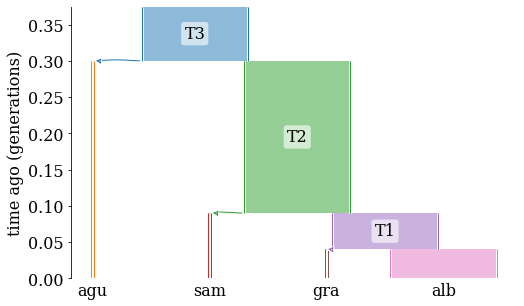

Demography(populations=[Population(initial_size=1000, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=40000, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=1000, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=1000, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=40000, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=0.04, initially_active=False, id=4), Population(initial_size=40000, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=0.09, initially_active=False, id=5), Population(initial_size=40000, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=0.3, initially_active=False, id=6)], events=[PopulationSplit(time=0.04, derived=['gra', 'alb'], ancestral='T1'), PopulationSplit(time=0.09, derived=['T1', 'sam'], ancestral='T2'), PopulationSplit(time=0.3, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.]]))

In [3]:
def demogr_model_0_2(t1,t2,t3,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne*40)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne*40)
    demography.add_population(name="T2", initial_size=Ne*40)
    demography.add_population(name="T3", initial_size=Ne*40)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    #demography.set_migration_rate("alb", "agu", mig_rate)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #demography.sort_events()
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    

    return demography

demogr_model_0_2(0.04,0.09,0.3,1000)

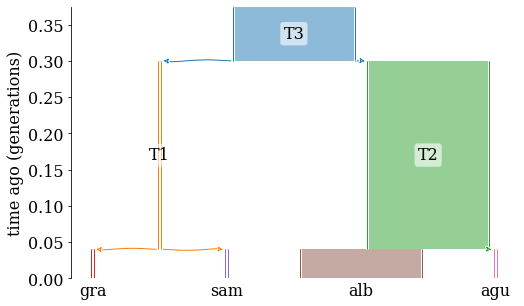

Demography(populations=[Population(initial_size=1000, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=1000, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=40000, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=1000, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=1000, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=0.04, initially_active=False, id=4), Population(initial_size=40000, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=0.04, initially_active=False, id=5), Population(initial_size=40000, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=0.3, initially_active=False, id=6)], events=[PopulationSplit(time=0.04, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=0.04, derived=['agu', 'alb'], ancestral='T2'), PopulationSplit(time=0.3, derived=['T2', 'T1'], ancestral='T3')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.]]))

In [17]:
def demogr_model_0_3(t1,t2,t3,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne*40)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne*40)
    demography.add_population(name="T3", initial_size=Ne*40)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t1, derived=["agu","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","T1"], ancestral="T3")
    
    #setting up gene flow
    #demography.set_migration_rate("gra", "alb", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_0_3(0.04,0.04,0.3,1000)

### Models with single gene flow

### Model 1.1

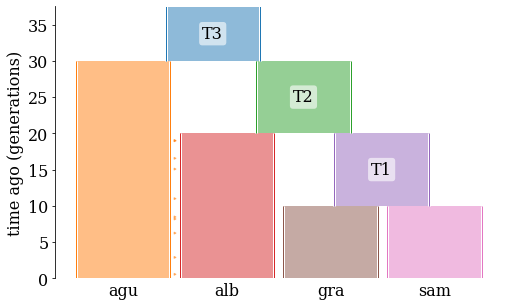

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'alb'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0.1, 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [10]:
def demogr_model_1_1(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model2(10,20,30,0.1,100)

### Model 1.2

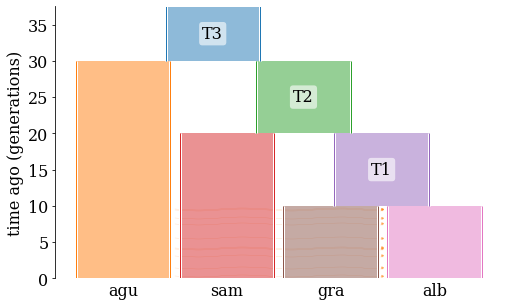

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'alb'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'sam'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0.1, 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [12]:
def demogr_model_1_2(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_1_2(10,20,30,0.1,100)

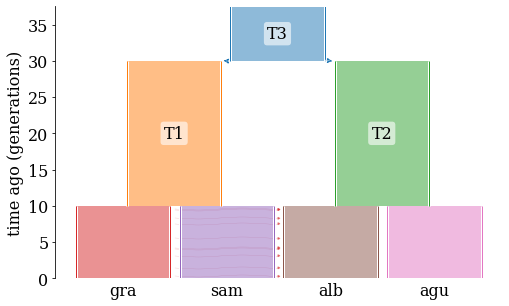

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=10, derived=['agu', 'alb'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'T1'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [13]:
def demogr_model_1_3(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t1, derived=["agu","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","T1"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_1_3(10,20,30,0.1,100)

### Model 1.5

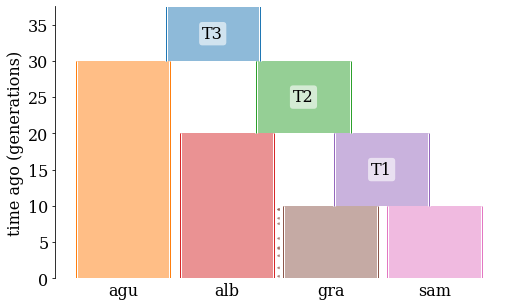

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'alb'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [14]:
def demogr_model_1_5(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_1_5(10,20,30,0.1,100)

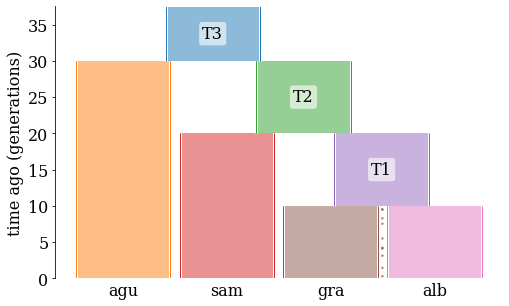

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'alb'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'sam'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [26]:
def demogr_model_1_6(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_1_6(10,20,30,0.1,100)

### Models with two gene flow events

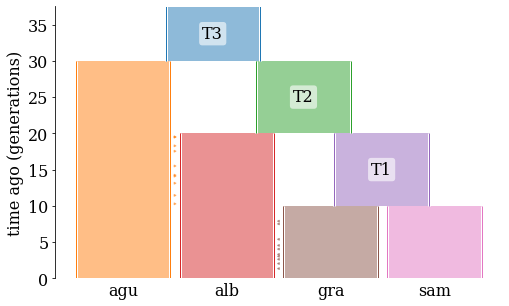

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[MigrationRateChange(time=10, rate=0.1, source='alb', dest='agu'), PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'alb'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [35]:
def demogr_model_2_1(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_migration_rate_change(time=t1,rate=mig_rate, source="alb", dest="agu")
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    #demography.add_migration_rate_change(time=t1,rate=0, source="alb", dest="agu")
    demography.add_population_split(time=t2, derived=["T1","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")

    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    demography.set_migration_rate("alb", "agu", 0)
    
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_2_1(10,20,30,0.1,100)

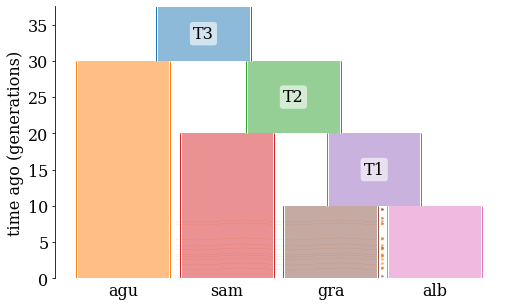

Demography(populations=[Population(initial_size=10, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=10, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=10, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=10, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=10, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=10, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=10, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'alb'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'sam'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0.1, 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [38]:
def demogr_model_2_2(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    #demography.add_migration_rate_change(time=t1,rate=mig_rate, source="alb", dest="agu")
    demography.add_population_split(time=t1, derived=["gra","alb"], ancestral="T1")
    #demography.add_migration_rate_change(time=t1,rate=0, source="alb", dest="agu")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")

    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_2_2(10,20,30,0.1,10)

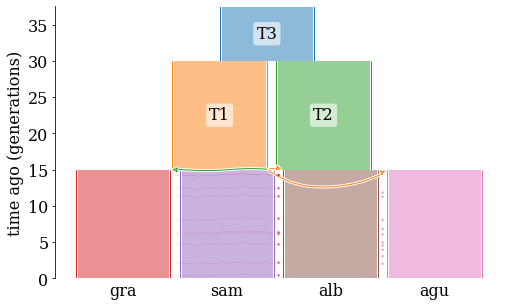

Demography(populations=[Population(initial_size=10, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=10, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=10, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=10, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=10, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=15, initially_active=False, id=4), Population(initial_size=10, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=15, initially_active=False, id=5), Population(initial_size=10, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=15, derived=['agu', 'alb'], ancestral='T1'), PopulationSplit(time=15, derived=['gra', 'sam'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'T1'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0.1, 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [48]:
def demogr_model_2_3(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["agu","alb"], ancestral="T1")
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","T1"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "gra", mig_rate)
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model_2_3(15,20,30,0.1,10)

### Example

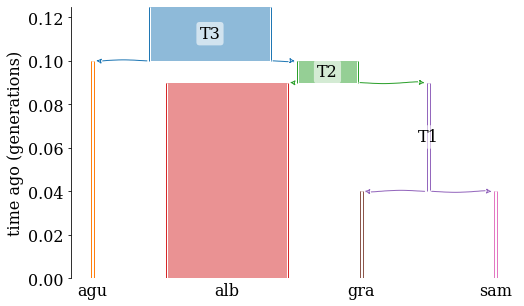

[ 58.  60. 123.  48.  49. 125.  56.  58. 110.  59.  43.  54.  48.  54.
  55.]


/Users/dshipilina/anaconda3/envs/dasha/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


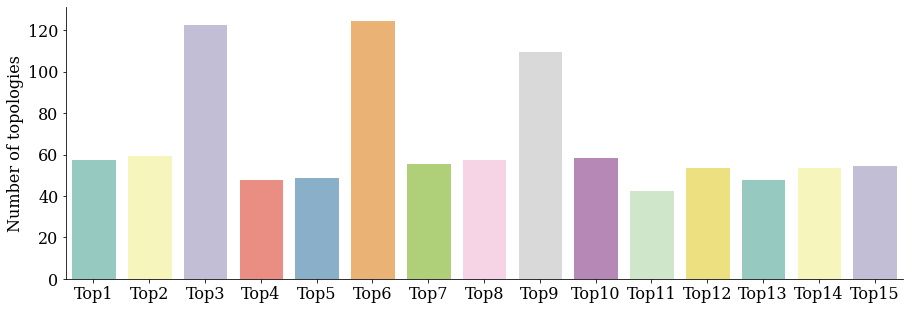

In [26]:
#Set number of simulations
num_replicates=1000

#Choose the model
demogr_model=demogr_model_0_1(0.04,0.09,0.1,1000)

#Output topologies
topology_count(num_replicates,demogr_model)

In [27]:
###PLEASE DO NOT RENAME VARIABLES

#Fix 19000
#Specify number of genealogies to simulate
#num_genealogies = 1000

#Choose the model
model = 'two_way'    # 'one_way', 'two_way'


#Provide divergence times
t1=100
t2=200
t3=300

#Provide migration rate
mig_rate=0.1

#Provide population sizes
#NeP1=100
#NeP2=200
#NeP3=50
#NeO=200
NeP12=300
NeP123=310
NeANC=500

Models #gene flow
#01 
#11 proportion of the branch leave as a parameter
#15 stop in the middle of the 
#21

#Move to python script

SyntaxError: leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (4289941208.py, line 29)

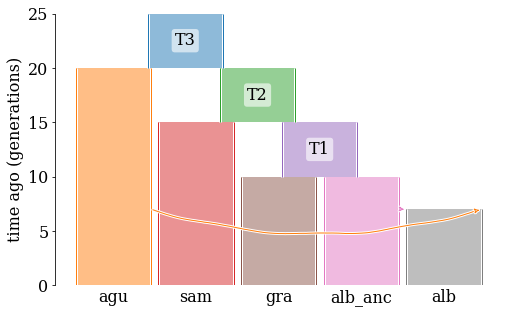

[ 51.  51. 106.  78.  73. 126.  49.  54.  94.  49.  66.  50.  44.  56.
  53.]


/Users/dshipilina/anaconda3/envs/dasha/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


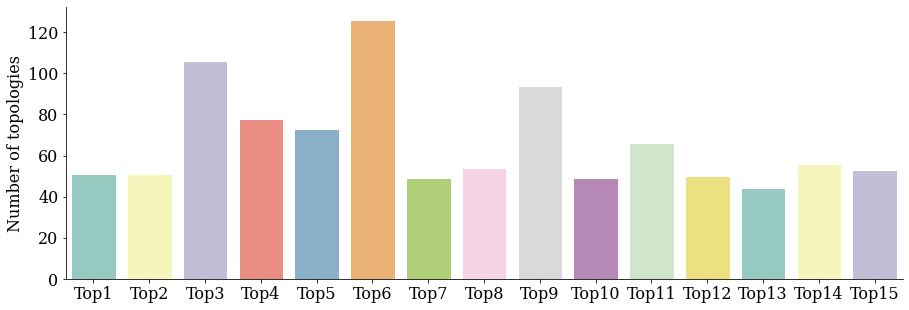

In [28]:
def demogr_model1(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="alb_anc", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #setting up admixture
    demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb_anc"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    #demography.set_migration_rate("alb", "agu", mig_rate)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #demography.sort_events()
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    

    return demography

#demogr_model1(10,15,20,0.1,100)
num_replicates=1000
windows=simulate_windows(num_replicates,demogr_model1(10,15,20,0.1,200))
ranks=produce_ranks(windows)

top1_count = np.zeros(15)
top1_count

rank_dict=collections.Counter(ranks)

for key, value in rank_dict.items():
    if key == (3,8):
        top1_count[0]+=value
    elif key == (3,11):
        top1_count[1]+=value
    elif key == (4,0):
        top1_count[2]+=value
    elif key == (3,6):
        top1_count[3]+=value
    elif key == (3,1):
        top1_count[4]+=value    
    elif key == (4,1):
        top1_count[5]+=value
    elif key == (3,9):
        top1_count[6]+=value
    elif key == (3,2):
        top1_count[7]+=value
    elif key == (4,2):
        top1_count[8]+=value
    elif key == (3,3):
        top1_count[9]+=value
    elif key == (3,5):
        top1_count[10]+=value
    elif key == (3,4):
        top1_count[11]+=value
    elif key == (3,7):
        top1_count[12]+=value
    elif key == (3,10):
        top1_count[13]+=value
    elif key == (3,0):
        top1_count[14]+=value
            
print(top1_count)
#bars=summarize_topolog(num_replicates,ranks)
#bars=summarize_topolog(num_replicates,ranks)
ml.rcParams['figure.figsize'] = (15.0, 5.0)
top_names=["Top1","Top2","Top3","Top4","Top5","Top6","Top7","Top8","Top9","Top10","Top11","Top12","Top13","Top14","Top15"]
g=sns.barplot(top_names, top1_count, palette = 'Set3', edgecolor = 'w')
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = True
#top_names=["Top1","Top2","Top3","2","2","3","15","2","1","7","14","10","2","2","2"]
#plt.xticks(rotation=90)
#plt.xlabel("Position along the chromosome")
plt.ylabel("Number of topologies")#color="#f5f5f5")
#g.set_xticklabels(["3","15","2","1","7","14","10"])
#plt.plot(summarize_topolog(ranks)) #, color='g')
plt.show()


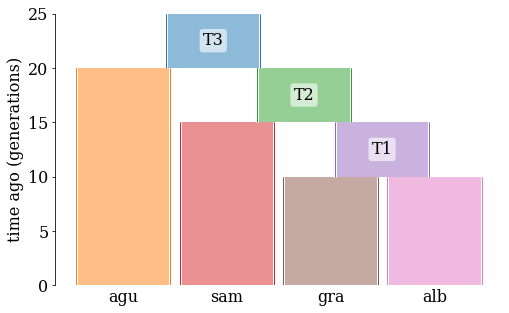

[ 58.  84. 115.  44.  54. 125.  56.  65. 101.  54.  54.  49.  40.  50.
  51.]


/Users/dshipilina/anaconda3/envs/dasha/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


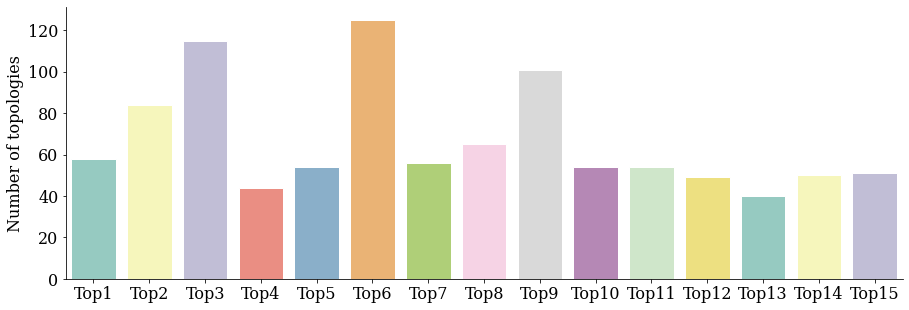

In [24]:
num_replicates=1000
windows=simulate_windows(num_replicates,demogr_model_0_2(10,15,20,200))
ranks=produce_ranks(windows)

top1_count = np.zeros(15)
#top1_count

rank_dict=collections.Counter(ranks)

for key, value in rank_dict.items():
    if key == (3,8):
        top1_count[0]+=value
    elif key == (3,11):
        top1_count[1]+=value
    elif key == (4,0):
        top1_count[2]+=value
    elif key == (3,6):
        top1_count[3]+=value
    elif key == (3,1):
        top1_count[4]+=value    
    elif key == (4,1):
        top1_count[5]+=value
    elif key == (3,9):
        top1_count[6]+=value
    elif key == (3,2):
        top1_count[7]+=value
    elif key == (4,2):
        top1_count[8]+=value
    elif key == (3,3):
        top1_count[9]+=value
    elif key == (3,5):
        top1_count[10]+=value
    elif key == (3,4):
        top1_count[11]+=value
    elif key == (3,7):
        top1_count[12]+=value
    elif key == (3,10):
        top1_count[13]+=value
    elif key == (3,0):
        top1_count[14]+=value
            
#print(top1_count)
#bars=summarize_topolog(num_replicates,ranks)
#bars=summarize_topolog(num_replicates,ranks)
ml.rcParams['figure.figsize'] = (15.0, 5.0)
top_names=["Top1","Top2","Top3","Top4","Top5","Top6","Top7","Top8","Top9","Top10","Top11","Top12","Top13","Top14","Top15"]
g=sns.barplot(top_names, top1_count, palette = 'Set3', edgecolor = 'w')
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = True
#top_names=["Top1","Top2","Top3","2","2","3","15","2","1","7","14","10","2","2","2"]
#plt.xticks(rotation=90)
#plt.xlabel("Position along the chromosome")
plt.ylabel("Number of topologies")#color="#f5f5f5")
#g.set_xticklabels(["3","15","2","1","7","14","10"])
#plt.plot(summarize_topolog(ranks)) #, color='g')
plt.show()

In [12]:
def simulate_windows(num_replicates,demography):
    ancestry_reps = msprime.sim_ancestry(samples={"gra": 1, "alb": 1, "sam": 1, "agu": 1}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/10000))
        yield mutated_ts


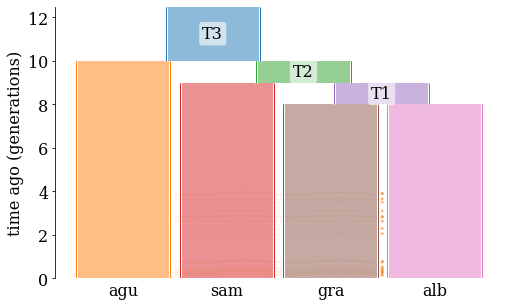

In [75]:
Ne=100
#initializing populations
demography = msprime.Demography()
demography.add_population(name="gra", initial_size=Ne)
demography.add_population(name="alb", initial_size=Ne)
demography.add_population(name="sam", initial_size=Ne)
demography.add_population(name="agu", initial_size=Ne)
demography.add_population(name="T1", initial_size=Ne)
demography.add_population(name="T2", initial_size=Ne)
demography.add_population(name="T3", initial_size=Ne)

#setting times of events
t1,t2,t3,t4,t5,t6=10,9,8,4,2,1
mig_rate=0.5

#adding split times
#demography.add_migration_parameters_change(t5,mig_rate,"alb", "agu")
#demography.set_migration_rate(t5,mig_rate,"alb","agu")
demography.add_migration_rate_change(time=t6,rate=0, source="alb", dest="agu")
demography.add_migration_rate_change(time=t5,rate=0.5, source="alb", dest="agu")
demography.add_migration_rate_change(time=t4,rate=0, source="alb", dest="agu")
#demography.set_migration_rate("alb", "agu", mig_rate)
#demography.add_migration_rate_change(time=t5,rate=0, source="alb", dest="agu")
#demography.add_migration_rate_change(time, *, rate, source=None, dest=None)
demography.add_population_split(time=t3, derived=["gra","alb"], ancestral="T1")
demography.set_migration_rate("alb", "agu", mig_rate)
demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
demography.add_population_split(time=t1, derived=["T2","agu"], ancestral="T3")


#setting up gene flow
#demography.set_migration_rate("alb", "agu", mig_rate)

#setting up admixture
#demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])

#demography.sort_events()

#Simultanious test
ml.rcParams['figure.figsize'] = (8.0, 5.0)
graph = msprime.Demography.to_demes(demography)
fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
demesdraw.tubes(graph, ax=ax, seed=1)
plt.show()

#add_migration_rate_change(time, *, rate, source=None, dest=None)


In [50]:
demography=0

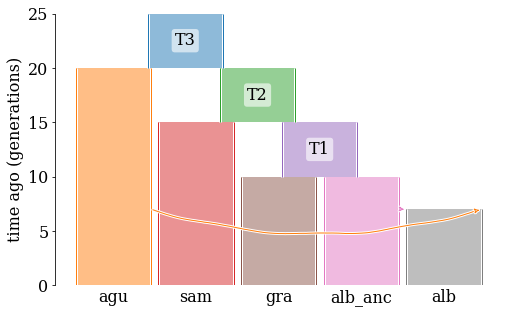

Demography(populations=[Population(initial_size=200, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=200, growth_rate=0, name='alb_anc', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=200, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=200, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=200, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=4), Population(initial_size=200, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=5), Population(initial_size=200, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=15, initially_active=False, id=6), Population(initial_size=200, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=7)], events=[Admixture(time=7, derived='alb', ancestral=['alb_anc', 'agu'], proportions=[0.25, 0.75]), PopulationSplit(time=10, derived=['gra', 'alb_anc'], ancestral='T1'), PopulationSplit(time=15, derived=['T1', 'sam'], ancestral='T2'), PopulationSplit(time=20, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0.]]))

In [44]:
def demogr_model1(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="alb_anc", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #set the aguimp individuals introgress into alba fully
    demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb_anc"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #demography.sort_events()
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    

    return demography

#demogr_model1(10,15,20,0.1,100)
demogr_model1(10,15,20,0.1,200)

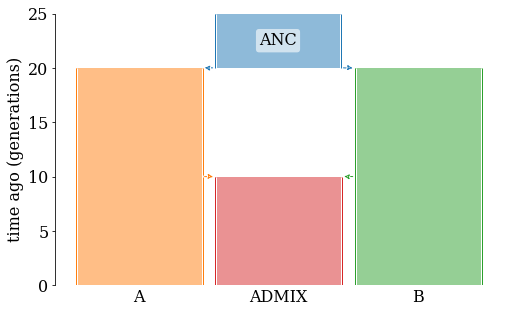

In [4]:
demography = msprime.Demography()
demography.add_population(name="A", initial_size=100)
demography.add_population(name="B", initial_size=100)
demography.add_population(name="ADMIX", initial_size=100)
demography.add_population(name="ANC", initial_size=100)
demography.add_admixture(time=10, derived="ADMIX", ancestral=["A", "B"], proportions=[0.25, 0.75])
demography.add_population_split(time=20, derived=["A", "B"], ancestral="ANC")

ml.rcParams['figure.figsize'] = (8.0, 5.0)
graph = msprime.Demography.to_demes(demography)
fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
demesdraw.tubes(graph, ax=ax, seed=1)
plt.show()

In [ ]:
def demogr_model1_s(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    '''
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    '''
    return demography

demogr_model1(10,20,30,0.1,100)

#Fix parameters from 

In [8]:
demography = msprime.Demography()
demography.add_population(name="A", initial_size=100)
demography.add_population(name="B", initial_size=100)
demography.add_population(name="ADMIX", initial_size=100)
demography.add_population(name="ANC", initial_size=100)
demography.add_admixture(
    time=10, derived="B", ancestral=["A", "B"], proportions=[0.25, 0.75])
demography.add_population_split(time=20, derived=["A", "B"], ancestral="ANC")

ml.rcParams['figure.figsize'] = (8.0, 5.0)
graph = msprime.Demography.to_demes(demography)
fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
demesdraw.tubes(graph, ax=ax, seed=1)
plt.show()

InputError: Input error in population split: Source and destination populations equal.

# August - October

In [ ]:
def demogr_model1(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="alb_anc", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #setting up admixture
    demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","alb_anc"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","sam"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    #demography.set_migration_rate("alb", "agu", mig_rate)
    
    #setting up admixture
    #demography.add_admixture(time=7, derived="alb", ancestral=["alb_anc", "agu"], proportions=[0.25, 0.75])
    
    #demography.sort_events()
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()
    

    return demography

#demogr_model1(10,15,20,0.1,100)
num_replicates=1000
windows=simulate_windows(num_replicates,demogr_model1(10,15,20,0.1,200))
ranks=produce_ranks(windows)

top1_count = np.zeros(15)
top1_count

rank_dict=collections.Counter(ranks)

for key, value in rank_dict.items():
    if key == (3,8):
        top1_count[0]+=value
    elif key == (3,11):
        top1_count[1]+=value
    elif key == (4,0):
        top1_count[2]+=value
    elif key == (3,6):
        top1_count[3]+=value
    elif key == (3,1):
        top1_count[4]+=value    
    elif key == (4,1):
        top1_count[5]+=value
    elif key == (3,9):
        top1_count[6]+=value
    elif key == (3,2):
        top1_count[7]+=value
    elif key == (4,2):
        top1_count[8]+=value
    elif key == (3,3):
        top1_count[9]+=value
    elif key == (3,5):
        top1_count[10]+=value
    elif key == (3,4):
        top1_count[11]+=value
    elif key == (3,7):
        top1_count[12]+=value
    elif key == (3,10):
        top1_count[13]+=value
    elif key == (3,0):
        top1_count[14]+=value
            
print(top1_count)
#bars=summarize_topolog(num_replicates,ranks)
#bars=summarize_topolog(num_replicates,ranks)
ml.rcParams['figure.figsize'] = (15.0, 5.0)
top_names=["Top1","Top2","Top3","Top4","Top5","Top6","Top7","Top8","Top9","Top10","Top11","Top12","Top13","Top14","Top15"]
g=sns.barplot(top_names, top1_count, palette = 'Set3', edgecolor = 'w')
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = True
#top_names=["Top1","Top2","Top3","2","2","3","15","2","1","7","14","10","2","2","2"]
#plt.xticks(rotation=90)
#plt.xlabel("Position along the chromosome")
plt.ylabel("Number of topologies")#color="#f5f5f5")
#g.set_xticklabels(["3","15","2","1","7","14","10"])
#plt.plot(summarize_topolog(ranks)) #, color='g')
plt.show()



### Model #2

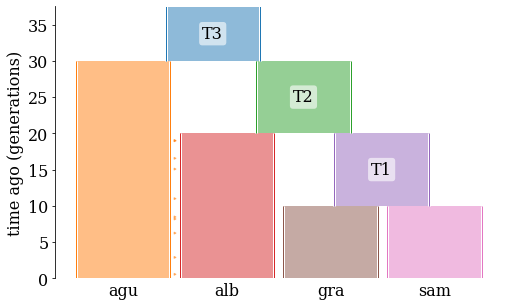

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=20, derived=['T1', 'alb'], ancestral='T2'), PopulationSplit(time=30, derived=['T2', 'agu'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0.1, 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [72]:
def demogr_model2(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t2, derived=["T1","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","agu"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("alb", "agu", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model2(10,20,30,0.1,100)

### Model #3

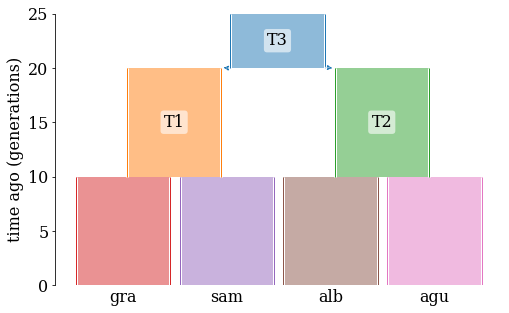

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=10, derived=['agu', 'alb'], ancestral='T2'), PopulationSplit(time=20, derived=['T2', 'T1'], ancestral='T3')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.]]))

In [153]:
def demogr_model3(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t1, derived=["agu","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","T1"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("gra", "alb", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model3(10,10,20,0,100)

### Model #4

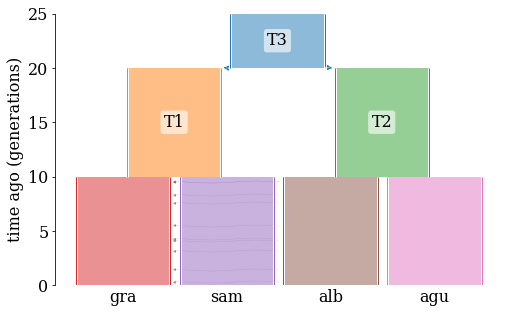

Demography(populations=[Population(initial_size=100, growth_rate=0, name='gra', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='sam', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='alb', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='agu', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='T1', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='T2', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='T3', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['gra', 'sam'], ancestral='T1'), PopulationSplit(time=10, derived=['agu', 'alb'], ancestral='T2'), PopulationSplit(time=20, derived=['T2', 'T1'], ancestral='T3')], migration_matrix=array([[0. , 0. , 0.7, 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [29]:
def demogr_model4(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="gra", initial_size=Ne)
    demography.add_population(name="sam", initial_size=Ne)
    demography.add_population(name="alb", initial_size=Ne)
    demography.add_population(name="agu", initial_size=Ne)
    demography.add_population(name="T1", initial_size=Ne)
    demography.add_population(name="T2", initial_size=Ne)
    demography.add_population(name="T3", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["gra","sam"], ancestral="T1")
    demography.add_population_split(time=t1, derived=["agu","alb"], ancestral="T2")
    demography.add_population_split(time=t3, derived=["T2","T1"], ancestral="T3")
    
    #setting up gene flow
    demography.set_migration_rate("gra", "alb", mig_rate)
    
    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

demogr_model4(10,10,20,0.7,100)

### Setting up simulations

`simulate_windows(num_replicates,demography)`

Simulates one window with length 50000 (50kb).  
Simulation consists of two steps. First creates ancestry of the sample. One haploid individual is sampled from each of the populations (((P1,P2),P3),O). The second step adds mutations with the rate **1/10000**

> Note: We assume no recombination within the window, recombination is not included in the simulation

Parameters to specify are:
- `num_replicates`
- `demography` can be specified using functions above

In [152]:
def simulate_windows(num_replicates,demography):
    ancestry_reps = msprime.sim_ancestry(samples={"agu": 1, "alb": 1, "gra": 1, "sam": 1}, 
                                         demography=demography, sequence_length=50000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/100000))
        yield mutated_ts

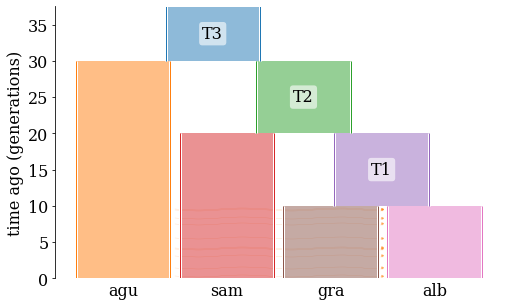

Number of mutations on the tree 27


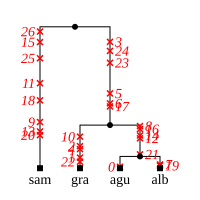

Number of mutations on the tree 62


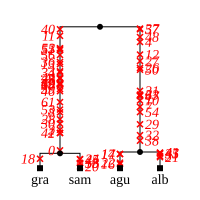

Number of mutations on the tree 21


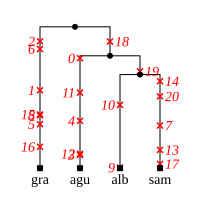

In [45]:
num_replicates = 3
windows=simulate_windows(num_replicates,demogr_model1(10,20,30,0.7,100))
for replicate_index, ts in enumerate(windows):
    for t in ts.trees():
        print("Number of mutations on the tree "+str(t.num_mutations))
        display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 200))))

### Summarizing tree sequences, topology weighting plot

Simulations above will output replicates of tree sequences (all in one iterable object). In this section we develop the way to efficiently output the result of simulation and calculate values for ternary plots.

Simple simulation outputs the tree sequence object:

Information about tree topologies, which are compactly stored in "rank" parameter. See tskit manual for the details: https://tskit.dev/tskit/docs/latest/topological-analysis.html

Below we visualize ranks corresponding to names on Figure 4 of the manuscript:

Topology 1 = rank (3,8)


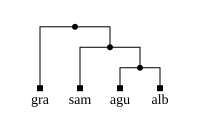

Topology 2 = rank (3,11)


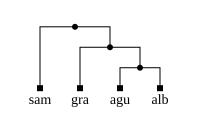

Topology 3 = rank (4,0)


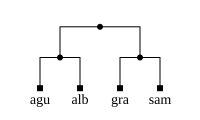

Topology 7 = rank (3,9)


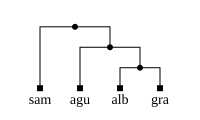

Topology 10 = rank (3,3)


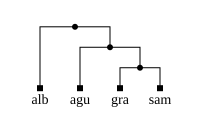

Topology 14 = rank (3,10)


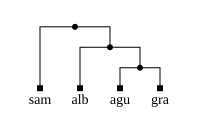

Topology 15 = rank (3,0)


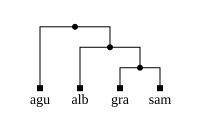

Topology 5 = rank (3,1)


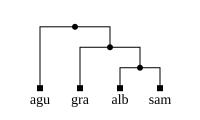

Topology 8 = rank (3,2)


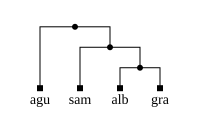

Topology 12 = rank (3,4)


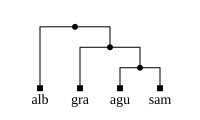

Topology 11 = rank (3,5)


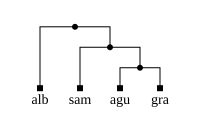

Topology 4 = rank (3,6)


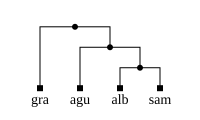

Topology 13 = rank (3,7)


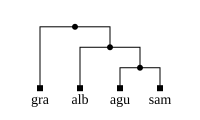

Topology 6 = rank (4,1)


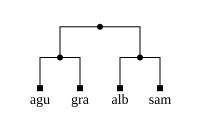

Topology 9 = rank (4,2)


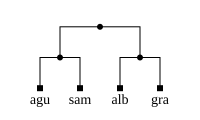

In [5]:
print("Topology 1 = rank (3,8)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,8))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 2 = rank (3,11)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,11))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 3 = rank (4,0)")
t = tskit.Tree.unrank(num_leaves=4, rank=(4,0))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 7 = rank (3,9)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,9))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 10 = rank (3,3)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,3))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 14 = rank (3,10)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,10))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 15 = rank (3,0)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,0))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 5 = rank (3,1)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,1))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 8 = rank (3,2)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,2))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 12 = rank (3,4)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,4))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 11 = rank (3,5)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,5))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 4 = rank (3,6)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,6))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 13 = rank (3,7)")
t = tskit.Tree.unrank(num_leaves=4, rank=(3,7))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 6 = rank (4,1)")
t = tskit.Tree.unrank(num_leaves=4, rank=(4,1))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

print("Topology 9 = rank (4,2)")
t = tskit.Tree.unrank(num_leaves=4, rank=(4,2))
display(SVG(t.draw_svg(node_labels={0: "agu", 1: "alb", 2: "gra", 3 : "sam"}, order="tree", size=(200, 120))))

Next we gather rank information from all the iterations: 

`produce_ranks` outputs ranks from all simulated windows

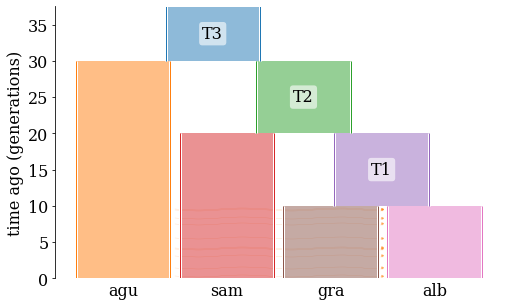

[(3, 0),
 (3, 11),
 (4, 2),
 (3, 10),
 (4, 2),
 (4, 2),
 (4, 0),
 (3, 3),
 (3, 7),
 (4, 1)]

In [75]:
windows=simulate_windows(10,demogr_model1(10,20,30,0.7,100))
produce_ranks(windows)

In [ ]:
def summarize_topolog(num_replicates,ranks):    
    top1_count = range(3)
    top2_count = 0
    top3_count = 0
    top4_count = 0
    top5_count = 0
    top6_count = 0
    top7_count = 0
    top8_count = 0
    top9_count = 0
    top10_count = 0
    top11_count = 0
    top12_count = 0
    top13_count = 0
    top14_count = 0
    top15_count = 0

    rank_dict=collections.Counter(ranks)

    for key, value in rank_dict.items():
        if key == (3,8):
            top1_count+=value
        elif key == (3,11):
            top2_count+=value
        elif key == (4,0):
            top3_count+=value
        elif key == (3,6):
            top4_count+=value
        elif key == (3,9):
            top7_count+=value
        elif key == (3,3):
            top10_count+=value
        elif key == (3,10):
            top14_count+=value
        elif key == (3,0):
            top15_count+=value
            
    
            
    #print([top3_count,top15_count,top2_count,top1_count,top7_count,top14_count,top10_count])
    return [top3_count,top15_count,top2_count,top1_count,top7_count,top14_count,top10_count]
    #return [(top3_count/num_replicates)*100, top15_count/num_replicates*100, top2_count/num_replicates*100]
    #return count_array

In [22]:
top1_count = np.zeros(15)
top1_count

rank_dict=collections.Counter(ranks)

for key, value in rank_dict.items():
    if key == (3,8):
        top1_count[0]+=value
    elif key == (3,11):
        top1_count[1]+=value
    elif key == (4,0):
        top1_count[2]+=value
    elif key == (3,6):
        top1_count[3]+=value
    elif key == (3,1):
        top1_count[4]+=value    
    elif key == (4,1):
        top1_count[5]+=value
    elif key == (3,9):
        top1_count[6]+=value
    elif key == (3,2):
        top1_count[7]+=value
    elif key == (4,2):
        top1_count[8]+=value
    elif key == (3,3):
        top1_count[9]+=value
    elif key == (3,5):
        top1_count[10]+=value
    elif key == (3,4):
        top1_count[11]+=value
    elif key == (3,7):
        top1_count[12]+=value
    elif key == (3,10):
        top1_count[13]+=value
    elif key == (3,0):
        top1_count[14]+=value
            
print(top1_count)

[ 7.  6.  9.  4.  7. 11.  8.  3. 14.  7.  7.  5.  3.  2.  7.]


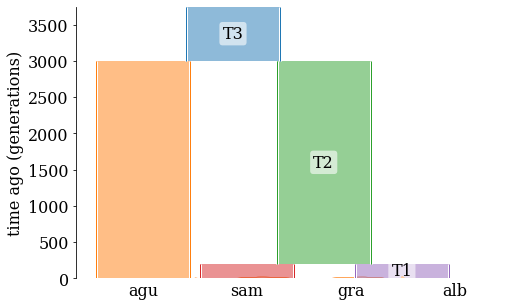

/Users/dshipilina/anaconda3/envs/dasha/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


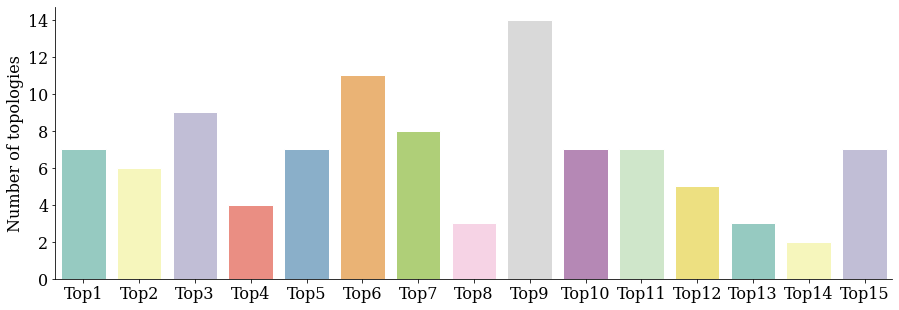

In [39]:
num_replicates=1000
windows=simulate_windows(num_replicates,demogr_model1(10,200,3000,0.2,100))
ranks=produce_ranks(windows)
#bars=summarize_topolog(num_replicates,ranks)
#bars=summarize_topolog(num_replicates,ranks)
ml.rcParams['figure.figsize'] = (15.0, 5.0)
top_names=["Top1","Top2","Top3","Top4","Top5","Top6","Top7","Top8","Top9","Top10","Top11","Top12","Top13","Top14","Top15"]
g=sns.barplot(top_names, top1_count, palette = 'Set3', edgecolor = 'w')
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = True
#top_names=["Top1","Top2","Top3","2","2","3","15","2","1","7","14","10","2","2","2"]
#plt.xticks(rotation=90)
#plt.xlabel("Position along the chromosome")
plt.ylabel("Number of topologies")#color="#f5f5f5")
#g.set_xticklabels(["3","15","2","1","7","14","10"])
#plt.plot(summarize_topolog(ranks)) #, color='g')
plt.show()

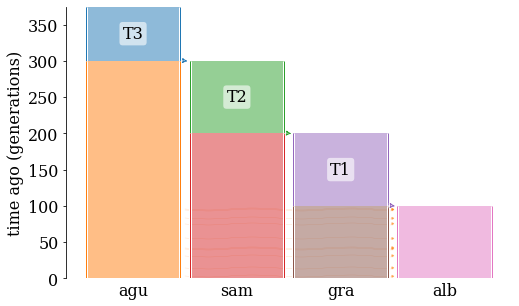

/Users/dshipilina/anaconda3/envs/dasha/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


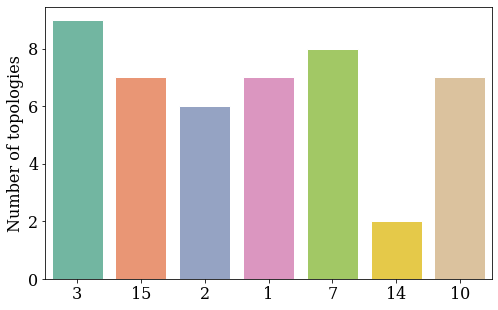

In [11]:
def summarize_topolog(num_replicates,ranks):    
    topo_weight= 0
    top1_count = 0
    top2_count = 0
    top3_count = 0
    top4_count = 0
    top5_count = 0
    top6_count = 0
    top7_count = 0
    top8_count = 0
    top9_count = 0
    top10_count = 0
    top11_count = 0
    top12_count = 0
    top13_count = 0
    top14_count = 0
    top15_count = 0

    rank_dict=collections.Counter(ranks)

    for key, value in rank_dict.items():
        if key == (3,8):
            top1_count+=value
        elif key == (3,11):
            top2_count+=value
        elif key == (4,0):
            top3_count+=value
        elif key == (3,6):
            top4_count+=value
        elif key == (3,9):
            top7_count+=value
        elif key == (3,3):
            top10_count+=value
        elif key == (3,10):
            top14_count+=value
        elif key == (3,0):
            top15_count+=value
            
    #print([top3_count,top15_count,top2_count,top1_count,top7_count,top14_count,top10_count])
    return [top3_count,top15_count,top2_count,top1_count,top7_count,top14_count,top10_count]
    #return [(top3_count/num_replicates)*100, top15_count/num_replicates*100, top2_count/num_replicates*100]
    #return count_array
    
num_replicates=100
windows=simulate_windows(num_replicates,demogr_model1(100,200,300,0.1,10000))
ranks=produce_ranks(windows)
bars=summarize_topolog(num_replicates,ranks)

g=sns.barplot(np.arange(7), bars, palette = 'Set2', edgecolor = 'w')
plt.rcParams['axes.spines.left'] = True
plt.rcParams['axes.spines.right'] = False
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.bottom'] = True
#plt.xticks(rotation=90)
#plt.xlabel("Position along the chromosome")
plt.ylabel("Number of topologies")#color="#f5f5f5")
g.set_xticklabels(["3","15","2","1","7","14","10"])
#plt.plot(summarize_topolog(ranks)) #, color='g')
plt.show()

In [120]:
print(np.arange(7)

[0 1 2 3 4 5 6]


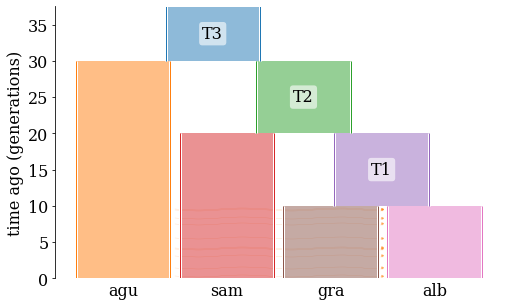

[(3, 0), (3, 9), (4, 2), (3, 8), (3, 9), (4, 0), (4, 1), (3, 11), (4, 0), (3, 8)]
dict_keys([(3, 0), (3, 9), (4, 2), (3, 8), (4, 0), (4, 1), (3, 11)])
dict_values([1, 2, 1, 2, 2, 1, 1])


TypeError: bar() missing 1 required positional argument: 'height'

In [94]:
windows=simulate_windows(10,demogr_model1(10,20,30,0.7,100))
ranks=produce_ranks(windows)
print(ranks)

dictionary =collections.Counter(ranks)
print(dictionary.keys())
print(dictionary.values())

plt.bar(dictionary.values(), color='g')
plt.show()

#topo_sum=[]
#for i in range(5):
#    ranks=produce_ranks(simulate_windows(10,demogr_model1(10,20,30,0.7,100)))
#    print(summarize_ranks(100,ranks))
#    topo_sum.append(summarize_ranks(100,ranks))

In [73]:
dictionary

Counter()

In [76]:
produce_ranks(windows)

[]

`summarize_ranks(num_replicates,ranks)`   
Counts three types of topologies and produces a vector  
`[%topology r,%topology s,%topology c]` 

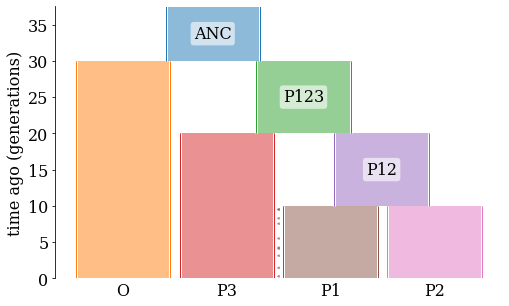

[25.0, 36.0, 39.0]

In [123]:
ranks=produce_ranks(simulate_windows(100,set_demography(10,20,30,0.1,100)))
summarize_ranks(100,ranks)    

`tern_plot(data)`

Plots a ternary graph given the data in format `three_points=[[33,33,33],[0,100,0],[70,10,20]]`

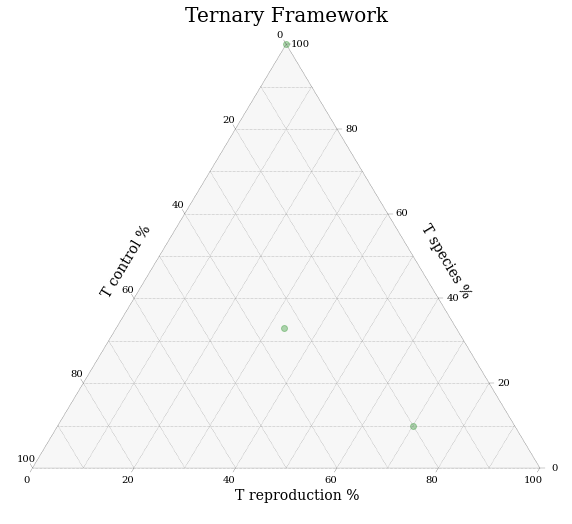

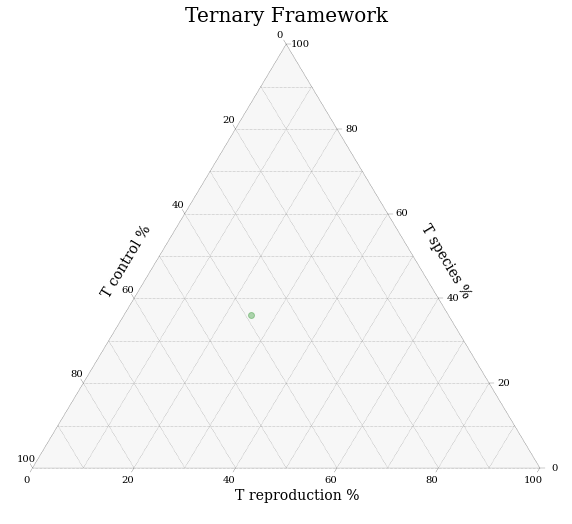

In [126]:
tern_plot([[33,33,33],[0,100,0],[70,10,20]])
tern_plot([summarize_ranks(100,ranks)])

### Creating data set

We can now combine functions above and generate multiple data points:

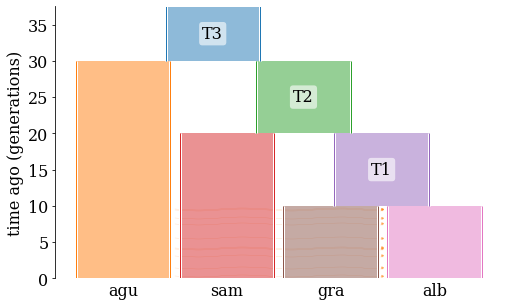

[3.0, 5.0, 2.0]


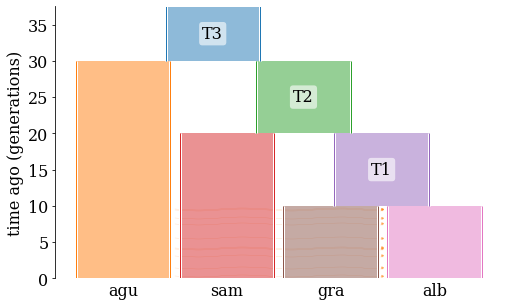

[1.0, 6.0, 3.0]


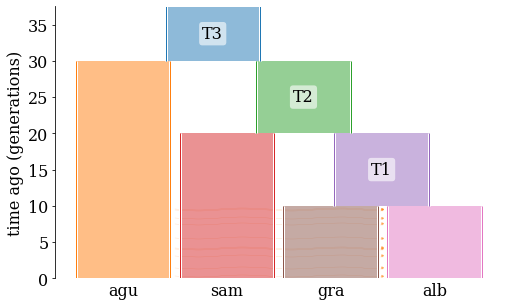

[1.0, 6.0, 3.0]


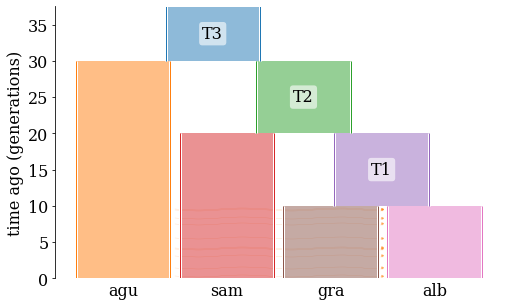

[1.0, 7.000000000000001, 2.0]


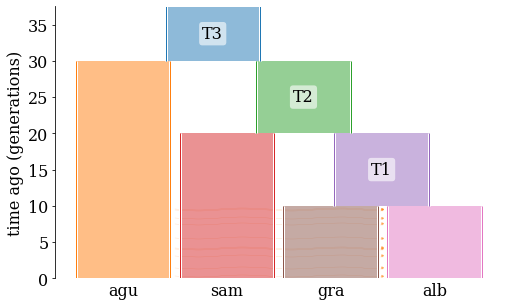

[2.0, 7.000000000000001, 1.0]
[[3.0, 5.0, 2.0], [1.0, 6.0, 3.0], [1.0, 6.0, 3.0], [1.0, 7.000000000000001, 2.0], [2.0, 7.000000000000001, 1.0]]


In [67]:
topo_sum=[]
for i in range(5):
    ranks=produce_ranks(simulate_windows(10,demogr_model1(10,20,30,0.7,100)))
    print(summarize_ranks(100,ranks))
    topo_sum.append(summarize_ranks(100,ranks))
    
print(topo_sum)

We can now generalize this into one function and silence visualization of the model

`make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)`  
    All the arguments like before

[[32.0, 35.0, 33.0]]


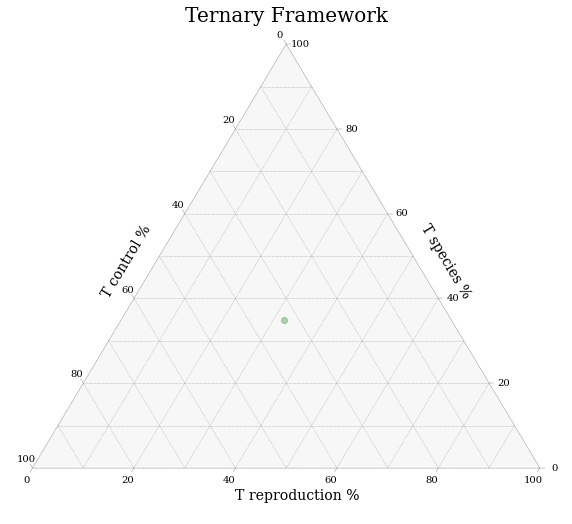

In [32]:
num_data_points=1
num_replicates=100
t1=10
t2=20
t3=30
Ne=1000
mig_rate=0.6

data=make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)
print(data)

#Option to save raw outputs
#f = open("/Users/dshipilina/GitHub/LittorinaBrooding/results.tsv", "x")
#f.write(str(data))
#f.close()

tern_plot(data)

## Analysis

We start from model without the gene flow and visualize influence of the split time: 

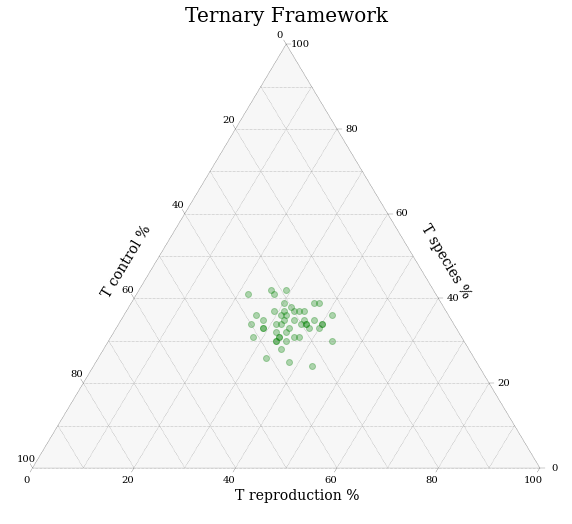

In [33]:
num_data_points=50
num_replicates=100
t1=10
t2=20
t3=30
Ne=1000
mig_rate=0

data=make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)
#print(data)

#Option to save raw outputs
#f = open("/Users/dshipilina/GitHub/LittorinaBrooding/results.tsv", "x")
#f.write(str(data))
#f.close()

tern_plot(data)
#Option to save plot
#plt.savefig("/Users/dshipilina/GitHub/LittorinaBrooding/null10_20_120_"+run_name+".pdf",bbox_inches="tight")

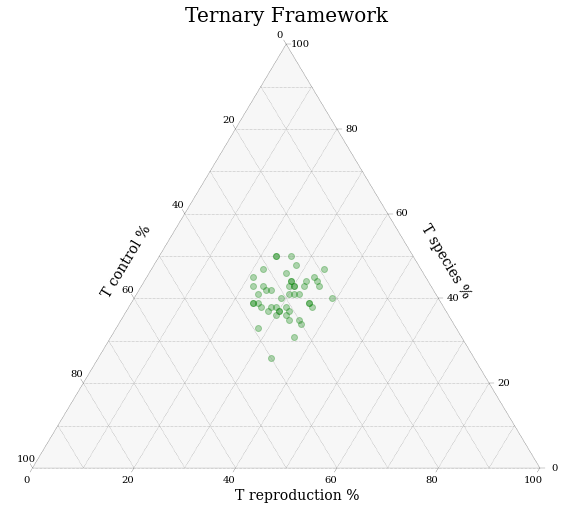

In [36]:
#Increasing the split times proportionally

num_data_points=50
num_replicates=100
t1=100
t2=200
t3=300
Ne=1000
mig_rate=0

data=make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)
tern_plot(data)

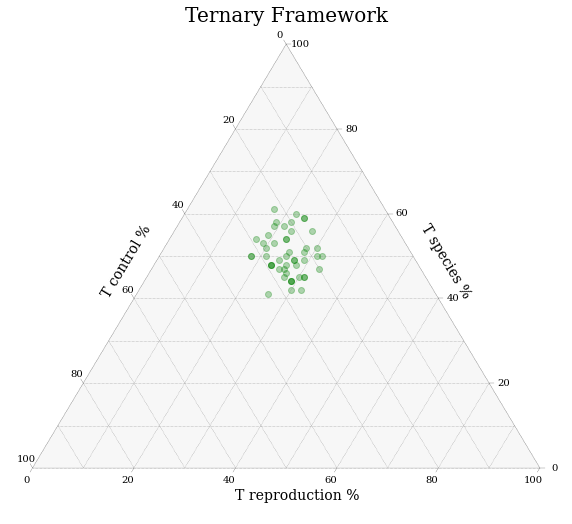

In [38]:
#Increasing the split times proportionally

num_data_points=50
num_replicates=100
t1=100
t2=400
t3=500
Ne=1000
mig_rate=0

data=make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)
tern_plot(data)

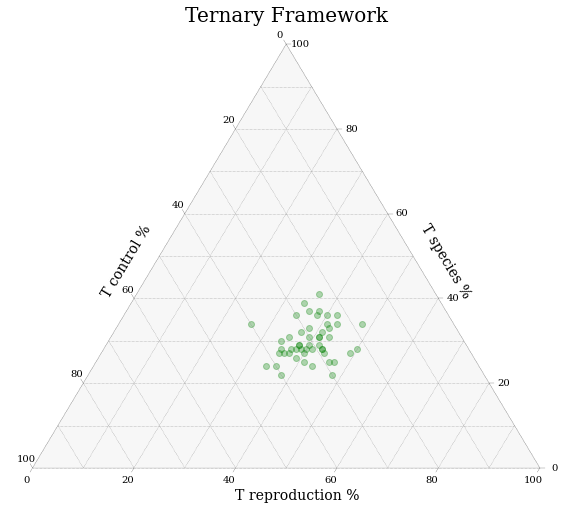

In [39]:
#Adding gene flow

num_data_points=50
num_replicates=100
t1=100
t2=200
t3=500
Ne=1000
mig_rate=0.6

data=make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate)
tern_plot(data)

# OLD: Summarizing topologies

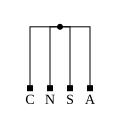

(0, 0)


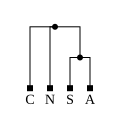

(1, 0)


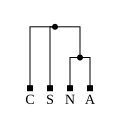

(1, 1)


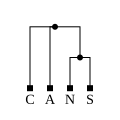

(1, 2)


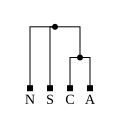

(1, 3)


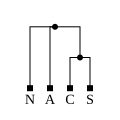

(1, 4)


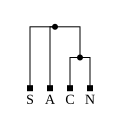

(1, 5)


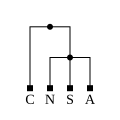

(2, 0)


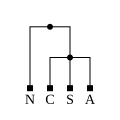

(2, 1)


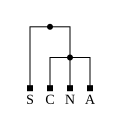

(2, 2)


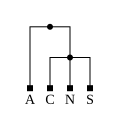

(2, 3)


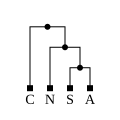

(3, 0)


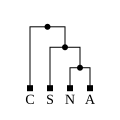

(3, 1)


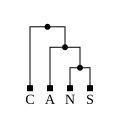

(3, 2)


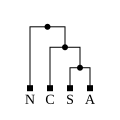

(3, 3)


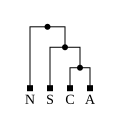

(3, 4)


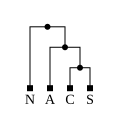

(3, 5)


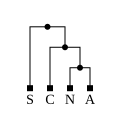

(3, 6)


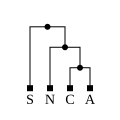

(3, 7)


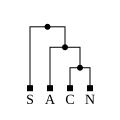

(3, 8)


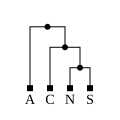

(3, 9)


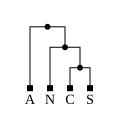

(3, 10)


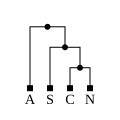

(3, 11)


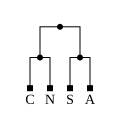

(4, 0)


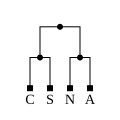

(4, 1)


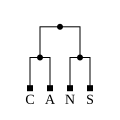

(4, 2)


In [3]:
#Visualizing topologies
for t in tskit.all_trees(num_leaves=4):
    display(SVG(t.draw_svg(node_labels={0: "C", 1: "N", 2: "S",3:"A"}, order="tree", size=(120, 120))))
    print(t.rank())

#### Function: produce ranks

In [18]:
def produce_ranks(ts_reps):
    ranks=[]
    for replicate_index, ts in enumerate(ts_reps):
        for t in ts.trees():
            ranks+=[t.rank()]
        
    return ranks
    
produce_ranks(sim_null_model(50))

[(3, 11),
 (3, 10),
 (4, 1),
 (4, 1),
 (3, 3),
 (4, 0),
 (3, 9),
 (3, 3),
 (4, 0),
 (4, 0),
 (3, 11),
 (3, 2),
 (3, 3),
 (3, 10),
 (3, 1),
 (4, 1),
 (4, 2),
 (4, 0),
 (4, 0),
 (4, 0),
 (3, 0),
 (3, 8),
 (3, 9),
 (4, 1),
 (3, 4),
 (3, 11),
 (3, 5),
 (3, 5),
 (3, 6),
 (3, 11),
 (4, 1),
 (3, 10),
 (3, 8),
 (3, 10),
 (4, 2),
 (4, 0),
 (4, 2),
 (3, 5),
 (3, 9),
 (3, 11),
 (3, 9),
 (3, 11),
 (3, 7),
 (3, 2),
 (3, 8),
 (3, 11),
 (3, 9),
 (4, 1),
 (4, 0),
 (4, 0)]

In [51]:
ranks_sample=produce_ranks(sim_null_model(n_subtrees))

NameError: name 'sim_null_model' is not defined

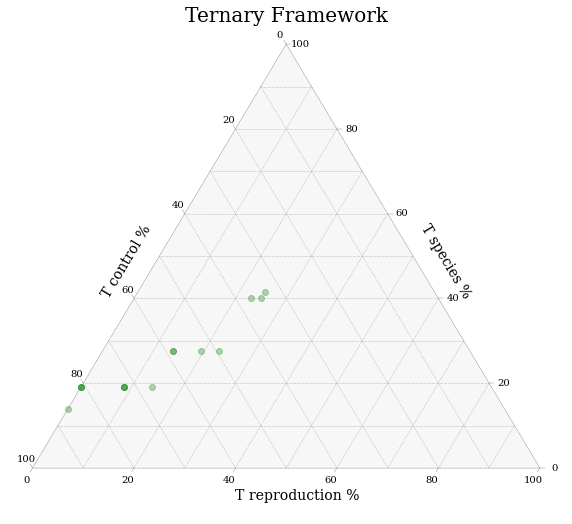

In [34]:
topo_weight=[]
topS_count = []
topC_count = []
topR_count = []

rank_dict=collections.Counter(ranks_sample)
    
for key, value in rank_dict.items():
        #print(key, value)
    if key == (4,0) or key == (3,11) or key == (3,8) or key == (3,0) or key == (3,3):
            #print("yay")#TOPOLOGY S
            #print(key)
        topS_count.append(value)
        #TOPOLOGY S
    elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
        topC_count.append(value)
        # TOPOLOGY C
    else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
        topR_count.append(value)
        # TOPOLOGY R

    #one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    #print(sum(topS_count), sum(topC_count),sum(topR_count))
    #one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
    #print((sum(topS_count)/n_subtrees)*100, sum(topC_count)/n_subtrees*100, sum(topR_count)/n_subtrees*100)
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    #print(one_value)
    topo_weight.append(one_value)
    
tern_plot(topo_weight)

### Null model analysis

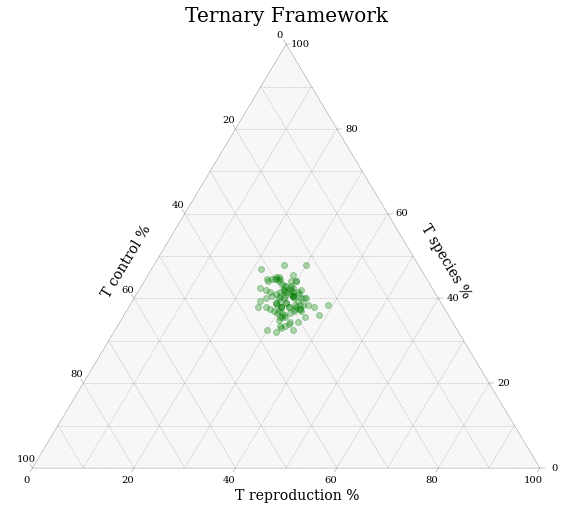

In [31]:
run_name="t5_t10_t20"
n_subtrees=200
topo_weight=[]
for _ in range(100):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model_flex(n_subtrees,10,20,1000
                                                                   )))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            #print("yay")#TOPOLOGY S
            #print(key)
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R

    #one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    #print(sum(topS_count), sum(topC_count),sum(topR_count))
    #one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
    #print((sum(topS_count)/n_subtrees)*100, sum(topC_count)/n_subtrees*100, sum(topR_count)/n_subtrees*100)
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    #print(one_value)
    topo_weight.append(one_value)
tern_plot(topo_weight)
#plt.savefig("/Users/dshipilina/GitHub/LittorinaBrooding/null_"+run_name+".pdf",bbox_inches="tight")

### Visualizing split time differences

t10_t100_t120


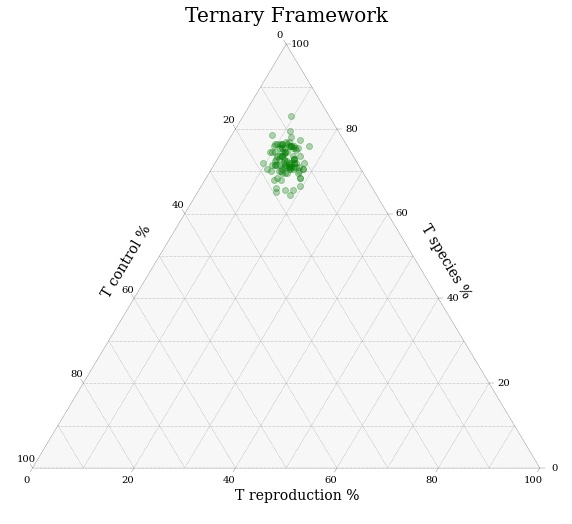

In [40]:
t12=10
t23=100
t34=120

run_name="t"+str(t12)+"_t"+str(t23)+"_t"+str(t34)
print(run_name)
n_subtrees=200
topo_weight=[]
for _ in range(100):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model_flex(n_subtrees,t12,t23,t34)))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            #print("yay")#TOPOLOGY S
            #print(key)
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R
        
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    topo_weight.append(one_value)
    
    
tern_plot(topo_weight)
plt.savefig("/Users/dshipilina/GitHub/LittorinaBrooding/null_"+run_name+".pdf",bbox_inches="tight")

### Visualizing Ne differences

Ne10_Ne100_Ne100_Ne1000


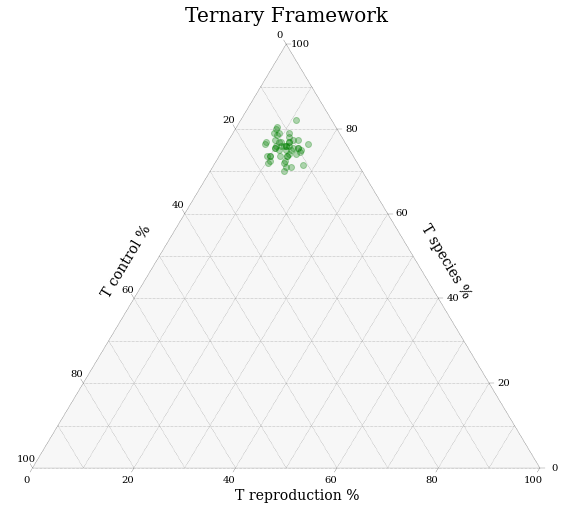

In [48]:
NeA=10
NeB=100
NeC=100
NeD=1000

run_name="Ne"+str(NeA)+"_Ne"+str(NeB)+"_Ne"+str(NeC)+"_Ne"+str(NeD)
print(run_name)
n_subtrees=200
topo_weight=[]
for _ in range(50):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model_Ne(n_subtrees,NeA,NeB,NeC,NeD)))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            #print("yay")#TOPOLOGY S
            #print(key)
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R
        
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    topo_weight.append(one_value)
    
    
tern_plot(topo_weight)
plt.savefig("/Users/dshipilina/GitHub/LittorinaBrooding/null10_20_120_"+run_name+".pdf",bbox_inches="tight")

5 1 4
8 2 0
6 2 2
3 3 4
4 3 3
7 0 3
5 3 2
4 3 3
3 1 6
4 2 4


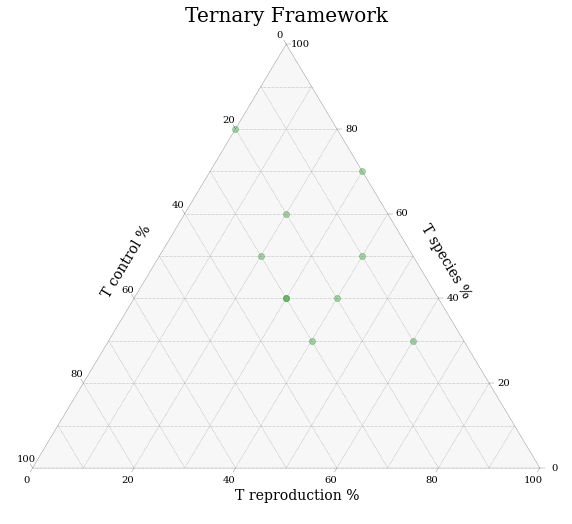

In [50]:
n_subtrees=10
topo_weight=[]

for _ in range(10):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model(n_subtrees)))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else: #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R

    #one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    print(sum(topS_count), sum(topC_count),sum(topR_count))
    #one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
    #print((sum(topS_count)/n_subtrees)*100, sum(topC_count)/n_subtrees*100, sum(topR_count)/n_subtrees*100)
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    #print(one_value)
    topo_weight.append(one_value)
tern_plot(topo_weight)

33 34 33
35 35 30
42 28 30
51 18 31
38 27 35
47 28 25
37 26 37
41 25 34
29 34 37
34 34 32
46 23 31
37 32 31
38 25 37
39 29 32
47 23 30
38 32 30
42 35 23
38 27 35
48 28 24
38 36 26
39 36 25
45 29 26
37 27 36
38 36 26
37 32 31
39 25 36
38 33 29
40 19 41
38 29 33
33 36 31
39 25 36
33 40 27
34 28 38
40 29 31
43 25 32
38 26 36
35 31 34
34 34 32
45 27 28
47 26 27
39 31 30
36 39 25
41 28 31
35 25 40
44 29 27
44 36 20
43 28 29
36 30 34
39 31 30
40 24 36
46 28 26
45 35 20
36 31 33
34 38 28
43 32 25
42 33 25
41 30 29
39 34 27
42 33 25
40 21 39
42 30 28
39 32 29
50 27 23
40 34 26
39 27 34
43 21 36
40 30 30
46 27 27
30 33 37
48 29 23
38 28 34
39 25 36
39 35 26
37 33 30
40 39 21
36 32 32
39 27 34
35 30 35
38 28 34
43 26 31
43 26 31
36 33 31
31 28 41
43 26 31
50 27 23
51 26 23
41 32 27
45 29 26
39 30 31
30 37 33
38 36 26
38 35 27
36 36 28
53 23 24
37 27 36
34 35 31
39 34 27
45 25 30
37 37 26
36 42 22


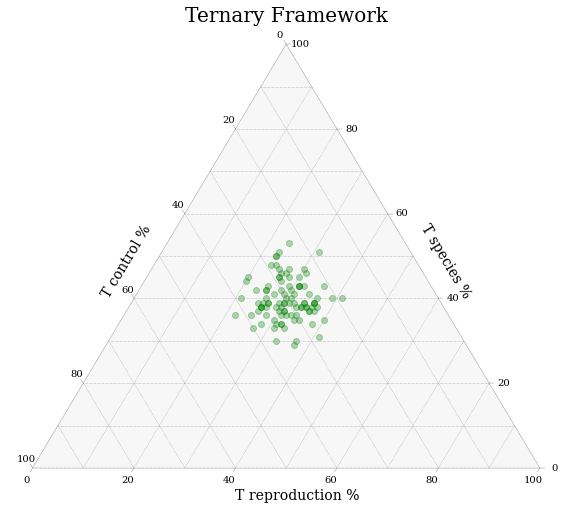

In [54]:
n_subtrees=100
topo_weight=[]

for _ in range(100):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model(n_subtrees)))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        elif key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R

    #one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    print(sum(topS_count), sum(topC_count),sum(topR_count))
    #one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
    #print((sum(topS_count)/n_subtrees)*100, sum(topC_count)/n_subtrees*100, sum(topR_count)/n_subtrees*100)
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    #print(one_value)
    topo_weight.append(one_value)
tern_plot(topo_weight)

#### Testing null model functions

In [17]:
n_subtrees=100
topo_weight=[]
for _ in range(100):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(produce_ranks(sim_null_model(n_subtrees)))
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):
            #print("yay")#TOPOLOGY S
            #print(key)
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R

    #one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    #print(sum(topS_count), sum(topC_count),sum(topR_count))
    #one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
    #print((sum(topS_count)/n_subtrees)*100, sum(topC_count)/n_subtrees*100, sum(topR_count)/n_subtrees*100)
    one_value=[(sum(topR_count)/n_subtrees)*100, sum(topS_count)/n_subtrees*100, sum(topC_count)/n_subtrees*100]
    #print(one_value)
    topo_weight.append(one_value)
tern_plot(topo_weight)

NameError: name 'produce_ranks' is not defined

In [12]:
# L/O

In [33]:
collections.Counter(produce_ranks(sim_null_model(10)))

Counter({(3, 5): 1,
         (3, 11): 4,
         (3, 2): 1,
         (4, 2): 1,
         (3, 10): 1,
         (3, 8): 1,
         (3, 9): 1})

In [132]:
num_replicates = 100000
#ranks = np.zeros(num_replicates)
ranks=[]
for replicate_index, ts in enumerate(sim_replicates(num_replicates)):
    for t in ts.trees():
        #print(t.rank())
        ranks+=[t.rank()]
        
print(ranks)

[(3, 4), (3, 9), (3, 3), (4, 2), (3, 8), (4, 0), (3, 2), (3, 10), (3, 6), (3, 5), (3, 10), (3, 10), (4, 1), (3, 8), (4, 0), (3, 10), (3, 2), (3, 9), (3, 4), (4, 1), (4, 0), (4, 1), (3, 9), (3, 4), (3, 10), (4, 1), (4, 2), (3, 0), (4, 1), (3, 10), (3, 9), (4, 2), (3, 8), (3, 10), (3, 8), (3, 11), (3, 5), (3, 2), (3, 1), (3, 0), (3, 7), (3, 0), (3, 1), (3, 2), (3, 8), (3, 0), (3, 0), (4, 0), (4, 0), (4, 2), (4, 2), (3, 0), (3, 7), (4, 1), (3, 6), (4, 0), (3, 11), (3, 3), (3, 7), (3, 1), (3, 6), (3, 2), (3, 0), (4, 0), (4, 0), (3, 3), (3, 4), (3, 1), (4, 2), (4, 0), (4, 1), (3, 3), (3, 7), (3, 7), (3, 10), (3, 1), (3, 7), (3, 8), (4, 2), (3, 5), (3, 9), (3, 8), (3, 6), (3, 7), (4, 1), (4, 1), (3, 9), (3, 5), (4, 0), (4, 1), (3, 4), (3, 0), (3, 7), (3, 3), (4, 2), (4, 1), (3, 10), (4, 2), (4, 1), (4, 2), (3, 8), (3, 9), (3, 7), (3, 0), (3, 9), (3, 1), (4, 0), (3, 3), (4, 1), (3, 5), (3, 1), (3, 6), (4, 2), (3, 5), (3, 7), (3, 2), (3, 11), (3, 7), (3, 8), (3, 7), (3, 9), (3, 8), (4, 2), (3,

In [147]:
#Summarize Topology s
#for rank in [(4,0), (3, 11), (3, 8),(3,0), (3, 3)]:
collections.Counter(ranks)[(3, 4)][(3, 8)]

TypeError: 'int' object is not subscriptable

In [171]:
ranks[1:10]

[(3, 9), (3, 3), (4, 2), (3, 8), (4, 0), (3, 2), (3, 10), (3, 6), (3, 5)]

In [ ]:
from itertools import chain, islice

def ichunked(seq, chunksize):
    """Yields items from an iterator in iterable chunks."""
    it = iter(seq)
    while True:
        yield chain([it.next()], islice(it, chunksize-1))

def chunked(seq, chunksize):
    """Yields items from an iterator in list chunks."""
    for chunk in ichunked(seq, chunksize):
        yield list(chunk)

In [187]:
#rank_dict=collections.Counter(ranks[0:10000])
n_subtrees=100
rank_dict=collections.Counter(random.sample(ranks, n_subtrees))
#name = "ABC"
topS_count = []
topC_count = []
topR_count = []
#(4,0),(3, 11),(3, 8),(3,0),(3, 3)]
#for character in name:
for key, value in rank_dict.items():
    print(key, value)
    if key == (4,0) or key == (3,11) or \
        key == (3,8) or key == (3,0) or key == (3,3):    #TOPOLOGY S
        topS_count.append(value)
        #TOPOLOGY S
    elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
        topC_count.append(value)
        # TOPOLOGY C
    else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
        topR_count.append(value)
        # TOPOLOGY R
#sum(values)

print(topS_count, topC_count, topR_count)
print(sum(topS_count), sum(topC_count), sum(topR_count))
print(sum(topS_count) + sum(topC_count) + sum(topR_count))

one_value=[(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees]
print([(sum(topS_count)/n_subtrees),sum(topC_count)/n_subtrees,sum(topR_count)/n_subtrees])

(4, 2) 9
(3, 0) 7
(3, 5) 4
(4, 0) 14
(4, 1) 12
(3, 8) 7
(3, 7) 8
(3, 2) 5
(3, 9) 4
(3, 3) 5
(3, 1) 8
(3, 6) 6
(3, 10) 5
(3, 4) 2
(3, 11) 4
[7, 14, 7, 5, 4] [4, 12, 8, 6, 5] [9, 8, 5, 4, 2]
37 35 28
100
[0.37, 0.35, 0.28]


In [15]:
#rank_dict=collections.Counter(ranks[0:10000])
n_subtrees=100
topo_weight=[]
for _ in range(1000):
    topS_count = []
    topC_count = []
    topR_count = []
    rank_dict=collections.Counter(random.sample(ranks, n_subtrees))
#(4,0),(3, 11),(3, 8),(3,0),(3, 3)]
#for character in name:
    for key, value in rank_dict.items():
        #print(key, value)
        if key == (4,0) or key == (3,11) or \
            key == (3,8) or key == (3,0) or key == (3,3):    #TOPOLOGY S
            topS_count.append(value)
        #TOPOLOGY S
        elif key == (4,1) or key == (3, 10) or key ==(3, 6) or key == (3,5) or key == (3, 1):
            topC_count.append(value)
        # TOPOLOGY C
        else:
        #key == (3,2) or key == (3, 4) or key == (3, 9) or key == (3,7) or key == (4, 2):
            topR_count.append(value)
        # TOPOLOGY R

    one_value=[(sum(topS_count)),sum(topC_count),sum(topR_count)]
    print(one_value)
    topo_weight.append(one_value)
    tern_plot(topo_weight)

NameError: name 'ranks' is not defined

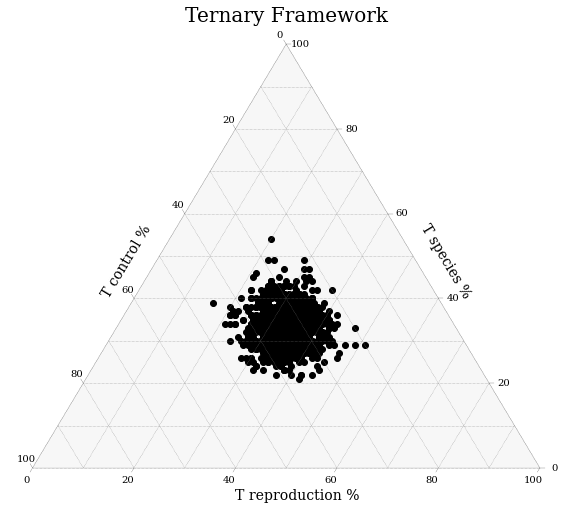

In [205]:
tern_plot(topo_weight)

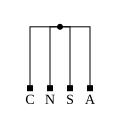

(0, 0)


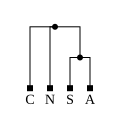

(1, 0)


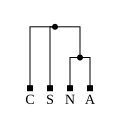

(1, 1)


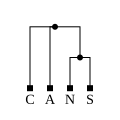

(1, 2)


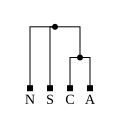

(1, 3)


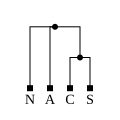

(1, 4)


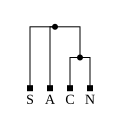

(1, 5)


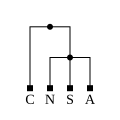

(2, 0)


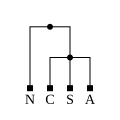

(2, 1)


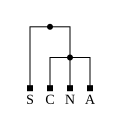

(2, 2)


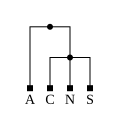

(2, 3)


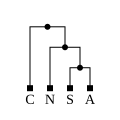

(3, 0)


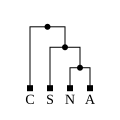

(3, 1)


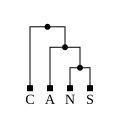

(3, 2)


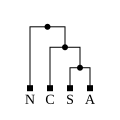

(3, 3)


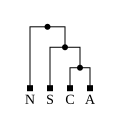

(3, 4)


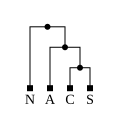

(3, 5)


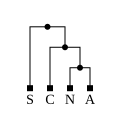

(3, 6)


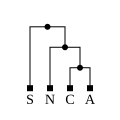

(3, 7)


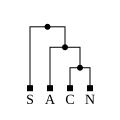

(3, 8)


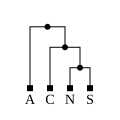

(3, 9)


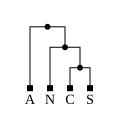

(3, 10)


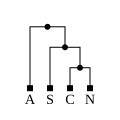

(3, 11)


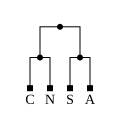

(4, 0)


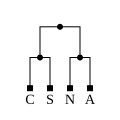

(4, 1)


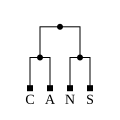

(4, 2)


In [8]:
for t in tskit.all_trees(num_leaves=4):
    display(SVG(t.draw_svg(node_labels={0: "C", 1: "N", 2: "S",3:"A"}, order="tree", size=(120, 120))))
    print(t.rank())

### Demographic model: neutral

In [80]:
def sim_test_null_model(num_replicates):
    demography = msprime.Demography()
    demography.add_population(name="A", initial_size=100)
    demography.add_population(name="B", initial_size=100)
    demography.add_population(name="C", initial_size=100)
    demography.add_population(name="D", initial_size=100)
    demography.add_population(name="AB", initial_size=100)
    demography.add_population(name="ABC", initial_size=100)
    demography.add_population(name="ABCD", initial_size=100)
    demography.add_population_split(time=10, derived=["A", "B"], ancestral="AB")
    demography.add_population_split(time=20, derived=["AB", "C"], ancestral="ABC")
    demography.add_population_split(time=30, derived=["ABC", "D"], ancestral="ABCD")
    #ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, sequence_length=10000, demography=demography, num_replicates=num_replicates)
    ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/10000))
        for t in mutated_ts.trees():
            print(t.rank())
            #display(SVG(t.draw_svg(node_labels={0: "A", 1: "B", 2: "C", 3 : "D"}, order="tree", size=(120, 120))))
    #yield ts
            
sim_test_null_model(50)

(3, 0)
(4, 0)
(3, 2)
(3, 0)
(3, 11)
(4, 0)
(3, 11)
(4, 1)
(4, 1)
(3, 11)
(3, 4)
(3, 3)
(3, 0)
(3, 8)
(3, 2)
(3, 9)
(4, 0)
(3, 1)
(3, 1)
(3, 9)
(4, 2)
(3, 4)
(4, 0)
(3, 5)
(3, 2)
(3, 7)
(3, 8)
(4, 0)
(3, 11)
(3, 9)
(3, 5)
(3, 8)
(3, 7)
(3, 11)
(3, 10)
(3, 7)
(3, 5)
(3, 11)
(4, 1)
(4, 1)
(3, 6)
(3, 7)
(3, 10)
(3, 10)
(3, 11)
(4, 1)
(4, 0)
(3, 3)
(3, 2)
(3, 3)


In [14]:
def sim_null_model(num_replicates):
    demography = msprime.Demography()
    demography.add_population(name="A", initial_size=100)
    demography.add_population(name="B", initial_size=100)
    demography.add_population(name="C", initial_size=100)
    demography.add_population(name="D", initial_size=100)
    demography.add_population(name="AB", initial_size=100)
    demography.add_population(name="ABC", initial_size=100)
    demography.add_population(name="ABCD", initial_size=100)
    demography.add_population_split(time=10, derived=["A", "B"], ancestral="AB")
    demography.add_population_split(time=20, derived=["AB", "C"], ancestral="ABC")
    demography.add_population_split(time=30, derived=["ABC", "D"], ancestral="ABCD")
    #ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, sequence_length=10000, demography=demography, num_replicates=num_replicates)
    ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/10000))
        yield ts
        
sim_null_model(50)

<generator object sim_null_model at 0x158a09430>

(3, 6)


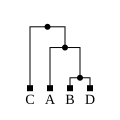

In [48]:
demography = msprime.Demography()
demography.add_population(name="A", initial_size=100)
demography.add_population(name="B", initial_size=100)
demography.add_population(name="C", initial_size=100)
demography.add_population(name="D", initial_size=100)
demography.add_population(name="AB", initial_size=100)
demography.add_population(name="ABC", initial_size=100)
demography.add_population(name="ABCD", initial_size=100)
demography.add_population_split(time=10, derived=["A", "B"], ancestral="AB")
demography.add_population_split(time=20, derived=["AB", "C"], ancestral="ABC")
demography.add_population_split(time=30, derived=["ABC", "D"], ancestral="ABCD")
    #ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, sequence_length=10000, demography=demography, num_replicates=num_replicates)
ts = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, demography=demography, ploidy=1) #, random_seed=12)
ts
for t in ts.trees():
    print(t.rank())
    display(SVG(t.draw_svg(node_labels={0: "A", 1: "B", 2: "C", 3 : "D"}, order="tree", size=(120, 120))))
#print("Topology s")
#for rank in [(243,1767)]:
#    t = tskit.Tree.unrank(num_leaves=8, rank=rank)
#    print("Visualizing rank", rank)
#    display(SVG(t.draw_svg(node_labels={0: "C", 1: "S", 2: "N", 3 : "A"}, order="tree", size=(120, 120))))

In [15]:
sim_null_model(1)
for t in sim_null_model(1).trees():
    print(t.rank())

AttributeError: 'generator' object has no attribute 'trees'

In [10]:
#demography = msprime.Demography.isolated_model([100] * 4)

In [12]:
print(demography)

Demography
╟  Populations
║  ┌────────────────────────────────────────────────────────────────────────────────────────────────┐
║  │ id │name   │description  │initial_size  │ growth_rate │  default_sampling_time│extra_metadata  │
║  ├────────────────────────────────────────────────────────────────────────────────────────────────┤
║  │ 0  │pop_0  │             │100.0         │      0      │                      0│{}              │
║  │ 1  │pop_1  │             │100.0         │      0      │                      0│{}              │
║  │ 2  │pop_2  │             │100.0         │      0      │                      0│{}              │
║  │ 3  │pop_3  │             │100.0         │      0      │                      0│{}              │
║  └────────────────────────────────────────────────────────────────────────────────────────────────┘
╟  Migration Matrix
║  ┌───────────────────────────────────────┐
║  │       │ pop_0 │ pop_1 │ pop_2 │ pop_3 │
║  ├───────────────────────────────────────┤
║  

### Demographic models from Martin et al.

In [ ]:
def make_data(num_data_points,num_replicates,t1,t2,t3,Ne,mig_rate):
    topo_sum=[]
    for i in range(num_data_points):
        ranks=produce_ranks(simulate_windows(num_replicates,set_demography_s(t1,t2,t3,mig_rate,Ne)))
        #print(summarize_ranks(100,ranks))
        topo_sum.append(summarize_ranks(num_replicates,ranks))
    #print(topo_sum)
    return topo_sum
    



To assess how reliably Patterson’s D statistic, and other estimators of f are able to quantify 
the actual rate of introgression, we simulated sequence data sets with differing rates of introgression
using ms (Hudson 2002). For each data set, we simulated 100 sequence windows for eight haplotypes each 
from four populations with the relationship (((P1,P2),P3),O). The split times t12 and t23 (as on fig. 1A) 
were set to 1 × 4N generations and 2 × 4N generations ago, respectively, and the root was set to 3 × 4N generations ago. An instantaneous, unidirectional admixture event, either from P3 to P2 or from P2 to P3, was simulated at a time tGF with a value f, which determines the probability that each haplotype is shared. We tested two different values for tGF: 0.1 and 0.5 × 4N generations ago. For each direction of gene flow and each tGF, 11 simulated data sets were produced, with f values ranging from 0 (no gene flow) to 1 (all haplotypes are shared). Finally, the entire set of simulations was repeated with three different window sizes: 1, 5, and 10 kb, and with three different recombination rates: 0.001, 0.01, and 0.1, in units of 4Nr, the population recombination rate. DNA sequences were generated from the simulated trees using Seq-Gen (Rambaut and Grass 1997), with the Hasegawa-Kishino-Yano substitution model and a branch scaling factor of 0.01. Simulations were run using the provided script compare_f_estimators.r, which generates the ms and Seq-Gen commands automatically. An example set of commands to simulate a single 5-kb sequence using the split times mentioned above, with gene flow from P3 to P2 at tGF = 0.1 and f = 0.2, and with a recombination rate parameter of 0.01 would be:

ms 32 1 -I 4 8 8 8 8 -ej 1 2 1 -ej 2 3 1 -ej 3 4 1 -es 0.1 2 0.8 -ej 0.1 5 3 -r 50 5000 -T | tail -n + 4 | grep -v // > treefile
partitions=(\$(wc -l treefile))
seq-gen -mHKY -l 5000 -s 0.01 -p $partitions <treefile >seqfile.

**Setting up demography only**

`set_demography(t1,t2,t3,mig_rate,Ne)`

Allows to define custom demographic models similar to Martin et al.
Function returns msprime.Demography() object as well as visualization and summary of the model

Parameters to specify are:
- three split times $t_1$(=$t_{12}$), $t_2$(=$t_{23}$), $t_3$(split time with outgroup)
- uniform $N_e$ for each of the identical in all populations
- `mig_rate` migration rate between $P_3$ and $P_1$ (can be set to 0)


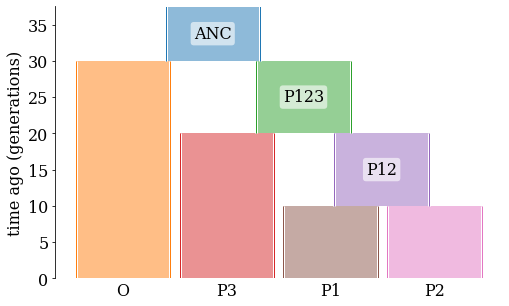

Demography(populations=[Population(initial_size=100, growth_rate=0, name='P1', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='P2', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='P3', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='O', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='P12', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='P123', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='ANC', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['P1', 'P2'], ancestral='P12'), PopulationSplit(time=20, derived=['P12', 'P3'], ancestral='P123'), PopulationSplit(time=30, derived=['P123', 'O'], ancestral='ANC')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.]]))

In [22]:
#Example of the usage: no migration
set_demography(10,20,30,0,100)

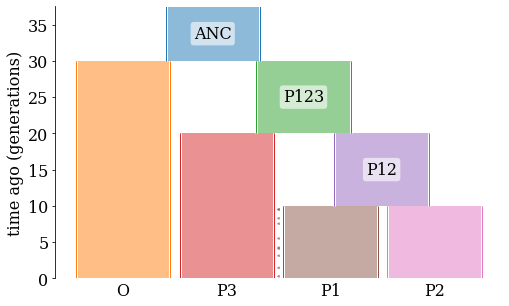

Demography(populations=[Population(initial_size=100, growth_rate=0, name='P1', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=100, growth_rate=0, name='P2', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=100, growth_rate=0, name='P3', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=100, growth_rate=0, name='O', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=100, growth_rate=0, name='P12', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=100, growth_rate=0, name='P123', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=100, growth_rate=0, name='ANC', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['P1', 'P2'], ancestral='P12'), PopulationSplit(time=20, derived=['P12', 'P3'], ancestral='P123'), PopulationSplit(time=30, derived=['P123', 'O'], ancestral='ANC')], migration_matrix=array([[0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0.1, 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ],
       [0. , 0. , 0. , 0. , 0. , 0. , 0. ]]))

In [23]:
#Example of the usage: migration at rate 0.1
set_demography(10,20,30,0.1,100)

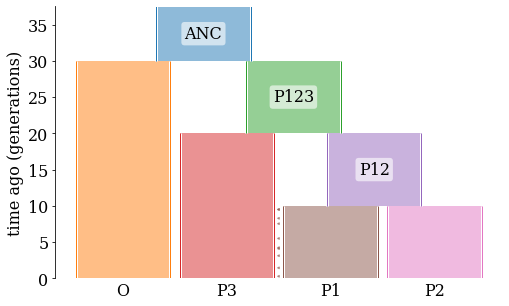

Demography(populations=[Population(initial_size=10, growth_rate=0, name='P1', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=0), Population(initial_size=10, growth_rate=0, name='P2', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=1), Population(initial_size=10, growth_rate=0, name='P3', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=2), Population(initial_size=10, growth_rate=0, name='O', description='', extra_metadata={}, default_sampling_time=None, initially_active=None, id=3), Population(initial_size=10, growth_rate=0, name='P12', description='', extra_metadata={}, default_sampling_time=10, initially_active=False, id=4), Population(initial_size=10, growth_rate=0, name='P123', description='', extra_metadata={}, default_sampling_time=20, initially_active=False, id=5), Population(initial_size=10, growth_rate=0, name='ANC', description='', extra_metadata={}, default_sampling_time=30, initially_active=False, id=6)], events=[PopulationSplit(time=10, derived=['P1', 'P2'], ancestral='P12'), PopulationSplit(time=20, derived=['P12', 'P3'], ancestral='P123'), PopulationSplit(time=30, derived=['P123', 'O'], ancestral='ANC')], migration_matrix=array([[0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0.]]))

In [19]:
def set_demography(t1,t2,t3,mig_rate,Ne):
    demography = msprime.Demography()
    
    #initializing populations
    demography.add_population(name="P1", initial_size=Ne)
    demography.add_population(name="P2", initial_size=Ne)
    demography.add_population(name="P3", initial_size=Ne)
    demography.add_population(name="O", initial_size=Ne)
    demography.add_population(name="P12", initial_size=Ne)
    demography.add_population(name="P123", initial_size=Ne)
    demography.add_population(name="ANC", initial_size=Ne)
    
    #adding split times
    demography.add_population_split(time=t1, derived=["P1", "P2"], ancestral="P12")
    demography.add_population_split(time=t2, derived=["P12", "P3"], ancestral="P123")
    demography.add_population_split(time=t3, derived=["P123", "O"], ancestral="ANC")
    
    #setting up gene flow
    demography.set_migration_rate("P3", "P1", mig_rate)
    
    #print(demography)
    #yield demography
    

    #Simultanious test
    ml.rcParams['figure.figsize'] = (8.0, 5.0)
    graph = msprime.Demography.to_demes(demography)
    fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
    demesdraw.tubes(graph, ax=ax, seed=1)
    plt.show()

    return demography

#Simultanious test
#demography = demogr(10,20,30)
#graph = msprime.Demography.to_demes(demography)
#fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
#demesdraw.tubes(graph, ax=ax, seed=1)
#plt.show()

set_demography(10,20,30,1,10)

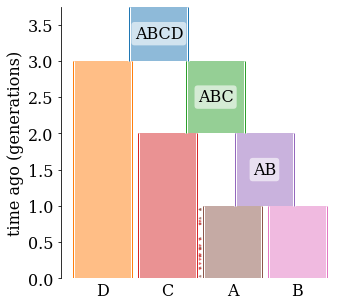

In [97]:
demography = msprime.Demography()
demography.add_population(name="A", initial_size=100)
demography.add_population(name="B", initial_size=100)
demography.add_population(name="C", initial_size=100)
demography.add_population(name="D", initial_size=100)
demography.add_population(name="AB", initial_size=100)
demography.add_population(name="ABC", initial_size=100)
demography.add_population(name="ABCD", initial_size=100)
    
demography.add_population_split(time=1, derived=["A", "B"], ancestral="AB")
demography.add_population_split(time=2, derived=["AB", "C"], ancestral="ABC")
demography.add_population_split(time=3, derived=["ABC", "D"], ancestral="ABCD")

# Set the migration rates between extant populations
demography.set_symmetric_migration_rate(["C", "A"], 9.6e-5) #asymmetric
#demography.set_symmetric_migration_rate(["B", "A"], 1.9e-5)
#demography.set_symmetric_migration_rate(["D", "A"], 3e-5)

graph = msprime.Demography.to_demes(demography)
fig, ax = plt.subplots()  # use plt.rcParams["figure.figsize"]
demesdraw.tubes(graph, ax=ax, seed=1)
plt.show()

In [ ]:
def sim_null_model_flex(num_replicates,t12,t23,t34):
    demography = msprime.Demography()
    demography.add_population(name="A", initial_size=100)
    demography.add_population(name="B", initial_size=100)
    demography.add_population(name="C", initial_size=100)
    demography.add_population(name="D", initial_size=100)
    demography.add_population(name="AB", initial_size=100)
    demography.add_population(name="ABC", initial_size=100)
    demography.add_population(name="ABCD", initial_size=100)
    demography.add_population_split(time=t12, derived=["A", "B"], ancestral="AB")
    demography.add_population_split(time=t23, derived=["AB", "C"], ancestral="ABC")
    demography.add_population_split(time=t34, derived=["ABC", "D"], ancestral="ABCD")
    #ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, sequence_length=10000, demography=demography, num_replicates=num_replicates)
    ancestry_reps = msprime.sim_ancestry(samples={"A": 1, "B": 1, "C": 1, "D": 1}, 
                                         demography=demography, sequence_length=10000,
                                         num_replicates=num_replicates, ploidy=1)
    for ts in ancestry_reps:
        mutated_ts = msprime.sim_mutations(ts, rate=(1/10000))
        yield ts